-해결해야할 것-

1. 벡테스팅 종목별 maximun drawdown 산출하는게 가능하지 조사

sharpe ratio = (수익률의 평균 -자산 기회비용 이자율) /수익률의 표준편차

sortino ratio = 

In [ ]:
# minimum acceptable return (MAR)
# 하방 편차는 최소 임계값 또는 최소 허용 수익(MAR) 아래로 떨어지는 수익에 초점을 맞춘 하방 위험의 척도입니다.
# sharpe ratio = 일반적으로 전략에 자금 조달 비용이 발생하는 경우에만 샤프 비율을 계산할 때 전략 수익에서 무위험 이자율을 빼야 합니다.
# bt.analyzers.SharpeRatio_A 는 원하는 기간에 관계없이 연간 형식으로 값을 직접 제공한다.

In [ ]:
# quantitative trading, algorithmic trading이라고 부르는 트레이딩 분야의 한 갈래는
# 수학, 통계학, 시계열 분석, 머신러닝과 같은 과학적 방법론들을 트레이딩 분야에 적용하여
# 안정적으로 지속적인 수익을 창출하는 시스템을 만드는 일련의 과정을 통칭한다.
# 이는 계량 금융의 분야 중에서도 극도로 정교한 분야이며 알고리즘 트레이딩을 하기 위해서는 초기 전략의 개발 단계부터 마지막 프로덕션 단계에
# 이르기까지 매우 많은 시간과 노력을 투자해야 한다.
#  technical analysis strategies and statistical arbitrage strategies

In [ ]:
# MACD 이동평균 2개 잘맞는 4,9 // 9,18 // 5,20 // 10,40
# 볼린저 밴드는 20일 이동평균을 사용한다.
# 이동평균이 항상 잘 맞는 건 아니다. 시장이 추세적 국면일 때는 잘 맞지만,
#가격이 횡보국면을 나타내는 비추세기간에는 거의 도움이 되지 않는다.
# 다행히도 이러한 횡보국면에 이동평균보다 상당히 잘 맞는 지표가 있다. 그것이 바로 오실레이터이다.
# 오실레이터는 기본적인 추세분석을 한 후에 적용되어야 한다는 점에서 보조적인 지표이다.

In [1]:
import pandas as pd
pdr_dataframe = pd.read_csv('C:/Users/scw03/Desktop/StockProject/data/complete_ohlcvc_data.csv',\
                                   encoding='cp949', index_col=0 , parse_dates=True, header=[0,1], engine='c')

In [ ]:
pdr_dataframe

In [14]:
pdrpdr = pdr_dataframe.loc['2020':]

In [ ]:
pdrpdr

In [3]:
from datetime import datetime
import backtrader as bt
import matplotlib
import time

In [15]:
# 거래가능 날짜 100일 이상인 종목만 추리기
con1 = (pdrpdr.loc[:, (slice(None))].count() >= 100)
mult_index = con1[con1].index.get_level_values(0).drop_duplicates()

In [5]:
# 다른걸로 대체하기 (수익률 계산못함)
class BollingerStrategy(bt.Strategy):
    params = (
        ('timeperiod', 20),
    )
    
    def log(self, txt, dt=None):
        ''' Logging function for this strategy'''
        dt = dt or self.datas[0].datetime.date(0)
        print('%s, %s' % (dt.isoformat(), txt))
    
    def __init__(self):
        self.tnetpnl = 0
        self.dnorder = dict()
        self.dnetpnl = dict()        
        for index, d in enumerate(self.datas):
            bband2 = bt.talib.BBANDS(d.close, timeperiod=self.params.timeperiod, nbdevup=2.0, nbdevdn=2.0, matype=0)
            bband1 = bt.talib.BBANDS(d.close, timeperiod=self.params.timeperiod, nbdevup=1.0, nbdevdn=1.0, matype=0)
        
            self.dnorder[d._name] = None
            self.dnetpnl[d._name] = 0
            d.buysignal = d.close < bband2.lowerband
            d.sellsignal = d.close > bband2.lowerband

    def notify_order(self, order):
        if order.status in [order.Submitted]:
            self.log('ORDER SUBMITTED')
            return
        if order.status in [order.Accepted]:
            self.log('ORDER ACCEPTED')
            return
        # Check if an order has been completed
        # Attention: broker could reject order if not enough cash
        if order.status in [order.Completed]:
            if order.isbuy():
                self.log(
                    '%s, BUY EXECUTED, Price: %.2f, Cost: %.2f, Comm %.2f' %
                    (order.data._name,
                     order.executed.price,
                     order.executed.value,
                     order.executed.comm))

            else:  # Sell
                self.log('%s, SELL EXECUTED, Price: %.2f, Cost: %.2f, Comm %.2f' %
                         (order.data._name,
                          order.executed.price,
                          order.executed.value,
                          order.executed.comm))

        elif order.status in [order.Canceled, order.Margin, order.Rejected]:
            self.log('Order Canceled/Margin/Rejected')
            
        # Write down: no pending order        
        self.dnorder[order.data._name] = None

        
    def notify_trade(self, trade):
        if not trade.isclosed:
            return

        self.log('OPERATION PROFIT, GROSS %.2f, NET %.2f' %
                 (trade.pnl, trade.pnlcomm))
        self.tnetpnl += trade.pnlcomm
        self.dnetpnl[trade.data._name] += trade.pnlcomm
        
    def next(self):
        symbolclosestring = ''
        for index, d in enumerate(self.datas):
            symbolclosestring += " ["+d._name+" : "+str(d.close[0]) + "] "
        self.log(symbolclosestring)
        
        for index, d in enumerate(self.datas):
            # Check if an order is pending ... if yes, we cannot send a 2nd one
            if self.dnorder[d._name]:
                return
            if not self.getpositionbyname(name=d._name):
                if d.buysignal:
                    self.log('BUY CREATE')
                    # Keep track of the created order to avoid a 2nd order
                    self.dnorder[d._name] = self.buy(data=d)
            else:
                if d.sellsignal:
                    self.log('SELL CREATE')
                    # Keep track of the created order to avoid a 2nd order
                    self.dnorder[d._name] = self.sell(data=d)
    def stop(self):
        print("포트폴리오 수익률 : %.2f"  % self.tnetpnl)

In [26]:
# MACD 이동평균 2개 잘맞는 4,9 // 9,18 // 5,20 // 10,40

# 2,6,10 // 9,10,10
class MACDStrategy(bt.Strategy):
    params = (
        ('fastperiod', 2),
        ('slowperiod', 6),
        ('signalperiod', 10),
    )
    
    def log(self, txt, dt=None):
        ''' Logging function for this strategy'''
        dt = dt or self.datas[0].datetime.date(0)
        print('%s, %s' % (dt.isoformat(), txt))
    
    def __init__(self):
        self.tnetpnl = 0
        self.dnorder = dict()
        self.dnetpnl = dict()
        for index, d in enumerate(self.datas):
            macd = bt.talib.MACD(d.close, fastperiod=self.params.fastperiod, slowperiod=self.params.slowperiod, signalperiod=self.params.signalperiod)
            ema200 = bt.talib.EMA(d.close, timeperiod=200)
            self.dnorder[d._name] = None
            self.dnetpnl[d._name] = 0
            d.buysignal = bt.indicators.And(macd.macd < 0 ,macd.macd > macd.macdsignal , d.close > ema200)
            d.sellsignal = bt.indicators.And(macd.macd > 0 ,macd.macd < macd.macdsignal, d.close < ema200)

    def notify_order(self, order):
        if order.status in [order.Submitted]:
            self.log('ORDER SUBMITTED')
            return
        if order.status in [order.Accepted]:
            self.log('ORDER ACCEPTED')
            return
        # Check if an order has been completed
        # Attention: broker could reject order if not enough cash
        if order.status in [order.Completed]:
            if order.isbuy():
                self.log(
                    '%s, BUY EXECUTED, Price: %.2f, Cost: %.2f, Comm %.2f' %
                    (order.data._name,
                     order.executed.price,
                     order.executed.value,
                     order.executed.comm))

            else:  # Sell
                self.log('%s, SELL EXECUTED, Price: %.2f, Cost: %.2f, Comm %.2f' %
                         (order.data._name,
                          order.executed.price,
                          order.executed.value,
                          order.executed.comm))

        elif order.status in [order.Canceled, order.Margin, order.Rejected]:
            self.log('Order Canceled/Margin/Rejected')
            
        # Write down: no pending order        
        self.dnorder[order.data._name] = None

        
    def notify_trade(self, trade):
        if not trade.isclosed:
            return

        self.log('OPERATION PROFIT, GROSS %.2f, NET %.2f' %
                 (trade.pnl, trade.pnlcomm))
        self.tnetpnl += trade.pnlcomm
        self.dnetpnl[trade.data._name] += trade.pnlcomm
        
    def next(self):
        symbolclosestring = ''
        for index, d in enumerate(self.datas):
            symbolclosestring += " ["+d._name+" : "+str(d.close[0]) + "] "
        self.log(symbolclosestring)
        
        for index, d in enumerate(self.datas):
            # Check if an order is pending ... if yes, we cannot send a 2nd one
            if self.dnorder[d._name]:
                return
            if not self.getpositionbyname(name=d._name):
                if d.buysignal:
                    self.log('BUY CREATE')
                    # Keep track of the created order to avoid a 2nd order
                    self.dnorder[d._name] = self.buy(data=d)
            else:
                if d.sellsignal:
                    self.log('SELL CREATE')
                    # Keep track of the created order to avoid a 2nd order
                    self.dnorder[d._name] = self.sell(data=d)
                    
    def stop(self):
        print("포트폴리오 수익률 : %.2f"  % self.tnetpnl)

In [17]:
class ThreeStrikesRSIStrategy(bt.Strategy):
    
    def log(self, txt, dt=None):
        ''' Logging function for this strategy'''
        dt = dt or self.datas[0].datetime.date(0)
        print('%s, %s' % (dt.isoformat(), txt))
    
    def __init__(self):
        self.tnetpnl = 0
        self.dnorder = dict()
        self.dnetpnl = dict()
        for index, d in enumerate(self.datas):
            rsi_4 = bt.talib.RSI(d.close, timeperiod=4)
            rsi_10 = bt.talib.RSI(d.close, timeperiod=10)
            rsi_14 = bt.talib.RSI(d.close, timeperiod=14)
            
            self.dnorder[d._name] = None
            self.dnetpnl[d._name] = 0
            d.buysignal = bt.indicators.And(rsi_4 <= 35, rsi_10 <= 35, rsi_14 <= 35)
            d.sellsignal = rsi_4 >= 70

    def notify_order(self, order):
        if order.status in [order.Submitted]:
            self.log('ORDER SUBMITTED')
            return
        if order.status in [order.Accepted]:
            self.log('ORDER ACCEPTED')
            return
        # Check if an order has been completed
        # Attention: broker could reject order if not enough cash
        if order.status in [order.Completed]:
            if order.isbuy():
                self.log(
                    '%s, BUY EXECUTED, Price: %.2f, Cost: %.2f, Comm %.2f' %
                    (order.data._name,
                     order.executed.price,
                     order.executed.value,
                     order.executed.comm))

            else:  # Sell
                self.log('%s, SELL EXECUTED, Price: %.2f, Cost: %.2f, Comm %.2f' %
                         (order.data._name,
                          order.executed.price,
                          order.executed.value,
                          order.executed.comm))

        elif order.status in [order.Canceled, order.Margin, order.Rejected]:
            self.log('Order Canceled/Margin/Rejected')
            
        # Write down: no pending order        
        self.dnorder[order.data._name] = None

        
    def notify_trade(self, trade):
        if not trade.isclosed:
            return

        self.log('OPERATION PROFIT, GROSS %.2f, NET %.2f' %
                 (trade.pnl, trade.pnlcomm))
        self.tnetpnl += trade.pnlcomm
        self.dnetpnl[trade.data._name] += trade.pnlcomm
        
        
    def next(self):
        symbolclosestring = ''
        for index, d in enumerate(self.datas):
            symbolclosestring += " ["+d._name+" : "+str(d.close[0]) + "] "
        self.log(symbolclosestring)
        
        for index, d in enumerate(self.datas):
            # Check if an order is pending ... if yes, we cannot send a 2nd one
            if self.dnorder[d._name]:
                return
            if not self.getpositionbyname(name=d._name):
                if d.buysignal:
                    self.log('BUY CREATE')
                    # Keep track of the created order to avoid a 2nd order
                    self.dnorder[d._name] = self.buy(data=d)
            else:
                if d.sellsignal:
                    self.log('SELL CREATE')
                    # Keep track of the created order to avoid a 2nd order
                    self.dnorder[d._name] = self.sell(data=d)
                    
    def stop(self):
        print("포트폴리오 수익률 : %.2f"  % self.tnetpnl)

In [27]:
if __name__ == '__main__':
    # Create a cerebro entity
    cerebro = bt.Cerebro()

    # Add a strategy    
    cerebro.addstrategy(ThreeStrikesRSIStrategy)
    
    for i, d in enumerate(mult_index):
        cerebro.adddata(bt.feeds.PandasData(dataname=pdrpdr[d], name=d))
    
    # Set our desired cash start
    cerebro.broker.setcash(10000000000000.0)
    
    cerebro.broker.setcommission(commission=0.001)
    
    # Run over everything
    starttime = time.time()
    thestrats = cerebro.run()
    print("backtesting Time: {} sec".format(time.time()-starttime))

2019-10-24,  [098120 : 2910.0]  [131100 : 15950.0]  [009520 : 5180.0]  [095570 : 4180.0]  [006840 : 32050.0]  [282330 : 188000.0]  [027410 : 5900.0]  [138930 : 7120.0]  [001460 : 239500.0]  [001040 : 83000.0]  [011150 : 2925.0]  [058820 : 3080.0]  [000590 : 57500.0]  [012030 : 794.0]  [016610 : 4365.0]  [005830 : 52000.0]  [000990 : 17200.0]  [139130 : 7200.0]  [001530 : 7007.0]  [001880 : 19000.0]  [000210 : 85211.0]  [375500 : nan]  [155660 : 3950.0]  [069730 : 4130.0]  [017940 : 49350.0]  [365550 : nan]  [050120 : 8520.0]  [383220 : nan]  [007700 : 45700.0]  [006360 : 31600.0]  [078930 : 50800.0]  [012630 : 11900.0]  [294870 : 28882.0]  [097230 : 4430.0]  [003560 : 1720.0]  [175330 : 5410.0]  [234080 : 20850.0]  [001060 : 26020.0]  [096760 : 5683.0]  [105560 : 44000.0]  [024120 : 5690.0]  [009070 : 2935.0]  [044180 : 1943.0]  [016380 : 8290.0]  [001390 : 10950.0]  [033180 : 6278.0]  [001940 : 12950.0]  [025000 : 53700.0]  [092230 : 55000.0]  [000040 : 2018.0]  [093050 : 19200.0]  [0

2019-10-28, ORDER SUBMITTED
2019-10-28, ORDER SUBMITTED
2019-10-28, ORDER SUBMITTED
2019-10-28, ORDER SUBMITTED
2019-10-28, ORDER SUBMITTED
2019-10-28, ORDER SUBMITTED
2019-10-28, ORDER SUBMITTED
2019-10-28, ORDER SUBMITTED
2019-10-28, ORDER SUBMITTED
2019-10-28, ORDER SUBMITTED
2019-10-28, ORDER SUBMITTED
2019-10-28, ORDER SUBMITTED
2019-10-28, ORDER SUBMITTED
2019-10-28, ORDER SUBMITTED
2019-10-28, ORDER SUBMITTED
2019-10-28, ORDER SUBMITTED
2019-10-28, ORDER SUBMITTED
2019-10-28, ORDER SUBMITTED
2019-10-28, ORDER SUBMITTED
2019-10-28, ORDER SUBMITTED
2019-10-28, ORDER SUBMITTED
2019-10-28, ORDER SUBMITTED
2019-10-28, ORDER SUBMITTED
2019-10-28, ORDER SUBMITTED
2019-10-28, ORDER SUBMITTED
2019-10-28, ORDER SUBMITTED
2019-10-28, ORDER SUBMITTED
2019-10-28, ORDER SUBMITTED
2019-10-28, ORDER SUBMITTED
2019-10-28, ORDER ACCEPTED
2019-10-28, ORDER ACCEPTED
2019-10-28, ORDER ACCEPTED
2019-10-28, ORDER ACCEPTED
2019-10-28, ORDER ACCEPTED
2019-10-28, ORDER ACCEPTED
2019-10-28, ORDER ACCEPTED

2019-10-29, ORDER SUBMITTED
2019-10-29, ORDER SUBMITTED
2019-10-29, ORDER SUBMITTED
2019-10-29, ORDER SUBMITTED
2019-10-29, ORDER SUBMITTED
2019-10-29, ORDER SUBMITTED
2019-10-29, ORDER SUBMITTED
2019-10-29, ORDER SUBMITTED
2019-10-29, ORDER SUBMITTED
2019-10-29, ORDER SUBMITTED
2019-10-29, ORDER SUBMITTED
2019-10-29, ORDER SUBMITTED
2019-10-29, ORDER SUBMITTED
2019-10-29, ORDER SUBMITTED
2019-10-29, ORDER SUBMITTED
2019-10-29, ORDER SUBMITTED
2019-10-29, ORDER SUBMITTED
2019-10-29, ORDER SUBMITTED
2019-10-29, ORDER SUBMITTED
2019-10-29, ORDER SUBMITTED
2019-10-29, ORDER SUBMITTED
2019-10-29, ORDER SUBMITTED
2019-10-29, ORDER SUBMITTED
2019-10-29, ORDER SUBMITTED
2019-10-29, ORDER SUBMITTED
2019-10-29, ORDER SUBMITTED
2019-10-29, ORDER SUBMITTED
2019-10-29, ORDER ACCEPTED
2019-10-29, ORDER ACCEPTED
2019-10-29, ORDER ACCEPTED
2019-10-29, ORDER ACCEPTED
2019-10-29, ORDER ACCEPTED
2019-10-29, ORDER ACCEPTED
2019-10-29, ORDER ACCEPTED
2019-10-29, ORDER ACCEPTED
2019-10-29, ORDER ACCEPTED
2

2019-10-30, ORDER SUBMITTED
2019-10-30, ORDER SUBMITTED
2019-10-30, ORDER SUBMITTED
2019-10-30, ORDER SUBMITTED
2019-10-30, ORDER SUBMITTED
2019-10-30, ORDER SUBMITTED
2019-10-30, ORDER SUBMITTED
2019-10-30, ORDER SUBMITTED
2019-10-30, ORDER SUBMITTED
2019-10-30, ORDER SUBMITTED
2019-10-30, ORDER SUBMITTED
2019-10-30, ORDER SUBMITTED
2019-10-30, ORDER SUBMITTED
2019-10-30, ORDER SUBMITTED
2019-10-30, ORDER SUBMITTED
2019-10-30, ORDER SUBMITTED
2019-10-30, ORDER SUBMITTED
2019-10-30, ORDER SUBMITTED
2019-10-30, ORDER SUBMITTED
2019-10-30, ORDER SUBMITTED
2019-10-30, ORDER SUBMITTED
2019-10-30, ORDER SUBMITTED
2019-10-30, ORDER SUBMITTED
2019-10-30, ORDER SUBMITTED
2019-10-30, ORDER SUBMITTED
2019-10-30, ORDER SUBMITTED
2019-10-30, ORDER SUBMITTED
2019-10-30, ORDER SUBMITTED
2019-10-30, ORDER SUBMITTED
2019-10-30, ORDER SUBMITTED
2019-10-30, ORDER SUBMITTED
2019-10-30, ORDER ACCEPTED
2019-10-30, ORDER ACCEPTED
2019-10-30, ORDER ACCEPTED
2019-10-30, ORDER ACCEPTED
2019-10-30, ORDER ACCEPT

2019-11-01, ORDER SUBMITTED
2019-11-01, ORDER SUBMITTED
2019-11-01, ORDER SUBMITTED
2019-11-01, ORDER SUBMITTED
2019-11-01, ORDER SUBMITTED
2019-11-01, ORDER SUBMITTED
2019-11-01, ORDER SUBMITTED
2019-11-01, ORDER SUBMITTED
2019-11-01, ORDER SUBMITTED
2019-11-01, ORDER SUBMITTED
2019-11-01, ORDER SUBMITTED
2019-11-01, ORDER SUBMITTED
2019-11-01, ORDER SUBMITTED
2019-11-01, ORDER SUBMITTED
2019-11-01, ORDER SUBMITTED
2019-11-01, ORDER SUBMITTED
2019-11-01, ORDER SUBMITTED
2019-11-01, ORDER SUBMITTED
2019-11-01, ORDER SUBMITTED
2019-11-01, ORDER ACCEPTED
2019-11-01, ORDER ACCEPTED
2019-11-01, ORDER ACCEPTED
2019-11-01, ORDER ACCEPTED
2019-11-01, ORDER ACCEPTED
2019-11-01, ORDER ACCEPTED
2019-11-01, ORDER ACCEPTED
2019-11-01, ORDER ACCEPTED
2019-11-01, ORDER ACCEPTED
2019-11-01, ORDER ACCEPTED
2019-11-01, ORDER ACCEPTED
2019-11-01, ORDER ACCEPTED
2019-11-01, ORDER ACCEPTED
2019-11-01, ORDER ACCEPTED
2019-11-01, ORDER ACCEPTED
2019-11-01, ORDER ACCEPTED
2019-11-01, ORDER ACCEPTED
2019-11-0

2019-11-05, ORDER SUBMITTED
2019-11-05, ORDER SUBMITTED
2019-11-05, ORDER SUBMITTED
2019-11-05, ORDER SUBMITTED
2019-11-05, ORDER SUBMITTED
2019-11-05, ORDER SUBMITTED
2019-11-05, ORDER SUBMITTED
2019-11-05, ORDER SUBMITTED
2019-11-05, ORDER SUBMITTED
2019-11-05, ORDER ACCEPTED
2019-11-05, ORDER ACCEPTED
2019-11-05, ORDER ACCEPTED
2019-11-05, ORDER ACCEPTED
2019-11-05, ORDER ACCEPTED
2019-11-05, ORDER ACCEPTED
2019-11-05, ORDER ACCEPTED
2019-11-05, ORDER ACCEPTED
2019-11-05, ORDER ACCEPTED
2019-11-05, 213420, BUY EXECUTED, Price: 23100.00, Cost: 23100.00, Comm 23.10
2019-11-05, 310870, BUY EXECUTED, Price: 3521.00, Cost: 3521.00, Comm 3.52
2019-11-05, 036830, BUY EXECUTED, Price: 36502.00, Cost: 36502.00, Comm 36.50
2019-11-05, 069920, BUY EXECUTED, Price: 4525.00, Cost: 4525.00, Comm 4.53
2019-11-05, 255440, BUY EXECUTED, Price: 23450.00, Cost: 23450.00, Comm 23.45
2019-11-05, 195990, BUY EXECUTED, Price: 1145.00, Cost: 1145.00, Comm 1.15
2019-11-05, 175140, BUY EXECUTED, Price: 11800

2019-11-07, ORDER SUBMITTED
2019-11-07, ORDER SUBMITTED
2019-11-07, ORDER SUBMITTED
2019-11-07, ORDER SUBMITTED
2019-11-07, ORDER SUBMITTED
2019-11-07, ORDER SUBMITTED
2019-11-07, ORDER SUBMITTED
2019-11-07, ORDER SUBMITTED
2019-11-07, ORDER ACCEPTED
2019-11-07, ORDER ACCEPTED
2019-11-07, ORDER ACCEPTED
2019-11-07, ORDER ACCEPTED
2019-11-07, ORDER ACCEPTED
2019-11-07, ORDER ACCEPTED
2019-11-07, ORDER ACCEPTED
2019-11-07, ORDER ACCEPTED
2019-11-07, 005290, BUY EXECUTED, Price: 16600.00, Cost: 16600.00, Comm 16.60
2019-11-07, 042510, BUY EXECUTED, Price: 3050.00, Cost: 3050.00, Comm 3.05
2019-11-07, 002070, BUY EXECUTED, Price: 8888.00, Cost: 8888.00, Comm 8.89
2019-11-07, 222800, BUY EXECUTED, Price: 9200.00, Cost: 9200.00, Comm 9.20
2019-11-07, 056190, BUY EXECUTED, Price: 42350.00, Cost: 42350.00, Comm 42.35
2019-11-07, 267250, BUY EXECUTED, Price: 68400.00, Cost: 68400.00, Comm 68.40
2019-11-07, 123040, BUY EXECUTED, Price: 6000.00, Cost: 6000.00, Comm 6.00
2019-11-07, 049430, BUY EX

2019-11-11, ORDER SUBMITTED
2019-11-11, ORDER SUBMITTED
2019-11-11, ORDER SUBMITTED
2019-11-11, ORDER SUBMITTED
2019-11-11, ORDER SUBMITTED
2019-11-11, ORDER SUBMITTED
2019-11-11, ORDER SUBMITTED
2019-11-11, ORDER ACCEPTED
2019-11-11, ORDER ACCEPTED
2019-11-11, ORDER ACCEPTED
2019-11-11, ORDER ACCEPTED
2019-11-11, ORDER ACCEPTED
2019-11-11, ORDER ACCEPTED
2019-11-11, ORDER ACCEPTED
2019-11-11, 061040, BUY EXECUTED, Price: 7620.00, Cost: 7620.00, Comm 7.62
2019-11-11, 045660, BUY EXECUTED, Price: 8960.00, Cost: 8960.00, Comm 8.96
2019-11-11, 097520, BUY EXECUTED, Price: 23650.00, Cost: 23650.00, Comm 23.65
2019-11-11, 189300, BUY EXECUTED, Price: 31787.00, Cost: 31787.00, Comm 31.79
2019-11-11, 158310, BUY EXECUTED, Price: 9596.00, Cost: 9596.00, Comm 9.60
2019-11-11, 020120, BUY EXECUTED, Price: 4500.00, Cost: 4500.00, Comm 4.50
2019-11-11, 004800, BUY EXECUTED, Price: 81000.00, Cost: 81000.00, Comm 81.00
2019-11-11,  [098120 : 3120.0]  [131100 : 17500.0]  [009520 : 5180.0]  [095570 : 

2019-11-14, ORDER SUBMITTED
2019-11-14, ORDER SUBMITTED
2019-11-14, ORDER SUBMITTED
2019-11-14, ORDER SUBMITTED
2019-11-14, ORDER SUBMITTED
2019-11-14, ORDER SUBMITTED
2019-11-14, ORDER SUBMITTED
2019-11-14, ORDER SUBMITTED
2019-11-14, ORDER SUBMITTED
2019-11-14, ORDER SUBMITTED
2019-11-14, ORDER SUBMITTED
2019-11-14, ORDER ACCEPTED
2019-11-14, ORDER ACCEPTED
2019-11-14, ORDER ACCEPTED
2019-11-14, ORDER ACCEPTED
2019-11-14, ORDER ACCEPTED
2019-11-14, ORDER ACCEPTED
2019-11-14, ORDER ACCEPTED
2019-11-14, ORDER ACCEPTED
2019-11-14, ORDER ACCEPTED
2019-11-14, ORDER ACCEPTED
2019-11-14, ORDER ACCEPTED
2019-11-14, 033640, BUY EXECUTED, Price: 23850.00, Cost: 23850.00, Comm 23.85
2019-11-14, 090460, BUY EXECUTED, Price: 21600.00, Cost: 21600.00, Comm 21.60
2019-11-14, 143160, BUY EXECUTED, Price: 34300.00, Cost: 34300.00, Comm 34.30
2019-11-14, 290740, BUY EXECUTED, Price: 11650.00, Cost: 11650.00, Comm 11.65
2019-11-14, 036540, BUY EXECUTED, Price: 3230.00, Cost: 3230.00, Comm 3.23
2019-11-

2019-11-15,  [098120 : 3405.0]  [131100 : 15850.0]  [009520 : 5240.0]  [095570 : 4220.0]  [006840 : 34300.0]  [282330 : 183000.0]  [027410 : 5910.0]  [138930 : 7230.0]  [001460 : 243500.0]  [001040 : 93000.0]  [011150 : 2970.0]  [058820 : 4240.0]  [000590 : 58600.0]  [012030 : 784.0]  [016610 : 4400.0]  [005830 : 55000.0]  [000990 : 18500.0]  [139130 : 7270.0]  [001530 : 7187.0]  [001880 : 20500.0]  [000210 : 84759.0]  [375500 : nan]  [155660 : 4555.0]  [069730 : 4610.0]  [017940 : 49800.0]  [365550 : nan]  [050120 : 10400.0]  [383220 : nan]  [007700 : 59750.0]  [006360 : 32700.0]  [078930 : 50500.0]  [012630 : 11150.0]  [294870 : 26750.0]  [097230 : 4935.0]  [003560 : 1880.0]  [175330 : 5470.0]  [234080 : 20050.0]  [001060 : 27721.0]  [096760 : 6153.0]  [105560 : 43700.0]  [024120 : 6090.0]  [009070 : 2945.0]  [044180 : 1943.0]  [016380 : 8050.0]  [001390 : 11650.0]  [033180 : 9506.0]  [001940 : 13450.0]  [025000 : 56700.0]  [092230 : 54500.0]  [000040 : 1949.0]  [093050 : 19700.0]  [

2019-11-19, ORDER SUBMITTED
2019-11-19, ORDER SUBMITTED
2019-11-19, ORDER SUBMITTED
2019-11-19, ORDER SUBMITTED
2019-11-19, ORDER SUBMITTED
2019-11-19, ORDER SUBMITTED
2019-11-19, ORDER SUBMITTED
2019-11-19, ORDER SUBMITTED
2019-11-19, ORDER SUBMITTED
2019-11-19, ORDER SUBMITTED
2019-11-19, ORDER SUBMITTED
2019-11-19, ORDER SUBMITTED
2019-11-19, ORDER SUBMITTED
2019-11-19, ORDER SUBMITTED
2019-11-19, ORDER ACCEPTED
2019-11-19, ORDER ACCEPTED
2019-11-19, ORDER ACCEPTED
2019-11-19, ORDER ACCEPTED
2019-11-19, ORDER ACCEPTED
2019-11-19, ORDER ACCEPTED
2019-11-19, ORDER ACCEPTED
2019-11-19, ORDER ACCEPTED
2019-11-19, ORDER ACCEPTED
2019-11-19, ORDER ACCEPTED
2019-11-19, ORDER ACCEPTED
2019-11-19, ORDER ACCEPTED
2019-11-19, ORDER ACCEPTED
2019-11-19, ORDER ACCEPTED
2019-11-19, 214870, BUY EXECUTED, Price: 11750.00, Cost: 11750.00, Comm 11.75
2019-11-19, 054670, BUY EXECUTED, Price: 11300.00, Cost: 11300.00, Comm 11.30
2019-11-19, 217500, BUY EXECUTED, Price: 2125.00, Cost: 2125.00, Comm 2.12

2019-11-21, ORDER SUBMITTED
2019-11-21, ORDER SUBMITTED
2019-11-21, ORDER SUBMITTED
2019-11-21, ORDER SUBMITTED
2019-11-21, ORDER SUBMITTED
2019-11-21, ORDER SUBMITTED
2019-11-21, ORDER SUBMITTED
2019-11-21, ORDER SUBMITTED
2019-11-21, ORDER SUBMITTED
2019-11-21, ORDER ACCEPTED
2019-11-21, ORDER ACCEPTED
2019-11-21, ORDER ACCEPTED
2019-11-21, ORDER ACCEPTED
2019-11-21, ORDER ACCEPTED
2019-11-21, ORDER ACCEPTED
2019-11-21, ORDER ACCEPTED
2019-11-21, ORDER ACCEPTED
2019-11-21, ORDER ACCEPTED
2019-11-21, 079810, BUY EXECUTED, Price: 3595.00, Cost: 3595.00, Comm 3.60
2019-11-21, 030960, BUY EXECUTED, Price: 11250.00, Cost: 11250.00, Comm 11.25
2019-11-21, 176440, BUY EXECUTED, Price: 2590.00, Cost: 2590.00, Comm 2.59
2019-11-21, 008600, BUY EXECUTED, Price: 1365.00, Cost: 1365.00, Comm 1.36
2019-11-21, 047400, BUY EXECUTED, Price: 2600.00, Cost: 2600.00, Comm 2.60
2019-11-21, 088260, BUY EXECUTED, Price: 7270.00, Cost: 7270.00, Comm 7.27
2019-11-21, 119610, BUY EXECUTED, Price: 24535.00, C

2019-11-25, ORDER SUBMITTED
2019-11-25, ORDER SUBMITTED
2019-11-25, ORDER SUBMITTED
2019-11-25, ORDER SUBMITTED
2019-11-25, ORDER SUBMITTED
2019-11-25, ORDER SUBMITTED
2019-11-25, ORDER SUBMITTED
2019-11-25, ORDER SUBMITTED
2019-11-25, ORDER SUBMITTED
2019-11-25, ORDER SUBMITTED
2019-11-25, ORDER SUBMITTED
2019-11-25, ORDER SUBMITTED
2019-11-25, ORDER ACCEPTED
2019-11-25, ORDER ACCEPTED
2019-11-25, ORDER ACCEPTED
2019-11-25, ORDER ACCEPTED
2019-11-25, ORDER ACCEPTED
2019-11-25, ORDER ACCEPTED
2019-11-25, ORDER ACCEPTED
2019-11-25, ORDER ACCEPTED
2019-11-25, ORDER ACCEPTED
2019-11-25, ORDER ACCEPTED
2019-11-25, ORDER ACCEPTED
2019-11-25, ORDER ACCEPTED
2019-11-25, 001740, BUY EXECUTED, Price: 5930.00, Cost: 5930.00, Comm 5.93
2019-11-25, 012610, BUY EXECUTED, Price: 8180.00, Cost: 8180.00, Comm 8.18
2019-11-25, 049720, BUY EXECUTED, Price: 5050.00, Cost: 5050.00, Comm 5.05
2019-11-25, 054050, BUY EXECUTED, Price: 12550.00, Cost: 12550.00, Comm 12.55
2019-11-25, 002840, BUY EXECUTED, Pri

2019-11-26, ORDER ACCEPTED
2019-11-26, ORDER ACCEPTED
2019-11-26, ORDER ACCEPTED
2019-11-26, ORDER ACCEPTED
2019-11-26, ORDER ACCEPTED
2019-11-26, 002710, BUY EXECUTED, Price: 2553.00, Cost: 2553.00, Comm 2.55
2019-11-26, 007390, BUY EXECUTED, Price: 10600.00, Cost: 10600.00, Comm 10.60
2019-11-26, 120240, BUY EXECUTED, Price: 15800.00, Cost: 15800.00, Comm 15.80
2019-11-26, 104460, BUY EXECUTED, Price: 10550.00, Cost: 10550.00, Comm 10.55
2019-11-26, 147760, BUY EXECUTED, Price: 4845.00, Cost: 4845.00, Comm 4.84
2019-11-26, 072870, BUY EXECUTED, Price: 12550.00, Cost: 12550.00, Comm 12.55
2019-11-26, 133750, BUY EXECUTED, Price: 3550.00, Cost: 3550.00, Comm 3.55
2019-11-26, 140410, BUY EXECUTED, Price: 50269.00, Cost: 50269.00, Comm 50.27
2019-11-26, 003650, BUY EXECUTED, Price: 80000.00, Cost: 80000.00, Comm 80.00
2019-11-26, 046310, BUY EXECUTED, Price: 2785.00, Cost: 2785.00, Comm 2.79
2019-11-26, 048870, BUY EXECUTED, Price: 2040.00, Cost: 2040.00, Comm 2.04
2019-11-26, 067630, BU

2019-11-27, ORDER SUBMITTED
2019-11-27, ORDER SUBMITTED
2019-11-27, ORDER SUBMITTED
2019-11-27, ORDER SUBMITTED
2019-11-27, ORDER SUBMITTED
2019-11-27, ORDER SUBMITTED
2019-11-27, ORDER SUBMITTED
2019-11-27, ORDER SUBMITTED
2019-11-27, ORDER SUBMITTED
2019-11-27, ORDER SUBMITTED
2019-11-27, ORDER SUBMITTED
2019-11-27, ORDER SUBMITTED
2019-11-27, ORDER SUBMITTED
2019-11-27, ORDER SUBMITTED
2019-11-27, ORDER SUBMITTED
2019-11-27, ORDER SUBMITTED
2019-11-27, ORDER SUBMITTED
2019-11-27, ORDER SUBMITTED
2019-11-27, ORDER SUBMITTED
2019-11-27, ORDER SUBMITTED
2019-11-27, ORDER SUBMITTED
2019-11-27, ORDER SUBMITTED
2019-11-27, ORDER SUBMITTED
2019-11-27, ORDER SUBMITTED
2019-11-27, ORDER SUBMITTED
2019-11-27, ORDER SUBMITTED
2019-11-27, ORDER SUBMITTED
2019-11-27, ORDER SUBMITTED
2019-11-27, ORDER SUBMITTED
2019-11-27, ORDER SUBMITTED
2019-11-27, ORDER ACCEPTED
2019-11-27, ORDER ACCEPTED
2019-11-27, ORDER ACCEPTED
2019-11-27, ORDER ACCEPTED
2019-11-27, ORDER ACCEPTED
2019-11-27, ORDER ACCEPTE

2019-11-29, ORDER SUBMITTED
2019-11-29, ORDER SUBMITTED
2019-11-29, ORDER SUBMITTED
2019-11-29, ORDER SUBMITTED
2019-11-29, ORDER SUBMITTED
2019-11-29, ORDER SUBMITTED
2019-11-29, ORDER ACCEPTED
2019-11-29, ORDER ACCEPTED
2019-11-29, ORDER ACCEPTED
2019-11-29, ORDER ACCEPTED
2019-11-29, ORDER ACCEPTED
2019-11-29, ORDER ACCEPTED
2019-11-29, 012510, BUY EXECUTED, Price: 70200.00, Cost: 70200.00, Comm 70.20
2019-11-29, 302550, BUY EXECUTED, Price: 15700.00, Cost: 15700.00, Comm 15.70
2019-11-29, 039440, BUY EXECUTED, Price: 16850.00, Cost: 16850.00, Comm 16.85
2019-11-29, 060250, BUY EXECUTED, Price: 11697.00, Cost: 11697.00, Comm 11.70
2019-11-29, 039200, BUY EXECUTED, Price: 22700.00, Cost: 22700.00, Comm 22.70
2019-11-29, 054410, BUY EXECUTED, Price: 4735.00, Cost: 4735.00, Comm 4.74
2019-11-29,  [098120 : 3235.0]  [131100 : 13950.0]  [009520 : 4800.0]  [095570 : 4125.0]  [006840 : 31500.0]  [282330 : 168000.0]  [027410 : 5570.0]  [138930 : 6960.0]  [001460 : 238000.0]  [001040 : 92100

2019-12-03, ORDER SUBMITTED
2019-12-03, ORDER SUBMITTED
2019-12-03, ORDER SUBMITTED
2019-12-03, ORDER SUBMITTED
2019-12-03, ORDER SUBMITTED
2019-12-03, ORDER SUBMITTED
2019-12-03, ORDER SUBMITTED
2019-12-03, ORDER SUBMITTED
2019-12-03, ORDER ACCEPTED
2019-12-03, ORDER ACCEPTED
2019-12-03, ORDER ACCEPTED
2019-12-03, ORDER ACCEPTED
2019-12-03, ORDER ACCEPTED
2019-12-03, ORDER ACCEPTED
2019-12-03, ORDER ACCEPTED
2019-12-03, ORDER ACCEPTED
2019-12-03, 001270, BUY EXECUTED, Price: 21850.00, Cost: 21850.00, Comm 21.85
2019-12-03, 003230, BUY EXECUTED, Price: 86500.00, Cost: 86500.00, Comm 86.50
2019-12-03, 063440, BUY EXECUTED, Price: 2180.00, Cost: 2180.00, Comm 2.18
2019-12-03, 049480, BUY EXECUTED, Price: 3160.00, Cost: 3160.00, Comm 3.16
2019-12-03, 066430, BUY EXECUTED, Price: 9930.00, Cost: 9930.00, Comm 9.93
2019-12-03, 067010, BUY EXECUTED, Price: 2205.00, Cost: 2205.00, Comm 2.21
2019-12-03, 082270, BUY EXECUTED, Price: 25800.00, Cost: 25800.00, Comm 25.80
2019-12-03, 120110, BUY EX

2019-12-05, ORDER SUBMITTED
2019-12-05, ORDER SUBMITTED
2019-12-05, ORDER SUBMITTED
2019-12-05, ORDER SUBMITTED
2019-12-05, ORDER SUBMITTED
2019-12-05, ORDER SUBMITTED
2019-12-05, ORDER SUBMITTED
2019-12-05, ORDER SUBMITTED
2019-12-05, ORDER SUBMITTED
2019-12-05, ORDER ACCEPTED
2019-12-05, ORDER ACCEPTED
2019-12-05, ORDER ACCEPTED
2019-12-05, ORDER ACCEPTED
2019-12-05, ORDER ACCEPTED
2019-12-05, ORDER ACCEPTED
2019-12-05, ORDER ACCEPTED
2019-12-05, ORDER ACCEPTED
2019-12-05, ORDER ACCEPTED
2019-12-05, 138610, BUY EXECUTED, Price: 10300.00, Cost: 10300.00, Comm 10.30
2019-12-05, 143240, BUY EXECUTED, Price: 30350.00, Cost: 30350.00, Comm 30.35
2019-12-05, 008490, BUY EXECUTED, Price: 34050.00, Cost: 34050.00, Comm 34.05
2019-12-05, 112610, BUY EXECUTED, Price: 16915.00, Cost: 16915.00, Comm 16.91
2019-12-05, 036570, BUY EXECUTED, Price: 501000.00, Cost: 501000.00, Comm 501.00
2019-12-05, 068330, BUY EXECUTED, Price: 2005.00, Cost: 2005.00, Comm 2.00
2019-12-05, 091440, BUY EXECUTED, Pri

2019-12-09, ORDER SUBMITTED
2019-12-09, ORDER SUBMITTED
2019-12-09, ORDER SUBMITTED
2019-12-09, ORDER SUBMITTED
2019-12-09, ORDER SUBMITTED
2019-12-09, ORDER SUBMITTED
2019-12-09, ORDER SUBMITTED
2019-12-09, ORDER SUBMITTED
2019-12-09, ORDER SUBMITTED
2019-12-09, ORDER SUBMITTED
2019-12-09, ORDER SUBMITTED
2019-12-09, ORDER SUBMITTED
2019-12-09, ORDER SUBMITTED
2019-12-09, ORDER SUBMITTED
2019-12-09, ORDER SUBMITTED
2019-12-09, ORDER ACCEPTED
2019-12-09, ORDER ACCEPTED
2019-12-09, ORDER ACCEPTED
2019-12-09, ORDER ACCEPTED
2019-12-09, ORDER ACCEPTED
2019-12-09, ORDER ACCEPTED
2019-12-09, ORDER ACCEPTED
2019-12-09, ORDER ACCEPTED
2019-12-09, ORDER ACCEPTED
2019-12-09, ORDER ACCEPTED
2019-12-09, ORDER ACCEPTED
2019-12-09, ORDER ACCEPTED
2019-12-09, ORDER ACCEPTED
2019-12-09, ORDER ACCEPTED
2019-12-09, ORDER ACCEPTED
2019-12-09, 034730, BUY EXECUTED, Price: 256500.00, Cost: 256500.00, Comm 256.50
2019-12-09, 015230, BUY EXECUTED, Price: 2840.00, Cost: 2840.00, Comm 2.84
2019-12-09, 250000,

2019-12-11, ORDER SUBMITTED
2019-12-11, ORDER SUBMITTED
2019-12-11, ORDER SUBMITTED
2019-12-11, ORDER SUBMITTED
2019-12-11, ORDER SUBMITTED
2019-12-11, ORDER SUBMITTED
2019-12-11, ORDER SUBMITTED
2019-12-11, ORDER SUBMITTED
2019-12-11, ORDER SUBMITTED
2019-12-11, ORDER SUBMITTED
2019-12-11, ORDER SUBMITTED
2019-12-11, ORDER SUBMITTED
2019-12-11, ORDER ACCEPTED
2019-12-11, ORDER ACCEPTED
2019-12-11, ORDER ACCEPTED
2019-12-11, ORDER ACCEPTED
2019-12-11, ORDER ACCEPTED
2019-12-11, ORDER ACCEPTED
2019-12-11, ORDER ACCEPTED
2019-12-11, ORDER ACCEPTED
2019-12-11, ORDER ACCEPTED
2019-12-11, ORDER ACCEPTED
2019-12-11, ORDER ACCEPTED
2019-12-11, ORDER ACCEPTED
2019-12-11, 083450, BUY EXECUTED, Price: 8630.00, Cost: 8630.00, Comm 8.63
2019-12-11, 027830, BUY EXECUTED, Price: 1875.00, Cost: 1875.00, Comm 1.88
2019-12-11, 043150, BUY EXECUTED, Price: 26850.00, Cost: 26850.00, Comm 26.85
2019-12-11, 045300, SELL EXECUTED, Price: 3844.00, Cost: 3834.00, Comm 3.84
2019-12-11, 017000, BUY EXECUTED, Pr

2019-12-12, ORDER SUBMITTED
2019-12-12, ORDER SUBMITTED
2019-12-12, ORDER SUBMITTED
2019-12-12, ORDER SUBMITTED
2019-12-12, ORDER SUBMITTED
2019-12-12, ORDER SUBMITTED
2019-12-12, ORDER SUBMITTED
2019-12-12, ORDER SUBMITTED
2019-12-12, ORDER SUBMITTED
2019-12-12, ORDER SUBMITTED
2019-12-12, ORDER SUBMITTED
2019-12-12, ORDER SUBMITTED
2019-12-12, ORDER SUBMITTED
2019-12-12, ORDER ACCEPTED
2019-12-12, ORDER ACCEPTED
2019-12-12, ORDER ACCEPTED
2019-12-12, ORDER ACCEPTED
2019-12-12, ORDER ACCEPTED
2019-12-12, ORDER ACCEPTED
2019-12-12, ORDER ACCEPTED
2019-12-12, ORDER ACCEPTED
2019-12-12, ORDER ACCEPTED
2019-12-12, ORDER ACCEPTED
2019-12-12, ORDER ACCEPTED
2019-12-12, ORDER ACCEPTED
2019-12-12, ORDER ACCEPTED
2019-12-12, 011790, BUY EXECUTED, Price: 45700.00, Cost: 45700.00, Comm 45.70
2019-12-12, 210980, BUY EXECUTED, Price: 29000.00, Cost: 29000.00, Comm 29.00
2019-12-12, 075580, SELL EXECUTED, Price: 2980.00, Cost: 3429.00, Comm 2.98
2019-12-12, 082850, BUY EXECUTED, Price: 1080.00, Cos

2019-12-16, ORDER SUBMITTED
2019-12-16, ORDER SUBMITTED
2019-12-16, ORDER SUBMITTED
2019-12-16, ORDER SUBMITTED
2019-12-16, ORDER SUBMITTED
2019-12-16, ORDER SUBMITTED
2019-12-16, ORDER SUBMITTED
2019-12-16, ORDER SUBMITTED
2019-12-16, ORDER ACCEPTED
2019-12-16, ORDER ACCEPTED
2019-12-16, ORDER ACCEPTED
2019-12-16, ORDER ACCEPTED
2019-12-16, ORDER ACCEPTED
2019-12-16, ORDER ACCEPTED
2019-12-16, ORDER ACCEPTED
2019-12-16, ORDER ACCEPTED
2019-12-16, 001880, BUY EXECUTED, Price: 19400.00, Cost: 19400.00, Comm 19.40
2019-12-16, 085370, BUY EXECUTED, Price: 9150.00, Cost: 9150.00, Comm 9.15
2019-12-16, 052460, SELL EXECUTED, Price: 2840.00, Cost: 2980.00, Comm 2.84
2019-12-16, 064850, BUY EXECUTED, Price: 3720.00, Cost: 3720.00, Comm 3.72
2019-12-16, 014940, BUY EXECUTED, Price: 840.00, Cost: 840.00, Comm 0.84
2019-12-16, 044380, BUY EXECUTED, Price: 1014.00, Cost: 1014.00, Comm 1.01
2019-12-16, 035720, BUY EXECUTED, Price: 30307.00, Cost: 30307.00, Comm 30.31
2019-12-16, 068050, BUY EXECUT

2019-12-18, ORDER SUBMITTED
2019-12-18, ORDER SUBMITTED
2019-12-18, ORDER SUBMITTED
2019-12-18, ORDER SUBMITTED
2019-12-18, ORDER ACCEPTED
2019-12-18, ORDER ACCEPTED
2019-12-18, ORDER ACCEPTED
2019-12-18, ORDER ACCEPTED
2019-12-18, 018620, SELL EXECUTED, Price: 2510.00, Cost: 2605.00, Comm 2.51
2019-12-18, 048430, BUY EXECUTED, Price: 6080.00, Cost: 6080.00, Comm 6.08
2019-12-18, 284740, BUY EXECUTED, Price: 43150.00, Cost: 43150.00, Comm 43.15
2019-12-18, 025550, BUY EXECUTED, Price: 2870.00, Cost: 2870.00, Comm 2.87
2019-12-18, OPERATION PROFIT, GROSS -95.00, NET -100.11
2019-12-18,  [098120 : 4310.0]  [131100 : 14250.0]  [009520 : 4900.0]  [095570 : 4400.0]  [006840 : 33200.0]  [282330 : 161000.0]  [027410 : 5460.0]  [138930 : 7820.0]  [001460 : 236500.0]  [001040 : 94900.0]  [011150 : 2735.0]  [058820 : 4060.0]  [000590 : 56300.0]  [012030 : 884.0]  [016610 : 4390.0]  [005830 : 58400.0]  [000990 : 26650.0]  [139130 : 7470.0]  [001530 : 6846.0]  [001880 : 19200.0]  [000210 : 80693.0

2019-12-20, ORDER SUBMITTED
2019-12-20, ORDER SUBMITTED
2019-12-20, ORDER SUBMITTED
2019-12-20, ORDER SUBMITTED
2019-12-20, ORDER SUBMITTED
2019-12-20, ORDER SUBMITTED
2019-12-20, ORDER SUBMITTED
2019-12-20, ORDER SUBMITTED
2019-12-20, ORDER SUBMITTED
2019-12-20, ORDER ACCEPTED
2019-12-20, ORDER ACCEPTED
2019-12-20, ORDER ACCEPTED
2019-12-20, ORDER ACCEPTED
2019-12-20, ORDER ACCEPTED
2019-12-20, ORDER ACCEPTED
2019-12-20, ORDER ACCEPTED
2019-12-20, ORDER ACCEPTED
2019-12-20, ORDER ACCEPTED
2019-12-20, 214330, BUY EXECUTED, Price: 1834.00, Cost: 1834.00, Comm 1.83
2019-12-20, 079960, BUY EXECUTED, Price: 16650.00, Cost: 16650.00, Comm 16.65
2019-12-20, 281740, BUY EXECUTED, Price: 2010.00, Cost: 2010.00, Comm 2.01
2019-12-20, 100220, SELL EXECUTED, Price: 7760.00, Cost: 8180.00, Comm 7.76
2019-12-20, 002290, BUY EXECUTED, Price: 3375.00, Cost: 3375.00, Comm 3.38
2019-12-20, 115480, SELL EXECUTED, Price: 2141.00, Cost: 2281.00, Comm 2.14
2019-12-20, 302430, SELL EXECUTED, Price: 14874.00

2019-12-24, ORDER SUBMITTED
2019-12-24, ORDER SUBMITTED
2019-12-24, ORDER SUBMITTED
2019-12-24, ORDER ACCEPTED
2019-12-24, ORDER ACCEPTED
2019-12-24, ORDER ACCEPTED
2019-12-24, 285130, BUY EXECUTED, Price: 40899.00, Cost: 40899.00, Comm 40.90
2019-12-24, 263020, SELL EXECUTED, Price: 2705.00, Cost: 3165.00, Comm 2.71
2019-12-24, 004310, BUY EXECUTED, Price: 4980.00, Cost: 4980.00, Comm 4.98
2019-12-24, OPERATION PROFIT, GROSS -460.00, NET -465.87
2019-12-24,  [098120 : 4345.0]  [131100 : 12850.0]  [009520 : 4700.0]  [095570 : 4930.0]  [006840 : 34500.0]  [282330 : 165500.0]  [027410 : 5530.0]  [138930 : 7850.0]  [001460 : 233500.0]  [001040 : 96000.0]  [011150 : 2540.0]  [058820 : 4000.0]  [000590 : 57500.0]  [012030 : 852.0]  [016610 : 4400.0]  [005830 : 54500.0]  [000990 : 26650.0]  [139130 : 7390.0]  [001530 : 7102.0]  [001880 : 20350.0]  [000210 : 82229.0]  [375500 : nan]  [155660 : 4370.0]  [069730 : 4490.0]  [017940 : 48800.0]  [365550 : nan]  [050120 : 8130.0]  [383220 : nan]  [

2019-12-30, ORDER SUBMITTED
2019-12-30, ORDER SUBMITTED
2019-12-30, ORDER SUBMITTED
2019-12-30, ORDER SUBMITTED
2019-12-30, ORDER SUBMITTED
2019-12-30, ORDER SUBMITTED
2019-12-30, ORDER SUBMITTED
2019-12-30, ORDER SUBMITTED
2019-12-30, ORDER SUBMITTED
2019-12-30, ORDER SUBMITTED
2019-12-30, ORDER SUBMITTED
2019-12-30, ORDER SUBMITTED
2019-12-30, ORDER ACCEPTED
2019-12-30, ORDER ACCEPTED
2019-12-30, ORDER ACCEPTED
2019-12-30, ORDER ACCEPTED
2019-12-30, ORDER ACCEPTED
2019-12-30, ORDER ACCEPTED
2019-12-30, ORDER ACCEPTED
2019-12-30, ORDER ACCEPTED
2019-12-30, ORDER ACCEPTED
2019-12-30, ORDER ACCEPTED
2019-12-30, ORDER ACCEPTED
2019-12-30, ORDER ACCEPTED
2019-12-30, 190510, BUY EXECUTED, Price: 11628.00, Cost: 11628.00, Comm 11.63
2019-12-30, 026940, BUY EXECUTED, Price: 5100.00, Cost: 5100.00, Comm 5.10
2019-12-30, 082800, BUY EXECUTED, Price: 2075.00, Cost: 2075.00, Comm 2.08
2019-12-30, 001360, BUY EXECUTED, Price: 4155.00, Cost: 4155.00, Comm 4.16
2019-12-30, 175250, BUY EXECUTED, Pri

2020-01-03, ORDER SUBMITTED
2020-01-03, ORDER SUBMITTED
2020-01-03, ORDER SUBMITTED
2020-01-03, ORDER SUBMITTED
2020-01-03, ORDER ACCEPTED
2020-01-03, ORDER ACCEPTED
2020-01-03, ORDER ACCEPTED
2020-01-03, ORDER ACCEPTED
2020-01-03, 058420, BUY EXECUTED, Price: 11426.00, Cost: 11426.00, Comm 11.43
2020-01-03, 109070, BUY EXECUTED, Price: 30360.00, Cost: 30360.00, Comm 30.36
2020-01-03, 258610, BUY EXECUTED, Price: 10200.00, Cost: 10200.00, Comm 10.20
2020-01-03, 009810, BUY EXECUTED, Price: 1919.00, Cost: 1919.00, Comm 1.92
2020-01-03,  [098120 : 4470.0]  [131100 : 11950.0]  [009520 : 4820.0]  [095570 : 5100.0]  [006840 : 34950.0]  [282330 : 169000.0]  [027410 : 5560.0]  [138930 : 7490.0]  [001460 : 236500.0]  [001040 : 92600.0]  [011150 : 2715.0]  [058820 : 4220.0]  [000590 : 58700.0]  [012030 : 878.0]  [016610 : 4185.0]  [005830 : 50800.0]  [000990 : 27600.0]  [139130 : 7060.0]  [001530 : 7188.0]  [001880 : 19800.0]  [000210 : 79337.0]  [375500 : nan]  [155660 : 4740.0]  [069730 : 474

2020-01-07, ORDER SUBMITTED
2020-01-07, ORDER SUBMITTED
2020-01-07, ORDER SUBMITTED
2020-01-07, ORDER SUBMITTED
2020-01-07, ORDER SUBMITTED
2020-01-07, ORDER SUBMITTED
2020-01-07, ORDER SUBMITTED
2020-01-07, ORDER SUBMITTED
2020-01-07, ORDER SUBMITTED
2020-01-07, ORDER SUBMITTED
2020-01-07, ORDER ACCEPTED
2020-01-07, ORDER ACCEPTED
2020-01-07, ORDER ACCEPTED
2020-01-07, ORDER ACCEPTED
2020-01-07, ORDER ACCEPTED
2020-01-07, ORDER ACCEPTED
2020-01-07, ORDER ACCEPTED
2020-01-07, ORDER ACCEPTED
2020-01-07, ORDER ACCEPTED
2020-01-07, ORDER ACCEPTED
2020-01-07, 083420, BUY EXECUTED, Price: 3460.00, Cost: 3460.00, Comm 3.46
2020-01-07, 019660, SELL EXECUTED, Price: 3140.00, Cost: 3320.00, Comm 3.14
2020-01-07, 072710, SELL EXECUTED, Price: 78500.00, Cost: 86600.00, Comm 78.50
2020-01-07, 021040, SELL EXECUTED, Price: 982.00, Cost: 1095.00, Comm 0.98
2020-01-07, 110990, SELL EXECUTED, Price: 8500.00, Cost: 8980.00, Comm 8.50
2020-01-07, 053060, BUY EXECUTED, Price: 1645.00, Cost: 1645.00, Comm

2020-01-09, ORDER SUBMITTED
2020-01-09, ORDER SUBMITTED
2020-01-09, ORDER SUBMITTED
2020-01-09, ORDER ACCEPTED
2020-01-09, ORDER ACCEPTED
2020-01-09, ORDER ACCEPTED
2020-01-09, 010120, BUY EXECUTED, Price: 52700.00, Cost: 52700.00, Comm 52.70
2020-01-09, 029780, BUY EXECUTED, Price: 37700.00, Cost: 37700.00, Comm 37.70
2020-01-09, 180640, BUY EXECUTED, Price: 40400.00, Cost: 40400.00, Comm 40.40
2020-01-09,  [098120 : 4335.0]  [131100 : 13600.0]  [009520 : 4610.0]  [095570 : 4960.0]  [006840 : 35050.0]  [282330 : 166500.0]  [027410 : 5390.0]  [138930 : 7180.0]  [001460 : 233000.0]  [001040 : 90400.0]  [011150 : 2580.0]  [058820 : 3990.0]  [000590 : 57900.0]  [012030 : 829.0]  [016610 : 4010.0]  [005830 : 47900.0]  [000990 : 29050.0]  [139130 : 6800.0]  [001530 : 7361.0]  [001880 : 19000.0]  [000210 : 75542.0]  [375500 : nan]  [155660 : 4590.0]  [069730 : 4615.0]  [017940 : 46950.0]  [365550 : nan]  [050120 : 8540.0]  [383220 : nan]  [007700 : 56750.0]  [006360 : 28100.0]  [078930 : 486

2020-01-14, ORDER SUBMITTED
2020-01-14, ORDER SUBMITTED
2020-01-14, ORDER SUBMITTED
2020-01-14, ORDER SUBMITTED
2020-01-14, ORDER SUBMITTED
2020-01-14, ORDER SUBMITTED
2020-01-14, ORDER SUBMITTED
2020-01-14, ORDER SUBMITTED
2020-01-14, ORDER SUBMITTED
2020-01-14, ORDER ACCEPTED
2020-01-14, ORDER ACCEPTED
2020-01-14, ORDER ACCEPTED
2020-01-14, ORDER ACCEPTED
2020-01-14, ORDER ACCEPTED
2020-01-14, ORDER ACCEPTED
2020-01-14, ORDER ACCEPTED
2020-01-14, ORDER ACCEPTED
2020-01-14, ORDER ACCEPTED
2020-01-14, 058820, BUY EXECUTED, Price: 4075.00, Cost: 4075.00, Comm 4.08
2020-01-14, 000640, BUY EXECUTED, Price: 99000.00, Cost: 99000.00, Comm 99.00
2020-01-14, 170900, BUY EXECUTED, Price: 108000.00, Cost: 108000.00, Comm 108.00
2020-01-14, 200350, BUY EXECUTED, Price: 4700.00, Cost: 4700.00, Comm 4.70
2020-01-14, 060540, BUY EXECUTED, Price: 2160.00, Cost: 2160.00, Comm 2.16
2020-01-14, 214320, BUY EXECUTED, Price: 68800.00, Cost: 68800.00, Comm 68.80
2020-01-14, 060720, BUY EXECUTED, Price: 20

2020-01-16,  [098120 : 4715.0]  [131100 : 15400.0]  [009520 : 4815.0]  [095570 : 4950.0]  [006840 : 34500.0]  [282330 : 171000.0]  [027410 : 5560.0]  [138930 : 7230.0]  [001460 : 232000.0]  [001040 : 92600.0]  [011150 : 2670.0]  [058820 : 3985.0]  [000590 : 57100.0]  [012030 : 814.0]  [016610 : 4080.0]  [005830 : 48150.0]  [000990 : 29100.0]  [139130 : 6850.0]  [001530 : 7680.0]  [001880 : 19450.0]  [000210 : 77169.0]  [375500 : nan]  [155660 : 4780.0]  [069730 : 4805.0]  [017940 : 46500.0]  [365550 : nan]  [050120 : 8790.0]  [383220 : nan]  [007700 : 59750.0]  [006360 : 29950.0]  [078930 : 48300.0]  [012630 : 11250.0]  [294870 : 21696.0]  [097230 : 4780.0]  [003560 : 1865.0]  [175330 : 5320.0]  [234080 : 19400.0]  [001060 : 26842.0]  [096760 : 5545.0]  [105560 : 48000.0]  [024120 : 6120.0]  [009070 : 2730.0]  [044180 : 1943.0]  [016380 : 7690.0]  [001390 : 11400.0]  [033180 : 6631.0]  [001940 : 12450.0]  [025000 : 54400.0]  [092230 : 53800.0]  [000040 : 1096.0]  [093050 : 16650.0]  [0

2020-01-20, ORDER SUBMITTED
2020-01-20, ORDER SUBMITTED
2020-01-20, ORDER SUBMITTED
2020-01-20, ORDER SUBMITTED
2020-01-20, ORDER ACCEPTED
2020-01-20, ORDER ACCEPTED
2020-01-20, ORDER ACCEPTED
2020-01-20, ORDER ACCEPTED
2020-01-20, 069460, SELL EXECUTED, Price: 3205.00, Cost: 4990.00, Comm 3.21
2020-01-20, 003850, BUY EXECUTED, Price: 11089.00, Cost: 11089.00, Comm 11.09
2020-01-20, 007110, SELL EXECUTED, Price: 2615.00, Cost: 2865.00, Comm 2.62
2020-01-20, 012450, SELL EXECUTED, Price: 34800.00, Cost: 39500.00, Comm 34.80
2020-01-20, OPERATION PROFIT, GROSS -1785.00, NET -1793.19
2020-01-20, OPERATION PROFIT, GROSS -250.00, NET -255.48
2020-01-20, OPERATION PROFIT, GROSS -4700.00, NET -4774.30
2020-01-20,  [098120 : 5150.0]  [131100 : 14850.0]  [009520 : 4740.0]  [095570 : 4740.0]  [006840 : 34300.0]  [282330 : 171000.0]  [027410 : 5420.0]  [138930 : 7220.0]  [001460 : 231500.0]  [001040 : 91800.0]  [011150 : 2685.0]  [058820 : 4000.0]  [000590 : 57200.0]  [012030 : 818.0]  [016610 : 

2020-01-22, ORDER SUBMITTED
2020-01-22, ORDER SUBMITTED
2020-01-22, ORDER SUBMITTED
2020-01-22, ORDER SUBMITTED
2020-01-22, ORDER SUBMITTED
2020-01-22, ORDER SUBMITTED
2020-01-22, ORDER SUBMITTED
2020-01-22, ORDER SUBMITTED
2020-01-22, ORDER SUBMITTED
2020-01-22, ORDER ACCEPTED
2020-01-22, ORDER ACCEPTED
2020-01-22, ORDER ACCEPTED
2020-01-22, ORDER ACCEPTED
2020-01-22, ORDER ACCEPTED
2020-01-22, ORDER ACCEPTED
2020-01-22, ORDER ACCEPTED
2020-01-22, ORDER ACCEPTED
2020-01-22, ORDER ACCEPTED
2020-01-22, 002360, BUY EXECUTED, Price: 1140.00, Cost: 1140.00, Comm 1.14
2020-01-22, 009160, SELL EXECUTED, Price: 2845.00, Cost: 3270.00, Comm 2.85
2020-01-22, 014530, BUY EXECUTED, Price: 3670.00, Cost: 3670.00, Comm 3.67
2020-01-22, 038060, BUY EXECUTED, Price: 2625.00, Cost: 2625.00, Comm 2.62
2020-01-22, 001270, SELL EXECUTED, Price: 20450.00, Cost: 21850.00, Comm 20.45
2020-01-22, 214430, BUY EXECUTED, Price: 21950.00, Cost: 21950.00, Comm 21.95
2020-01-22, 037950, BUY EXECUTED, Price: 1715.0

2020-01-28, ORDER SUBMITTED
2020-01-28, ORDER SUBMITTED
2020-01-28, ORDER SUBMITTED
2020-01-28, ORDER SUBMITTED
2020-01-28, ORDER SUBMITTED
2020-01-28, ORDER ACCEPTED
2020-01-28, ORDER ACCEPTED
2020-01-28, ORDER ACCEPTED
2020-01-28, ORDER ACCEPTED
2020-01-28, ORDER ACCEPTED
2020-01-28, 100840, BUY EXECUTED, Price: 17900.00, Cost: 17900.00, Comm 17.90
2020-01-28, 065450, BUY EXECUTED, Price: 3235.00, Cost: 3235.00, Comm 3.23
2020-01-28, 032680, BUY EXECUTED, Price: 2005.00, Cost: 2005.00, Comm 2.00
2020-01-28, 291230, SELL EXECUTED, Price: 2802.00, Cost: 2843.00, Comm 2.80
2020-01-28, 060370, BUY EXECUTED, Price: 4415.00, Cost: 4415.00, Comm 4.42
2020-01-28, OPERATION PROFIT, GROSS -41.00, NET -46.64
2020-01-28,  [098120 : 5020.0]  [131100 : 13825.0]  [009520 : 4385.0]  [095570 : 4745.0]  [006840 : 30700.0]  [282330 : 172000.0]  [027410 : 5280.0]  [138930 : 6910.0]  [001460 : 224000.0]  [001040 : 86200.0]  [011150 : 2760.0]  [058820 : 3935.0]  [000590 : 56800.0]  [012030 : 799.0]  [0166

2020-01-31, ORDER SUBMITTED
2020-01-31, ORDER SUBMITTED
2020-01-31, ORDER SUBMITTED
2020-01-31, ORDER ACCEPTED
2020-01-31, ORDER ACCEPTED
2020-01-31, ORDER ACCEPTED
2020-01-31, 053590, BUY EXECUTED, Price: 1720.00, Cost: 1720.00, Comm 1.72
2020-01-31, 086280, SELL EXECUTED, Price: 147000.00, Cost: 150000.00, Comm 147.00
2020-01-31, 094280, BUY EXECUTED, Price: 15600.00, Cost: 15600.00, Comm 15.60
2020-01-31, OPERATION PROFIT, GROSS -3000.00, NET -3297.00
2020-01-31,  [098120 : 4570.0]  [131100 : 14625.0]  [009520 : 4220.0]  [095570 : 4905.0]  [006840 : 30350.0]  [282330 : 165000.0]  [027410 : 5130.0]  [138930 : 6750.0]  [001460 : 223000.0]  [001040 : 82800.0]  [011150 : 2470.0]  [058820 : 3580.0]  [000590 : 54400.0]  [012030 : 790.0]  [016610 : 3870.0]  [005830 : 42500.0]  [000990 : 27350.0]  [139130 : 6500.0]  [001530 : 6947.0]  [001880 : 17700.0]  [000210 : 73193.0]  [375500 : nan]  [155660 : 4300.0]  [069730 : 4325.0]  [017940 : 44550.0]  [365550 : nan]  [050120 : 7700.0]  [383220 :

2020-02-04, ORDER SUBMITTED
2020-02-04, ORDER SUBMITTED
2020-02-04, ORDER SUBMITTED
2020-02-04, ORDER SUBMITTED
2020-02-04, ORDER SUBMITTED
2020-02-04, ORDER SUBMITTED
2020-02-04, ORDER SUBMITTED
2020-02-04, ORDER SUBMITTED
2020-02-04, ORDER ACCEPTED
2020-02-04, ORDER ACCEPTED
2020-02-04, ORDER ACCEPTED
2020-02-04, ORDER ACCEPTED
2020-02-04, ORDER ACCEPTED
2020-02-04, ORDER ACCEPTED
2020-02-04, ORDER ACCEPTED
2020-02-04, ORDER ACCEPTED
2020-02-04, 114190, BUY EXECUTED, Price: 3485.00, Cost: 3485.00, Comm 3.48
2020-02-04, 091590, BUY EXECUTED, Price: 15050.00, Cost: 15050.00, Comm 15.05
2020-02-04, 093640, BUY EXECUTED, Price: 3875.00, Cost: 3875.00, Comm 3.88
2020-02-04, 002410, BUY EXECUTED, Price: 3220.00, Cost: 3220.00, Comm 3.22
2020-02-04, 061970, BUY EXECUTED, Price: 8260.00, Cost: 8260.00, Comm 8.26
2020-02-04, 045510, BUY EXECUTED, Price: 1765.00, Cost: 1765.00, Comm 1.77
2020-02-04, 126600, BUY EXECUTED, Price: 3745.00, Cost: 3745.00, Comm 3.75
2020-02-04, 008770, BUY EXECUTED

2020-02-06, ORDER SUBMITTED
2020-02-06, ORDER SUBMITTED
2020-02-06, ORDER SUBMITTED
2020-02-06, ORDER SUBMITTED
2020-02-06, ORDER SUBMITTED
2020-02-06, ORDER SUBMITTED
2020-02-06, ORDER SUBMITTED
2020-02-06, ORDER SUBMITTED
2020-02-06, ORDER SUBMITTED
2020-02-06, ORDER SUBMITTED
2020-02-06, ORDER SUBMITTED
2020-02-06, ORDER SUBMITTED
2020-02-06, ORDER SUBMITTED
2020-02-06, ORDER SUBMITTED
2020-02-06, ORDER ACCEPTED
2020-02-06, ORDER ACCEPTED
2020-02-06, ORDER ACCEPTED
2020-02-06, ORDER ACCEPTED
2020-02-06, ORDER ACCEPTED
2020-02-06, ORDER ACCEPTED
2020-02-06, ORDER ACCEPTED
2020-02-06, ORDER ACCEPTED
2020-02-06, ORDER ACCEPTED
2020-02-06, ORDER ACCEPTED
2020-02-06, ORDER ACCEPTED
2020-02-06, ORDER ACCEPTED
2020-02-06, ORDER ACCEPTED
2020-02-06, ORDER ACCEPTED
2020-02-06, 053270, BUY EXECUTED, Price: 1790.00, Cost: 1790.00, Comm 1.79
2020-02-06, 013700, BUY EXECUTED, Price: 1490.00, Cost: 1490.00, Comm 1.49
2020-02-06, 144960, BUY EXECUTED, Price: 4455.00, Cost: 4455.00, Comm 4.46
2020-

2020-02-07, ORDER ACCEPTED
2020-02-07, ORDER ACCEPTED
2020-02-07, ORDER ACCEPTED
2020-02-07, ORDER ACCEPTED
2020-02-07, ORDER ACCEPTED
2020-02-07, ORDER ACCEPTED
2020-02-07, ORDER ACCEPTED
2020-02-07, ORDER ACCEPTED
2020-02-07, ORDER ACCEPTED
2020-02-07, ORDER ACCEPTED
2020-02-07, ORDER ACCEPTED
2020-02-07, ORDER ACCEPTED
2020-02-07, ORDER ACCEPTED
2020-02-07, 000990, BUY EXECUTED, Price: 28750.00, Cost: 28750.00, Comm 28.75
2020-02-07, 108380, BUY EXECUTED, Price: 13650.00, Cost: 13650.00, Comm 13.65
2020-02-07, 090410, BUY EXECUTED, Price: 1695.00, Cost: 1695.00, Comm 1.70
2020-02-07, 205100, BUY EXECUTED, Price: 2980.00, Cost: 2980.00, Comm 2.98
2020-02-07, 006980, BUY EXECUTED, Price: 31350.00, Cost: 31350.00, Comm 31.35
2020-02-07, 088290, BUY EXECUTED, Price: 13100.00, Cost: 13100.00, Comm 13.10
2020-02-07, 027050, BUY EXECUTED, Price: 4930.00, Cost: 4930.00, Comm 4.93
2020-02-07, 089890, BUY EXECUTED, Price: 8250.00, Cost: 8250.00, Comm 8.25
2020-02-07, 108230, BUY EXECUTED, Pri

2020-02-11, ORDER SUBMITTED
2020-02-11, ORDER SUBMITTED
2020-02-11, ORDER SUBMITTED
2020-02-11, ORDER SUBMITTED
2020-02-11, ORDER SUBMITTED
2020-02-11, ORDER SUBMITTED
2020-02-11, ORDER SUBMITTED
2020-02-11, ORDER ACCEPTED
2020-02-11, ORDER ACCEPTED
2020-02-11, ORDER ACCEPTED
2020-02-11, ORDER ACCEPTED
2020-02-11, ORDER ACCEPTED
2020-02-11, ORDER ACCEPTED
2020-02-11, ORDER ACCEPTED
2020-02-11, 078590, BUY EXECUTED, Price: 991.00, Cost: 991.00, Comm 0.99
2020-02-11, 134790, BUY EXECUTED, Price: 44950.00, Cost: 44950.00, Comm 44.95
2020-02-11, 013990, BUY EXECUTED, Price: 4170.00, Cost: 4170.00, Comm 4.17
2020-02-11, 143160, SELL EXECUTED, Price: 24950.00, Cost: 34300.00, Comm 24.95
2020-02-11, 077500, BUY EXECUTED, Price: 6870.00, Cost: 6870.00, Comm 6.87
2020-02-11, 074610, SELL EXECUTED, Price: 7210.00, Cost: 9660.00, Comm 7.21
2020-02-11, 131290, BUY EXECUTED, Price: 14650.00, Cost: 14650.00, Comm 14.65
2020-02-11, OPERATION PROFIT, GROSS -9350.00, NET -9409.25
2020-02-11, OPERATION 

2020-02-13, ORDER SUBMITTED
2020-02-13, ORDER SUBMITTED
2020-02-13, ORDER SUBMITTED
2020-02-13, ORDER ACCEPTED
2020-02-13, ORDER ACCEPTED
2020-02-13, ORDER ACCEPTED
2020-02-13, 054670, BUY EXECUTED, Price: 11350.00, Cost: 11350.00, Comm 11.35
2020-02-13, 253450, BUY EXECUTED, Price: 84600.00, Cost: 84600.00, Comm 84.60
2020-02-13, 200230, SELL EXECUTED, Price: 5230.00, Cost: 7420.00, Comm 5.23
2020-02-13, OPERATION PROFIT, GROSS -2190.00, NET -2202.65
2020-02-13,  [098120 : 4750.0]  [131100 : 14800.0]  [009520 : 4485.0]  [095570 : 5140.0]  [006840 : 30400.0]  [282330 : 164500.0]  [027410 : 5350.0]  [138930 : 6850.0]  [001460 : 220500.0]  [001040 : 95400.0]  [011150 : 2915.0]  [058820 : 4185.0]  [000590 : 56600.0]  [012030 : 805.0]  [016610 : 4005.0]  [005830 : 44200.0]  [000990 : 29850.0]  [139130 : 6570.0]  [001530 : 7680.0]  [001880 : 17850.0]  [000210 : 75000.0]  [375500 : nan]  [155660 : 4615.0]  [069730 : 4525.0]  [017940 : 44200.0]  [365550 : nan]  [050120 : 7940.0]  [383220 : na

2020-02-17, ORDER SUBMITTED
2020-02-17, ORDER SUBMITTED
2020-02-17, ORDER SUBMITTED
2020-02-17, ORDER SUBMITTED
2020-02-17, ORDER SUBMITTED
2020-02-17, ORDER SUBMITTED
2020-02-17, ORDER SUBMITTED
2020-02-17, ORDER SUBMITTED
2020-02-17, ORDER SUBMITTED
2020-02-17, ORDER ACCEPTED
2020-02-17, ORDER ACCEPTED
2020-02-17, ORDER ACCEPTED
2020-02-17, ORDER ACCEPTED
2020-02-17, ORDER ACCEPTED
2020-02-17, ORDER ACCEPTED
2020-02-17, ORDER ACCEPTED
2020-02-17, ORDER ACCEPTED
2020-02-17, ORDER ACCEPTED
2020-02-17, 002360, SELL EXECUTED, Price: 1085.00, Cost: 1140.00, Comm 1.08
2020-02-17, 018670, SELL EXECUTED, Price: 81100.00, Cost: 84528.00, Comm 81.10
2020-02-17, 032620, SELL EXECUTED, Price: 5440.00, Cost: 5510.00, Comm 5.44
2020-02-17, 007370, BUY EXECUTED, Price: 4580.00, Cost: 4580.00, Comm 4.58
2020-02-17, 225430, BUY EXECUTED, Price: 2928.00, Cost: 2928.00, Comm 2.93
2020-02-17, 043200, BUY EXECUTED, Price: 2765.00, Cost: 2765.00, Comm 2.77
2020-02-17, 092460, SELL EXECUTED, Price: 4726.00

2020-02-18,  [098120 : 4540.0]  [131100 : 15100.0]  [009520 : 4395.0]  [095570 : 4965.0]  [006840 : 29850.0]  [282330 : 168000.0]  [027410 : 5210.0]  [138930 : 6710.0]  [001460 : 226000.0]  [001040 : 94300.0]  [011150 : 2970.0]  [058820 : 4070.0]  [000590 : 56300.0]  [012030 : 800.0]  [016610 : 3915.0]  [005830 : 42900.0]  [000990 : 28700.0]  [139130 : 6470.0]  [001530 : 7815.0]  [001880 : 17050.0]  [000210 : 72560.0]  [375500 : nan]  [155660 : 4520.0]  [069730 : 4435.0]  [017940 : 44200.0]  [365550 : nan]  [050120 : 7900.0]  [383220 : nan]  [007700 : 53250.0]  [006360 : 28850.0]  [078930 : 45850.0]  [012630 : 10450.0]  [294870 : 20800.0]  [097230 : 4760.0]  [003560 : 1750.0]  [175330 : 5270.0]  [234080 : 18600.0]  [001060 : 26275.0]  [096760 : 5848.0]  [105560 : 41750.0]  [024120 : 5850.0]  [009070 : 2705.0]  [044180 : 1943.0]  [016380 : 7240.0]  [001390 : 14500.0]  [033180 : 5777.0]  [001940 : 11300.0]  [025000 : 51900.0]  [092230 : 49950.0]  [000040 : 1015.0]  [093050 : 14450.0]  [0

2020-02-20, ORDER SUBMITTED
2020-02-20, ORDER SUBMITTED
2020-02-20, ORDER SUBMITTED
2020-02-20, ORDER SUBMITTED
2020-02-20, ORDER SUBMITTED
2020-02-20, ORDER SUBMITTED
2020-02-20, ORDER ACCEPTED
2020-02-20, ORDER ACCEPTED
2020-02-20, ORDER ACCEPTED
2020-02-20, ORDER ACCEPTED
2020-02-20, ORDER ACCEPTED
2020-02-20, ORDER ACCEPTED
2020-02-20, 008060, SELL EXECUTED, Price: 10249.00, Cost: 10500.00, Comm 10.25
2020-02-20, 014160, BUY EXECUTED, Price: 1260.00, Cost: 1260.00, Comm 1.26
2020-02-20, 003650, SELL EXECUTED, Price: 75000.00, Cost: 80000.00, Comm 75.00
2020-02-20, 065770, SELL EXECUTED, Price: 2730.00, Cost: 2970.00, Comm 2.73
2020-02-20, 232140, BUY EXECUTED, Price: 4380.00, Cost: 4380.00, Comm 4.38
2020-02-20, 145020, BUY EXECUTED, Price: 139781.00, Cost: 139781.00, Comm 139.78
2020-02-20, OPERATION PROFIT, GROSS -251.00, NET -271.75
2020-02-20, OPERATION PROFIT, GROSS -5000.00, NET -5155.00
2020-02-20, OPERATION PROFIT, GROSS -240.00, NET -245.70
2020-02-20,  [098120 : 4600.0]  

2020-02-24,  [098120 : 4280.0]  [131100 : 13700.0]  [009520 : 3860.0]  [095570 : 4595.0]  [006840 : 25650.0]  [282330 : 160500.0]  [027410 : 4735.0]  [138930 : 6210.0]  [001460 : 217000.0]  [001040 : 85900.0]  [011150 : 3945.0]  [058820 : 3670.0]  [000590 : 55700.0]  [012030 : 736.0]  [016610 : 3720.0]  [005830 : 43300.0]  [000990 : 27000.0]  [139130 : 5930.0]  [001530 : 7371.0]  [001880 : 16300.0]  [000210 : 65873.0]  [375500 : nan]  [155660 : 4035.0]  [069730 : 4050.0]  [017940 : 41650.0]  [365550 : nan]  [050120 : 6880.0]  [383220 : nan]  [007700 : 47100.0]  [006360 : 26700.0]  [078930 : 41600.0]  [012630 : 9390.0]  [294870 : 18900.0]  [097230 : 4495.0]  [003560 : 1610.0]  [175330 : 4980.0]  [234080 : 16900.0]  [001060 : 24668.0]  [096760 : 5092.0]  [105560 : 39050.0]  [024120 : 5630.0]  [009070 : 2905.0]  [044180 : 1943.0]  [016380 : 7230.0]  [001390 : 13100.0]  [033180 : 5128.0]  [001940 : 11000.0]  [025000 : 51400.0]  [092230 : 48500.0]  [000040 : 656.0]  [093050 : 13250.0]  [034

2020-02-26, ORDER SUBMITTED
2020-02-26, ORDER SUBMITTED
2020-02-26, ORDER SUBMITTED
2020-02-26, ORDER SUBMITTED
2020-02-26, ORDER SUBMITTED
2020-02-26, ORDER SUBMITTED
2020-02-26, ORDER SUBMITTED
2020-02-26, ORDER SUBMITTED
2020-02-26, ORDER SUBMITTED
2020-02-26, ORDER SUBMITTED
2020-02-26, ORDER SUBMITTED
2020-02-26, ORDER ACCEPTED
2020-02-26, ORDER ACCEPTED
2020-02-26, ORDER ACCEPTED
2020-02-26, ORDER ACCEPTED
2020-02-26, ORDER ACCEPTED
2020-02-26, ORDER ACCEPTED
2020-02-26, ORDER ACCEPTED
2020-02-26, ORDER ACCEPTED
2020-02-26, ORDER ACCEPTED
2020-02-26, ORDER ACCEPTED
2020-02-26, ORDER ACCEPTED
2020-02-26, 021050, BUY EXECUTED, Price: 2670.00, Cost: 2670.00, Comm 2.67
2020-02-26, 052460, BUY EXECUTED, Price: 3250.00, Cost: 3250.00, Comm 3.25
2020-02-26, 238120, BUY EXECUTED, Price: 6703.00, Cost: 6703.00, Comm 6.70
2020-02-26, 003060, BUY EXECUTED, Price: 1434.00, Cost: 1434.00, Comm 1.43
2020-02-26, 006740, BUY EXECUTED, Price: 3385.00, Cost: 3385.00, Comm 3.39
2020-02-26, 000440, 

2020-02-28, ORDER SUBMITTED
2020-02-28, ORDER ACCEPTED
2020-02-28, 207940, BUY EXECUTED, Price: 467464.00, Cost: 467464.00, Comm 467.46
2020-02-28,  [098120 : 3840.0]  [131100 : 12500.0]  [009520 : 3680.0]  [095570 : 4090.0]  [006840 : 24050.0]  [282330 : 151500.0]  [027410 : 4515.0]  [138930 : 6170.0]  [001460 : 207000.0]  [001040 : 80500.0]  [011150 : 3835.0]  [058820 : 3575.0]  [000590 : 53300.0]  [012030 : 715.0]  [016610 : 3540.0]  [005830 : 43300.0]  [000990 : 23800.0]  [139130 : 5610.0]  [001530 : 6947.0]  [001880 : 15650.0]  [000210 : 65512.0]  [375500 : nan]  [155660 : 3720.0]  [069730 : 3725.0]  [017940 : 40700.0]  [365550 : nan]  [050120 : 6700.0]  [383220 : nan]  [007700 : 47300.0]  [006360 : 26250.0]  [078930 : 41250.0]  [012630 : 9110.0]  [294870 : 18050.0]  [097230 : 4170.0]  [003560 : 1575.0]  [175330 : 5010.0]  [234080 : 17600.0]  [001060 : 22967.0]  [096760 : 4732.0]  [105560 : 38900.0]  [024120 : 5490.0]  [009070 : 2290.0]  [044180 : 1943.0]  [016380 : 6990.0]  [0013

2020-03-03, ORDER SUBMITTED
2020-03-03, ORDER SUBMITTED
2020-03-03, ORDER SUBMITTED
2020-03-03, ORDER SUBMITTED
2020-03-03, ORDER SUBMITTED
2020-03-03, ORDER SUBMITTED
2020-03-03, ORDER SUBMITTED
2020-03-03, ORDER SUBMITTED
2020-03-03, ORDER SUBMITTED
2020-03-03, ORDER SUBMITTED
2020-03-03, ORDER SUBMITTED
2020-03-03, ORDER SUBMITTED
2020-03-03, ORDER SUBMITTED
2020-03-03, ORDER ACCEPTED
2020-03-03, ORDER ACCEPTED
2020-03-03, ORDER ACCEPTED
2020-03-03, ORDER ACCEPTED
2020-03-03, ORDER ACCEPTED
2020-03-03, ORDER ACCEPTED
2020-03-03, ORDER ACCEPTED
2020-03-03, ORDER ACCEPTED
2020-03-03, ORDER ACCEPTED
2020-03-03, ORDER ACCEPTED
2020-03-03, ORDER ACCEPTED
2020-03-03, ORDER ACCEPTED
2020-03-03, ORDER ACCEPTED
2020-03-03, 006050, BUY EXECUTED, Price: 2570.00, Cost: 2570.00, Comm 2.57
2020-03-03, 051490, BUY EXECUTED, Price: 4845.00, Cost: 4845.00, Comm 4.84
2020-03-03, 008350, BUY EXECUTED, Price: 4020.00, Cost: 4020.00, Comm 4.02
2020-03-03, 270870, BUY EXECUTED, Price: 18800.00, Cost: 188

2020-03-05, ORDER SUBMITTED
2020-03-05, ORDER SUBMITTED
2020-03-05, ORDER SUBMITTED
2020-03-05, ORDER SUBMITTED
2020-03-05, ORDER SUBMITTED
2020-03-05, ORDER SUBMITTED
2020-03-05, ORDER SUBMITTED
2020-03-05, ORDER SUBMITTED
2020-03-05, ORDER SUBMITTED
2020-03-05, ORDER SUBMITTED
2020-03-05, ORDER SUBMITTED
2020-03-05, ORDER SUBMITTED
2020-03-05, ORDER SUBMITTED
2020-03-05, ORDER SUBMITTED
2020-03-05, ORDER SUBMITTED
2020-03-05, ORDER SUBMITTED
2020-03-05, ORDER SUBMITTED
2020-03-05, ORDER SUBMITTED
2020-03-05, ORDER SUBMITTED
2020-03-05, ORDER SUBMITTED
2020-03-05, ORDER SUBMITTED
2020-03-05, ORDER SUBMITTED
2020-03-05, ORDER SUBMITTED
2020-03-05, ORDER SUBMITTED
2020-03-05, ORDER ACCEPTED
2020-03-05, ORDER ACCEPTED
2020-03-05, ORDER ACCEPTED
2020-03-05, ORDER ACCEPTED
2020-03-05, ORDER ACCEPTED
2020-03-05, ORDER ACCEPTED
2020-03-05, ORDER ACCEPTED
2020-03-05, ORDER ACCEPTED
2020-03-05, ORDER ACCEPTED
2020-03-05, ORDER ACCEPTED
2020-03-05, ORDER ACCEPTED
2020-03-05, ORDER ACCEPTED
2020

2020-03-09, ORDER SUBMITTED
2020-03-09, ORDER SUBMITTED
2020-03-09, ORDER SUBMITTED
2020-03-09, ORDER ACCEPTED
2020-03-09, ORDER ACCEPTED
2020-03-09, ORDER ACCEPTED
2020-03-09, 018700, BUY EXECUTED, Price: 3360.00, Cost: 3360.00, Comm 3.36
2020-03-09, 007860, BUY EXECUTED, Price: 3950.00, Cost: 3950.00, Comm 3.95
2020-03-09, 045060, BUY EXECUTED, Price: 6600.00, Cost: 6600.00, Comm 6.60
2020-03-09,  [098120 : 3835.0]  [131100 : 12675.0]  [009520 : 3690.0]  [095570 : 3975.0]  [006840 : 23750.0]  [282330 : 154000.0]  [027410 : 4580.0]  [138930 : 5460.0]  [001460 : 202000.0]  [001040 : 78500.0]  [011150 : 3470.0]  [058820 : 3710.0]  [000590 : 53600.0]  [012030 : 692.0]  [016610 : 3430.0]  [005830 : 37150.0]  [000990 : 23850.0]  [139130 : 5070.0]  [001530 : 6802.0]  [001880 : 16300.0]  [000210 : 62982.0]  [375500 : nan]  [155660 : 3700.0]  [069730 : 3815.0]  [017940 : 40000.0]  [365550 : nan]  [050120 : 6750.0]  [383220 : nan]  [007700 : 50500.0]  [006360 : 24850.0]  [078930 : 38550.0]  [0

2020-03-11, ORDER SUBMITTED
2020-03-11, ORDER SUBMITTED
2020-03-11, ORDER SUBMITTED
2020-03-11, ORDER ACCEPTED
2020-03-11, ORDER ACCEPTED
2020-03-11, ORDER ACCEPTED
2020-03-11, 268280, SELL EXECUTED, Price: 70500.00, Cost: 70200.00, Comm 70.50
2020-03-11, 109070, SELL EXECUTED, Price: 14200.00, Cost: 30360.00, Comm 14.20
2020-03-11, 057680, BUY EXECUTED, Price: 1520.00, Cost: 1520.00, Comm 1.52
2020-03-11, OPERATION PROFIT, GROSS 300.00, NET 159.30
2020-03-11, OPERATION PROFIT, GROSS -16160.00, NET -16204.56
2020-03-11,  [098120 : 3620.0]  [131100 : 12750.0]  [009520 : 3460.0]  [095570 : 3815.0]  [006840 : 23150.0]  [282330 : 149500.0]  [027410 : 4450.0]  [138930 : 5450.0]  [001460 : 195000.0]  [001040 : 72700.0]  [011150 : 3340.0]  [058820 : 3585.0]  [000590 : 52500.0]  [012030 : 653.0]  [016610 : 3370.0]  [005830 : 34350.0]  [000990 : 22950.0]  [139130 : 5060.0]  [001530 : 6763.0]  [001880 : 16000.0]  [000210 : 62530.0]  [375500 : nan]  [155660 : 3600.0]  [069730 : 3665.0]  [017940 :

2020-03-13, ORDER SUBMITTED
2020-03-13, ORDER SUBMITTED
2020-03-13, ORDER ACCEPTED
2020-03-13, ORDER ACCEPTED
2020-03-13, 004140, BUY EXECUTED, Price: 1726.00, Cost: 1726.00, Comm 1.73
2020-03-13, 058970, BUY EXECUTED, Price: 3200.00, Cost: 3200.00, Comm 3.20
2020-03-13,  [098120 : 3095.0]  [131100 : 10000.0]  [009520 : 2845.0]  [095570 : 3525.0]  [006840 : 19500.0]  [282330 : 136000.0]  [027410 : 3875.0]  [138930 : 4795.0]  [001460 : 176000.0]  [001040 : 63700.0]  [011150 : 2790.0]  [058820 : 3185.0]  [000590 : 48700.0]  [012030 : 593.0]  [016610 : 2930.0]  [005830 : 30350.0]  [000990 : 20950.0]  [139130 : 4560.0]  [001530 : 6213.0]  [001880 : 14500.0]  [000210 : 57108.0]  [375500 : nan]  [155660 : 3010.0]  [069730 : 3020.0]  [017940 : 33850.0]  [365550 : nan]  [050120 : 5090.0]  [383220 : nan]  [007700 : 46850.0]  [006360 : 20750.0]  [078930 : 35850.0]  [012630 : 7840.0]  [294870 : 14350.0]  [097230 : 3970.0]  [003560 : 1155.0]  [175330 : 4135.0]  [234080 : 13500.0]  [001060 : 21738.

2020-03-18, ORDER SUBMITTED
2020-03-18, ORDER SUBMITTED
2020-03-18, ORDER ACCEPTED
2020-03-18, ORDER ACCEPTED
2020-03-18, 091990, BUY EXECUTED, Price: 63866.00, Cost: 63866.00, Comm 63.87
2020-03-18, 215380, BUY EXECUTED, Price: 6870.00, Cost: 6870.00, Comm 6.87
2020-03-18,  [098120 : 2505.0]  [131100 : 7625.0]  [009520 : 2440.0]  [095570 : 2895.0]  [006840 : 15450.0]  [282330 : 120000.0]  [027410 : 3605.0]  [138930 : 3920.0]  [001460 : 168500.0]  [001040 : 61000.0]  [011150 : 2575.0]  [058820 : 2950.0]  [000590 : 46000.0]  [012030 : 544.0]  [016610 : 2675.0]  [005830 : 26150.0]  [000990 : 16550.0]  [139130 : 3835.0]  [001530 : 5113.0]  [001880 : 12800.0]  [000210 : 49789.0]  [375500 : nan]  [155660 : 2800.0]  [069730 : 2760.0]  [017940 : 31200.0]  [365550 : nan]  [050120 : 5290.0]  [383220 : nan]  [007700 : 47700.0]  [006360 : 17650.0]  [078930 : 36650.0]  [012630 : 7720.0]  [294870 : 13650.0]  [097230 : 4000.0]  [003560 : 1100.0]  [175330 : 3740.0]  [234080 : 12300.0]  [001060 : 2098

2020-03-20, ORDER SUBMITTED
2020-03-20, ORDER ACCEPTED
2020-03-20, 290650, BUY EXECUTED, Price: 12666.00, Cost: 12666.00, Comm 12.67
2020-03-20,  [098120 : 2485.0]  [131100 : 7250.0]  [009520 : 2245.0]  [095570 : 2040.0]  [006840 : 15600.0]  [282330 : 121500.0]  [027410 : 2960.0]  [138930 : 3970.0]  [001460 : 152000.0]  [001040 : 57800.0]  [011150 : 2135.0]  [058820 : 3030.0]  [000590 : 38150.0]  [012030 : 507.0]  [016610 : 2640.0]  [005830 : 28600.0]  [000990 : 17300.0]  [139130 : 3720.0]  [001530 : 4361.0]  [001880 : 12000.0]  [000210 : 51145.0]  [375500 : nan]  [155660 : 2460.0]  [069730 : 2425.0]  [017940 : 26600.0]  [365550 : nan]  [050120 : 4960.0]  [383220 : nan]  [007700 : 45200.0]  [006360 : 17700.0]  [078930 : 35750.0]  [012630 : 7350.0]  [294870 : 16000.0]  [097230 : 3970.0]  [003560 : 1025.0]  [175330 : 3820.0]  [234080 : 11450.0]  [001060 : 19564.0]  [096760 : 3778.0]  [105560 : 30850.0]  [024120 : 4350.0]  [009070 : 1700.0]  [044180 : 1943.0]  [016380 : 5910.0]  [001390 :

2020-03-25, ORDER SUBMITTED
2020-03-25, ORDER SUBMITTED
2020-03-25, ORDER SUBMITTED
2020-03-25, ORDER ACCEPTED
2020-03-25, ORDER ACCEPTED
2020-03-25, ORDER ACCEPTED
2020-03-25, 023150, BUY EXECUTED, Price: 7320.00, Cost: 7320.00, Comm 7.32
2020-03-25, 043910, BUY EXECUTED, Price: 1183.00, Cost: 1183.00, Comm 1.18
2020-03-25, 064820, BUY EXECUTED, Price: 2765.00, Cost: 2765.00, Comm 2.77
2020-03-25,  [098120 : 2440.0]  [131100 : 7525.0]  [009520 : 2600.0]  [095570 : 2440.0]  [006840 : 17600.0]  [282330 : 122500.0]  [027410 : 3135.0]  [138930 : 4175.0]  [001460 : 153500.0]  [001040 : 64900.0]  [011150 : 2405.0]  [058820 : 3200.0]  [000590 : 38900.0]  [012030 : 541.0]  [016610 : 2825.0]  [005830 : 31300.0]  [000990 : 21250.0]  [139130 : 4030.0]  [001530 : 4718.0]  [001880 : 11900.0]  [000210 : 53313.0]  [375500 : nan]  [155660 : 2430.0]  [069730 : 2560.0]  [017940 : 25550.0]  [365550 : nan]  [050120 : 5340.0]  [383220 : nan]  [007700 : 46500.0]  [006360 : 18700.0]  [078930 : 39900.0]  [01

2020-03-27, ORDER SUBMITTED
2020-03-27, ORDER ACCEPTED
2020-03-27, 099340, BUY EXECUTED, Price: 305.00, Cost: 305.00, Comm 0.30
2020-03-27,  [098120 : 2780.0]  [131100 : 7900.0]  [009520 : 2670.0]  [095570 : 2825.0]  [006840 : 18050.0]  [282330 : 118500.0]  [027410 : 3375.0]  [138930 : 4300.0]  [001460 : 171500.0]  [001040 : 64700.0]  [011150 : 2465.0]  [058820 : 3420.0]  [000590 : 39500.0]  [012030 : 556.0]  [016610 : 2860.0]  [005830 : 32850.0]  [000990 : 21050.0]  [139130 : 4250.0]  [001530 : 4872.0]  [001880 : 11800.0]  [000210 : 55392.0]  [375500 : nan]  [155660 : 2665.0]  [069730 : 2755.0]  [017940 : 26550.0]  [365550 : nan]  [050120 : 5580.0]  [383220 : nan]  [007700 : 47700.0]  [006360 : 18450.0]  [078930 : 38100.0]  [012630 : 7740.0]  [294870 : 15600.0]  [097230 : 4080.0]  [003560 : 1145.0]  [175330 : 4250.0]  [234080 : 13450.0]  [001060 : 26464.0]  [096760 : 4280.0]  [105560 : 35750.0]  [024120 : 4330.0]  [009070 : 1855.0]  [044180 : 1943.0]  [016380 : 6250.0]  [001390 : 9370

2020-03-31, ORDER SUBMITTED
2020-03-31, ORDER SUBMITTED
2020-03-31, ORDER ACCEPTED
2020-03-31, ORDER ACCEPTED
2020-03-31, 090430, SELL EXECUTED, Price: 173000.00, Cost: 185000.00, Comm 173.00
2020-03-31, 088290, SELL EXECUTED, Price: 8740.00, Cost: 13100.00, Comm 8.74
2020-03-31, OPERATION PROFIT, GROSS -12000.00, NET -12358.00
2020-03-31, OPERATION PROFIT, GROSS -4360.00, NET -4381.84
2020-03-31,  [098120 : 2985.0]  [131100 : 8325.0]  [009520 : 3100.0]  [095570 : 2950.0]  [006840 : 18000.0]  [282330 : 132000.0]  [027410 : 3680.0]  [138930 : 4435.0]  [001460 : 190000.0]  [001040 : 64500.0]  [011150 : 3070.0]  [058820 : 3680.0]  [000590 : 40100.0]  [012030 : 566.0]  [016610 : 3015.0]  [005830 : 34750.0]  [000990 : 21650.0]  [139130 : 4590.0]  [001530 : 5094.0]  [001880 : 14850.0]  [000210 : 66596.0]  [375500 : nan]  [155660 : 2950.0]  [069730 : 3035.0]  [017940 : 27450.0]  [365550 : nan]  [050120 : 6030.0]  [383220 : nan]  [007700 : 46300.0]  [006360 : 20500.0]  [078930 : 36800.0]  [012

2020-04-02, ORDER SUBMITTED
2020-04-02, ORDER SUBMITTED
2020-04-02, ORDER SUBMITTED
2020-04-02, ORDER SUBMITTED
2020-04-02, ORDER SUBMITTED
2020-04-02, ORDER SUBMITTED
2020-04-02, ORDER ACCEPTED
2020-04-02, ORDER ACCEPTED
2020-04-02, ORDER ACCEPTED
2020-04-02, ORDER ACCEPTED
2020-04-02, ORDER ACCEPTED
2020-04-02, ORDER ACCEPTED
2020-04-02, 011070, SELL EXECUTED, Price: 111000.00, Cost: 119500.00, Comm 111.00
2020-04-02, 005290, SELL EXECUTED, Price: 13050.00, Cost: 16600.00, Comm 13.05
2020-04-02, 072870, SELL EXECUTED, Price: 9920.00, Cost: 12550.00, Comm 9.92
2020-04-02, 055550, SELL EXECUTED, Price: 27250.00, Cost: 43950.00, Comm 27.25
2020-04-02, 206650, SELL EXECUTED, Price: 5925.00, Cost: 6898.00, Comm 5.92
2020-04-02, 051360, SELL EXECUTED, Price: 6470.00, Cost: 8800.00, Comm 6.47
2020-04-02, OPERATION PROFIT, GROSS -8500.00, NET -8730.50
2020-04-02, OPERATION PROFIT, GROSS -3550.00, NET -3579.65
2020-04-02, OPERATION PROFIT, GROSS -2630.00, NET -2652.47
2020-04-02, OPERATION PR

2020-04-06, OPERATION PROFIT, GROSS -17050.00, NET -17107.95
2020-04-06, OPERATION PROFIT, GROSS -74500.00, NET -74905.50
2020-04-06, OPERATION PROFIT, GROSS -3260.00, NET -3276.84
2020-04-06,  [098120 : 3210.0]  [131100 : 10200.0]  [009520 : 3135.0]  [095570 : 2860.0]  [006840 : 18400.0]  [282330 : 145000.0]  [027410 : 4090.0]  [138930 : 4595.0]  [001460 : 184000.0]  [001040 : 68900.0]  [011150 : 3675.0]  [058820 : 3905.0]  [000590 : 43400.0]  [012030 : 603.0]  [016610 : 2960.0]  [005830 : 35200.0]  [000990 : 22150.0]  [139130 : 4485.0]  [001530 : 5258.0]  [001880 : 16200.0]  [000210 : 70482.0]  [375500 : nan]  [155660 : 3470.0]  [069730 : 3350.0]  [017940 : 30700.0]  [365550 : nan]  [050120 : 6180.0]  [383220 : nan]  [007700 : 48250.0]  [006360 : 20400.0]  [078930 : 39650.0]  [012630 : 8280.0]  [294870 : 17550.0]  [097230 : 4435.0]  [003560 : 1345.0]  [175330 : 4390.0]  [234080 : 15800.0]  [001060 : 29299.0]  [096760 : 4681.0]  [105560 : 32850.0]  [024120 : 4680.0]  [009070 : 2000.0]

2020-04-08, ORDER SUBMITTED
2020-04-08, ORDER SUBMITTED
2020-04-08, ORDER SUBMITTED
2020-04-08, ORDER SUBMITTED
2020-04-08, ORDER SUBMITTED
2020-04-08, ORDER SUBMITTED
2020-04-08, ORDER SUBMITTED
2020-04-08, ORDER SUBMITTED
2020-04-08, ORDER SUBMITTED
2020-04-08, ORDER SUBMITTED
2020-04-08, ORDER SUBMITTED
2020-04-08, ORDER SUBMITTED
2020-04-08, ORDER SUBMITTED
2020-04-08, ORDER SUBMITTED
2020-04-08, ORDER SUBMITTED
2020-04-08, ORDER ACCEPTED
2020-04-08, ORDER ACCEPTED
2020-04-08, ORDER ACCEPTED
2020-04-08, ORDER ACCEPTED
2020-04-08, ORDER ACCEPTED
2020-04-08, ORDER ACCEPTED
2020-04-08, ORDER ACCEPTED
2020-04-08, ORDER ACCEPTED
2020-04-08, ORDER ACCEPTED
2020-04-08, ORDER ACCEPTED
2020-04-08, ORDER ACCEPTED
2020-04-08, ORDER ACCEPTED
2020-04-08, ORDER ACCEPTED
2020-04-08, ORDER ACCEPTED
2020-04-08, ORDER ACCEPTED
2020-04-08, 181710, SELL EXECUTED, Price: 36149.00, Cost: 37557.00, Comm 36.15
2020-04-08, 090410, SELL EXECUTED, Price: 1400.00, Cost: 1695.00, Comm 1.40
2020-04-08, 109860, 

2020-04-09, ORDER SUBMITTED
2020-04-09, ORDER SUBMITTED
2020-04-09, ORDER SUBMITTED
2020-04-09, ORDER SUBMITTED
2020-04-09, ORDER SUBMITTED
2020-04-09, ORDER SUBMITTED
2020-04-09, ORDER SUBMITTED
2020-04-09, ORDER SUBMITTED
2020-04-09, ORDER SUBMITTED
2020-04-09, ORDER SUBMITTED
2020-04-09, ORDER SUBMITTED
2020-04-09, ORDER SUBMITTED
2020-04-09, ORDER SUBMITTED
2020-04-09, ORDER SUBMITTED
2020-04-09, ORDER SUBMITTED
2020-04-09, ORDER SUBMITTED
2020-04-09, ORDER SUBMITTED
2020-04-09, ORDER SUBMITTED
2020-04-09, ORDER SUBMITTED
2020-04-09, ORDER SUBMITTED
2020-04-09, ORDER SUBMITTED
2020-04-09, ORDER SUBMITTED
2020-04-09, ORDER SUBMITTED
2020-04-09, ORDER SUBMITTED
2020-04-09, ORDER SUBMITTED
2020-04-09, ORDER SUBMITTED
2020-04-09, ORDER SUBMITTED
2020-04-09, ORDER SUBMITTED
2020-04-09, ORDER SUBMITTED
2020-04-09, ORDER SUBMITTED
2020-04-09, ORDER SUBMITTED
2020-04-09, ORDER SUBMITTED
2020-04-09, ORDER SUBMITTED
2020-04-09, ORDER ACCEPTED
2020-04-09, ORDER ACCEPTED
2020-04-09, ORDER ACCE

2020-04-10, ORDER SUBMITTED
2020-04-10, ORDER SUBMITTED
2020-04-10, ORDER SUBMITTED
2020-04-10, ORDER SUBMITTED
2020-04-10, ORDER SUBMITTED
2020-04-10, ORDER SUBMITTED
2020-04-10, ORDER SUBMITTED
2020-04-10, ORDER SUBMITTED
2020-04-10, ORDER SUBMITTED
2020-04-10, ORDER SUBMITTED
2020-04-10, ORDER SUBMITTED
2020-04-10, ORDER SUBMITTED
2020-04-10, ORDER SUBMITTED
2020-04-10, ORDER SUBMITTED
2020-04-10, ORDER SUBMITTED
2020-04-10, ORDER SUBMITTED
2020-04-10, ORDER SUBMITTED
2020-04-10, ORDER SUBMITTED
2020-04-10, ORDER SUBMITTED
2020-04-10, ORDER SUBMITTED
2020-04-10, ORDER SUBMITTED
2020-04-10, ORDER SUBMITTED
2020-04-10, ORDER SUBMITTED
2020-04-10, ORDER SUBMITTED
2020-04-10, ORDER SUBMITTED
2020-04-10, ORDER SUBMITTED
2020-04-10, ORDER SUBMITTED
2020-04-10, ORDER SUBMITTED
2020-04-10, ORDER SUBMITTED
2020-04-10, ORDER SUBMITTED
2020-04-10, ORDER SUBMITTED
2020-04-10, ORDER SUBMITTED
2020-04-10, ORDER SUBMITTED
2020-04-10, ORDER SUBMITTED
2020-04-10, ORDER SUBMITTED
2020-04-10, ORDER SU

2020-04-13, ORDER SUBMITTED
2020-04-13, ORDER SUBMITTED
2020-04-13, ORDER SUBMITTED
2020-04-13, ORDER SUBMITTED
2020-04-13, ORDER SUBMITTED
2020-04-13, ORDER SUBMITTED
2020-04-13, ORDER SUBMITTED
2020-04-13, ORDER SUBMITTED
2020-04-13, ORDER SUBMITTED
2020-04-13, ORDER SUBMITTED
2020-04-13, ORDER SUBMITTED
2020-04-13, ORDER SUBMITTED
2020-04-13, ORDER SUBMITTED
2020-04-13, ORDER SUBMITTED
2020-04-13, ORDER SUBMITTED
2020-04-13, ORDER SUBMITTED
2020-04-13, ORDER SUBMITTED
2020-04-13, ORDER SUBMITTED
2020-04-13, ORDER SUBMITTED
2020-04-13, ORDER SUBMITTED
2020-04-13, ORDER SUBMITTED
2020-04-13, ORDER SUBMITTED
2020-04-13, ORDER SUBMITTED
2020-04-13, ORDER SUBMITTED
2020-04-13, ORDER SUBMITTED
2020-04-13, ORDER SUBMITTED
2020-04-13, ORDER SUBMITTED
2020-04-13, ORDER SUBMITTED
2020-04-13, ORDER SUBMITTED
2020-04-13, ORDER SUBMITTED
2020-04-13, ORDER SUBMITTED
2020-04-13, ORDER SUBMITTED
2020-04-13, ORDER SUBMITTED
2020-04-13, ORDER SUBMITTED
2020-04-13, ORDER SUBMITTED
2020-04-13, ORDER SU

2020-04-14, ORDER SUBMITTED
2020-04-14, ORDER SUBMITTED
2020-04-14, ORDER SUBMITTED
2020-04-14, ORDER SUBMITTED
2020-04-14, ORDER SUBMITTED
2020-04-14, ORDER SUBMITTED
2020-04-14, ORDER SUBMITTED
2020-04-14, ORDER SUBMITTED
2020-04-14, ORDER SUBMITTED
2020-04-14, ORDER SUBMITTED
2020-04-14, ORDER SUBMITTED
2020-04-14, ORDER SUBMITTED
2020-04-14, ORDER SUBMITTED
2020-04-14, ORDER SUBMITTED
2020-04-14, ORDER SUBMITTED
2020-04-14, ORDER SUBMITTED
2020-04-14, ORDER SUBMITTED
2020-04-14, ORDER SUBMITTED
2020-04-14, ORDER SUBMITTED
2020-04-14, ORDER SUBMITTED
2020-04-14, ORDER SUBMITTED
2020-04-14, ORDER SUBMITTED
2020-04-14, ORDER SUBMITTED
2020-04-14, ORDER SUBMITTED
2020-04-14, ORDER SUBMITTED
2020-04-14, ORDER SUBMITTED
2020-04-14, ORDER SUBMITTED
2020-04-14, ORDER SUBMITTED
2020-04-14, ORDER SUBMITTED
2020-04-14, ORDER SUBMITTED
2020-04-14, ORDER SUBMITTED
2020-04-14, ORDER SUBMITTED
2020-04-14, ORDER SUBMITTED
2020-04-14, ORDER SUBMITTED
2020-04-14, ORDER SUBMITTED
2020-04-14, ORDER SU

2020-04-16, ORDER SUBMITTED
2020-04-16, ORDER SUBMITTED
2020-04-16, ORDER SUBMITTED
2020-04-16, ORDER SUBMITTED
2020-04-16, ORDER SUBMITTED
2020-04-16, ORDER SUBMITTED
2020-04-16, ORDER SUBMITTED
2020-04-16, ORDER SUBMITTED
2020-04-16, ORDER SUBMITTED
2020-04-16, ORDER SUBMITTED
2020-04-16, ORDER SUBMITTED
2020-04-16, ORDER SUBMITTED
2020-04-16, ORDER SUBMITTED
2020-04-16, ORDER SUBMITTED
2020-04-16, ORDER SUBMITTED
2020-04-16, ORDER SUBMITTED
2020-04-16, ORDER SUBMITTED
2020-04-16, ORDER SUBMITTED
2020-04-16, ORDER SUBMITTED
2020-04-16, ORDER SUBMITTED
2020-04-16, ORDER SUBMITTED
2020-04-16, ORDER SUBMITTED
2020-04-16, ORDER SUBMITTED
2020-04-16, ORDER SUBMITTED
2020-04-16, ORDER SUBMITTED
2020-04-16, ORDER ACCEPTED
2020-04-16, ORDER ACCEPTED
2020-04-16, ORDER ACCEPTED
2020-04-16, ORDER ACCEPTED
2020-04-16, ORDER ACCEPTED
2020-04-16, ORDER ACCEPTED
2020-04-16, ORDER ACCEPTED
2020-04-16, ORDER ACCEPTED
2020-04-16, ORDER ACCEPTED
2020-04-16, ORDER ACCEPTED
2020-04-16, ORDER ACCEPTED
202

2020-04-17, ORDER SUBMITTED
2020-04-17, ORDER SUBMITTED
2020-04-17, ORDER SUBMITTED
2020-04-17, ORDER SUBMITTED
2020-04-17, ORDER SUBMITTED
2020-04-17, ORDER SUBMITTED
2020-04-17, ORDER SUBMITTED
2020-04-17, ORDER SUBMITTED
2020-04-17, ORDER SUBMITTED
2020-04-17, ORDER SUBMITTED
2020-04-17, ORDER SUBMITTED
2020-04-17, ORDER SUBMITTED
2020-04-17, ORDER SUBMITTED
2020-04-17, ORDER SUBMITTED
2020-04-17, ORDER SUBMITTED
2020-04-17, ORDER SUBMITTED
2020-04-17, ORDER SUBMITTED
2020-04-17, ORDER SUBMITTED
2020-04-17, ORDER ACCEPTED
2020-04-17, ORDER ACCEPTED
2020-04-17, ORDER ACCEPTED
2020-04-17, ORDER ACCEPTED
2020-04-17, ORDER ACCEPTED
2020-04-17, ORDER ACCEPTED
2020-04-17, ORDER ACCEPTED
2020-04-17, ORDER ACCEPTED
2020-04-17, ORDER ACCEPTED
2020-04-17, ORDER ACCEPTED
2020-04-17, ORDER ACCEPTED
2020-04-17, ORDER ACCEPTED
2020-04-17, ORDER ACCEPTED
2020-04-17, ORDER ACCEPTED
2020-04-17, ORDER ACCEPTED
2020-04-17, ORDER ACCEPTED
2020-04-17, ORDER ACCEPTED
2020-04-17, ORDER ACCEPTED
2020-04-17

2020-04-20, ORDER SUBMITTED
2020-04-20, ORDER SUBMITTED
2020-04-20, ORDER SUBMITTED
2020-04-20, ORDER SUBMITTED
2020-04-20, ORDER SUBMITTED
2020-04-20, ORDER SUBMITTED
2020-04-20, ORDER SUBMITTED
2020-04-20, ORDER SUBMITTED
2020-04-20, ORDER SUBMITTED
2020-04-20, ORDER ACCEPTED
2020-04-20, ORDER ACCEPTED
2020-04-20, ORDER ACCEPTED
2020-04-20, ORDER ACCEPTED
2020-04-20, ORDER ACCEPTED
2020-04-20, ORDER ACCEPTED
2020-04-20, ORDER ACCEPTED
2020-04-20, ORDER ACCEPTED
2020-04-20, ORDER ACCEPTED
2020-04-20, 054050, SELL EXECUTED, Price: 10200.00, Cost: 12550.00, Comm 10.20
2020-04-20, 033500, SELL EXECUTED, Price: 7000.00, Cost: 10150.00, Comm 7.00
2020-04-20, 053060, SELL EXECUTED, Price: 1243.00, Cost: 1645.00, Comm 1.24
2020-04-20, 252500, SELL EXECUTED, Price: 1339.00, Cost: 1526.00, Comm 1.34
2020-04-20, 099190, SELL EXECUTED, Price: 21450.00, Cost: 27450.00, Comm 21.45
2020-04-20, 043340, BUY EXECUTED, Price: 1260.00, Cost: 1260.00, Comm 1.26
2020-04-20, 034590, SELL EXECUTED, Price: 2

2020-04-22, ORDER SUBMITTED
2020-04-22, ORDER SUBMITTED
2020-04-22, ORDER SUBMITTED
2020-04-22, ORDER SUBMITTED
2020-04-22, ORDER SUBMITTED
2020-04-22, ORDER SUBMITTED
2020-04-22, ORDER SUBMITTED
2020-04-22, ORDER SUBMITTED
2020-04-22, ORDER SUBMITTED
2020-04-22, ORDER ACCEPTED
2020-04-22, ORDER ACCEPTED
2020-04-22, ORDER ACCEPTED
2020-04-22, ORDER ACCEPTED
2020-04-22, ORDER ACCEPTED
2020-04-22, ORDER ACCEPTED
2020-04-22, ORDER ACCEPTED
2020-04-22, ORDER ACCEPTED
2020-04-22, ORDER ACCEPTED
2020-04-22, 012610, SELL EXECUTED, Price: 6750.00, Cost: 8180.00, Comm 6.75
2020-04-22, 098460, SELL EXECUTED, Price: 16100.00, Cost: 18840.00, Comm 16.10
2020-04-22, 039840, SELL EXECUTED, Price: 26750.00, Cost: 42400.00, Comm 26.75
2020-04-22, 028260, SELL EXECUTED, Price: 93500.00, Cost: 100000.00, Comm 93.50
2020-04-22, 253840, BUY EXECUTED, Price: 21950.00, Cost: 21950.00, Comm 21.95
2020-04-22, 056190, SELL EXECUTED, Price: 32600.00, Cost: 42350.00, Comm 32.60
2020-04-22, 089530, SELL EXECUTED,

2020-04-24, ORDER SUBMITTED
2020-04-24, ORDER SUBMITTED
2020-04-24, ORDER SUBMITTED
2020-04-24, ORDER SUBMITTED
2020-04-24, ORDER SUBMITTED
2020-04-24, ORDER ACCEPTED
2020-04-24, ORDER ACCEPTED
2020-04-24, ORDER ACCEPTED
2020-04-24, ORDER ACCEPTED
2020-04-24, ORDER ACCEPTED
2020-04-24, 200780, BUY EXECUTED, Price: 22300.00, Cost: 22300.00, Comm 22.30
2020-04-24, 009150, SELL EXECUTED, Price: 109500.00, Cost: 111000.00, Comm 109.50
2020-04-24, 002800, BUY EXECUTED, Price: 7600.00, Cost: 7600.00, Comm 7.60
2020-04-24, 057030, BUY EXECUTED, Price: 6040.00, Cost: 6040.00, Comm 6.04
2020-04-24, 178920, SELL EXECUTED, Price: 31350.00, Cost: 34200.00, Comm 31.35
2020-04-24, OPERATION PROFIT, GROSS -1500.00, NET -1720.50
2020-04-24, OPERATION PROFIT, GROSS -2850.00, NET -2915.55
2020-04-24,  [098120 : 3400.0]  [131100 : 11950.0]  [009520 : 3940.0]  [095570 : 3525.0]  [006840 : 22750.0]  [282330 : 148500.0]  [027410 : 4460.0]  [138930 : 4635.0]  [001460 : 189000.0]  [001040 : 71700.0]  [011150 

2020-04-28, ORDER SUBMITTED
2020-04-28, ORDER SUBMITTED
2020-04-28, ORDER ACCEPTED
2020-04-28, ORDER ACCEPTED
2020-04-28, 007570, BUY EXECUTED, Price: 33800.00, Cost: 33800.00, Comm 33.80
2020-04-28, 203690, BUY EXECUTED, Price: 4470.00, Cost: 4470.00, Comm 4.47
2020-04-28,  [098120 : 3500.0]  [131100 : 11975.0]  [009520 : 3930.0]  [095570 : 3595.0]  [006840 : 25950.0]  [282330 : 159000.0]  [027410 : 4765.0]  [138930 : 4970.0]  [001460 : 191500.0]  [001040 : 81500.0]  [011150 : 4125.0]  [058820 : 3870.0]  [000590 : 47150.0]  [012030 : 741.0]  [016610 : 3190.0]  [005830 : 44900.0]  [000990 : 26050.0]  [139130 : 5150.0]  [001530 : 5837.0]  [001880 : 22350.0]  [000210 : 78976.0]  [375500 : nan]  [155660 : 3780.0]  [069730 : 3635.0]  [017940 : 34000.0]  [365550 : nan]  [050120 : 7660.0]  [383220 : nan]  [007700 : 54750.0]  [006360 : 25300.0]  [078930 : 37800.0]  [012630 : 8990.0]  [294870 : 17600.0]  [097230 : 6530.0]  [003560 : 1600.0]  [175330 : 4690.0]  [234080 : 15650.0]  [001060 : 275

2020-05-06, ORDER SUBMITTED
2020-05-06, ORDER ACCEPTED
2020-05-06, 211050, SELL EXECUTED, Price: 4500.00, Cost: 6000.00, Comm 4.50
2020-05-06, OPERATION PROFIT, GROSS -1500.00, NET -1510.50
2020-05-06,  [098120 : 3660.0]  [131100 : 12300.0]  [009520 : 4160.0]  [095570 : 3815.0]  [006840 : 24200.0]  [282330 : 159500.0]  [027410 : 4760.0]  [138930 : 4845.0]  [001460 : 197500.0]  [001040 : 83300.0]  [011150 : 4280.0]  [058820 : 3975.0]  [000590 : 48650.0]  [012030 : 801.0]  [016610 : 3585.0]  [005830 : 44550.0]  [000990 : 26600.0]  [139130 : 5070.0]  [001530 : 5924.0]  [001880 : 22650.0]  [000210 : 74639.0]  [375500 : nan]  [155660 : 3835.0]  [069730 : 3715.0]  [017940 : 35700.0]  [365550 : nan]  [050120 : 8210.0]  [383220 : nan]  [007700 : 53750.0]  [006360 : 24800.0]  [078930 : 38800.0]  [012630 : 9430.0]  [294870 : 19250.0]  [097230 : 6230.0]  [003560 : 1595.0]  [175330 : 4635.0]  [234080 : 15550.0]  [001060 : 27645.0]  [096760 : 4694.0]  [105560 : 32700.0]  [024120 : 6080.0]  [009070 

2020-05-11, ORDER SUBMITTED
2020-05-11, ORDER SUBMITTED
2020-05-11, ORDER SUBMITTED
2020-05-11, ORDER SUBMITTED
2020-05-11, ORDER SUBMITTED
2020-05-11, ORDER ACCEPTED
2020-05-11, ORDER ACCEPTED
2020-05-11, ORDER ACCEPTED
2020-05-11, ORDER ACCEPTED
2020-05-11, ORDER ACCEPTED
2020-05-11, 127120, BUY EXECUTED, Price: 4261.00, Cost: 4261.00, Comm 4.26
2020-05-11, 046140, BUY EXECUTED, Price: 5700.00, Cost: 5700.00, Comm 5.70
2020-05-11, 144510, BUY EXECUTED, Price: 42700.00, Cost: 42700.00, Comm 42.70
2020-05-11, 011000, BUY EXECUTED, Price: 6100.00, Cost: 6100.00, Comm 6.10
2020-05-11, 080720, BUY EXECUTED, Price: 15890.00, Cost: 15890.00, Comm 15.89
2020-05-11,  [098120 : 3690.0]  [131100 : 12625.0]  [009520 : 4065.0]  [095570 : 3815.0]  [006840 : 24700.0]  [282330 : 150000.0]  [027410 : 4595.0]  [138930 : 4785.0]  [001460 : 217500.0]  [001040 : 78800.0]  [011150 : 4075.0]  [058820 : 4200.0]  [000590 : 48700.0]  [012030 : 797.0]  [016610 : 3445.0]  [005830 : 46200.0]  [000990 : 27800.0] 

2020-05-13, ORDER SUBMITTED
2020-05-13, ORDER SUBMITTED
2020-05-13, ORDER ACCEPTED
2020-05-13, ORDER ACCEPTED
2020-05-13, 067160, BUY EXECUTED, Price: 59900.00, Cost: 59900.00, Comm 59.90
2020-05-13, 044380, SELL EXECUTED, Price: 1090.00, Cost: 1014.00, Comm 1.09
2020-05-13, OPERATION PROFIT, GROSS 76.00, NET 73.90
2020-05-13,  [098120 : 3690.0]  [131100 : 12250.0]  [009520 : 4030.0]  [095570 : 3745.0]  [006840 : 24000.0]  [282330 : 151500.0]  [027410 : 4570.0]  [138930 : 4560.0]  [001460 : 217500.0]  [001040 : 79000.0]  [011150 : 4110.0]  [058820 : 4295.0]  [000590 : 48400.0]  [012030 : 790.0]  [016610 : 3335.0]  [005830 : 47200.0]  [000990 : 27550.0]  [139130 : 4930.0]  [001530 : 5953.0]  [001880 : 21000.0]  [000210 : 73283.0]  [375500 : nan]  [155660 : 3670.0]  [069730 : 3500.0]  [017940 : 37100.0]  [365550 : nan]  [050120 : 8710.0]  [383220 : nan]  [007700 : 51500.0]  [006360 : 24350.0]  [078930 : 37100.0]  [012630 : 9370.0]  [294870 : 18750.0]  [097230 : 5890.0]  [003560 : 1660.0]

2020-05-18, ORDER SUBMITTED
2020-05-18, ORDER ACCEPTED
2020-05-18, 013810, BUY EXECUTED, Price: 3505.00, Cost: 3505.00, Comm 3.50
2020-05-18,  [098120 : 3230.0]  [131100 : 11275.0]  [009520 : 3960.0]  [095570 : 3785.0]  [006840 : 23200.0]  [282330 : 158500.0]  [027410 : 4615.0]  [138930 : 4470.0]  [001460 : 209500.0]  [001040 : 82300.0]  [011150 : 4270.0]  [058820 : 4390.0]  [000590 : 49200.0]  [012030 : 765.0]  [016610 : 3250.0]  [005830 : 51900.0]  [000990 : 28150.0]  [139130 : 4705.0]  [001530 : 6020.0]  [001880 : 21100.0]  [000210 : 73012.0]  [375500 : nan]  [155660 : 3710.0]  [069730 : 3500.0]  [017940 : 37750.0]  [365550 : nan]  [050120 : 9520.0]  [383220 : nan]  [007700 : 50750.0]  [006360 : 23850.0]  [078930 : 37450.0]  [012630 : 9440.0]  [294870 : 19650.0]  [097230 : 5830.0]  [003560 : 1590.0]  [175330 : 4465.0]  [234080 : 18900.0]  [001060 : 33600.0]  [096760 : 5148.0]  [105560 : 31000.0]  [024120 : 6050.0]  [009070 : 2310.0]  [044180 : 1943.0]  [016380 : 12550.0]  [001390 : 

2020-05-20, ORDER SUBMITTED
2020-05-20, ORDER SUBMITTED
2020-05-20, ORDER SUBMITTED
2020-05-20, ORDER SUBMITTED
2020-05-20, ORDER SUBMITTED
2020-05-20, ORDER SUBMITTED
2020-05-20, ORDER SUBMITTED
2020-05-20, ORDER SUBMITTED
2020-05-20, ORDER ACCEPTED
2020-05-20, ORDER ACCEPTED
2020-05-20, ORDER ACCEPTED
2020-05-20, ORDER ACCEPTED
2020-05-20, ORDER ACCEPTED
2020-05-20, ORDER ACCEPTED
2020-05-20, ORDER ACCEPTED
2020-05-20, ORDER ACCEPTED
2020-05-20, 001260, BUY EXECUTED, Price: 12050.00, Cost: 12050.00, Comm 12.05
2020-05-20, 225530, BUY EXECUTED, Price: 4740.00, Cost: 4740.00, Comm 4.74
2020-05-20, 010960, BUY EXECUTED, Price: 4710.00, Cost: 4710.00, Comm 4.71
2020-05-20, 088800, BUY EXECUTED, Price: 8320.00, Cost: 8320.00, Comm 8.32
2020-05-20, 023440, SELL EXECUTED, Price: 1905.00, Cost: 2080.00, Comm 1.91
2020-05-20, 005690, BUY EXECUTED, Price: 20450.00, Cost: 20450.00, Comm 20.45
2020-05-20, 094940, BUY EXECUTED, Price: 12242.00, Cost: 12242.00, Comm 12.24
2020-05-20, 006140, SELL 

2020-05-22, ORDER SUBMITTED
2020-05-22, ORDER SUBMITTED
2020-05-22, ORDER SUBMITTED
2020-05-22, ORDER ACCEPTED
2020-05-22, ORDER ACCEPTED
2020-05-22, ORDER ACCEPTED
2020-05-22, 097230, BUY EXECUTED, Price: 6010.00, Cost: 6010.00, Comm 6.01
2020-05-22, 015540, BUY EXECUTED, Price: 6230.00, Cost: 6230.00, Comm 6.23
2020-05-22, 012620, BUY EXECUTED, Price: 8790.00, Cost: 8790.00, Comm 8.79
2020-05-22,  [098120 : 3710.0]  [131100 : 11050.0]  [009520 : 4065.0]  [095570 : 3845.0]  [006840 : 23100.0]  [282330 : 155500.0]  [027410 : 4520.0]  [138930 : 4680.0]  [001460 : 214500.0]  [001040 : 88600.0]  [011150 : 3915.0]  [058820 : 4170.0]  [000590 : 50500.0]  [012030 : 755.0]  [016610 : 3290.0]  [005830 : 45950.0]  [000990 : 27300.0]  [139130 : 4975.0]  [001530 : 6252.0]  [001880 : 20400.0]  [000210 : 71295.0]  [375500 : nan]  [155660 : 3865.0]  [069730 : 3795.0]  [017940 : 36950.0]  [365550 : nan]  [050120 : 8600.0]  [383220 : nan]  [007700 : 48400.0]  [006360 : 24100.0]  [078930 : 37850.0]  [0

2020-05-26,  [098120 : 3995.0]  [131100 : 11375.0]  [009520 : 4480.0]  [095570 : 3855.0]  [006840 : 22900.0]  [282330 : 156500.0]  [027410 : 4620.0]  [138930 : 4755.0]  [001460 : 212000.0]  [001040 : 88800.0]  [011150 : 3925.0]  [058820 : 4220.0]  [000590 : 50600.0]  [012030 : 767.0]  [016610 : 3365.0]  [005830 : 46700.0]  [000990 : 32700.0]  [139130 : 4980.0]  [001530 : 6483.0]  [001880 : 20300.0]  [000210 : 75542.0]  [375500 : nan]  [155660 : 3985.0]  [069730 : 4025.0]  [017940 : 36900.0]  [365550 : nan]  [050120 : 8640.0]  [383220 : nan]  [007700 : 48650.0]  [006360 : 27000.0]  [078930 : 39550.0]  [012630 : 10050.0]  [294870 : 22300.0]  [097230 : 5700.0]  [003560 : 1620.0]  [175330 : 4635.0]  [234080 : 17700.0]  [001060 : 32371.0]  [096760 : 5290.0]  [105560 : 32600.0]  [024120 : 6400.0]  [009070 : 2535.0]  [044180 : 1943.0]  [016380 : 11950.0]  [001390 : 14800.0]  [033180 : 4637.0]  [001940 : 11450.0]  [025000 : 50400.0]  [092230 : 44050.0]  [000040 : 776.0]  [093050 : 13350.0]  [0

2020-05-28, ORDER SUBMITTED
2020-05-28, ORDER SUBMITTED
2020-05-28, ORDER SUBMITTED
2020-05-28, ORDER SUBMITTED
2020-05-28, ORDER SUBMITTED
2020-05-28, ORDER SUBMITTED
2020-05-28, ORDER SUBMITTED
2020-05-28, ORDER ACCEPTED
2020-05-28, ORDER ACCEPTED
2020-05-28, ORDER ACCEPTED
2020-05-28, ORDER ACCEPTED
2020-05-28, ORDER ACCEPTED
2020-05-28, ORDER ACCEPTED
2020-05-28, ORDER ACCEPTED
2020-05-28, 001510, BUY EXECUTED, Price: 641.00, Cost: 641.00, Comm 0.64
2020-05-28, 030210, BUY EXECUTED, Price: 2495.00, Cost: 2495.00, Comm 2.50
2020-05-28, 100120, BUY EXECUTED, Price: 35950.00, Cost: 35950.00, Comm 35.95
2020-05-28, 100220, BUY EXECUTED, Price: 7900.00, Cost: 7900.00, Comm 7.90
2020-05-28, 208370, BUY EXECUTED, Price: 2655.00, Cost: 2655.00, Comm 2.66
2020-05-28, 008730, BUY EXECUTED, Price: 14600.00, Cost: 14600.00, Comm 14.60
2020-05-28, 047820, BUY EXECUTED, Price: 1693.00, Cost: 1693.00, Comm 1.69
2020-05-28,  [098120 : 3740.0]  [131100 : 11650.0]  [009520 : 5390.0]  [095570 : 3775.

2020-06-01, ORDER SUBMITTED
2020-06-01, ORDER SUBMITTED
2020-06-01, ORDER SUBMITTED
2020-06-01, ORDER SUBMITTED
2020-06-01, ORDER ACCEPTED
2020-06-01, ORDER ACCEPTED
2020-06-01, ORDER ACCEPTED
2020-06-01, ORDER ACCEPTED
2020-06-01, 017650, BUY EXECUTED, Price: 8125.00, Cost: 8125.00, Comm 8.12
2020-06-01, 003000, BUY EXECUTED, Price: 24398.00, Cost: 24398.00, Comm 24.40
2020-06-01, 005950, BUY EXECUTED, Price: 8806.00, Cost: 8806.00, Comm 8.81
2020-06-01, 241820, BUY EXECUTED, Price: 16800.00, Cost: 16800.00, Comm 16.80
2020-06-01,  [098120 : 3900.0]  [131100 : 11400.0]  [009520 : 5330.0]  [095570 : 3690.0]  [006840 : 22000.0]  [282330 : 162000.0]  [027410 : 4590.0]  [138930 : 5170.0]  [001460 : 209000.0]  [001040 : 92000.0]  [011150 : 3955.0]  [058820 : 4185.0]  [000590 : 49900.0]  [012030 : 750.0]  [016610 : 3435.0]  [005830 : 44100.0]  [000990 : 30700.0]  [139130 : 5420.0]  [001530 : 6271.0]  [001880 : 21100.0]  [000210 : 83946.0]  [375500 : nan]  [155660 : 3985.0]  [069730 : 3965.0

2020-06-03, ORDER SUBMITTED
2020-06-03, ORDER SUBMITTED
2020-06-03, ORDER SUBMITTED
2020-06-03, ORDER SUBMITTED
2020-06-03, ORDER SUBMITTED
2020-06-03, ORDER SUBMITTED
2020-06-03, ORDER SUBMITTED
2020-06-03, ORDER SUBMITTED
2020-06-03, ORDER SUBMITTED
2020-06-03, ORDER SUBMITTED
2020-06-03, ORDER SUBMITTED
2020-06-03, ORDER SUBMITTED
2020-06-03, ORDER SUBMITTED
2020-06-03, ORDER SUBMITTED
2020-06-03, ORDER SUBMITTED
2020-06-03, ORDER SUBMITTED
2020-06-03, ORDER SUBMITTED
2020-06-03, ORDER SUBMITTED
2020-06-03, ORDER SUBMITTED
2020-06-03, ORDER SUBMITTED
2020-06-03, ORDER SUBMITTED
2020-06-03, ORDER SUBMITTED
2020-06-03, ORDER SUBMITTED
2020-06-03, ORDER ACCEPTED
2020-06-03, ORDER ACCEPTED
2020-06-03, ORDER ACCEPTED
2020-06-03, ORDER ACCEPTED
2020-06-03, ORDER ACCEPTED
2020-06-03, ORDER ACCEPTED
2020-06-03, ORDER ACCEPTED
2020-06-03, ORDER ACCEPTED
2020-06-03, ORDER ACCEPTED
2020-06-03, ORDER ACCEPTED
2020-06-03, ORDER ACCEPTED
2020-06-03, ORDER ACCEPTED
2020-06-03, ORDER ACCEPTED
2020-

2020-06-05, ORDER SUBMITTED
2020-06-05, ORDER SUBMITTED
2020-06-05, ORDER SUBMITTED
2020-06-05, ORDER SUBMITTED
2020-06-05, ORDER SUBMITTED
2020-06-05, ORDER SUBMITTED
2020-06-05, ORDER ACCEPTED
2020-06-05, ORDER ACCEPTED
2020-06-05, ORDER ACCEPTED
2020-06-05, ORDER ACCEPTED
2020-06-05, ORDER ACCEPTED
2020-06-05, ORDER ACCEPTED
2020-06-05, 067730, BUY EXECUTED, Price: 3350.00, Cost: 3350.00, Comm 3.35
2020-06-05, 003580, SELL EXECUTED, Price: 6650.00, Cost: 7160.00, Comm 6.65
2020-06-05, 067630, SELL EXECUTED, Price: 9800.00, Cost: 14400.00, Comm 9.80
2020-06-05, 303030, BUY EXECUTED, Price: 2895.00, Cost: 2895.00, Comm 2.90
2020-06-05, 102940, BUY EXECUTED, Price: 37200.00, Cost: 37200.00, Comm 37.20
2020-06-05, 213500, BUY EXECUTED, Price: 14550.00, Cost: 14550.00, Comm 14.55
2020-06-05, OPERATION PROFIT, GROSS -510.00, NET -523.81
2020-06-05, OPERATION PROFIT, GROSS -4600.00, NET -4624.20
2020-06-05,  [098120 : 4495.0]  [131100 : 11450.0]  [009520 : 5390.0]  [095570 : 3545.0]  [0068

2020-06-09, ORDER SUBMITTED
2020-06-09, ORDER SUBMITTED
2020-06-09, ORDER SUBMITTED
2020-06-09, ORDER SUBMITTED
2020-06-09, ORDER SUBMITTED
2020-06-09, ORDER SUBMITTED
2020-06-09, ORDER SUBMITTED
2020-06-09, ORDER ACCEPTED
2020-06-09, ORDER ACCEPTED
2020-06-09, ORDER ACCEPTED
2020-06-09, ORDER ACCEPTED
2020-06-09, ORDER ACCEPTED
2020-06-09, ORDER ACCEPTED
2020-06-09, ORDER ACCEPTED
2020-06-09, 018670, BUY EXECUTED, Price: 77900.00, Cost: 77900.00, Comm 77.90
2020-06-09, 005320, BUY EXECUTED, Price: 3200.00, Cost: 3200.00, Comm 3.20
2020-06-09, 032190, BUY EXECUTED, Price: 13700.00, Cost: 13700.00, Comm 13.70
2020-06-09, 263690, BUY EXECUTED, Price: 17800.00, Cost: 17800.00, Comm 17.80
2020-06-09, 053580, BUY EXECUTED, Price: 27889.00, Cost: 27889.00, Comm 27.89
2020-06-09, 004650, BUY EXECUTED, Price: 14850.00, Cost: 14850.00, Comm 14.85
2020-06-09, 073640, BUY EXECUTED, Price: 1990.00, Cost: 1990.00, Comm 1.99
2020-06-09,  [098120 : 4280.0]  [131100 : 11750.0]  [009520 : 5170.0]  [095

2020-06-12, ORDER SUBMITTED
2020-06-12, ORDER SUBMITTED
2020-06-12, ORDER SUBMITTED
2020-06-12, ORDER SUBMITTED
2020-06-12, ORDER SUBMITTED
2020-06-12, ORDER SUBMITTED
2020-06-12, ORDER SUBMITTED
2020-06-12, ORDER SUBMITTED
2020-06-12, ORDER SUBMITTED
2020-06-12, ORDER ACCEPTED
2020-06-12, ORDER ACCEPTED
2020-06-12, ORDER ACCEPTED
2020-06-12, ORDER ACCEPTED
2020-06-12, ORDER ACCEPTED
2020-06-12, ORDER ACCEPTED
2020-06-12, ORDER ACCEPTED
2020-06-12, ORDER ACCEPTED
2020-06-12, ORDER ACCEPTED
2020-06-12, 228670, BUY EXECUTED, Price: 22350.00, Cost: 22350.00, Comm 22.35
2020-06-12, 065170, BUY EXECUTED, Price: 2030.00, Cost: 2030.00, Comm 2.03
2020-06-12, 204630, BUY EXECUTED, Price: 20150.00, Cost: 20150.00, Comm 20.15
2020-06-12, 099320, BUY EXECUTED, Price: 22000.00, Cost: 22000.00, Comm 22.00
2020-06-12, 051390, BUY EXECUTED, Price: 3710.00, Cost: 3710.00, Comm 3.71
2020-06-12, 032620, BUY EXECUTED, Price: 9890.00, Cost: 9890.00, Comm 9.89
2020-06-12, 134060, BUY EXECUTED, Price: 6170.

2020-06-16,  [098120 : 3935.0]  [131100 : 11700.0]  [009520 : 4415.0]  [095570 : 3160.0]  [006840 : 18200.0]  [282330 : 141500.0]  [027410 : 4215.0]  [138930 : 5360.0]  [001460 : 204000.0]  [001040 : 89800.0]  [011150 : 3630.0]  [058820 : 4210.0]  [000590 : 57800.0]  [012030 : 707.0]  [016610 : 3575.0]  [005830 : 45600.0]  [000990 : 28050.0]  [139130 : 5440.0]  [001530 : 6271.0]  [001880 : 24350.0]  [000210 : 76355.0]  [375500 : nan]  [155660 : 4000.0]  [069730 : 3920.0]  [017940 : 35750.0]  [365550 : nan]  [050120 : 10400.0]  [383220 : nan]  [007700 : 48550.0]  [006360 : 26550.0]  [078930 : 38200.0]  [012630 : 9050.0]  [294870 : 20150.0]  [097230 : 6030.0]  [003560 : 1490.0]  [175330 : 4920.0]  [234080 : 24800.0]  [001060 : 38845.0]  [096760 : 5384.0]  [105560 : 35700.0]  [024120 : 6780.0]  [009070 : 2165.0]  [044180 : 1943.0]  [016380 : 14500.0]  [001390 : 13200.0]  [033180 : 4270.0]  [001940 : 11550.0]  [025000 : 47700.0]  [092230 : 42550.0]  [000040 : 693.0]  [093050 : 13600.0]  [0

2020-06-18, ORDER SUBMITTED
2020-06-18, ORDER SUBMITTED
2020-06-18, ORDER SUBMITTED
2020-06-18, ORDER SUBMITTED
2020-06-18, ORDER SUBMITTED
2020-06-18, ORDER SUBMITTED
2020-06-18, ORDER SUBMITTED
2020-06-18, ORDER SUBMITTED
2020-06-18, ORDER SUBMITTED
2020-06-18, ORDER SUBMITTED
2020-06-18, ORDER SUBMITTED
2020-06-18, ORDER SUBMITTED
2020-06-18, ORDER SUBMITTED
2020-06-18, ORDER SUBMITTED
2020-06-18, ORDER SUBMITTED
2020-06-18, ORDER SUBMITTED
2020-06-18, ORDER SUBMITTED
2020-06-18, ORDER SUBMITTED
2020-06-18, ORDER SUBMITTED
2020-06-18, ORDER SUBMITTED
2020-06-18, ORDER SUBMITTED
2020-06-18, ORDER SUBMITTED
2020-06-18, ORDER SUBMITTED
2020-06-18, ORDER SUBMITTED
2020-06-18, ORDER SUBMITTED
2020-06-18, ORDER SUBMITTED
2020-06-18, ORDER SUBMITTED
2020-06-18, ORDER SUBMITTED
2020-06-18, ORDER SUBMITTED
2020-06-18, ORDER SUBMITTED
2020-06-18, ORDER SUBMITTED
2020-06-18, ORDER SUBMITTED
2020-06-18, ORDER SUBMITTED
2020-06-18, ORDER SUBMITTED
2020-06-18, ORDER SUBMITTED
2020-06-18, ORDER SU

2020-06-19, ORDER SUBMITTED
2020-06-19, ORDER SUBMITTED
2020-06-19, ORDER SUBMITTED
2020-06-19, ORDER SUBMITTED
2020-06-19, ORDER SUBMITTED
2020-06-19, ORDER SUBMITTED
2020-06-19, ORDER SUBMITTED
2020-06-19, ORDER SUBMITTED
2020-06-19, ORDER SUBMITTED
2020-06-19, ORDER SUBMITTED
2020-06-19, ORDER SUBMITTED
2020-06-19, ORDER SUBMITTED
2020-06-19, ORDER SUBMITTED
2020-06-19, ORDER SUBMITTED
2020-06-19, ORDER SUBMITTED
2020-06-19, ORDER SUBMITTED
2020-06-19, ORDER SUBMITTED
2020-06-19, ORDER SUBMITTED
2020-06-19, ORDER SUBMITTED
2020-06-19, ORDER SUBMITTED
2020-06-19, ORDER SUBMITTED
2020-06-19, ORDER SUBMITTED
2020-06-19, ORDER SUBMITTED
2020-06-19, ORDER SUBMITTED
2020-06-19, ORDER SUBMITTED
2020-06-19, ORDER SUBMITTED
2020-06-19, ORDER SUBMITTED
2020-06-19, ORDER SUBMITTED
2020-06-19, ORDER SUBMITTED
2020-06-19, ORDER SUBMITTED
2020-06-19, ORDER SUBMITTED
2020-06-19, ORDER SUBMITTED
2020-06-19, ORDER SUBMITTED
2020-06-19, ORDER SUBMITTED
2020-06-19, ORDER SUBMITTED
2020-06-19, ORDER SU

2020-06-22, ORDER SUBMITTED
2020-06-22, ORDER SUBMITTED
2020-06-22, ORDER SUBMITTED
2020-06-22, ORDER SUBMITTED
2020-06-22, ORDER SUBMITTED
2020-06-22, ORDER SUBMITTED
2020-06-22, ORDER SUBMITTED
2020-06-22, ORDER SUBMITTED
2020-06-22, ORDER SUBMITTED
2020-06-22, ORDER SUBMITTED
2020-06-22, ORDER SUBMITTED
2020-06-22, ORDER SUBMITTED
2020-06-22, ORDER SUBMITTED
2020-06-22, ORDER SUBMITTED
2020-06-22, ORDER SUBMITTED
2020-06-22, ORDER SUBMITTED
2020-06-22, ORDER SUBMITTED
2020-06-22, ORDER SUBMITTED
2020-06-22, ORDER SUBMITTED
2020-06-22, ORDER SUBMITTED
2020-06-22, ORDER SUBMITTED
2020-06-22, ORDER SUBMITTED
2020-06-22, ORDER SUBMITTED
2020-06-22, ORDER SUBMITTED
2020-06-22, ORDER SUBMITTED
2020-06-22, ORDER SUBMITTED
2020-06-22, ORDER SUBMITTED
2020-06-22, ORDER SUBMITTED
2020-06-22, ORDER SUBMITTED
2020-06-22, ORDER SUBMITTED
2020-06-22, ORDER SUBMITTED
2020-06-22, ORDER SUBMITTED
2020-06-22, ORDER SUBMITTED
2020-06-22, ORDER SUBMITTED
2020-06-22, ORDER SUBMITTED
2020-06-22, ORDER SU

2020-06-23, ORDER SUBMITTED
2020-06-23, ORDER SUBMITTED
2020-06-23, ORDER SUBMITTED
2020-06-23, ORDER SUBMITTED
2020-06-23, ORDER SUBMITTED
2020-06-23, ORDER SUBMITTED
2020-06-23, ORDER SUBMITTED
2020-06-23, ORDER SUBMITTED
2020-06-23, ORDER SUBMITTED
2020-06-23, ORDER SUBMITTED
2020-06-23, ORDER SUBMITTED
2020-06-23, ORDER SUBMITTED
2020-06-23, ORDER SUBMITTED
2020-06-23, ORDER SUBMITTED
2020-06-23, ORDER SUBMITTED
2020-06-23, ORDER SUBMITTED
2020-06-23, ORDER ACCEPTED
2020-06-23, ORDER ACCEPTED
2020-06-23, ORDER ACCEPTED
2020-06-23, ORDER ACCEPTED
2020-06-23, ORDER ACCEPTED
2020-06-23, ORDER ACCEPTED
2020-06-23, ORDER ACCEPTED
2020-06-23, ORDER ACCEPTED
2020-06-23, ORDER ACCEPTED
2020-06-23, ORDER ACCEPTED
2020-06-23, ORDER ACCEPTED
2020-06-23, ORDER ACCEPTED
2020-06-23, ORDER ACCEPTED
2020-06-23, ORDER ACCEPTED
2020-06-23, ORDER ACCEPTED
2020-06-23, ORDER ACCEPTED
2020-06-23, 267320, BUY EXECUTED, Price: 1960.00, Cost: 1960.00, Comm 1.96
2020-06-23, 032350, BUY EXECUTED, Price: 1340

2020-06-24, ORDER SUBMITTED
2020-06-24, ORDER SUBMITTED
2020-06-24, ORDER SUBMITTED
2020-06-24, ORDER SUBMITTED
2020-06-24, ORDER SUBMITTED
2020-06-24, ORDER SUBMITTED
2020-06-24, ORDER SUBMITTED
2020-06-24, ORDER SUBMITTED
2020-06-24, ORDER ACCEPTED
2020-06-24, ORDER ACCEPTED
2020-06-24, ORDER ACCEPTED
2020-06-24, ORDER ACCEPTED
2020-06-24, ORDER ACCEPTED
2020-06-24, ORDER ACCEPTED
2020-06-24, ORDER ACCEPTED
2020-06-24, ORDER ACCEPTED
2020-06-24, 064960, BUY EXECUTED, Price: 41100.00, Cost: 41100.00, Comm 41.10
2020-06-24, 011230, BUY EXECUTED, Price: 2675.00, Cost: 2675.00, Comm 2.68
2020-06-24, 080000, BUY EXECUTED, Price: 3420.00, Cost: 3420.00, Comm 3.42
2020-06-24, 108320, BUY EXECUTED, Price: 38200.00, Cost: 38200.00, Comm 38.20
2020-06-24, 108670, BUY EXECUTED, Price: 60500.00, Cost: 60500.00, Comm 60.50
2020-06-24, 006980, BUY EXECUTED, Price: 31100.00, Cost: 31100.00, Comm 31.10
2020-06-24, 088260, BUY EXECUTED, Price: 5830.00, Cost: 5830.00, Comm 5.83
2020-06-24, 001750, BUY

2020-06-26, ORDER SUBMITTED
2020-06-26, ORDER SUBMITTED
2020-06-26, ORDER SUBMITTED
2020-06-26, ORDER SUBMITTED
2020-06-26, ORDER ACCEPTED
2020-06-26, ORDER ACCEPTED
2020-06-26, ORDER ACCEPTED
2020-06-26, ORDER ACCEPTED
2020-06-26, 098120, BUY EXECUTED, Price: 3830.00, Cost: 3830.00, Comm 3.83
2020-06-26, 010170, BUY EXECUTED, Price: 3735.00, Cost: 3735.00, Comm 3.73
2020-06-26, 143160, BUY EXECUTED, Price: 28700.00, Cost: 28700.00, Comm 28.70
2020-06-26, 229000, BUY EXECUTED, Price: 21900.00, Cost: 21900.00, Comm 21.90
2020-06-26,  [098120 : 3745.0]  [131100 : 10850.0]  [009520 : 4570.0]  [095570 : 2940.0]  [006840 : 17300.0]  [282330 : 136000.0]  [027410 : 4140.0]  [138930 : 5040.0]  [001460 : 210000.0]  [001040 : 85800.0]  [011150 : 3910.0]  [058820 : 4060.0]  [000590 : 61800.0]  [012030 : 700.0]  [016610 : 3290.0]  [005830 : 42900.0]  [000990 : 28850.0]  [139130 : 5200.0]  [001530 : 6599.0]  [001880 : 25700.0]  [000210 : 74548.0]  [375500 : nan]  [155660 : 3795.0]  [069730 : 3850.0

2020-07-01, ORDER SUBMITTED
2020-07-01, ORDER SUBMITTED
2020-07-01, ORDER SUBMITTED
2020-07-01, ORDER SUBMITTED
2020-07-01, ORDER SUBMITTED
2020-07-01, ORDER SUBMITTED
2020-07-01, ORDER SUBMITTED
2020-07-01, ORDER SUBMITTED
2020-07-01, ORDER ACCEPTED
2020-07-01, ORDER ACCEPTED
2020-07-01, ORDER ACCEPTED
2020-07-01, ORDER ACCEPTED
2020-07-01, ORDER ACCEPTED
2020-07-01, ORDER ACCEPTED
2020-07-01, ORDER ACCEPTED
2020-07-01, ORDER ACCEPTED
2020-07-01, 000050, BUY EXECUTED, Price: 12100.00, Cost: 12100.00, Comm 12.10
2020-07-01, 210540, BUY EXECUTED, Price: 10450.00, Cost: 10450.00, Comm 10.45
2020-07-01, 192440, BUY EXECUTED, Price: 63600.00, Cost: 63600.00, Comm 63.60
2020-07-01, 189330, SELL EXECUTED, Price: 16550.00, Cost: 20000.00, Comm 16.55
2020-07-01, 036640, BUY EXECUTED, Price: 3575.00, Cost: 3575.00, Comm 3.58
2020-07-01, 003300, BUY EXECUTED, Price: 8588.00, Cost: 8588.00, Comm 8.59
2020-07-01, 064350, SELL EXECUTED, Price: 15500.00, Cost: 16900.00, Comm 15.50
2020-07-01, 310840

2020-07-03, ORDER SUBMITTED
2020-07-03, ORDER SUBMITTED
2020-07-03, ORDER SUBMITTED
2020-07-03, ORDER SUBMITTED
2020-07-03, ORDER SUBMITTED
2020-07-03, ORDER SUBMITTED
2020-07-03, ORDER SUBMITTED
2020-07-03, ORDER SUBMITTED
2020-07-03, ORDER SUBMITTED
2020-07-03, ORDER SUBMITTED
2020-07-03, ORDER SUBMITTED
2020-07-03, ORDER SUBMITTED
2020-07-03, ORDER SUBMITTED
2020-07-03, ORDER SUBMITTED
2020-07-03, ORDER SUBMITTED
2020-07-03, ORDER SUBMITTED
2020-07-03, ORDER SUBMITTED
2020-07-03, ORDER SUBMITTED
2020-07-03, ORDER SUBMITTED
2020-07-03, ORDER SUBMITTED
2020-07-03, ORDER SUBMITTED
2020-07-03, ORDER SUBMITTED
2020-07-03, ORDER SUBMITTED
2020-07-03, ORDER SUBMITTED
2020-07-03, ORDER SUBMITTED
2020-07-03, ORDER SUBMITTED
2020-07-03, ORDER SUBMITTED
2020-07-03, ORDER SUBMITTED
2020-07-03, ORDER SUBMITTED
2020-07-03, ORDER ACCEPTED
2020-07-03, ORDER ACCEPTED
2020-07-03, ORDER ACCEPTED
2020-07-03, ORDER ACCEPTED
2020-07-03, ORDER ACCEPTED
2020-07-03, ORDER ACCEPTED
2020-07-03, ORDER ACCEPTED

2020-07-06, ORDER SUBMITTED
2020-07-06, ORDER SUBMITTED
2020-07-06, ORDER SUBMITTED
2020-07-06, ORDER SUBMITTED
2020-07-06, ORDER SUBMITTED
2020-07-06, ORDER SUBMITTED
2020-07-06, ORDER SUBMITTED
2020-07-06, ORDER SUBMITTED
2020-07-06, ORDER SUBMITTED
2020-07-06, ORDER SUBMITTED
2020-07-06, ORDER SUBMITTED
2020-07-06, ORDER SUBMITTED
2020-07-06, ORDER SUBMITTED
2020-07-06, ORDER SUBMITTED
2020-07-06, ORDER SUBMITTED
2020-07-06, ORDER SUBMITTED
2020-07-06, ORDER SUBMITTED
2020-07-06, ORDER SUBMITTED
2020-07-06, ORDER SUBMITTED
2020-07-06, ORDER SUBMITTED
2020-07-06, ORDER SUBMITTED
2020-07-06, ORDER SUBMITTED
2020-07-06, ORDER SUBMITTED
2020-07-06, ORDER SUBMITTED
2020-07-06, ORDER SUBMITTED
2020-07-06, ORDER SUBMITTED
2020-07-06, ORDER SUBMITTED
2020-07-06, ORDER ACCEPTED
2020-07-06, ORDER ACCEPTED
2020-07-06, ORDER ACCEPTED
2020-07-06, ORDER ACCEPTED
2020-07-06, ORDER ACCEPTED
2020-07-06, ORDER ACCEPTED
2020-07-06, ORDER ACCEPTED
2020-07-06, ORDER ACCEPTED
2020-07-06, ORDER ACCEPTED
2

2020-07-08, ORDER SUBMITTED
2020-07-08, ORDER SUBMITTED
2020-07-08, ORDER SUBMITTED
2020-07-08, ORDER SUBMITTED
2020-07-08, ORDER SUBMITTED
2020-07-08, ORDER SUBMITTED
2020-07-08, ORDER SUBMITTED
2020-07-08, ORDER SUBMITTED
2020-07-08, ORDER SUBMITTED
2020-07-08, ORDER ACCEPTED
2020-07-08, ORDER ACCEPTED
2020-07-08, ORDER ACCEPTED
2020-07-08, ORDER ACCEPTED
2020-07-08, ORDER ACCEPTED
2020-07-08, ORDER ACCEPTED
2020-07-08, ORDER ACCEPTED
2020-07-08, ORDER ACCEPTED
2020-07-08, ORDER ACCEPTED
2020-07-08, 008110, BUY EXECUTED, Price: 4210.00, Cost: 4210.00, Comm 4.21
2020-07-08, 068760, BUY EXECUTED, Price: 119833.00, Cost: 119833.00, Comm 119.83
2020-07-08, 273060, BUY EXECUTED, Price: 2120.00, Cost: 2120.00, Comm 2.12
2020-07-08, 012620, SELL EXECUTED, Price: 8460.00, Cost: 8790.00, Comm 8.46
2020-07-08, 271980, BUY EXECUTED, Price: 45200.00, Cost: 45200.00, Comm 45.20
2020-07-08, 120030, BUY EXECUTED, Price: 107000.00, Cost: 107000.00, Comm 107.00
2020-07-08, 214420, SELL EXECUTED, Pric

2020-07-10, ORDER SUBMITTED
2020-07-10, ORDER SUBMITTED
2020-07-10, ORDER SUBMITTED
2020-07-10, ORDER SUBMITTED
2020-07-10, ORDER SUBMITTED
2020-07-10, ORDER SUBMITTED
2020-07-10, ORDER SUBMITTED
2020-07-10, ORDER SUBMITTED
2020-07-10, ORDER ACCEPTED
2020-07-10, ORDER ACCEPTED
2020-07-10, ORDER ACCEPTED
2020-07-10, ORDER ACCEPTED
2020-07-10, ORDER ACCEPTED
2020-07-10, ORDER ACCEPTED
2020-07-10, ORDER ACCEPTED
2020-07-10, ORDER ACCEPTED
2020-07-10, 142280, BUY EXECUTED, Price: 10450.00, Cost: 10450.00, Comm 10.45
2020-07-10, 001790, BUY EXECUTED, Price: 1930.00, Cost: 1930.00, Comm 1.93
2020-07-10, 009300, BUY EXECUTED, Price: 16300.00, Cost: 16300.00, Comm 16.30
2020-07-10, 005390, BUY EXECUTED, Price: 1665.00, Cost: 1665.00, Comm 1.67
2020-07-10, 102460, BUY EXECUTED, Price: 14908.00, Cost: 14908.00, Comm 14.91
2020-07-10, 166480, BUY EXECUTED, Price: 16600.00, Cost: 16600.00, Comm 16.60
2020-07-10, 003070, SELL EXECUTED, Price: 8640.00, Cost: 8940.00, Comm 8.64
2020-07-10, 039490, BU

2020-07-14, ORDER SUBMITTED
2020-07-14, ORDER SUBMITTED
2020-07-14, ORDER SUBMITTED
2020-07-14, ORDER SUBMITTED
2020-07-14, ORDER SUBMITTED
2020-07-14, ORDER SUBMITTED
2020-07-14, ORDER SUBMITTED
2020-07-14, ORDER SUBMITTED
2020-07-14, ORDER ACCEPTED
2020-07-14, ORDER ACCEPTED
2020-07-14, ORDER ACCEPTED
2020-07-14, ORDER ACCEPTED
2020-07-14, ORDER ACCEPTED
2020-07-14, ORDER ACCEPTED
2020-07-14, ORDER ACCEPTED
2020-07-14, ORDER ACCEPTED
2020-07-14, 038530, SELL EXECUTED, Price: 1410.00, Cost: 2260.00, Comm 1.41
2020-07-14, 028260, BUY EXECUTED, Price: 107000.00, Cost: 107000.00, Comm 107.00
2020-07-14, 217330, BUY EXECUTED, Price: 11850.00, Cost: 11850.00, Comm 11.85
2020-07-14, 050760, BUY EXECUTED, Price: 6610.00, Cost: 6610.00, Comm 6.61
2020-07-14, 033310, BUY EXECUTED, Price: 3456.00, Cost: 3456.00, Comm 3.46
2020-07-14, 263050, BUY EXECUTED, Price: 35250.00, Cost: 35250.00, Comm 35.25
2020-07-14, 041020, BUY EXECUTED, Price: 1690.00, Cost: 1690.00, Comm 1.69
2020-07-14, 307160, BU

2020-07-16, ORDER SUBMITTED
2020-07-16, ORDER SUBMITTED
2020-07-16, ORDER SUBMITTED
2020-07-16, ORDER SUBMITTED
2020-07-16, ORDER SUBMITTED
2020-07-16, ORDER SUBMITTED
2020-07-16, ORDER SUBMITTED
2020-07-16, ORDER SUBMITTED
2020-07-16, ORDER ACCEPTED
2020-07-16, ORDER ACCEPTED
2020-07-16, ORDER ACCEPTED
2020-07-16, ORDER ACCEPTED
2020-07-16, ORDER ACCEPTED
2020-07-16, ORDER ACCEPTED
2020-07-16, ORDER ACCEPTED
2020-07-16, ORDER ACCEPTED
2020-07-16, 034730, BUY EXECUTED, Price: 236000.00, Cost: 236000.00, Comm 236.00
2020-07-16, 036890, BUY EXECUTED, Price: 7390.00, Cost: 7390.00, Comm 7.39
2020-07-16, 065690, BUY EXECUTED, Price: 2640.00, Cost: 2640.00, Comm 2.64
2020-07-16, 123010, BUY EXECUTED, Price: 1910.00, Cost: 1910.00, Comm 1.91
2020-07-16, 032580, BUY EXECUTED, Price: 1900.00, Cost: 1900.00, Comm 1.90
2020-07-16, 042670, BUY EXECUTED, Price: 5356.00, Cost: 5356.00, Comm 5.36
2020-07-16, 048410, BUY EXECUTED, Price: 12300.00, Cost: 12300.00, Comm 12.30
2020-07-16, 189980, BUY EX

2020-07-20, ORDER SUBMITTED
2020-07-20, ORDER SUBMITTED
2020-07-20, ORDER SUBMITTED
2020-07-20, ORDER ACCEPTED
2020-07-20, ORDER ACCEPTED
2020-07-20, ORDER ACCEPTED
2020-07-20, 001130, BUY EXECUTED, Price: 156500.00, Cost: 156500.00, Comm 156.50
2020-07-20, 003080, BUY EXECUTED, Price: 4380.00, Cost: 4380.00, Comm 4.38
2020-07-20, 216050, BUY EXECUTED, Price: 33000.00, Cost: 33000.00, Comm 33.00
2020-07-20,  [098120 : 4720.0]  [131100 : 10600.0]  [009520 : 4730.0]  [095570 : 3580.0]  [006840 : 18800.0]  [282330 : 127500.0]  [027410 : 4360.0]  [138930 : 5190.0]  [001460 : 206000.0]  [001040 : 88000.0]  [011150 : 3635.0]  [058820 : 3980.0]  [000590 : 62100.0]  [012030 : 703.0]  [016610 : 3580.0]  [005830 : 46450.0]  [000990 : 31350.0]  [139130 : 5320.0]  [001530 : 6744.0]  [001880 : 30900.0]  [000210 : 82952.0]  [375500 : nan]  [155660 : 4020.0]  [069730 : 4120.0]  [017940 : 35250.0]  [365550 : nan]  [050120 : 8250.0]  [383220 : nan]  [007700 : 42700.0]  [006360 : 27500.0]  [078930 : 356

2020-07-23, ORDER SUBMITTED
2020-07-23, ORDER SUBMITTED
2020-07-23, ORDER SUBMITTED
2020-07-23, ORDER SUBMITTED
2020-07-23, ORDER SUBMITTED
2020-07-23, ORDER SUBMITTED
2020-07-23, ORDER SUBMITTED
2020-07-23, ORDER SUBMITTED
2020-07-23, ORDER SUBMITTED
2020-07-23, ORDER SUBMITTED
2020-07-23, ORDER SUBMITTED
2020-07-23, ORDER ACCEPTED
2020-07-23, ORDER ACCEPTED
2020-07-23, ORDER ACCEPTED
2020-07-23, ORDER ACCEPTED
2020-07-23, ORDER ACCEPTED
2020-07-23, ORDER ACCEPTED
2020-07-23, ORDER ACCEPTED
2020-07-23, ORDER ACCEPTED
2020-07-23, ORDER ACCEPTED
2020-07-23, ORDER ACCEPTED
2020-07-23, ORDER ACCEPTED
2020-07-23, 011070, BUY EXECUTED, Price: 167000.00, Cost: 167000.00, Comm 167.00
2020-07-23, 012610, BUY EXECUTED, Price: 8920.00, Cost: 8920.00, Comm 8.92
2020-07-23, 001680, BUY EXECUTED, Price: 26600.00, Cost: 26600.00, Comm 26.60
2020-07-23, 214680, SELL EXECUTED, Price: 1640.00, Cost: 1785.00, Comm 1.64
2020-07-23, 148250, BUY EXECUTED, Price: 21150.00, Cost: 21150.00, Comm 21.15
2020-07

2020-07-27, ORDER SUBMITTED
2020-07-27, ORDER SUBMITTED
2020-07-27, ORDER SUBMITTED
2020-07-27, ORDER SUBMITTED
2020-07-27, ORDER SUBMITTED
2020-07-27, ORDER SUBMITTED
2020-07-27, ORDER ACCEPTED
2020-07-27, ORDER ACCEPTED
2020-07-27, ORDER ACCEPTED
2020-07-27, ORDER ACCEPTED
2020-07-27, ORDER ACCEPTED
2020-07-27, ORDER ACCEPTED
2020-07-27, 023150, SELL EXECUTED, Price: 7000.00, Cost: 7320.00, Comm 7.00
2020-07-27, 034310, BUY EXECUTED, Price: 21300.00, Cost: 21300.00, Comm 21.30
2020-07-27, 036810, BUY EXECUTED, Price: 25900.00, Cost: 25900.00, Comm 25.90
2020-07-27, 095190, BUY EXECUTED, Price: 5150.00, Cost: 5150.00, Comm 5.15
2020-07-27, 118000, BUY EXECUTED, Price: 2883.00, Cost: 2883.00, Comm 2.88
2020-07-27, 138250, BUY EXECUTED, Price: 12550.00, Cost: 12550.00, Comm 12.55
2020-07-27, OPERATION PROFIT, GROSS -320.00, NET -334.32
2020-07-27,  [098120 : 4675.0]  [131100 : 10000.0]  [009520 : 4755.0]  [095570 : 3310.0]  [006840 : 19000.0]  [282330 : 127000.0]  [027410 : 4220.0]  [13

2020-07-29, ORDER SUBMITTED
2020-07-29, ORDER SUBMITTED
2020-07-29, ORDER SUBMITTED
2020-07-29, ORDER SUBMITTED
2020-07-29, ORDER SUBMITTED
2020-07-29, ORDER SUBMITTED
2020-07-29, ORDER SUBMITTED
2020-07-29, ORDER SUBMITTED
2020-07-29, ORDER SUBMITTED
2020-07-29, ORDER SUBMITTED
2020-07-29, ORDER SUBMITTED
2020-07-29, ORDER SUBMITTED
2020-07-29, ORDER SUBMITTED
2020-07-29, ORDER ACCEPTED
2020-07-29, ORDER ACCEPTED
2020-07-29, ORDER ACCEPTED
2020-07-29, ORDER ACCEPTED
2020-07-29, ORDER ACCEPTED
2020-07-29, ORDER ACCEPTED
2020-07-29, ORDER ACCEPTED
2020-07-29, ORDER ACCEPTED
2020-07-29, ORDER ACCEPTED
2020-07-29, ORDER ACCEPTED
2020-07-29, ORDER ACCEPTED
2020-07-29, ORDER ACCEPTED
2020-07-29, ORDER ACCEPTED
2020-07-29, 160550, BUY EXECUTED, Price: 4920.00, Cost: 4920.00, Comm 4.92
2020-07-29, 225570, BUY EXECUTED, Price: 9040.00, Cost: 9040.00, Comm 9.04
2020-07-29, 030350, BUY EXECUTED, Price: 2659.00, Cost: 2659.00, Comm 2.66
2020-07-29, 095500, BUY EXECUTED, Price: 3175.00, Cost: 3175

2020-07-30,  [098120 : 4830.0]  [131100 : 11275.0]  [009520 : 4660.0]  [095570 : 3230.0]  [006840 : 18150.0]  [282330 : 125000.0]  [027410 : 4245.0]  [138930 : 5240.0]  [001460 : 209500.0]  [001040 : 82200.0]  [011150 : 3590.0]  [058820 : 4355.0]  [000590 : 63500.0]  [012030 : 708.0]  [016610 : 3570.0]  [005830 : 46600.0]  [000990 : 35150.0]  [139130 : 5250.0]  [001530 : 7188.0]  [001880 : 28500.0]  [000210 : 75633.0]  [375500 : nan]  [155660 : 4065.0]  [069730 : 4350.0]  [017940 : 38150.0]  [365550 : nan]  [050120 : 7170.0]  [383220 : nan]  [007700 : 40400.0]  [006360 : 26700.0]  [078930 : 35450.0]  [012630 : 10000.0]  [294870 : 22500.0]  [097230 : 6740.0]  [003560 : 1500.0]  [175330 : 4710.0]  [234080 : 18800.0]  [001060 : 34403.0]  [096760 : 5072.0]  [105560 : 35950.0]  [024120 : 6500.0]  [009070 : 2360.0]  [044180 : 1943.0]  [016380 : 12050.0]  [001390 : 13600.0]  [033180 : 4048.0]  [001940 : 11500.0]  [025000 : 45500.0]  [092230 : 42050.0]  [000040 : 716.0]  [093050 : 12050.0]  [0

2020-08-03, ORDER SUBMITTED
2020-08-03, ORDER SUBMITTED
2020-08-03, ORDER SUBMITTED
2020-08-03, ORDER SUBMITTED
2020-08-03, ORDER SUBMITTED
2020-08-03, ORDER ACCEPTED
2020-08-03, ORDER ACCEPTED
2020-08-03, ORDER ACCEPTED
2020-08-03, ORDER ACCEPTED
2020-08-03, ORDER ACCEPTED
2020-08-03, 066620, BUY EXECUTED, Price: 15650.00, Cost: 15650.00, Comm 15.65
2020-08-03, 042660, BUY EXECUTED, Price: 23450.00, Cost: 23450.00, Comm 23.45
2020-08-03, 063440, BUY EXECUTED, Price: 1925.00, Cost: 1925.00, Comm 1.93
2020-08-03, 023800, BUY EXECUTED, Price: 5130.00, Cost: 5130.00, Comm 5.13
2020-08-03, 277880, BUY EXECUTED, Price: 7550.00, Cost: 7550.00, Comm 7.55
2020-08-03,  [098120 : 4775.0]  [131100 : 11600.0]  [009520 : 4505.0]  [095570 : 3180.0]  [006840 : 17750.0]  [282330 : 121500.0]  [027410 : 4210.0]  [138930 : 5070.0]  [001460 : 209000.0]  [001040 : 81400.0]  [011150 : 3695.0]  [058820 : 4305.0]  [000590 : 62200.0]  [012030 : 725.0]  [016610 : 3560.0]  [005830 : 45700.0]  [000990 : 34900.0] 

2020-08-05, ORDER SUBMITTED
2020-08-05, ORDER SUBMITTED
2020-08-05, ORDER SUBMITTED
2020-08-05, ORDER SUBMITTED
2020-08-05, ORDER SUBMITTED
2020-08-05, ORDER SUBMITTED
2020-08-05, ORDER SUBMITTED
2020-08-05, ORDER SUBMITTED
2020-08-05, ORDER SUBMITTED
2020-08-05, ORDER SUBMITTED
2020-08-05, ORDER SUBMITTED
2020-08-05, ORDER SUBMITTED
2020-08-05, ORDER SUBMITTED
2020-08-05, ORDER SUBMITTED
2020-08-05, ORDER ACCEPTED
2020-08-05, ORDER ACCEPTED
2020-08-05, ORDER ACCEPTED
2020-08-05, ORDER ACCEPTED
2020-08-05, ORDER ACCEPTED
2020-08-05, ORDER ACCEPTED
2020-08-05, ORDER ACCEPTED
2020-08-05, ORDER ACCEPTED
2020-08-05, ORDER ACCEPTED
2020-08-05, ORDER ACCEPTED
2020-08-05, ORDER ACCEPTED
2020-08-05, ORDER ACCEPTED
2020-08-05, ORDER ACCEPTED
2020-08-05, ORDER ACCEPTED
2020-08-05, 001380, BUY EXECUTED, Price: 1660.00, Cost: 1660.00, Comm 1.66
2020-08-05, 039240, BUY EXECUTED, Price: 1715.00, Cost: 1715.00, Comm 1.72
2020-08-05, 075970, BUY EXECUTED, Price: 2435.00, Cost: 2435.00, Comm 2.44
2020-

2020-08-07, ORDER SUBMITTED
2020-08-07, ORDER SUBMITTED
2020-08-07, ORDER SUBMITTED
2020-08-07, ORDER SUBMITTED
2020-08-07, ORDER SUBMITTED
2020-08-07, ORDER SUBMITTED
2020-08-07, ORDER SUBMITTED
2020-08-07, ORDER SUBMITTED
2020-08-07, ORDER SUBMITTED
2020-08-07, ORDER ACCEPTED
2020-08-07, ORDER ACCEPTED
2020-08-07, ORDER ACCEPTED
2020-08-07, ORDER ACCEPTED
2020-08-07, ORDER ACCEPTED
2020-08-07, ORDER ACCEPTED
2020-08-07, ORDER ACCEPTED
2020-08-07, ORDER ACCEPTED
2020-08-07, ORDER ACCEPTED
2020-08-07, 053270, BUY EXECUTED, Price: 1575.00, Cost: 1575.00, Comm 1.57
2020-08-07, 005750, BUY EXECUTED, Price: 5180.00, Cost: 5180.00, Comm 5.18
2020-08-07, 024900, BUY EXECUTED, Price: 1580.00, Cost: 1580.00, Comm 1.58
2020-08-07, 003620, BUY EXECUTED, Price: 3680.00, Cost: 3680.00, Comm 3.68
2020-08-07, 208640, SELL EXECUTED, Price: 701.00, Cost: 718.00, Comm 0.70
2020-08-07, 053800, BUY EXECUTED, Price: 59800.00, Cost: 59800.00, Comm 59.80
2020-08-07, 007660, BUY EXECUTED, Price: 3811.00, Cos

2020-08-11, ORDER SUBMITTED
2020-08-11, ORDER SUBMITTED
2020-08-11, ORDER SUBMITTED
2020-08-11, ORDER SUBMITTED
2020-08-11, ORDER SUBMITTED
2020-08-11, ORDER SUBMITTED
2020-08-11, ORDER SUBMITTED
2020-08-11, ORDER SUBMITTED
2020-08-11, ORDER SUBMITTED
2020-08-11, ORDER ACCEPTED
2020-08-11, ORDER ACCEPTED
2020-08-11, ORDER ACCEPTED
2020-08-11, ORDER ACCEPTED
2020-08-11, ORDER ACCEPTED
2020-08-11, ORDER ACCEPTED
2020-08-11, ORDER ACCEPTED
2020-08-11, ORDER ACCEPTED
2020-08-11, ORDER ACCEPTED
2020-08-11, 007700, SELL EXECUTED, Price: 45500.00, Cost: 44900.00, Comm 45.50
2020-08-11, 024910, BUY EXECUTED, Price: 1030.00, Cost: 1030.00, Comm 1.03
2020-08-11, 286940, SELL EXECUTED, Price: 35150.00, Cost: 38050.00, Comm 35.15
2020-08-11, 307180, BUY EXECUTED, Price: 3235.00, Cost: 3235.00, Comm 3.23
2020-08-11, 079000, BUY EXECUTED, Price: 5240.00, Cost: 5240.00, Comm 5.24
2020-08-11, 037370, BUY EXECUTED, Price: 8810.00, Cost: 8810.00, Comm 8.81
2020-08-11, 229000, SELL EXECUTED, Price: 17050

2020-08-14, ORDER SUBMITTED
2020-08-14, ORDER SUBMITTED
2020-08-14, ORDER SUBMITTED
2020-08-14, ORDER SUBMITTED
2020-08-14, ORDER SUBMITTED
2020-08-14, ORDER SUBMITTED
2020-08-14, ORDER SUBMITTED
2020-08-14, ORDER ACCEPTED
2020-08-14, ORDER ACCEPTED
2020-08-14, ORDER ACCEPTED
2020-08-14, ORDER ACCEPTED
2020-08-14, ORDER ACCEPTED
2020-08-14, ORDER ACCEPTED
2020-08-14, ORDER ACCEPTED
2020-08-14, 215000, BUY EXECUTED, Price: 72800.00, Cost: 72800.00, Comm 72.80
2020-08-14, 035080, BUY EXECUTED, Price: 2320.00, Cost: 2320.00, Comm 2.32
2020-08-14, 012800, BUY EXECUTED, Price: 1195.00, Cost: 1195.00, Comm 1.20
2020-08-14, 197140, BUY EXECUTED, Price: 3728.00, Cost: 3728.00, Comm 3.73
2020-08-14, 141000, BUY EXECUTED, Price: 9460.00, Cost: 9460.00, Comm 9.46
2020-08-14, 039440, BUY EXECUTED, Price: 18400.00, Cost: 18400.00, Comm 18.40
2020-08-14, 115450, BUY EXECUTED, Price: 28150.00, Cost: 28150.00, Comm 28.15
2020-08-14,  [098120 : 4490.0]  [131100 : 14250.0]  [009520 : 4510.0]  [095570 : 

2020-08-19, ORDER SUBMITTED
2020-08-19, ORDER SUBMITTED
2020-08-19, ORDER SUBMITTED
2020-08-19, ORDER ACCEPTED
2020-08-19, ORDER ACCEPTED
2020-08-19, ORDER ACCEPTED
2020-08-19, 028300, SELL EXECUTED, Price: 43155.00, Cost: 64967.00, Comm 43.16
2020-08-19, 043220, SELL EXECUTED, Price: 1145.00, Cost: 1380.00, Comm 1.15
2020-08-19, 226440, SELL EXECUTED, Price: 1255.00, Cost: 1295.00, Comm 1.26
2020-08-19, OPERATION PROFIT, GROSS -21812.00, NET -21920.12
2020-08-19, OPERATION PROFIT, GROSS -235.00, NET -237.53
2020-08-19, OPERATION PROFIT, GROSS -40.00, NET -42.55
2020-08-19,  [098120 : 4395.0]  [131100 : 13400.0]  [009520 : 4205.0]  [095570 : 3140.0]  [006840 : 17100.0]  [282330 : 126500.0]  [027410 : 4310.0]  [138930 : 5360.0]  [001460 : 233000.0]  [001040 : 86100.0]  [011150 : 3925.0]  [058820 : 4380.0]  [000590 : 55700.0]  [012030 : 710.0]  [016610 : 3720.0]  [005830 : 48050.0]  [000990 : 38600.0]  [139130 : 5380.0]  [001530 : 9127.0]  [001880 : 25200.0]  [000210 : 74367.0]  [375500 

2020-08-21, ORDER SUBMITTED
2020-08-21, ORDER SUBMITTED
2020-08-21, ORDER SUBMITTED
2020-08-21, ORDER ACCEPTED
2020-08-21, ORDER ACCEPTED
2020-08-21, ORDER ACCEPTED
2020-08-21, 078140, BUY EXECUTED, Price: 11500.00, Cost: 11500.00, Comm 11.50
2020-08-21, 211050, BUY EXECUTED, Price: 6200.00, Cost: 6200.00, Comm 6.20
2020-08-21, 183300, BUY EXECUTED, Price: 37200.00, Cost: 37200.00, Comm 37.20
2020-08-21,  [098120 : 4150.0]  [131100 : 13425.0]  [009520 : 4060.0]  [095570 : 3015.0]  [006840 : 16950.0]  [282330 : 122500.0]  [027410 : 4175.0]  [138930 : 5130.0]  [001460 : 227500.0]  [001040 : 82200.0]  [011150 : 4045.0]  [058820 : 4200.0]  [000590 : 52400.0]  [012030 : 684.0]  [016610 : 3615.0]  [005830 : 45200.0]  [000990 : 35750.0]  [139130 : 5250.0]  [001530 : 8596.0]  [001880 : 24500.0]  [000210 : 71205.0]  [375500 : nan]  [155660 : 3760.0]  [069730 : 4010.0]  [017940 : 40200.0]  [365550 : nan]  [050120 : 6400.0]  [383220 : nan]  [007700 : 48350.0]  [006360 : 24850.0]  [078930 : 32900.

2020-08-25, ORDER SUBMITTED
2020-08-25, ORDER SUBMITTED
2020-08-25, ORDER SUBMITTED
2020-08-25, ORDER SUBMITTED
2020-08-25, ORDER SUBMITTED
2020-08-25, ORDER SUBMITTED
2020-08-25, ORDER SUBMITTED
2020-08-25, ORDER SUBMITTED
2020-08-25, ORDER SUBMITTED
2020-08-25, ORDER SUBMITTED
2020-08-25, ORDER SUBMITTED
2020-08-25, ORDER SUBMITTED
2020-08-25, ORDER SUBMITTED
2020-08-25, ORDER SUBMITTED
2020-08-25, ORDER SUBMITTED
2020-08-25, ORDER SUBMITTED
2020-08-25, ORDER SUBMITTED
2020-08-25, ORDER SUBMITTED
2020-08-25, ORDER SUBMITTED
2020-08-25, ORDER SUBMITTED
2020-08-25, ORDER SUBMITTED
2020-08-25, ORDER SUBMITTED
2020-08-25, ORDER SUBMITTED
2020-08-25, ORDER SUBMITTED
2020-08-25, ORDER SUBMITTED
2020-08-25, ORDER SUBMITTED
2020-08-25, ORDER SUBMITTED
2020-08-25, ORDER SUBMITTED
2020-08-25, ORDER SUBMITTED
2020-08-25, ORDER SUBMITTED
2020-08-25, ORDER SUBMITTED
2020-08-25, ORDER SUBMITTED
2020-08-25, ORDER SUBMITTED
2020-08-25, ORDER SUBMITTED
2020-08-25, ORDER SUBMITTED
2020-08-25, ORDER SU

2020-08-26, ORDER SUBMITTED
2020-08-26, ORDER SUBMITTED
2020-08-26, ORDER SUBMITTED
2020-08-26, ORDER SUBMITTED
2020-08-26, ORDER SUBMITTED
2020-08-26, ORDER SUBMITTED
2020-08-26, ORDER SUBMITTED
2020-08-26, ORDER SUBMITTED
2020-08-26, ORDER SUBMITTED
2020-08-26, ORDER SUBMITTED
2020-08-26, ORDER SUBMITTED
2020-08-26, ORDER SUBMITTED
2020-08-26, ORDER SUBMITTED
2020-08-26, ORDER SUBMITTED
2020-08-26, ORDER SUBMITTED
2020-08-26, ORDER SUBMITTED
2020-08-26, ORDER SUBMITTED
2020-08-26, ORDER SUBMITTED
2020-08-26, ORDER SUBMITTED
2020-08-26, ORDER SUBMITTED
2020-08-26, ORDER SUBMITTED
2020-08-26, ORDER SUBMITTED
2020-08-26, ORDER SUBMITTED
2020-08-26, ORDER SUBMITTED
2020-08-26, ORDER SUBMITTED
2020-08-26, ORDER SUBMITTED
2020-08-26, ORDER SUBMITTED
2020-08-26, ORDER SUBMITTED
2020-08-26, ORDER SUBMITTED
2020-08-26, ORDER SUBMITTED
2020-08-26, ORDER SUBMITTED
2020-08-26, ORDER SUBMITTED
2020-08-26, ORDER SUBMITTED
2020-08-26, ORDER SUBMITTED
2020-08-26, ORDER SUBMITTED
2020-08-26, ORDER SU

2020-08-27, ORDER SUBMITTED
2020-08-27, ORDER SUBMITTED
2020-08-27, ORDER SUBMITTED
2020-08-27, ORDER SUBMITTED
2020-08-27, ORDER SUBMITTED
2020-08-27, ORDER SUBMITTED
2020-08-27, ORDER SUBMITTED
2020-08-27, ORDER SUBMITTED
2020-08-27, ORDER SUBMITTED
2020-08-27, ORDER SUBMITTED
2020-08-27, ORDER SUBMITTED
2020-08-27, ORDER SUBMITTED
2020-08-27, ORDER SUBMITTED
2020-08-27, ORDER SUBMITTED
2020-08-27, ORDER SUBMITTED
2020-08-27, ORDER SUBMITTED
2020-08-27, ORDER ACCEPTED
2020-08-27, ORDER ACCEPTED
2020-08-27, ORDER ACCEPTED
2020-08-27, ORDER ACCEPTED
2020-08-27, ORDER ACCEPTED
2020-08-27, ORDER ACCEPTED
2020-08-27, ORDER ACCEPTED
2020-08-27, ORDER ACCEPTED
2020-08-27, ORDER ACCEPTED
2020-08-27, ORDER ACCEPTED
2020-08-27, ORDER ACCEPTED
2020-08-27, ORDER ACCEPTED
2020-08-27, ORDER ACCEPTED
2020-08-27, ORDER ACCEPTED
2020-08-27, ORDER ACCEPTED
2020-08-27, ORDER ACCEPTED
2020-08-27, 006570, BUY EXECUTED, Price: 4320.00, Cost: 4320.00, Comm 4.32
2020-08-27, 016740, BUY EXECUTED, Price: 3615

2020-08-31, ORDER SUBMITTED
2020-08-31, ORDER SUBMITTED
2020-08-31, ORDER SUBMITTED
2020-08-31, ORDER SUBMITTED
2020-08-31, ORDER SUBMITTED
2020-08-31, ORDER SUBMITTED
2020-08-31, ORDER SUBMITTED
2020-08-31, ORDER SUBMITTED
2020-08-31, ORDER SUBMITTED
2020-08-31, ORDER SUBMITTED
2020-08-31, ORDER SUBMITTED
2020-08-31, ORDER SUBMITTED
2020-08-31, ORDER ACCEPTED
2020-08-31, ORDER ACCEPTED
2020-08-31, ORDER ACCEPTED
2020-08-31, ORDER ACCEPTED
2020-08-31, ORDER ACCEPTED
2020-08-31, ORDER ACCEPTED
2020-08-31, ORDER ACCEPTED
2020-08-31, ORDER ACCEPTED
2020-08-31, ORDER ACCEPTED
2020-08-31, ORDER ACCEPTED
2020-08-31, ORDER ACCEPTED
2020-08-31, ORDER ACCEPTED
2020-08-31, 085910, BUY EXECUTED, Price: 3760.00, Cost: 3760.00, Comm 3.76
2020-08-31, 117580, BUY EXECUTED, Price: 4970.00, Cost: 4970.00, Comm 4.97
2020-08-31, 079960, BUY EXECUTED, Price: 14400.00, Cost: 14400.00, Comm 14.40
2020-08-31, 214260, BUY EXECUTED, Price: 20850.00, Cost: 20850.00, Comm 20.85
2020-08-31, 090370, BUY EXECUTED, 

2020-09-02, ORDER SUBMITTED
2020-09-02, ORDER SUBMITTED
2020-09-02, ORDER SUBMITTED
2020-09-02, ORDER SUBMITTED
2020-09-02, ORDER SUBMITTED
2020-09-02, ORDER SUBMITTED
2020-09-02, ORDER SUBMITTED
2020-09-02, ORDER ACCEPTED
2020-09-02, ORDER ACCEPTED
2020-09-02, ORDER ACCEPTED
2020-09-02, ORDER ACCEPTED
2020-09-02, ORDER ACCEPTED
2020-09-02, ORDER ACCEPTED
2020-09-02, ORDER ACCEPTED
2020-09-02, 010130, BUY EXECUTED, Price: 403000.00, Cost: 403000.00, Comm 403.00
2020-09-02, 212560, SELL EXECUTED, Price: 4230.00, Cost: 4570.00, Comm 4.23
2020-09-02, 025950, BUY EXECUTED, Price: 13450.00, Cost: 13450.00, Comm 13.45
2020-09-02, 050960, BUY EXECUTED, Price: 12950.00, Cost: 12950.00, Comm 12.95
2020-09-02, 094820, BUY EXECUTED, Price: 5260.00, Cost: 5260.00, Comm 5.26
2020-09-02, 226320, BUY EXECUTED, Price: 29250.00, Cost: 29250.00, Comm 29.25
2020-09-02, 070590, SELL EXECUTED, Price: 3000.00, Cost: 2630.00, Comm 3.00
2020-09-02, OPERATION PROFIT, GROSS -340.00, NET -348.80
2020-09-02, OPER

2020-09-04, ORDER SUBMITTED
2020-09-04, ORDER SUBMITTED
2020-09-04, ORDER SUBMITTED
2020-09-04, ORDER SUBMITTED
2020-09-04, ORDER SUBMITTED
2020-09-04, ORDER SUBMITTED
2020-09-04, ORDER SUBMITTED
2020-09-04, ORDER SUBMITTED
2020-09-04, ORDER SUBMITTED
2020-09-04, ORDER ACCEPTED
2020-09-04, ORDER ACCEPTED
2020-09-04, ORDER ACCEPTED
2020-09-04, ORDER ACCEPTED
2020-09-04, ORDER ACCEPTED
2020-09-04, ORDER ACCEPTED
2020-09-04, ORDER ACCEPTED
2020-09-04, ORDER ACCEPTED
2020-09-04, ORDER ACCEPTED
2020-09-04, 017650, SELL EXECUTED, Price: 7170.00, Cost: 8125.00, Comm 7.17
2020-09-04, 060900, SELL EXECUTED, Price: 674.00, Cost: 1025.00, Comm 0.67
2020-09-04, 206400, BUY EXECUTED, Price: 9250.00, Cost: 9250.00, Comm 9.25
2020-09-04, 042940, SELL EXECUTED, Price: 1370.00, Cost: 1770.00, Comm 1.37
2020-09-04, 227100, BUY EXECUTED, Price: 10891.00, Cost: 10891.00, Comm 10.89
2020-09-04, 036690, BUY EXECUTED, Price: 4962.00, Cost: 4962.00, Comm 4.96
2020-09-04, 222110, BUY EXECUTED, Price: 9600.00, 

2020-09-08,  [098120 : 4680.0]  [131100 : 14725.0]  [009520 : 4205.0]  [095570 : 3120.0]  [006840 : 17950.0]  [282330 : 123500.0]  [027410 : 4160.0]  [138930 : 5110.0]  [001460 : 245500.0]  [001040 : 82000.0]  [011150 : 5150.0]  [058820 : 4560.0]  [000590 : 56500.0]  [012030 : 711.0]  [016610 : 3790.0]  [005830 : 44000.0]  [000990 : 37050.0]  [139130 : 5370.0]  [001530 : 8384.0]  [001880 : 26850.0]  [000210 : 86747.0]  [375500 : nan]  [155660 : 5320.0]  [069730 : 4725.0]  [017940 : 48250.0]  [365550 : nan]  [050120 : 6590.0]  [383220 : nan]  [007700 : 47250.0]  [006360 : 25650.0]  [078930 : 33650.0]  [012630 : 11100.0]  [294870 : 23750.0]  [097230 : 7790.0]  [003560 : 1590.0]  [175330 : 4560.0]  [234080 : 20000.0]  [001060 : 35916.0]  [096760 : 5262.0]  [105560 : 37800.0]  [024120 : 6300.0]  [009070 : 2305.0]  [044180 : 1943.0]  [016380 : 12200.0]  [001390 : 22700.0]  [033180 : 3403.0]  [001940 : 11600.0]  [025000 : 45950.0]  [092230 : 42550.0]  [000040 : 932.0]  [093050 : 13600.0]  [0

2020-09-10, ORDER SUBMITTED
2020-09-10, ORDER SUBMITTED
2020-09-10, ORDER SUBMITTED
2020-09-10, ORDER SUBMITTED
2020-09-10, ORDER SUBMITTED
2020-09-10, ORDER SUBMITTED
2020-09-10, ORDER SUBMITTED
2020-09-10, ORDER SUBMITTED
2020-09-10, ORDER ACCEPTED
2020-09-10, ORDER ACCEPTED
2020-09-10, ORDER ACCEPTED
2020-09-10, ORDER ACCEPTED
2020-09-10, ORDER ACCEPTED
2020-09-10, ORDER ACCEPTED
2020-09-10, ORDER ACCEPTED
2020-09-10, ORDER ACCEPTED
2020-09-10, 000590, SELL EXECUTED, Price: 55500.00, Cost: 60700.00, Comm 55.50
2020-09-10, 008870, SELL EXECUTED, Price: 55900.00, Cost: 59500.00, Comm 55.90
2020-09-10, 013700, SELL EXECUTED, Price: 1220.00, Cost: 1290.00, Comm 1.22
2020-09-10, 317120, SELL EXECUTED, Price: 7290.00, Cost: 7840.00, Comm 7.29
2020-09-10, 075180, BUY EXECUTED, Price: 4125.00, Cost: 4125.00, Comm 4.12
2020-09-10, 032680, SELL EXECUTED, Price: 2015.00, Cost: 2350.00, Comm 2.02
2020-09-10, 037370, SELL EXECUTED, Price: 8150.00, Cost: 8810.00, Comm 8.15
2020-09-10, 021240, BUY

2020-09-14, ORDER SUBMITTED
2020-09-14, ORDER SUBMITTED
2020-09-14, ORDER SUBMITTED
2020-09-14, ORDER SUBMITTED
2020-09-14, ORDER SUBMITTED
2020-09-14, ORDER SUBMITTED
2020-09-14, ORDER SUBMITTED
2020-09-14, ORDER SUBMITTED
2020-09-14, ORDER SUBMITTED
2020-09-14, ORDER SUBMITTED
2020-09-14, ORDER SUBMITTED
2020-09-14, ORDER ACCEPTED
2020-09-14, ORDER ACCEPTED
2020-09-14, ORDER ACCEPTED
2020-09-14, ORDER ACCEPTED
2020-09-14, ORDER ACCEPTED
2020-09-14, ORDER ACCEPTED
2020-09-14, ORDER ACCEPTED
2020-09-14, ORDER ACCEPTED
2020-09-14, ORDER ACCEPTED
2020-09-14, ORDER ACCEPTED
2020-09-14, ORDER ACCEPTED
2020-09-14, 023150, BUY EXECUTED, Price: 8320.00, Cost: 8320.00, Comm 8.32
2020-09-14, 000270, BUY EXECUTED, Price: 42700.00, Cost: 42700.00, Comm 42.70
2020-09-14, 038460, BUY EXECUTED, Price: 12050.00, Cost: 12050.00, Comm 12.05
2020-09-14, 250000, BUY EXECUTED, Price: 15000.00, Cost: 15000.00, Comm 15.00
2020-09-14, 289010, BUY EXECUTED, Price: 9260.00, Cost: 9260.00, Comm 9.26
2020-09-14,

2020-09-16, ORDER SUBMITTED
2020-09-16, ORDER SUBMITTED
2020-09-16, ORDER SUBMITTED
2020-09-16, ORDER SUBMITTED
2020-09-16, ORDER SUBMITTED
2020-09-16, ORDER SUBMITTED
2020-09-16, ORDER SUBMITTED
2020-09-16, ORDER ACCEPTED
2020-09-16, ORDER ACCEPTED
2020-09-16, ORDER ACCEPTED
2020-09-16, ORDER ACCEPTED
2020-09-16, ORDER ACCEPTED
2020-09-16, ORDER ACCEPTED
2020-09-16, ORDER ACCEPTED
2020-09-16, 195500, SELL EXECUTED, Price: 8223.00, Cost: 8696.00, Comm 8.22
2020-09-16, 148140, SELL EXECUTED, Price: 5220.00, Cost: 14700.00, Comm 5.22
2020-09-16, 005800, BUY EXECUTED, Price: 9520.00, Cost: 9520.00, Comm 9.52
2020-09-16, 255220, BUY EXECUTED, Price: 2340.00, Cost: 2340.00, Comm 2.34
2020-09-16, 229000, BUY EXECUTED, Price: 21000.00, Cost: 21000.00, Comm 21.00
2020-09-16, 008930, BUY EXECUTED, Price: 55812.00, Cost: 55812.00, Comm 55.81
2020-09-16, 133820, SELL EXECUTED, Price: 2495.00, Cost: 2590.00, Comm 2.50
2020-09-16, OPERATION PROFIT, GROSS -473.00, NET -489.92
2020-09-16, OPERATION P

2020-09-18, ORDER SUBMITTED
2020-09-18, ORDER SUBMITTED
2020-09-18, ORDER SUBMITTED
2020-09-18, ORDER SUBMITTED
2020-09-18, ORDER SUBMITTED
2020-09-18, ORDER SUBMITTED
2020-09-18, ORDER SUBMITTED
2020-09-18, ORDER SUBMITTED
2020-09-18, ORDER SUBMITTED
2020-09-18, ORDER SUBMITTED
2020-09-18, ORDER ACCEPTED
2020-09-18, ORDER ACCEPTED
2020-09-18, ORDER ACCEPTED
2020-09-18, ORDER ACCEPTED
2020-09-18, ORDER ACCEPTED
2020-09-18, ORDER ACCEPTED
2020-09-18, ORDER ACCEPTED
2020-09-18, ORDER ACCEPTED
2020-09-18, ORDER ACCEPTED
2020-09-18, ORDER ACCEPTED
2020-09-18, 078130, SELL EXECUTED, Price: 5090.00, Cost: 6260.00, Comm 5.09
2020-09-18, 160550, SELL EXECUTED, Price: 4350.00, Cost: 4920.00, Comm 4.35
2020-09-18, 171120, SELL EXECUTED, Price: 7230.00, Cost: 8100.00, Comm 7.23
2020-09-18, 037760, SELL EXECUTED, Price: 1665.00, Cost: 1885.00, Comm 1.67
2020-09-18, 093230, SELL EXECUTED, Price: 215.00, Cost: 240.00, Comm 0.21
2020-09-18, 007070, SELL EXECUTED, Price: 33100.00, Cost: 38850.00, Comm

2020-09-22, ORDER SUBMITTED
2020-09-22, ORDER SUBMITTED
2020-09-22, ORDER ACCEPTED
2020-09-22, ORDER ACCEPTED
2020-09-22, 011390, SELL EXECUTED, Price: 119500.00, Cost: 144000.00, Comm 119.50
2020-09-22, 007310, BUY EXECUTED, Price: 585000.00, Cost: 585000.00, Comm 585.00
2020-09-22, OPERATION PROFIT, GROSS -24500.00, NET -24763.50
2020-09-22,  [098120 : 4750.0]  [131100 : 11375.0]  [009520 : 4385.0]  [095570 : 3075.0]  [006840 : 17300.0]  [282330 : 116000.0]  [027410 : 4060.0]  [138930 : 5020.0]  [001460 : 218500.0]  [001040 : 81900.0]  [011150 : 4490.0]  [058820 : 4370.0]  [000590 : 53900.0]  [012030 : 690.0]  [016610 : 3690.0]  [005830 : 44350.0]  [000990 : 35550.0]  [139130 : 5280.0]  [001530 : 8924.0]  [001880 : 24550.0]  [000210 : 71657.0]  [375500 : nan]  [155660 : 5500.0]  [069730 : 4340.0]  [017940 : 45200.0]  [365550 : nan]  [050120 : 5730.0]  [383220 : nan]  [007700 : 42400.0]  [006360 : 24350.0]  [078930 : 32000.0]  [012630 : 10400.0]  [294870 : 21300.0]  [097230 : 9470.0] 

2020-09-25, ORDER SUBMITTED
2020-09-25, ORDER SUBMITTED
2020-09-25, ORDER ACCEPTED
2020-09-25, ORDER ACCEPTED
2020-09-25, 065680, BUY EXECUTED, Price: 31600.00, Cost: 31600.00, Comm 31.60
2020-09-25, 049070, BUY EXECUTED, Price: 16250.00, Cost: 16250.00, Comm 16.25
2020-09-25,  [098120 : 4485.0]  [131100 : 10125.0]  [009520 : 4535.0]  [095570 : 3210.0]  [006840 : 16750.0]  [282330 : 117000.0]  [027410 : 3975.0]  [138930 : 4995.0]  [001460 : 221500.0]  [001040 : 79100.0]  [011150 : 4265.0]  [058820 : 4225.0]  [000590 : 52300.0]  [012030 : 673.0]  [016610 : 3715.0]  [005830 : 44550.0]  [000990 : 34850.0]  [139130 : 5410.0]  [001530 : 8278.0]  [001880 : 22850.0]  [000210 : 68855.0]  [375500 : nan]  [155660 : 5570.0]  [069730 : 4220.0]  [017940 : 43200.0]  [365550 : nan]  [050120 : 5740.0]  [383220 : nan]  [007700 : 41750.0]  [006360 : 23450.0]  [078930 : 30550.0]  [012630 : 10250.0]  [294870 : 20700.0]  [097230 : 9790.0]  [003560 : 1385.0]  [175330 : 4480.0]  [234080 : 18900.0]  [001060 :

2020-09-29, ORDER SUBMITTED
2020-09-29, ORDER SUBMITTED
2020-09-29, ORDER SUBMITTED
2020-09-29, ORDER SUBMITTED
2020-09-29, ORDER SUBMITTED
2020-09-29, ORDER SUBMITTED
2020-09-29, ORDER SUBMITTED
2020-09-29, ORDER SUBMITTED
2020-09-29, ORDER SUBMITTED
2020-09-29, ORDER SUBMITTED
2020-09-29, ORDER SUBMITTED
2020-09-29, ORDER SUBMITTED
2020-09-29, ORDER SUBMITTED
2020-09-29, ORDER SUBMITTED
2020-09-29, ORDER SUBMITTED
2020-09-29, ORDER SUBMITTED
2020-09-29, ORDER SUBMITTED
2020-09-29, ORDER SUBMITTED
2020-09-29, ORDER SUBMITTED
2020-09-29, ORDER SUBMITTED
2020-09-29, ORDER SUBMITTED
2020-09-29, ORDER SUBMITTED
2020-09-29, ORDER SUBMITTED
2020-09-29, ORDER SUBMITTED
2020-09-29, ORDER SUBMITTED
2020-09-29, ORDER SUBMITTED
2020-09-29, ORDER SUBMITTED
2020-09-29, ORDER SUBMITTED
2020-09-29, ORDER SUBMITTED
2020-09-29, ORDER SUBMITTED
2020-09-29, ORDER SUBMITTED
2020-09-29, ORDER SUBMITTED
2020-09-29, ORDER SUBMITTED
2020-09-29, ORDER SUBMITTED
2020-09-29, ORDER SUBMITTED
2020-09-29, ORDER SU

2020-10-05, ORDER SUBMITTED
2020-10-05, ORDER SUBMITTED
2020-10-05, ORDER SUBMITTED
2020-10-05, ORDER SUBMITTED
2020-10-05, ORDER SUBMITTED
2020-10-05, ORDER SUBMITTED
2020-10-05, ORDER SUBMITTED
2020-10-05, ORDER SUBMITTED
2020-10-05, ORDER SUBMITTED
2020-10-05, ORDER SUBMITTED
2020-10-05, ORDER SUBMITTED
2020-10-05, ORDER SUBMITTED
2020-10-05, ORDER SUBMITTED
2020-10-05, ORDER SUBMITTED
2020-10-05, ORDER SUBMITTED
2020-10-05, ORDER SUBMITTED
2020-10-05, ORDER SUBMITTED
2020-10-05, ORDER SUBMITTED
2020-10-05, ORDER SUBMITTED
2020-10-05, ORDER SUBMITTED
2020-10-05, ORDER SUBMITTED
2020-10-05, ORDER SUBMITTED
2020-10-05, ORDER SUBMITTED
2020-10-05, ORDER SUBMITTED
2020-10-05, ORDER SUBMITTED
2020-10-05, ORDER SUBMITTED
2020-10-05, ORDER SUBMITTED
2020-10-05, ORDER SUBMITTED
2020-10-05, ORDER SUBMITTED
2020-10-05, ORDER SUBMITTED
2020-10-05, ORDER SUBMITTED
2020-10-05, ORDER SUBMITTED
2020-10-05, ORDER SUBMITTED
2020-10-05, ORDER SUBMITTED
2020-10-05, ORDER ACCEPTED
2020-10-05, ORDER ACC

2020-10-06, ORDER SUBMITTED
2020-10-06, ORDER SUBMITTED
2020-10-06, ORDER SUBMITTED
2020-10-06, ORDER SUBMITTED
2020-10-06, ORDER SUBMITTED
2020-10-06, ORDER SUBMITTED
2020-10-06, ORDER SUBMITTED
2020-10-06, ORDER SUBMITTED
2020-10-06, ORDER SUBMITTED
2020-10-06, ORDER ACCEPTED
2020-10-06, ORDER ACCEPTED
2020-10-06, ORDER ACCEPTED
2020-10-06, ORDER ACCEPTED
2020-10-06, ORDER ACCEPTED
2020-10-06, ORDER ACCEPTED
2020-10-06, ORDER ACCEPTED
2020-10-06, ORDER ACCEPTED
2020-10-06, ORDER ACCEPTED
2020-10-06, 073190, BUY EXECUTED, Price: 3020.00, Cost: 3020.00, Comm 3.02
2020-10-06, 220630, BUY EXECUTED, Price: 2700.00, Cost: 2700.00, Comm 2.70
2020-10-06, 085620, BUY EXECUTED, Price: 4010.00, Cost: 4010.00, Comm 4.01
2020-10-06, 312610, BUY EXECUTED, Price: 6574.00, Cost: 6574.00, Comm 6.57
2020-10-06, 321550, BUY EXECUTED, Price: 15700.00, Cost: 15700.00, Comm 15.70
2020-10-06, 057880, BUY EXECUTED, Price: 6422.00, Cost: 6422.00, Comm 6.42
2020-10-06, 239890, BUY EXECUTED, Price: 14500.00, C

2020-10-08, ORDER SUBMITTED
2020-10-08, ORDER SUBMITTED
2020-10-08, ORDER SUBMITTED
2020-10-08, ORDER SUBMITTED
2020-10-08, ORDER SUBMITTED
2020-10-08, ORDER ACCEPTED
2020-10-08, ORDER ACCEPTED
2020-10-08, ORDER ACCEPTED
2020-10-08, ORDER ACCEPTED
2020-10-08, ORDER ACCEPTED
2020-10-08, 211270, BUY EXECUTED, Price: 7240.00, Cost: 7240.00, Comm 7.24
2020-10-08, 249420, BUY EXECUTED, Price: 16750.00, Cost: 16750.00, Comm 16.75
2020-10-08, 083790, BUY EXECUTED, Price: 11870.00, Cost: 11870.00, Comm 11.87
2020-10-08, 011280, BUY EXECUTED, Price: 4520.00, Cost: 4520.00, Comm 4.52
2020-10-08, 057050, BUY EXECUTED, Price: 71000.00, Cost: 71000.00, Comm 71.00
2020-10-08,  [098120 : 6400.0]  [131100 : 13325.0]  [009520 : 4915.0]  [095570 : 3300.0]  [006840 : 17500.0]  [282330 : 123500.0]  [027410 : 4175.0]  [138930 : 5200.0]  [001460 : 225000.0]  [001040 : 81600.0]  [011150 : 4580.0]  [058820 : 4630.0]  [000590 : 52600.0]  [012030 : 707.0]  [016610 : 3895.0]  [005830 : 46700.0]  [000990 : 36500.

2020-10-14, ORDER SUBMITTED
2020-10-14, ORDER SUBMITTED
2020-10-14, ORDER SUBMITTED
2020-10-14, ORDER SUBMITTED
2020-10-14, ORDER SUBMITTED
2020-10-14, ORDER SUBMITTED
2020-10-14, ORDER SUBMITTED
2020-10-14, ORDER SUBMITTED
2020-10-14, ORDER SUBMITTED
2020-10-14, ORDER ACCEPTED
2020-10-14, ORDER ACCEPTED
2020-10-14, ORDER ACCEPTED
2020-10-14, ORDER ACCEPTED
2020-10-14, ORDER ACCEPTED
2020-10-14, ORDER ACCEPTED
2020-10-14, ORDER ACCEPTED
2020-10-14, ORDER ACCEPTED
2020-10-14, ORDER ACCEPTED
2020-10-14, 005090, BUY EXECUTED, Price: 38700.00, Cost: 38700.00, Comm 38.70
2020-10-14, 090370, SELL EXECUTED, Price: 1180.00, Cost: 1250.00, Comm 1.18
2020-10-14, 218150, SELL EXECUTED, Price: 3105.00, Cost: 3100.00, Comm 3.10
2020-10-14, 007540, SELL EXECUTED, Price: 48050.00, Cost: 56900.00, Comm 48.05
2020-10-14, 017390, BUY EXECUTED, Price: 73100.00, Cost: 73100.00, Comm 73.10
2020-10-14, 088260, SELL EXECUTED, Price: 5480.00, Cost: 5830.00, Comm 5.48
2020-10-14, 071850, SELL EXECUTED, Price: 

2020-10-16, ORDER SUBMITTED
2020-10-16, ORDER SUBMITTED
2020-10-16, ORDER SUBMITTED
2020-10-16, ORDER SUBMITTED
2020-10-16, ORDER SUBMITTED
2020-10-16, ORDER SUBMITTED
2020-10-16, ORDER SUBMITTED
2020-10-16, ORDER ACCEPTED
2020-10-16, ORDER ACCEPTED
2020-10-16, ORDER ACCEPTED
2020-10-16, ORDER ACCEPTED
2020-10-16, ORDER ACCEPTED
2020-10-16, ORDER ACCEPTED
2020-10-16, ORDER ACCEPTED
2020-10-16, 026960, BUY EXECUTED, Price: 27550.00, Cost: 27550.00, Comm 27.55
2020-10-16, 075180, SELL EXECUTED, Price: 4030.00, Cost: 4125.00, Comm 4.03
2020-10-16, 950140, SELL EXECUTED, Price: 4340.00, Cost: 4815.00, Comm 4.34
2020-10-16, 053620, SELL EXECUTED, Price: 8600.00, Cost: 9200.00, Comm 8.60
2020-10-16, 182690, SELL EXECUTED, Price: 1565.00, Cost: 2810.00, Comm 1.56
2020-10-16, 010660, SELL EXECUTED, Price: 2965.00, Cost: 3360.00, Comm 2.96
2020-10-16, 152330, SELL EXECUTED, Price: 14150.00, Cost: 14200.00, Comm 14.15
2020-10-16, OPERATION PROFIT, GROSS -95.00, NET -103.16
2020-10-16, OPERATION 

2020-10-20, ORDER SUBMITTED
2020-10-20, ORDER SUBMITTED
2020-10-20, ORDER SUBMITTED
2020-10-20, ORDER SUBMITTED
2020-10-20, ORDER SUBMITTED
2020-10-20, ORDER SUBMITTED
2020-10-20, ORDER ACCEPTED
2020-10-20, ORDER ACCEPTED
2020-10-20, ORDER ACCEPTED
2020-10-20, ORDER ACCEPTED
2020-10-20, ORDER ACCEPTED
2020-10-20, ORDER ACCEPTED
2020-10-20, 001940, BUY EXECUTED, Price: 11700.00, Cost: 11700.00, Comm 11.70
2020-10-20, 002760, BUY EXECUTED, Price: 2380.00, Cost: 2380.00, Comm 2.38
2020-10-20, 067160, SELL EXECUTED, Price: 59300.00, Cost: 63600.00, Comm 59.30
2020-10-20, 051980, BUY EXECUTED, Price: 1695.00, Cost: 1695.00, Comm 1.70
2020-10-20, 010100, SELL EXECUTED, Price: 2075.00, Cost: 2535.00, Comm 2.08
2020-10-20, 004960, SELL EXECUTED, Price: 13350.00, Cost: 14050.00, Comm 13.35
2020-10-20, OPERATION PROFIT, GROSS -4300.00, NET -4422.90
2020-10-20, OPERATION PROFIT, GROSS -460.00, NET -464.61
2020-10-20, OPERATION PROFIT, GROSS -700.00, NET -727.40
2020-10-20,  [098120 : 5560.0]  [13

2020-10-22, ORDER SUBMITTED
2020-10-22, ORDER SUBMITTED
2020-10-22, ORDER SUBMITTED
2020-10-22, ORDER SUBMITTED
2020-10-22, ORDER SUBMITTED
2020-10-22, ORDER SUBMITTED
2020-10-22, ORDER SUBMITTED
2020-10-22, ORDER SUBMITTED
2020-10-22, ORDER SUBMITTED
2020-10-22, ORDER SUBMITTED
2020-10-22, ORDER SUBMITTED
2020-10-22, ORDER SUBMITTED
2020-10-22, ORDER SUBMITTED
2020-10-22, ORDER SUBMITTED
2020-10-22, ORDER SUBMITTED
2020-10-22, ORDER SUBMITTED
2020-10-22, ORDER ACCEPTED
2020-10-22, ORDER ACCEPTED
2020-10-22, ORDER ACCEPTED
2020-10-22, ORDER ACCEPTED
2020-10-22, ORDER ACCEPTED
2020-10-22, ORDER ACCEPTED
2020-10-22, ORDER ACCEPTED
2020-10-22, ORDER ACCEPTED
2020-10-22, ORDER ACCEPTED
2020-10-22, ORDER ACCEPTED
2020-10-22, ORDER ACCEPTED
2020-10-22, ORDER ACCEPTED
2020-10-22, ORDER ACCEPTED
2020-10-22, ORDER ACCEPTED
2020-10-22, ORDER ACCEPTED
2020-10-22, ORDER ACCEPTED
2020-10-22, 009520, BUY EXECUTED, Price: 4730.00, Cost: 4730.00, Comm 4.73
2020-10-22, 000210, SELL EXECUTED, Price: 718

2020-10-26, ORDER SUBMITTED
2020-10-26, ORDER SUBMITTED
2020-10-26, ORDER SUBMITTED
2020-10-26, ORDER SUBMITTED
2020-10-26, ORDER SUBMITTED
2020-10-26, ORDER SUBMITTED
2020-10-26, ORDER SUBMITTED
2020-10-26, ORDER SUBMITTED
2020-10-26, ORDER SUBMITTED
2020-10-26, ORDER SUBMITTED
2020-10-26, ORDER SUBMITTED
2020-10-26, ORDER ACCEPTED
2020-10-26, ORDER ACCEPTED
2020-10-26, ORDER ACCEPTED
2020-10-26, ORDER ACCEPTED
2020-10-26, ORDER ACCEPTED
2020-10-26, ORDER ACCEPTED
2020-10-26, ORDER ACCEPTED
2020-10-26, ORDER ACCEPTED
2020-10-26, ORDER ACCEPTED
2020-10-26, ORDER ACCEPTED
2020-10-26, ORDER ACCEPTED
2020-10-26, 036190, BUY EXECUTED, Price: 28150.00, Cost: 28150.00, Comm 28.15
2020-10-26, 085670, BUY EXECUTED, Price: 2220.00, Cost: 2220.00, Comm 2.22
2020-10-26, 079810, BUY EXECUTED, Price: 8470.00, Cost: 8470.00, Comm 8.47
2020-10-26, 038880, BUY EXECUTED, Price: 513.00, Cost: 513.00, Comm 0.51
2020-10-26, 297570, BUY EXECUTED, Price: 1124.00, Cost: 1124.00, Comm 1.12
2020-10-26, 108230,

2020-10-27,  [098120 : 5140.0]  [131100 : 12225.0]  [009520 : 4210.0]  [095570 : 3485.0]  [006840 : 17800.0]  [282330 : 125000.0]  [027410 : 4300.0]  [138930 : 5600.0]  [001460 : 243500.0]  [001040 : 78500.0]  [011150 : 4435.0]  [058820 : 4560.0]  [000590 : 54900.0]  [012030 : 684.0]  [016610 : 3970.0]  [005830 : 46050.0]  [000990 : 31550.0]  [139130 : 6580.0]  [001530 : 8191.0]  [001880 : 23900.0]  [000210 : 73464.0]  [375500 : nan]  [155660 : 5510.0]  [069730 : 4400.0]  [017940 : 46550.0]  [365550 : nan]  [050120 : 5580.0]  [383220 : nan]  [007700 : 46500.0]  [006360 : 28000.0]  [078930 : 33600.0]  [012630 : 10250.0]  [294870 : 19950.0]  [097230 : 7190.0]  [003560 : 1315.0]  [175330 : 5010.0]  [234080 : 18100.0]  [001060 : 28874.0]  [096760 : 5214.0]  [105560 : 41750.0]  [024120 : 6260.0]  [009070 : 2470.0]  [044180 : 1112.0]  [016380 : 8040.0]  [001390 : 18300.0]  [033180 : 2782.0]  [001940 : 11750.0]  [025000 : 48950.0]  [092230 : 46000.0]  [000040 : 923.0]  [093050 : 15300.0]  [03

2020-10-29, ORDER SUBMITTED
2020-10-29, ORDER SUBMITTED
2020-10-29, ORDER SUBMITTED
2020-10-29, ORDER SUBMITTED
2020-10-29, ORDER SUBMITTED
2020-10-29, ORDER SUBMITTED
2020-10-29, ORDER SUBMITTED
2020-10-29, ORDER SUBMITTED
2020-10-29, ORDER SUBMITTED
2020-10-29, ORDER SUBMITTED
2020-10-29, ORDER SUBMITTED
2020-10-29, ORDER SUBMITTED
2020-10-29, ORDER SUBMITTED
2020-10-29, ORDER SUBMITTED
2020-10-29, ORDER SUBMITTED
2020-10-29, ORDER SUBMITTED
2020-10-29, ORDER SUBMITTED
2020-10-29, ORDER SUBMITTED
2020-10-29, ORDER SUBMITTED
2020-10-29, ORDER SUBMITTED
2020-10-29, ORDER SUBMITTED
2020-10-29, ORDER SUBMITTED
2020-10-29, ORDER SUBMITTED
2020-10-29, ORDER SUBMITTED
2020-10-29, ORDER SUBMITTED
2020-10-29, ORDER SUBMITTED
2020-10-29, ORDER SUBMITTED
2020-10-29, ORDER SUBMITTED
2020-10-29, ORDER SUBMITTED
2020-10-29, ORDER SUBMITTED
2020-10-29, ORDER SUBMITTED
2020-10-29, ORDER SUBMITTED
2020-10-29, ORDER SUBMITTED
2020-10-29, ORDER SUBMITTED
2020-10-29, ORDER SUBMITTED
2020-10-29, ORDER SU

2020-10-30, ORDER SUBMITTED
2020-10-30, ORDER SUBMITTED
2020-10-30, ORDER SUBMITTED
2020-10-30, ORDER SUBMITTED
2020-10-30, ORDER SUBMITTED
2020-10-30, ORDER SUBMITTED
2020-10-30, ORDER SUBMITTED
2020-10-30, ORDER SUBMITTED
2020-10-30, ORDER SUBMITTED
2020-10-30, ORDER SUBMITTED
2020-10-30, ORDER SUBMITTED
2020-10-30, ORDER SUBMITTED
2020-10-30, ORDER SUBMITTED
2020-10-30, ORDER SUBMITTED
2020-10-30, ORDER SUBMITTED
2020-10-30, ORDER SUBMITTED
2020-10-30, ORDER SUBMITTED
2020-10-30, ORDER SUBMITTED
2020-10-30, ORDER ACCEPTED
2020-10-30, ORDER ACCEPTED
2020-10-30, ORDER ACCEPTED
2020-10-30, ORDER ACCEPTED
2020-10-30, ORDER ACCEPTED
2020-10-30, ORDER ACCEPTED
2020-10-30, ORDER ACCEPTED
2020-10-30, ORDER ACCEPTED
2020-10-30, ORDER ACCEPTED
2020-10-30, ORDER ACCEPTED
2020-10-30, ORDER ACCEPTED
2020-10-30, ORDER ACCEPTED
2020-10-30, ORDER ACCEPTED
2020-10-30, ORDER ACCEPTED
2020-10-30, ORDER ACCEPTED
2020-10-30, ORDER ACCEPTED
2020-10-30, ORDER ACCEPTED
2020-10-30, ORDER ACCEPTED
2020-10-30

2020-11-02, ORDER SUBMITTED
2020-11-02, ORDER SUBMITTED
2020-11-02, ORDER SUBMITTED
2020-11-02, ORDER SUBMITTED
2020-11-02, ORDER SUBMITTED
2020-11-02, ORDER SUBMITTED
2020-11-02, ORDER SUBMITTED
2020-11-02, ORDER SUBMITTED
2020-11-02, ORDER SUBMITTED
2020-11-02, ORDER SUBMITTED
2020-11-02, ORDER SUBMITTED
2020-11-02, ORDER SUBMITTED
2020-11-02, ORDER ACCEPTED
2020-11-02, ORDER ACCEPTED
2020-11-02, ORDER ACCEPTED
2020-11-02, ORDER ACCEPTED
2020-11-02, ORDER ACCEPTED
2020-11-02, ORDER ACCEPTED
2020-11-02, ORDER ACCEPTED
2020-11-02, ORDER ACCEPTED
2020-11-02, ORDER ACCEPTED
2020-11-02, ORDER ACCEPTED
2020-11-02, ORDER ACCEPTED
2020-11-02, ORDER ACCEPTED
2020-11-02, 037710, BUY EXECUTED, Price: 30799.00, Cost: 30799.00, Comm 30.80
2020-11-02, 049080, BUY EXECUTED, Price: 1755.00, Cost: 1755.00, Comm 1.76
2020-11-02, 004140, SELL EXECUTED, Price: 1861.00, Cost: 1726.00, Comm 1.86
2020-11-02, 219420, BUY EXECUTED, Price: 6950.00, Cost: 6950.00, Comm 6.95
2020-11-02, 036010, BUY EXECUTED, Pr

2020-11-04, ORDER SUBMITTED
2020-11-04, ORDER SUBMITTED
2020-11-04, ORDER SUBMITTED
2020-11-04, ORDER SUBMITTED
2020-11-04, ORDER SUBMITTED
2020-11-04, ORDER SUBMITTED
2020-11-04, ORDER SUBMITTED
2020-11-04, ORDER SUBMITTED
2020-11-04, ORDER SUBMITTED
2020-11-04, ORDER SUBMITTED
2020-11-04, ORDER SUBMITTED
2020-11-04, ORDER SUBMITTED
2020-11-04, ORDER SUBMITTED
2020-11-04, ORDER SUBMITTED
2020-11-04, ORDER SUBMITTED
2020-11-04, ORDER SUBMITTED
2020-11-04, ORDER SUBMITTED
2020-11-04, ORDER SUBMITTED
2020-11-04, ORDER SUBMITTED
2020-11-04, ORDER SUBMITTED
2020-11-04, ORDER SUBMITTED
2020-11-04, ORDER SUBMITTED
2020-11-04, ORDER SUBMITTED
2020-11-04, ORDER SUBMITTED
2020-11-04, ORDER SUBMITTED
2020-11-04, ORDER ACCEPTED
2020-11-04, ORDER ACCEPTED
2020-11-04, ORDER ACCEPTED
2020-11-04, ORDER ACCEPTED
2020-11-04, ORDER ACCEPTED
2020-11-04, ORDER ACCEPTED
2020-11-04, ORDER ACCEPTED
2020-11-04, ORDER ACCEPTED
2020-11-04, ORDER ACCEPTED
2020-11-04, ORDER ACCEPTED
2020-11-04, ORDER ACCEPTED
202

2020-11-05, ORDER SUBMITTED
2020-11-05, ORDER SUBMITTED
2020-11-05, ORDER SUBMITTED
2020-11-05, ORDER SUBMITTED
2020-11-05, ORDER SUBMITTED
2020-11-05, ORDER SUBMITTED
2020-11-05, ORDER SUBMITTED
2020-11-05, ORDER SUBMITTED
2020-11-05, ORDER SUBMITTED
2020-11-05, ORDER SUBMITTED
2020-11-05, ORDER ACCEPTED
2020-11-05, ORDER ACCEPTED
2020-11-05, ORDER ACCEPTED
2020-11-05, ORDER ACCEPTED
2020-11-05, ORDER ACCEPTED
2020-11-05, ORDER ACCEPTED
2020-11-05, ORDER ACCEPTED
2020-11-05, ORDER ACCEPTED
2020-11-05, ORDER ACCEPTED
2020-11-05, ORDER ACCEPTED
2020-11-05, 001770, BUY EXECUTED, Price: 20500.00, Cost: 20500.00, Comm 20.50
2020-11-05, 204210, BUY EXECUTED, Price: 2900.00, Cost: 2900.00, Comm 2.90
2020-11-05, 009200, BUY EXECUTED, Price: 2380.00, Cost: 2380.00, Comm 2.38
2020-11-05, 004920, SELL EXECUTED, Price: 947.00, Cost: 1060.00, Comm 0.95
2020-11-05, 060540, BUY EXECUTED, Price: 2570.00, Cost: 2570.00, Comm 2.57
2020-11-05, 054940, BUY EXECUTED, Price: 1430.00, Cost: 1430.00, Comm 1.

2020-11-09, ORDER SUBMITTED
2020-11-09, ORDER SUBMITTED
2020-11-09, ORDER SUBMITTED
2020-11-09, ORDER SUBMITTED
2020-11-09, ORDER SUBMITTED
2020-11-09, ORDER SUBMITTED
2020-11-09, ORDER ACCEPTED
2020-11-09, ORDER ACCEPTED
2020-11-09, ORDER ACCEPTED
2020-11-09, ORDER ACCEPTED
2020-11-09, ORDER ACCEPTED
2020-11-09, ORDER ACCEPTED
2020-11-09, 331520, BUY EXECUTED, Price: 2005.00, Cost: 2005.00, Comm 2.00
2020-11-09, 270870, SELL EXECUTED, Price: 21950.00, Cost: 18800.00, Comm 21.95
2020-11-09, 115440, SELL EXECUTED, Price: 9180.00, Cost: 9910.00, Comm 9.18
2020-11-09, 216080, BUY EXECUTED, Price: 24200.00, Cost: 24200.00, Comm 24.20
2020-11-09, 048410, SELL EXECUTED, Price: 11250.00, Cost: 12300.00, Comm 11.25
2020-11-09, 307950, BUY EXECUTED, Price: 65000.00, Cost: 65000.00, Comm 65.00
2020-11-09, OPERATION PROFIT, GROSS 3150.00, NET 3109.25
2020-11-09, OPERATION PROFIT, GROSS -730.00, NET -749.09
2020-11-09, OPERATION PROFIT, GROSS -1050.00, NET -1073.55
2020-11-09,  [098120 : 5630.0]  

2020-11-11, ORDER SUBMITTED
2020-11-11, ORDER SUBMITTED
2020-11-11, ORDER SUBMITTED
2020-11-11, ORDER SUBMITTED
2020-11-11, ORDER SUBMITTED
2020-11-11, ORDER SUBMITTED
2020-11-11, ORDER SUBMITTED
2020-11-11, ORDER SUBMITTED
2020-11-11, ORDER SUBMITTED
2020-11-11, ORDER SUBMITTED
2020-11-11, ORDER ACCEPTED
2020-11-11, ORDER ACCEPTED
2020-11-11, ORDER ACCEPTED
2020-11-11, ORDER ACCEPTED
2020-11-11, ORDER ACCEPTED
2020-11-11, ORDER ACCEPTED
2020-11-11, ORDER ACCEPTED
2020-11-11, ORDER ACCEPTED
2020-11-11, ORDER ACCEPTED
2020-11-11, ORDER ACCEPTED
2020-11-11, 010130, SELL EXECUTED, Price: 389500.00, Cost: 403000.00, Comm 389.50
2020-11-11, 004370, SELL EXECUTED, Price: 295500.00, Cost: 257500.00, Comm 295.50
2020-11-11, 213420, SELL EXECUTED, Price: 31200.00, Cost: 23100.00, Comm 31.20
2020-11-11, 003230, SELL EXECUTED, Price: 100000.00, Cost: 86500.00, Comm 100.00
2020-11-11, 143160, SELL EXECUTED, Price: 26000.00, Cost: 28700.00, Comm 26.00
2020-11-11, 185490, SELL EXECUTED, Price: 8456.

2020-11-13, ORDER SUBMITTED
2020-11-13, ORDER SUBMITTED
2020-11-13, ORDER SUBMITTED
2020-11-13, ORDER SUBMITTED
2020-11-13, ORDER SUBMITTED
2020-11-13, ORDER SUBMITTED
2020-11-13, ORDER SUBMITTED
2020-11-13, ORDER SUBMITTED
2020-11-13, ORDER ACCEPTED
2020-11-13, ORDER ACCEPTED
2020-11-13, ORDER ACCEPTED
2020-11-13, ORDER ACCEPTED
2020-11-13, ORDER ACCEPTED
2020-11-13, ORDER ACCEPTED
2020-11-13, ORDER ACCEPTED
2020-11-13, ORDER ACCEPTED
2020-11-13, 098460, SELL EXECUTED, Price: 17800.00, Cost: 20100.00, Comm 17.80
2020-11-13, 019660, BUY EXECUTED, Price: 3360.00, Cost: 3360.00, Comm 3.36
2020-11-13, 278650, SELL EXECUTED, Price: 22400.00, Cost: 25500.00, Comm 22.40
2020-11-13, 300120, SELL EXECUTED, Price: 20400.00, Cost: 22250.00, Comm 20.40
2020-11-13, 145990, SELL EXECUTED, Price: 51300.00, Cost: 65000.00, Comm 51.30
2020-11-13, 115480, SELL EXECUTED, Price: 2013.00, Cost: 2198.00, Comm 2.01
2020-11-13, 021240, SELL EXECUTED, Price: 73700.00, Cost: 78600.00, Comm 73.70
2020-11-13, 05

2020-11-16, SELL CREATE
2020-11-16, SELL CREATE
2020-11-16, BUY CREATE
2020-11-16, SELL CREATE
2020-11-16, SELL CREATE
2020-11-16, SELL CREATE
2020-11-17, ORDER SUBMITTED
2020-11-17, ORDER SUBMITTED
2020-11-17, ORDER SUBMITTED
2020-11-17, ORDER SUBMITTED
2020-11-17, ORDER SUBMITTED
2020-11-17, ORDER SUBMITTED
2020-11-17, ORDER SUBMITTED
2020-11-17, ORDER SUBMITTED
2020-11-17, ORDER SUBMITTED
2020-11-17, ORDER SUBMITTED
2020-11-17, ORDER SUBMITTED
2020-11-17, ORDER SUBMITTED
2020-11-17, ORDER SUBMITTED
2020-11-17, ORDER SUBMITTED
2020-11-17, ORDER SUBMITTED
2020-11-17, ORDER ACCEPTED
2020-11-17, ORDER ACCEPTED
2020-11-17, ORDER ACCEPTED
2020-11-17, ORDER ACCEPTED
2020-11-17, ORDER ACCEPTED
2020-11-17, ORDER ACCEPTED
2020-11-17, ORDER ACCEPTED
2020-11-17, ORDER ACCEPTED
2020-11-17, ORDER ACCEPTED
2020-11-17, ORDER ACCEPTED
2020-11-17, ORDER ACCEPTED
2020-11-17, ORDER ACCEPTED
2020-11-17, ORDER ACCEPTED
2020-11-17, ORDER ACCEPTED
2020-11-17, ORDER ACCEPTED
2020-11-17, 094480, SELL EXECUTE

2020-11-17, SELL CREATE
2020-11-17, SELL CREATE
2020-11-18, ORDER SUBMITTED
2020-11-18, ORDER SUBMITTED
2020-11-18, ORDER SUBMITTED
2020-11-18, ORDER SUBMITTED
2020-11-18, ORDER SUBMITTED
2020-11-18, ORDER SUBMITTED
2020-11-18, ORDER SUBMITTED
2020-11-18, ORDER SUBMITTED
2020-11-18, ORDER SUBMITTED
2020-11-18, ORDER SUBMITTED
2020-11-18, ORDER SUBMITTED
2020-11-18, ORDER SUBMITTED
2020-11-18, ORDER SUBMITTED
2020-11-18, ORDER SUBMITTED
2020-11-18, ORDER SUBMITTED
2020-11-18, ORDER SUBMITTED
2020-11-18, ORDER SUBMITTED
2020-11-18, ORDER ACCEPTED
2020-11-18, ORDER ACCEPTED
2020-11-18, ORDER ACCEPTED
2020-11-18, ORDER ACCEPTED
2020-11-18, ORDER ACCEPTED
2020-11-18, ORDER ACCEPTED
2020-11-18, ORDER ACCEPTED
2020-11-18, ORDER ACCEPTED
2020-11-18, ORDER ACCEPTED
2020-11-18, ORDER ACCEPTED
2020-11-18, ORDER ACCEPTED
2020-11-18, ORDER ACCEPTED
2020-11-18, ORDER ACCEPTED
2020-11-18, ORDER ACCEPTED
2020-11-18, ORDER ACCEPTED
2020-11-18, ORDER ACCEPTED
2020-11-18, ORDER ACCEPTED
2020-11-18, 00952

2020-11-19, ORDER SUBMITTED
2020-11-19, ORDER SUBMITTED
2020-11-19, ORDER SUBMITTED
2020-11-19, ORDER SUBMITTED
2020-11-19, ORDER SUBMITTED
2020-11-19, ORDER SUBMITTED
2020-11-19, ORDER SUBMITTED
2020-11-19, ORDER SUBMITTED
2020-11-19, ORDER SUBMITTED
2020-11-19, ORDER SUBMITTED
2020-11-19, ORDER SUBMITTED
2020-11-19, ORDER SUBMITTED
2020-11-19, ORDER ACCEPTED
2020-11-19, ORDER ACCEPTED
2020-11-19, ORDER ACCEPTED
2020-11-19, ORDER ACCEPTED
2020-11-19, ORDER ACCEPTED
2020-11-19, ORDER ACCEPTED
2020-11-19, ORDER ACCEPTED
2020-11-19, ORDER ACCEPTED
2020-11-19, ORDER ACCEPTED
2020-11-19, ORDER ACCEPTED
2020-11-19, ORDER ACCEPTED
2020-11-19, ORDER ACCEPTED
2020-11-19, 001060, SELL EXECUTED, Price: 30480.00, Cost: 34308.00, Comm 30.48
2020-11-19, 011040, SELL EXECUTED, Price: 10250.00, Cost: 8650.00, Comm 10.25
2020-11-19, 024890, SELL EXECUTED, Price: 1560.00, Cost: 1680.00, Comm 1.56
2020-11-19, 263600, SELL EXECUTED, Price: 7000.00, Cost: 6200.00, Comm 7.00
2020-11-19, 094170, BUY EXECUTE

2020-11-23, ORDER SUBMITTED
2020-11-23, ORDER SUBMITTED
2020-11-23, ORDER SUBMITTED
2020-11-23, ORDER SUBMITTED
2020-11-23, ORDER SUBMITTED
2020-11-23, ORDER SUBMITTED
2020-11-23, ORDER ACCEPTED
2020-11-23, ORDER ACCEPTED
2020-11-23, ORDER ACCEPTED
2020-11-23, ORDER ACCEPTED
2020-11-23, ORDER ACCEPTED
2020-11-23, ORDER ACCEPTED
2020-11-23, 050120, SELL EXECUTED, Price: 5850.00, Cost: 10150.00, Comm 5.85
2020-11-23, 013700, BUY EXECUTED, Price: 2225.00, Cost: 2225.00, Comm 2.23
2020-11-23, 027970, SELL EXECUTED, Price: 1685.00, Cost: 1760.00, Comm 1.69
2020-11-23, 155650, SELL EXECUTED, Price: 10300.00, Cost: 11100.00, Comm 10.30
2020-11-23, 078940, BUY EXECUTED, Price: 2080.00, Cost: 2080.00, Comm 2.08
2020-11-23, 340120, BUY EXECUTED, Price: 1758.00, Cost: 1758.00, Comm 1.76
2020-11-23, OPERATION PROFIT, GROSS -4300.00, NET -4316.00
2020-11-23, OPERATION PROFIT, GROSS -75.00, NET -78.44
2020-11-23, OPERATION PROFIT, GROSS -800.00, NET -821.40
2020-11-23,  [098120 : 5890.0]  [131100 : 

2020-11-25, ORDER SUBMITTED
2020-11-25, ORDER SUBMITTED
2020-11-25, ORDER SUBMITTED
2020-11-25, ORDER SUBMITTED
2020-11-25, ORDER SUBMITTED
2020-11-25, ORDER SUBMITTED
2020-11-25, ORDER SUBMITTED
2020-11-25, ORDER SUBMITTED
2020-11-25, ORDER SUBMITTED
2020-11-25, ORDER SUBMITTED
2020-11-25, ORDER ACCEPTED
2020-11-25, ORDER ACCEPTED
2020-11-25, ORDER ACCEPTED
2020-11-25, ORDER ACCEPTED
2020-11-25, ORDER ACCEPTED
2020-11-25, ORDER ACCEPTED
2020-11-25, ORDER ACCEPTED
2020-11-25, ORDER ACCEPTED
2020-11-25, ORDER ACCEPTED
2020-11-25, ORDER ACCEPTED
2020-11-25, 025530, BUY EXECUTED, Price: 2810.00, Cost: 2810.00, Comm 2.81
2020-11-25, 027830, BUY EXECUTED, Price: 2130.00, Cost: 2130.00, Comm 2.13
2020-11-25, 065660, SELL EXECUTED, Price: 48500.00, Cost: 66800.00, Comm 48.50
2020-11-25, 052790, SELL EXECUTED, Price: 11950.00, Cost: 12600.00, Comm 11.95
2020-11-25, 174900, SELL EXECUTED, Price: 29200.00, Cost: 22350.00, Comm 29.20
2020-11-25, 015020, SELL EXECUTED, Price: 622.00, Cost: 703.00,

2020-11-27, ORDER SUBMITTED
2020-11-27, ORDER SUBMITTED
2020-11-27, ORDER SUBMITTED
2020-11-27, ORDER SUBMITTED
2020-11-27, ORDER ACCEPTED
2020-11-27, ORDER ACCEPTED
2020-11-27, ORDER ACCEPTED
2020-11-27, ORDER ACCEPTED
2020-11-27, 007390, SELL EXECUTED, Price: 9410.00, Cost: 9980.00, Comm 9.41
2020-11-27, 032960, BUY EXECUTED, Price: 10628.00, Cost: 10628.00, Comm 10.63
2020-11-27, 230240, SELL EXECUTED, Price: 27950.00, Cost: 21111.00, Comm 27.95
2020-11-27, 131400, SELL EXECUTED, Price: 2315.00, Cost: 1982.00, Comm 2.31
2020-11-27, OPERATION PROFIT, GROSS -570.00, NET -589.39
2020-11-27, OPERATION PROFIT, GROSS 6839.00, NET 6789.94
2020-11-27, OPERATION PROFIT, GROSS 333.00, NET 328.70
2020-11-27,  [098120 : 5860.0]  [131100 : 11375.0]  [009520 : 4635.0]  [095570 : 4610.0]  [006840 : 21950.0]  [282330 : 127500.0]  [027410 : 4580.0]  [138930 : 5680.0]  [001460 : 292500.0]  [001040 : 80100.0]  [011150 : 5230.0]  [058820 : 4610.0]  [000590 : 56200.0]  [012030 : 721.0]  [016610 : 4735.0

2020-12-01, ORDER SUBMITTED
2020-12-01, ORDER SUBMITTED
2020-12-01, ORDER SUBMITTED
2020-12-01, ORDER SUBMITTED
2020-12-01, ORDER ACCEPTED
2020-12-01, ORDER ACCEPTED
2020-12-01, ORDER ACCEPTED
2020-12-01, ORDER ACCEPTED
2020-12-01, 092230, BUY EXECUTED, Price: 64400.00, Cost: 64400.00, Comm 64.40
2020-12-01, 264850, BUY EXECUTED, Price: 2460.00, Cost: 2460.00, Comm 2.46
2020-12-01, 060720, SELL EXECUTED, Price: 18500.00, Cost: 20300.00, Comm 18.50
2020-12-01, 091440, SELL EXECUTED, Price: 3345.00, Cost: 3230.00, Comm 3.35
2020-12-01, OPERATION PROFIT, GROSS -1800.00, NET -1838.80
2020-12-01, OPERATION PROFIT, GROSS 115.00, NET 108.42
2020-12-01,  [098120 : 5750.0]  [131100 : 11275.0]  [009520 : 4605.0]  [095570 : 4460.0]  [006840 : 21900.0]  [282330 : 126000.0]  [027410 : 4635.0]  [138930 : 5720.0]  [001460 : 294500.0]  [001040 : 79600.0]  [011150 : 5250.0]  [058820 : 4755.0]  [000590 : 56500.0]  [012030 : 723.0]  [016610 : 4730.0]  [005830 : 44150.0]  [000990 : 35800.0]  [139130 : 742

2020-12-04, ORDER SUBMITTED
2020-12-04, ORDER SUBMITTED
2020-12-04, ORDER SUBMITTED
2020-12-04, ORDER SUBMITTED
2020-12-04, ORDER SUBMITTED
2020-12-04, ORDER SUBMITTED
2020-12-04, ORDER SUBMITTED
2020-12-04, ORDER SUBMITTED
2020-12-04, ORDER SUBMITTED
2020-12-04, ORDER SUBMITTED
2020-12-04, ORDER SUBMITTED
2020-12-04, ORDER ACCEPTED
2020-12-04, ORDER ACCEPTED
2020-12-04, ORDER ACCEPTED
2020-12-04, ORDER ACCEPTED
2020-12-04, ORDER ACCEPTED
2020-12-04, ORDER ACCEPTED
2020-12-04, ORDER ACCEPTED
2020-12-04, ORDER ACCEPTED
2020-12-04, ORDER ACCEPTED
2020-12-04, ORDER ACCEPTED
2020-12-04, ORDER ACCEPTED
2020-12-04, 175330, BUY EXECUTED, Price: 5650.00, Cost: 5650.00, Comm 5.65
2020-12-04, 123700, BUY EXECUTED, Price: 3025.00, Cost: 3025.00, Comm 3.02
2020-12-04, 014820, BUY EXECUTED, Price: 30300.00, Cost: 30300.00, Comm 30.30
2020-12-04, 241560, BUY EXECUTED, Price: 30700.00, Cost: 30700.00, Comm 30.70
2020-12-04, 041920, SELL EXECUTED, Price: 8389.00, Cost: 4508.00, Comm 8.39
2020-12-04, 0

2020-12-08, ORDER SUBMITTED
2020-12-08, ORDER SUBMITTED
2020-12-08, ORDER SUBMITTED
2020-12-08, ORDER SUBMITTED
2020-12-08, ORDER ACCEPTED
2020-12-08, ORDER ACCEPTED
2020-12-08, ORDER ACCEPTED
2020-12-08, ORDER ACCEPTED
2020-12-08, 236200, SELL EXECUTED, Price: 29100.00, Cost: 33650.00, Comm 29.10
2020-12-08, 271560, SELL EXECUTED, Price: 121000.00, Cost: 106000.00, Comm 121.00
2020-12-08, 067920, SELL EXECUTED, Price: 4600.00, Cost: 4640.00, Comm 4.60
2020-12-08, 034590, BUY EXECUTED, Price: 25850.00, Cost: 25850.00, Comm 25.85
2020-12-08, OPERATION PROFIT, GROSS -4550.00, NET -4612.75
2020-12-08, OPERATION PROFIT, GROSS 15000.00, NET 14773.00
2020-12-08, OPERATION PROFIT, GROSS -40.00, NET -49.24
2020-12-08,  [098120 : 5550.0]  [131100 : 11025.0]  [009520 : 4730.0]  [095570 : 4480.0]  [006840 : 26100.0]  [282330 : 126500.0]  [027410 : 4320.0]  [138930 : 5700.0]  [001460 : 289000.0]  [001040 : 79500.0]  [011150 : 5340.0]  [058820 : 5370.0]  [000590 : 56600.0]  [012030 : 712.0]  [01661

2020-12-10, ORDER SUBMITTED
2020-12-10, ORDER SUBMITTED
2020-12-10, ORDER SUBMITTED
2020-12-10, ORDER SUBMITTED
2020-12-10, ORDER SUBMITTED
2020-12-10, ORDER SUBMITTED
2020-12-10, ORDER SUBMITTED
2020-12-10, ORDER SUBMITTED
2020-12-10, ORDER SUBMITTED
2020-12-10, ORDER SUBMITTED
2020-12-10, ORDER SUBMITTED
2020-12-10, ORDER SUBMITTED
2020-12-10, ORDER SUBMITTED
2020-12-10, ORDER SUBMITTED
2020-12-10, ORDER ACCEPTED
2020-12-10, ORDER ACCEPTED
2020-12-10, ORDER ACCEPTED
2020-12-10, ORDER ACCEPTED
2020-12-10, ORDER ACCEPTED
2020-12-10, ORDER ACCEPTED
2020-12-10, ORDER ACCEPTED
2020-12-10, ORDER ACCEPTED
2020-12-10, ORDER ACCEPTED
2020-12-10, ORDER ACCEPTED
2020-12-10, ORDER ACCEPTED
2020-12-10, ORDER ACCEPTED
2020-12-10, ORDER ACCEPTED
2020-12-10, ORDER ACCEPTED
2020-12-10, 138930, BUY EXECUTED, Price: 5840.00, Cost: 5840.00, Comm 5.84
2020-12-10, 002990, BUY EXECUTED, Price: 9450.00, Cost: 9450.00, Comm 9.45
2020-12-10, 270870, BUY EXECUTED, Price: 22150.00, Cost: 22150.00, Comm 22.15
20

2020-12-14, ORDER SUBMITTED
2020-12-14, ORDER SUBMITTED
2020-12-14, ORDER SUBMITTED
2020-12-14, ORDER SUBMITTED
2020-12-14, ORDER SUBMITTED
2020-12-14, ORDER SUBMITTED
2020-12-14, ORDER SUBMITTED
2020-12-14, ORDER SUBMITTED
2020-12-14, ORDER SUBMITTED
2020-12-14, ORDER SUBMITTED
2020-12-14, ORDER SUBMITTED
2020-12-14, ORDER SUBMITTED
2020-12-14, ORDER SUBMITTED
2020-12-14, ORDER SUBMITTED
2020-12-14, ORDER SUBMITTED
2020-12-14, ORDER ACCEPTED
2020-12-14, ORDER ACCEPTED
2020-12-14, ORDER ACCEPTED
2020-12-14, ORDER ACCEPTED
2020-12-14, ORDER ACCEPTED
2020-12-14, ORDER ACCEPTED
2020-12-14, ORDER ACCEPTED
2020-12-14, ORDER ACCEPTED
2020-12-14, ORDER ACCEPTED
2020-12-14, ORDER ACCEPTED
2020-12-14, ORDER ACCEPTED
2020-12-14, ORDER ACCEPTED
2020-12-14, ORDER ACCEPTED
2020-12-14, ORDER ACCEPTED
2020-12-14, ORDER ACCEPTED
2020-12-14, 154030, BUY EXECUTED, Price: 6110.00, Cost: 6110.00, Comm 6.11
2020-12-14, 108380, BUY EXECUTED, Price: 15200.00, Cost: 15200.00, Comm 15.20
2020-12-14, 006040, BU

2020-12-16, ORDER SUBMITTED
2020-12-16, ORDER SUBMITTED
2020-12-16, ORDER ACCEPTED
2020-12-16, ORDER ACCEPTED
2020-12-16, 003830, BUY EXECUTED, Price: 99000.00, Cost: 99000.00, Comm 99.00
2020-12-16, 289010, BUY EXECUTED, Price: 9210.00, Cost: 9210.00, Comm 9.21
2020-12-16,  [098120 : 5780.0]  [131100 : 10425.0]  [009520 : 4685.0]  [095570 : 4645.0]  [006840 : 25350.0]  [282330 : 127000.0]  [027410 : 4995.0]  [138930 : 5950.0]  [001460 : 283000.0]  [001040 : 82300.0]  [011150 : 5580.0]  [058820 : 6240.0]  [000590 : 57400.0]  [012030 : 722.0]  [016610 : 4750.0]  [005830 : 45750.0]  [000990 : 34950.0]  [139130 : 7420.0]  [001530 : 11192.0]  [001880 : 30400.0]  [000210 : 76717.0]  [375500 : nan]  [155660 : 5950.0]  [069730 : 4800.0]  [017940 : 45900.0]  [365550 : nan]  [050120 : 6000.0]  [383220 : nan]  [007700 : 42600.0]  [006360 : 37000.0]  [078930 : 38000.0]  [012630 : 11100.0]  [294870 : 26100.0]  [097230 : 8060.0]  [003560 : 1715.0]  [175330 : 6250.0]  [234080 : 19550.0]  [001060 : 3

2020-12-18, ORDER SUBMITTED
2020-12-18, ORDER SUBMITTED
2020-12-18, ORDER SUBMITTED
2020-12-18, ORDER SUBMITTED
2020-12-18, ORDER SUBMITTED
2020-12-18, ORDER SUBMITTED
2020-12-18, ORDER SUBMITTED
2020-12-18, ORDER SUBMITTED
2020-12-18, ORDER SUBMITTED
2020-12-18, ORDER ACCEPTED
2020-12-18, ORDER ACCEPTED
2020-12-18, ORDER ACCEPTED
2020-12-18, ORDER ACCEPTED
2020-12-18, ORDER ACCEPTED
2020-12-18, ORDER ACCEPTED
2020-12-18, ORDER ACCEPTED
2020-12-18, ORDER ACCEPTED
2020-12-18, ORDER ACCEPTED
2020-12-18, 039860, SELL EXECUTED, Price: 9140.00, Cost: 5730.00, Comm 9.14
2020-12-18, 008700, BUY EXECUTED, Price: 2275.00, Cost: 2275.00, Comm 2.27
2020-12-18, 122640, BUY EXECUTED, Price: 9310.00, Cost: 9310.00, Comm 9.31
2020-12-18, 950140, BUY EXECUTED, Price: 5020.00, Cost: 5020.00, Comm 5.02
2020-12-18, 215480, BUY EXECUTED, Price: 1235.00, Cost: 1235.00, Comm 1.24
2020-12-18, 208340, SELL EXECUTED, Price: 13708.00, Cost: 14924.00, Comm 13.71
2020-12-18, 024850, BUY EXECUTED, Price: 1370.00, 

2020-12-23, ORDER SUBMITTED
2020-12-23, ORDER SUBMITTED
2020-12-23, ORDER SUBMITTED
2020-12-23, ORDER SUBMITTED
2020-12-23, ORDER SUBMITTED
2020-12-23, ORDER ACCEPTED
2020-12-23, ORDER ACCEPTED
2020-12-23, ORDER ACCEPTED
2020-12-23, ORDER ACCEPTED
2020-12-23, ORDER ACCEPTED
2020-12-23, 079940, SELL EXECUTED, Price: 12750.00, Cost: 14300.00, Comm 12.75
2020-12-23, 192080, SELL EXECUTED, Price: 60000.00, Cost: 77500.00, Comm 60.00
2020-12-23, 011370, BUY EXECUTED, Price: 1530.00, Cost: 1530.00, Comm 1.53
2020-12-23, 072470, SELL EXECUTED, Price: 5050.00, Cost: 5580.00, Comm 5.05
2020-12-23, 060980, BUY EXECUTED, Price: 38200.00, Cost: 38200.00, Comm 38.20
2020-12-23, OPERATION PROFIT, GROSS -1550.00, NET -1577.05
2020-12-23, OPERATION PROFIT, GROSS -17500.00, NET -17637.50
2020-12-23, OPERATION PROFIT, GROSS -530.00, NET -540.63
2020-12-23,  [098120 : 5710.0]  [131100 : 9900.0]  [009520 : 4465.0]  [095570 : 4460.0]  [006840 : 23600.0]  [282330 : 136500.0]  [027410 : 4850.0]  [138930 : 58

2020-12-28, ORDER SUBMITTED
2020-12-28, ORDER SUBMITTED
2020-12-28, ORDER SUBMITTED
2020-12-28, ORDER SUBMITTED
2020-12-28, ORDER SUBMITTED
2020-12-28, ORDER SUBMITTED
2020-12-28, ORDER SUBMITTED
2020-12-28, ORDER SUBMITTED
2020-12-28, ORDER SUBMITTED
2020-12-28, ORDER SUBMITTED
2020-12-28, ORDER SUBMITTED
2020-12-28, ORDER SUBMITTED
2020-12-28, ORDER SUBMITTED
2020-12-28, ORDER SUBMITTED
2020-12-28, ORDER SUBMITTED
2020-12-28, ORDER SUBMITTED
2020-12-28, ORDER SUBMITTED
2020-12-28, ORDER SUBMITTED
2020-12-28, ORDER SUBMITTED
2020-12-28, ORDER SUBMITTED
2020-12-28, ORDER SUBMITTED
2020-12-28, ORDER SUBMITTED
2020-12-28, ORDER ACCEPTED
2020-12-28, ORDER ACCEPTED
2020-12-28, ORDER ACCEPTED
2020-12-28, ORDER ACCEPTED
2020-12-28, ORDER ACCEPTED
2020-12-28, ORDER ACCEPTED
2020-12-28, ORDER ACCEPTED
2020-12-28, ORDER ACCEPTED
2020-12-28, ORDER ACCEPTED
2020-12-28, ORDER ACCEPTED
2020-12-28, ORDER ACCEPTED
2020-12-28, ORDER ACCEPTED
2020-12-28, ORDER ACCEPTED
2020-12-28, ORDER ACCEPTED
2020-1

2020-12-30, ORDER SUBMITTED
2020-12-30, ORDER SUBMITTED
2020-12-30, ORDER SUBMITTED
2020-12-30, ORDER SUBMITTED
2020-12-30, ORDER SUBMITTED
2020-12-30, ORDER SUBMITTED
2020-12-30, ORDER SUBMITTED
2020-12-30, ORDER SUBMITTED
2020-12-30, ORDER SUBMITTED
2020-12-30, ORDER SUBMITTED
2020-12-30, ORDER SUBMITTED
2020-12-30, ORDER SUBMITTED
2020-12-30, ORDER SUBMITTED
2020-12-30, ORDER SUBMITTED
2020-12-30, ORDER SUBMITTED
2020-12-30, ORDER SUBMITTED
2020-12-30, ORDER SUBMITTED
2020-12-30, ORDER SUBMITTED
2020-12-30, ORDER SUBMITTED
2020-12-30, ORDER ACCEPTED
2020-12-30, ORDER ACCEPTED
2020-12-30, ORDER ACCEPTED
2020-12-30, ORDER ACCEPTED
2020-12-30, ORDER ACCEPTED
2020-12-30, ORDER ACCEPTED
2020-12-30, ORDER ACCEPTED
2020-12-30, ORDER ACCEPTED
2020-12-30, ORDER ACCEPTED
2020-12-30, ORDER ACCEPTED
2020-12-30, ORDER ACCEPTED
2020-12-30, ORDER ACCEPTED
2020-12-30, ORDER ACCEPTED
2020-12-30, ORDER ACCEPTED
2020-12-30, ORDER ACCEPTED
2020-12-30, ORDER ACCEPTED
2020-12-30, ORDER ACCEPTED
2020-12-3

2021-01-04, ORDER SUBMITTED
2021-01-04, ORDER SUBMITTED
2021-01-04, ORDER SUBMITTED
2021-01-04, ORDER SUBMITTED
2021-01-04, ORDER SUBMITTED
2021-01-04, ORDER SUBMITTED
2021-01-04, ORDER SUBMITTED
2021-01-04, ORDER SUBMITTED
2021-01-04, ORDER SUBMITTED
2021-01-04, ORDER SUBMITTED
2021-01-04, ORDER SUBMITTED
2021-01-04, ORDER SUBMITTED
2021-01-04, ORDER SUBMITTED
2021-01-04, ORDER SUBMITTED
2021-01-04, ORDER SUBMITTED
2021-01-04, ORDER SUBMITTED
2021-01-04, ORDER SUBMITTED
2021-01-04, ORDER SUBMITTED
2021-01-04, ORDER SUBMITTED
2021-01-04, ORDER SUBMITTED
2021-01-04, ORDER SUBMITTED
2021-01-04, ORDER SUBMITTED
2021-01-04, ORDER SUBMITTED
2021-01-04, ORDER SUBMITTED
2021-01-04, ORDER SUBMITTED
2021-01-04, ORDER SUBMITTED
2021-01-04, ORDER ACCEPTED
2021-01-04, ORDER ACCEPTED
2021-01-04, ORDER ACCEPTED
2021-01-04, ORDER ACCEPTED
2021-01-04, ORDER ACCEPTED
2021-01-04, ORDER ACCEPTED
2021-01-04, ORDER ACCEPTED
2021-01-04, ORDER ACCEPTED
2021-01-04, ORDER ACCEPTED
2021-01-04, ORDER ACCEPTED
20

2021-01-05, ORDER SUBMITTED
2021-01-05, ORDER SUBMITTED
2021-01-05, ORDER SUBMITTED
2021-01-05, ORDER SUBMITTED
2021-01-05, ORDER SUBMITTED
2021-01-05, ORDER SUBMITTED
2021-01-05, ORDER SUBMITTED
2021-01-05, ORDER SUBMITTED
2021-01-05, ORDER SUBMITTED
2021-01-05, ORDER ACCEPTED
2021-01-05, ORDER ACCEPTED
2021-01-05, ORDER ACCEPTED
2021-01-05, ORDER ACCEPTED
2021-01-05, ORDER ACCEPTED
2021-01-05, ORDER ACCEPTED
2021-01-05, ORDER ACCEPTED
2021-01-05, ORDER ACCEPTED
2021-01-05, ORDER ACCEPTED
2021-01-05, 002350, BUY EXECUTED, Price: 6100.00, Cost: 6100.00, Comm 6.10
2021-01-05, 002150, BUY EXECUTED, Price: 8400.00, Cost: 8400.00, Comm 8.40
2021-01-05, 085370, BUY EXECUTED, Price: 10450.00, Cost: 10450.00, Comm 10.45
2021-01-05, 058650, BUY EXECUTED, Price: 76300.00, Cost: 76300.00, Comm 76.30
2021-01-05, 008600, BUY EXECUTED, Price: 1340.00, Cost: 1340.00, Comm 1.34
2021-01-05, 035600, SELL EXECUTED, Price: 19800.00, Cost: 16150.00, Comm 19.80
2021-01-05, 221840, BUY EXECUTED, Price: 5270

2021-01-07, ORDER SUBMITTED
2021-01-07, ORDER SUBMITTED
2021-01-07, ORDER SUBMITTED
2021-01-07, ORDER SUBMITTED
2021-01-07, ORDER SUBMITTED
2021-01-07, ORDER SUBMITTED
2021-01-07, ORDER SUBMITTED
2021-01-07, ORDER SUBMITTED
2021-01-07, ORDER SUBMITTED
2021-01-07, ORDER SUBMITTED
2021-01-07, ORDER SUBMITTED
2021-01-07, ORDER SUBMITTED
2021-01-07, ORDER SUBMITTED
2021-01-07, ORDER SUBMITTED
2021-01-07, ORDER SUBMITTED
2021-01-07, ORDER ACCEPTED
2021-01-07, ORDER ACCEPTED
2021-01-07, ORDER ACCEPTED
2021-01-07, ORDER ACCEPTED
2021-01-07, ORDER ACCEPTED
2021-01-07, ORDER ACCEPTED
2021-01-07, ORDER ACCEPTED
2021-01-07, ORDER ACCEPTED
2021-01-07, ORDER ACCEPTED
2021-01-07, ORDER ACCEPTED
2021-01-07, ORDER ACCEPTED
2021-01-07, ORDER ACCEPTED
2021-01-07, ORDER ACCEPTED
2021-01-07, ORDER ACCEPTED
2021-01-07, ORDER ACCEPTED
2021-01-07, 139130, BUY EXECUTED, Price: 6960.00, Cost: 6960.00, Comm 6.96
2021-01-07, 011040, BUY EXECUTED, Price: 11100.00, Cost: 11100.00, Comm 11.10
2021-01-07, 126870, SE

2021-01-11, ORDER SUBMITTED
2021-01-11, ORDER SUBMITTED
2021-01-11, ORDER SUBMITTED
2021-01-11, ORDER SUBMITTED
2021-01-11, ORDER SUBMITTED
2021-01-11, ORDER ACCEPTED
2021-01-11, ORDER ACCEPTED
2021-01-11, ORDER ACCEPTED
2021-01-11, ORDER ACCEPTED
2021-01-11, ORDER ACCEPTED
2021-01-11, 099410, SELL EXECUTED, Price: 3565.00, Cost: 4429.00, Comm 3.56
2021-01-11, 007590, BUY EXECUTED, Price: 6360.00, Cost: 6360.00, Comm 6.36
2021-01-11, 033560, SELL EXECUTED, Price: 5310.00, Cost: 7470.00, Comm 5.31
2021-01-11, 019440, BUY EXECUTED, Price: 11700.00, Cost: 11700.00, Comm 11.70
2021-01-11, 227100, SELL EXECUTED, Price: 5524.00, Cost: 10891.00, Comm 5.52
2021-01-11, OPERATION PROFIT, GROSS -864.00, NET -871.99
2021-01-11, OPERATION PROFIT, GROSS -2160.00, NET -2172.78
2021-01-11, OPERATION PROFIT, GROSS -5367.00, NET -5383.41
2021-01-11,  [098120 : 5850.0]  [131100 : 9500.0]  [009520 : 4705.0]  [095570 : 4360.0]  [006840 : 24800.0]  [282330 : 135500.0]  [027410 : 4690.0]  [138930 : 5720.0]  

2021-01-13, ORDER SUBMITTED
2021-01-13, ORDER ACCEPTED
2021-01-13, 316140, BUY EXECUTED, Price: 9840.00, Cost: 9840.00, Comm 9.84
2021-01-13,  [098120 : 5920.0]  [131100 : 9400.0]  [009520 : 5110.0]  [095570 : 4540.0]  [006840 : 25400.0]  [282330 : 147500.0]  [027410 : 4815.0]  [138930 : 6030.0]  [001460 : 326000.0]  [001040 : 103500.0]  [011150 : 4950.0]  [058820 : 5740.0]  [000590 : 60900.0]  [012030 : 834.0]  [016610 : 5450.0]  [005830 : 43250.0]  [000990 : 59500.0]  [139130 : 7350.0]  [001530 : 16160.0]  [001880 : 40050.0]  [000210 : 75000.0]  [375500 : nan]  [155660 : 5940.0]  [069730 : 4910.0]  [017940 : 42200.0]  [365550 : 5145.0]  [050120 : 5590.0]  [383220 : nan]  [007700 : 50500.0]  [006360 : 42800.0]  [078930 : 40050.0]  [012630 : 10950.0]  [294870 : 28050.0]  [097230 : 7060.0]  [003560 : 1595.0]  [175330 : 5740.0]  [234080 : 22050.0]  [001060 : 34262.0]  [096760 : 5586.0]  [105560 : 47300.0]  [024120 : 7450.0]  [009070 : 4485.0]  [044180 : 1121.0]  [016380 : 11750.0]  [0013

2021-01-15, ORDER SUBMITTED
2021-01-15, ORDER SUBMITTED
2021-01-15, ORDER SUBMITTED
2021-01-15, ORDER SUBMITTED
2021-01-15, ORDER SUBMITTED
2021-01-15, ORDER SUBMITTED
2021-01-15, ORDER SUBMITTED
2021-01-15, ORDER SUBMITTED
2021-01-15, ORDER SUBMITTED
2021-01-15, ORDER SUBMITTED
2021-01-15, ORDER SUBMITTED
2021-01-15, ORDER SUBMITTED
2021-01-15, ORDER SUBMITTED
2021-01-15, ORDER SUBMITTED
2021-01-15, ORDER SUBMITTED
2021-01-15, ORDER SUBMITTED
2021-01-15, ORDER SUBMITTED
2021-01-15, ORDER SUBMITTED
2021-01-15, ORDER ACCEPTED
2021-01-15, ORDER ACCEPTED
2021-01-15, ORDER ACCEPTED
2021-01-15, ORDER ACCEPTED
2021-01-15, ORDER ACCEPTED
2021-01-15, ORDER ACCEPTED
2021-01-15, ORDER ACCEPTED
2021-01-15, ORDER ACCEPTED
2021-01-15, ORDER ACCEPTED
2021-01-15, ORDER ACCEPTED
2021-01-15, ORDER ACCEPTED
2021-01-15, ORDER ACCEPTED
2021-01-15, ORDER ACCEPTED
2021-01-15, ORDER ACCEPTED
2021-01-15, ORDER ACCEPTED
2021-01-15, ORDER ACCEPTED
2021-01-15, ORDER ACCEPTED
2021-01-15, ORDER ACCEPTED
2021-01-15

2021-01-19, ORDER SUBMITTED
2021-01-19, ORDER SUBMITTED
2021-01-19, ORDER ACCEPTED
2021-01-19, ORDER ACCEPTED
2021-01-19, 298690, SELL EXECUTED, Price: 3122.00, Cost: 3425.00, Comm 3.12
2021-01-19, 013030, BUY EXECUTED, Price: 13300.00, Cost: 13300.00, Comm 13.30
2021-01-19, OPERATION PROFIT, GROSS -303.00, NET -309.55
2021-01-19,  [098120 : 5950.0]  [131100 : 9700.0]  [009520 : 5300.0]  [095570 : 4465.0]  [006840 : 25650.0]  [282330 : 145000.0]  [027410 : 4905.0]  [138930 : 5850.0]  [001460 : 318000.0]  [001040 : 109000.0]  [011150 : 4775.0]  [058820 : 5420.0]  [000590 : 58600.0]  [012030 : 822.0]  [016610 : 5180.0]  [005830 : 42000.0]  [000990 : 63400.0]  [139130 : 7140.0]  [001530 : 16652.0]  [001880 : 40000.0]  [000210 : 75000.0]  [375500 : nan]  [155660 : 5780.0]  [069730 : 5190.0]  [017940 : 41550.0]  [365550 : 5224.0]  [050120 : 5590.0]  [383220 : nan]  [007700 : 48750.0]  [006360 : 44500.0]  [078930 : 38650.0]  [012630 : 11800.0]  [294870 : 30600.0]  [097230 : 6970.0]  [003560 

2021-01-21, ORDER SUBMITTED
2021-01-21, ORDER SUBMITTED
2021-01-21, ORDER SUBMITTED
2021-01-21, ORDER SUBMITTED
2021-01-21, ORDER SUBMITTED
2021-01-21, ORDER SUBMITTED
2021-01-21, ORDER SUBMITTED
2021-01-21, ORDER SUBMITTED
2021-01-21, ORDER SUBMITTED
2021-01-21, ORDER SUBMITTED
2021-01-21, ORDER SUBMITTED
2021-01-21, ORDER SUBMITTED
2021-01-21, ORDER SUBMITTED
2021-01-21, ORDER SUBMITTED
2021-01-21, ORDER SUBMITTED
2021-01-21, ORDER SUBMITTED
2021-01-21, ORDER SUBMITTED
2021-01-21, ORDER SUBMITTED
2021-01-21, ORDER ACCEPTED
2021-01-21, ORDER ACCEPTED
2021-01-21, ORDER ACCEPTED
2021-01-21, ORDER ACCEPTED
2021-01-21, ORDER ACCEPTED
2021-01-21, ORDER ACCEPTED
2021-01-21, ORDER ACCEPTED
2021-01-21, ORDER ACCEPTED
2021-01-21, ORDER ACCEPTED
2021-01-21, ORDER ACCEPTED
2021-01-21, ORDER ACCEPTED
2021-01-21, ORDER ACCEPTED
2021-01-21, ORDER ACCEPTED
2021-01-21, ORDER ACCEPTED
2021-01-21, ORDER ACCEPTED
2021-01-21, ORDER ACCEPTED
2021-01-21, ORDER ACCEPTED
2021-01-21, ORDER ACCEPTED
2021-01-21

2021-01-25, ORDER SUBMITTED
2021-01-25, ORDER SUBMITTED
2021-01-25, ORDER SUBMITTED
2021-01-25, ORDER SUBMITTED
2021-01-25, ORDER ACCEPTED
2021-01-25, ORDER ACCEPTED
2021-01-25, ORDER ACCEPTED
2021-01-25, ORDER ACCEPTED
2021-01-25, 950180, BUY EXECUTED, Price: 21150.00, Cost: 21150.00, Comm 21.15
2021-01-25, 049800, BUY EXECUTED, Price: 2850.00, Cost: 2850.00, Comm 2.85
2021-01-25, 111870, SELL EXECUTED, Price: 1425.00, Cost: 1835.00, Comm 1.43
2021-01-25, 003680, SELL EXECUTED, Price: 8790.00, Cost: 14450.00, Comm 8.79
2021-01-25, OPERATION PROFIT, GROSS -410.00, NET -413.26
2021-01-25, OPERATION PROFIT, GROSS -5660.00, NET -5683.24
2021-01-25,  [098120 : 6290.0]  [131100 : 9650.0]  [009520 : 5240.0]  [095570 : 4195.0]  [006840 : 30100.0]  [282330 : 155500.0]  [027410 : 5950.0]  [138930 : 5630.0]  [001460 : 318000.0]  [001040 : 108000.0]  [011150 : 5000.0]  [058820 : 5650.0]  [000590 : 59400.0]  [012030 : 881.0]  [016610 : 5290.0]  [005830 : 40550.0]  [000990 : 70300.0]  [139130 : 692

2021-01-27, ORDER SUBMITTED
2021-01-27, ORDER SUBMITTED
2021-01-27, ORDER SUBMITTED
2021-01-27, ORDER SUBMITTED
2021-01-27, ORDER ACCEPTED
2021-01-27, ORDER ACCEPTED
2021-01-27, ORDER ACCEPTED
2021-01-27, ORDER ACCEPTED
2021-01-27, 097230, SELL EXECUTED, Price: 7300.00, Cost: 6010.00, Comm 7.30
2021-01-27, 002360, BUY EXECUTED, Price: 971.00, Cost: 971.00, Comm 0.97
2021-01-27, 030350, SELL EXECUTED, Price: 2309.00, Cost: 2659.00, Comm 2.31
2021-01-27, 092190, BUY EXECUTED, Price: 19050.00, Cost: 19050.00, Comm 19.05
2021-01-27, OPERATION PROFIT, GROSS 1290.00, NET 1276.69
2021-01-27, OPERATION PROFIT, GROSS -350.00, NET -354.97
2021-01-27,  [098120 : 6490.0]  [131100 : 9775.0]  [009520 : 5130.0]  [095570 : 4080.0]  [006840 : 28800.0]  [282330 : 158000.0]  [027410 : 6600.0]  [138930 : 5600.0]  [001460 : 306000.0]  [001040 : 104000.0]  [011150 : 5000.0]  [058820 : 5430.0]  [000590 : 59300.0]  [012030 : 980.0]  [016610 : 5120.0]  [005830 : 38950.0]  [000990 : 66200.0]  [139130 : 6760.0] 

2021-01-29, ORDER SUBMITTED
2021-01-29, ORDER SUBMITTED
2021-01-29, ORDER ACCEPTED
2021-01-29, ORDER ACCEPTED
2021-01-29, 084180, BUY EXECUTED, Price: 1132.00, Cost: 1132.00, Comm 1.13
2021-01-29, 044820, SELL EXECUTED, Price: 17750.00, Cost: 16250.00, Comm 17.75
2021-01-29, OPERATION PROFIT, GROSS 1500.00, NET 1466.00
2021-01-29,  [098120 : 5840.0]  [131100 : 10075.0]  [009520 : 4750.0]  [095570 : 4010.0]  [006840 : 28950.0]  [282330 : 170000.0]  [027410 : 6890.0]  [138930 : 5510.0]  [001460 : 287000.0]  [001040 : 94100.0]  [011150 : 4545.0]  [058820 : 4990.0]  [000590 : 57100.0]  [012030 : 856.0]  [016610 : 4760.0]  [005830 : 36800.0]  [000990 : 61500.0]  [139130 : 6370.0]  [001530 : 19451.0]  [001880 : 34750.0]  [000210 : 61000.0]  [375500 : 55836.0]  [155660 : 5480.0]  [069730 : 4710.0]  [017940 : 39100.0]  [365550 : 5283.0]  [050120 : 4080.0]  [383220 : nan]  [007700 : 51250.0]  [006360 : 38150.0]  [078930 : 36250.0]  [012630 : 10950.0]  [294870 : 27350.0]  [097230 : 7020.0]  [003

2021-02-02, ORDER SUBMITTED
2021-02-02, ORDER SUBMITTED
2021-02-02, ORDER SUBMITTED
2021-02-02, ORDER SUBMITTED
2021-02-02, ORDER SUBMITTED
2021-02-02, ORDER SUBMITTED
2021-02-02, ORDER SUBMITTED
2021-02-02, ORDER SUBMITTED
2021-02-02, ORDER SUBMITTED
2021-02-02, ORDER ACCEPTED
2021-02-02, ORDER ACCEPTED
2021-02-02, ORDER ACCEPTED
2021-02-02, ORDER ACCEPTED
2021-02-02, ORDER ACCEPTED
2021-02-02, ORDER ACCEPTED
2021-02-02, ORDER ACCEPTED
2021-02-02, ORDER ACCEPTED
2021-02-02, ORDER ACCEPTED
2021-02-02, 006360, BUY EXECUTED, Price: 42450.00, Cost: 42450.00, Comm 42.45
2021-02-02, 036800, BUY EXECUTED, Price: 28700.00, Cost: 28700.00, Comm 28.70
2021-02-02, 333050, BUY EXECUTED, Price: 2075.00, Cost: 2075.00, Comm 2.08
2021-02-02, 218410, BUY EXECUTED, Price: 44832.00, Cost: 44832.00, Comm 44.83
2021-02-02, 203400, BUY EXECUTED, Price: 8200.00, Cost: 8200.00, Comm 8.20
2021-02-02, 019590, BUY EXECUTED, Price: 1100.00, Cost: 1100.00, Comm 1.10
2021-02-02, 005490, BUY EXECUTED, Price: 25550

2021-02-03, 190650, BUY EXECUTED, Price: 7950.00, Cost: 7950.00, Comm 7.95
2021-02-03, 071950, BUY EXECUTED, Price: 1240.00, Cost: 1240.00, Comm 1.24
2021-02-03, 136480, BUY EXECUTED, Price: 2835.00, Cost: 2835.00, Comm 2.83
2021-02-03, 004150, BUY EXECUTED, Price: 3650.00, Cost: 3650.00, Comm 3.65
2021-02-03, 088350, BUY EXECUTED, Price: 2905.00, Cost: 2905.00, Comm 2.91
2021-02-03, 011760, BUY EXECUTED, Price: 16650.00, Cost: 16650.00, Comm 16.65
2021-02-03,  [098120 : 6600.0]  [131100 : 10000.0]  [009520 : 4895.0]  [095570 : 4110.0]  [006840 : 30100.0]  [282330 : 164500.0]  [027410 : 6730.0]  [138930 : 5760.0]  [001460 : 303000.0]  [001040 : 101000.0]  [011150 : 4640.0]  [058820 : 5270.0]  [000590 : 58800.0]  [012030 : 898.0]  [016610 : 5190.0]  [005830 : 37850.0]  [000990 : 64100.0]  [139130 : 6570.0]  [001530 : 19255.0]  [001880 : 37550.0]  [000210 : 78300.0]  [375500 : 62597.0]  [155660 : 5630.0]  [069730 : 4810.0]  [017940 : 40350.0]  [365550 : 5568.0]  [050120 : 4385.0]  [38322

2021-02-04, ORDER SUBMITTED
2021-02-04, ORDER SUBMITTED
2021-02-04, ORDER SUBMITTED
2021-02-04, ORDER SUBMITTED
2021-02-04, ORDER SUBMITTED
2021-02-04, ORDER SUBMITTED
2021-02-04, ORDER SUBMITTED
2021-02-04, ORDER SUBMITTED
2021-02-04, ORDER SUBMITTED
2021-02-04, ORDER SUBMITTED
2021-02-04, ORDER SUBMITTED
2021-02-04, ORDER SUBMITTED
2021-02-04, ORDER SUBMITTED
2021-02-04, ORDER SUBMITTED
2021-02-04, ORDER SUBMITTED
2021-02-04, ORDER SUBMITTED
2021-02-04, ORDER SUBMITTED
2021-02-04, ORDER SUBMITTED
2021-02-04, ORDER SUBMITTED
2021-02-04, ORDER SUBMITTED
2021-02-04, ORDER SUBMITTED
2021-02-04, ORDER SUBMITTED
2021-02-04, ORDER SUBMITTED
2021-02-04, ORDER SUBMITTED
2021-02-04, ORDER SUBMITTED
2021-02-04, ORDER SUBMITTED
2021-02-04, ORDER SUBMITTED
2021-02-04, ORDER SUBMITTED
2021-02-04, ORDER SUBMITTED
2021-02-04, ORDER SUBMITTED
2021-02-04, ORDER SUBMITTED
2021-02-04, ORDER SUBMITTED
2021-02-04, ORDER SUBMITTED
2021-02-04, ORDER SUBMITTED
2021-02-04, ORDER SUBMITTED
2021-02-04, ORDER SU

2021-02-05, ORDER SUBMITTED
2021-02-05, ORDER SUBMITTED
2021-02-05, ORDER SUBMITTED
2021-02-05, ORDER SUBMITTED
2021-02-05, ORDER SUBMITTED
2021-02-05, ORDER SUBMITTED
2021-02-05, ORDER SUBMITTED
2021-02-05, ORDER SUBMITTED
2021-02-05, ORDER SUBMITTED
2021-02-05, ORDER SUBMITTED
2021-02-05, ORDER SUBMITTED
2021-02-05, ORDER ACCEPTED
2021-02-05, ORDER ACCEPTED
2021-02-05, ORDER ACCEPTED
2021-02-05, ORDER ACCEPTED
2021-02-05, ORDER ACCEPTED
2021-02-05, ORDER ACCEPTED
2021-02-05, ORDER ACCEPTED
2021-02-05, ORDER ACCEPTED
2021-02-05, ORDER ACCEPTED
2021-02-05, ORDER ACCEPTED
2021-02-05, ORDER ACCEPTED
2021-02-05, 187790, BUY EXECUTED, Price: 1565.00, Cost: 1565.00, Comm 1.56
2021-02-05, 012800, BUY EXECUTED, Price: 1535.00, Cost: 1535.00, Comm 1.54
2021-02-05, 056700, BUY EXECUTED, Price: 3730.00, Cost: 3730.00, Comm 3.73
2021-02-05, 035760, BUY EXECUTED, Price: 157900.00, Cost: 157900.00, Comm 157.90
2021-02-05, 002790, BUY EXECUTED, Price: 61200.00, Cost: 61200.00, Comm 61.20
2021-02-05,

2021-02-09, ORDER SUBMITTED
2021-02-09, ORDER SUBMITTED
2021-02-09, ORDER SUBMITTED
2021-02-09, ORDER SUBMITTED
2021-02-09, ORDER SUBMITTED
2021-02-09, ORDER SUBMITTED
2021-02-09, ORDER ACCEPTED
2021-02-09, ORDER ACCEPTED
2021-02-09, ORDER ACCEPTED
2021-02-09, ORDER ACCEPTED
2021-02-09, ORDER ACCEPTED
2021-02-09, ORDER ACCEPTED
2021-02-09, 005880, BUY EXECUTED, Price: 3107.00, Cost: 3107.00, Comm 3.11
2021-02-09, 013120, BUY EXECUTED, Price: 5210.00, Cost: 5210.00, Comm 5.21
2021-02-09, 143160, BUY EXECUTED, Price: 29950.00, Cost: 29950.00, Comm 29.95
2021-02-09, 900140, BUY EXECUTED, Price: 4075.00, Cost: 4075.00, Comm 4.08
2021-02-09, 178780, SELL EXECUTED, Price: 3165.00, Cost: 3550.00, Comm 3.17
2021-02-09, 014580, BUY EXECUTED, Price: 4575.00, Cost: 4575.00, Comm 4.58
2021-02-09, OPERATION PROFIT, GROSS -385.00, NET -391.71
2021-02-09,  [098120 : 6060.0]  [131100 : 9450.0]  [009520 : 4990.0]  [095570 : 4025.0]  [006840 : 32600.0]  [282330 : 165000.0]  [027410 : 6470.0]  [138930 : 

2021-02-15, ORDER SUBMITTED
2021-02-15, ORDER SUBMITTED
2021-02-15, ORDER SUBMITTED
2021-02-15, ORDER SUBMITTED
2021-02-15, ORDER SUBMITTED
2021-02-15, ORDER SUBMITTED
2021-02-15, ORDER SUBMITTED
2021-02-15, ORDER SUBMITTED
2021-02-15, ORDER SUBMITTED
2021-02-15, ORDER ACCEPTED
2021-02-15, ORDER ACCEPTED
2021-02-15, ORDER ACCEPTED
2021-02-15, ORDER ACCEPTED
2021-02-15, ORDER ACCEPTED
2021-02-15, ORDER ACCEPTED
2021-02-15, ORDER ACCEPTED
2021-02-15, ORDER ACCEPTED
2021-02-15, ORDER ACCEPTED
2021-02-15, 093640, BUY EXECUTED, Price: 3170.00, Cost: 3170.00, Comm 3.17
2021-02-15, 092200, BUY EXECUTED, Price: 3850.00, Cost: 3850.00, Comm 3.85
2021-02-15, 065650, SELL EXECUTED, Price: 3730.00, Cost: 5200.00, Comm 3.73
2021-02-15, 009620, BUY EXECUTED, Price: 1795.00, Cost: 1795.00, Comm 1.79
2021-02-15, 317770, BUY EXECUTED, Price: 17750.00, Cost: 17750.00, Comm 17.75
2021-02-15, 253450, BUY EXECUTED, Price: 100600.00, Cost: 100600.00, Comm 100.60
2021-02-15, 200710, BUY EXECUTED, Price: 2910

2021-02-17, ORDER SUBMITTED
2021-02-17, ORDER SUBMITTED
2021-02-17, ORDER SUBMITTED
2021-02-17, ORDER SUBMITTED
2021-02-17, ORDER SUBMITTED
2021-02-17, ORDER SUBMITTED
2021-02-17, ORDER SUBMITTED
2021-02-17, ORDER SUBMITTED
2021-02-17, ORDER SUBMITTED
2021-02-17, ORDER ACCEPTED
2021-02-17, ORDER ACCEPTED
2021-02-17, ORDER ACCEPTED
2021-02-17, ORDER ACCEPTED
2021-02-17, ORDER ACCEPTED
2021-02-17, ORDER ACCEPTED
2021-02-17, ORDER ACCEPTED
2021-02-17, ORDER ACCEPTED
2021-02-17, ORDER ACCEPTED
2021-02-17, 020400, BUY EXECUTED, Price: 9810.00, Cost: 9810.00, Comm 9.81
2021-02-17, 001130, SELL EXECUTED, Price: 150000.00, Cost: 156500.00, Comm 150.00
2021-02-17, 011560, BUY EXECUTED, Price: 6190.00, Cost: 6190.00, Comm 6.19
2021-02-17, 020710, BUY EXECUTED, Price: 5620.00, Cost: 5620.00, Comm 5.62
2021-02-17, 125210, BUY EXECUTED, Price: 14350.00, Cost: 14350.00, Comm 14.35
2021-02-17, 241840, BUY EXECUTED, Price: 42600.00, Cost: 42600.00, Comm 42.60
2021-02-17, 018620, SELL EXECUTED, Price: 

2021-02-22, ORDER SUBMITTED
2021-02-22, ORDER SUBMITTED
2021-02-22, ORDER SUBMITTED
2021-02-22, ORDER SUBMITTED
2021-02-22, ORDER SUBMITTED
2021-02-22, ORDER SUBMITTED
2021-02-22, ORDER SUBMITTED
2021-02-22, ORDER SUBMITTED
2021-02-22, ORDER SUBMITTED
2021-02-22, ORDER SUBMITTED
2021-02-22, ORDER SUBMITTED
2021-02-22, ORDER SUBMITTED
2021-02-22, ORDER SUBMITTED
2021-02-22, ORDER SUBMITTED
2021-02-22, ORDER SUBMITTED
2021-02-22, ORDER SUBMITTED
2021-02-22, ORDER SUBMITTED
2021-02-22, ORDER SUBMITTED
2021-02-22, ORDER ACCEPTED
2021-02-22, ORDER ACCEPTED
2021-02-22, ORDER ACCEPTED
2021-02-22, ORDER ACCEPTED
2021-02-22, ORDER ACCEPTED
2021-02-22, ORDER ACCEPTED
2021-02-22, ORDER ACCEPTED
2021-02-22, ORDER ACCEPTED
2021-02-22, ORDER ACCEPTED
2021-02-22, ORDER ACCEPTED
2021-02-22, ORDER ACCEPTED
2021-02-22, ORDER ACCEPTED
2021-02-22, ORDER ACCEPTED
2021-02-22, ORDER ACCEPTED
2021-02-22, ORDER ACCEPTED
2021-02-22, ORDER ACCEPTED
2021-02-22, ORDER ACCEPTED
2021-02-22, ORDER ACCEPTED
2021-02-22

2021-02-23, ORDER SUBMITTED
2021-02-23, ORDER SUBMITTED
2021-02-23, ORDER SUBMITTED
2021-02-23, ORDER SUBMITTED
2021-02-23, ORDER SUBMITTED
2021-02-23, ORDER SUBMITTED
2021-02-23, ORDER SUBMITTED
2021-02-23, ORDER SUBMITTED
2021-02-23, ORDER SUBMITTED
2021-02-23, ORDER SUBMITTED
2021-02-23, ORDER ACCEPTED
2021-02-23, ORDER ACCEPTED
2021-02-23, ORDER ACCEPTED
2021-02-23, ORDER ACCEPTED
2021-02-23, ORDER ACCEPTED
2021-02-23, ORDER ACCEPTED
2021-02-23, ORDER ACCEPTED
2021-02-23, ORDER ACCEPTED
2021-02-23, ORDER ACCEPTED
2021-02-23, ORDER ACCEPTED
2021-02-23, 001740, BUY EXECUTED, Price: 5210.00, Cost: 5210.00, Comm 5.21
2021-02-23, 002720, SELL EXECUTED, Price: 8328.00, Cost: 4196.00, Comm 8.33
2021-02-23, 054180, SELL EXECUTED, Price: 1364.00, Cost: 1864.00, Comm 1.36
2021-02-23, 059210, SELL EXECUTED, Price: 2720.00, Cost: 2860.00, Comm 2.72
2021-02-23, 328380, BUY EXECUTED, Price: 2615.00, Cost: 2615.00, Comm 2.62
2021-02-23, 085810, SELL EXECUTED, Price: 1885.00, Cost: 2230.00, Comm 1

2021-02-25, ORDER SUBMITTED
2021-02-25, ORDER SUBMITTED
2021-02-25, ORDER SUBMITTED
2021-02-25, ORDER SUBMITTED
2021-02-25, ORDER ACCEPTED
2021-02-25, ORDER ACCEPTED
2021-02-25, ORDER ACCEPTED
2021-02-25, ORDER ACCEPTED
2021-02-25, 148140, SELL EXECUTED, Price: 8030.00, Cost: 9470.00, Comm 8.03
2021-02-25, 344050, BUY EXECUTED, Price: 2065.00, Cost: 2065.00, Comm 2.06
2021-02-25, 329560, BUY EXECUTED, Price: 2020.00, Cost: 2020.00, Comm 2.02
2021-02-25, 323210, BUY EXECUTED, Price: 2050.00, Cost: 2050.00, Comm 2.05
2021-02-25, OPERATION PROFIT, GROSS -1440.00, NET -1457.50
2021-02-25,  [098120 : 5980.0]  [131100 : 9100.0]  [009520 : 6950.0]  [095570 : 3985.0]  [006840 : 31650.0]  [282330 : 162000.0]  [027410 : 5700.0]  [138930 : 5980.0]  [001460 : 374000.0]  [001040 : 94600.0]  [011150 : 4510.0]  [058820 : 4515.0]  [000590 : 58800.0]  [012030 : 903.0]  [016610 : 5880.0]  [005830 : 41450.0]  [000990 : 58200.0]  [139130 : 7140.0]  [001530 : 16946.0]  [001880 : 31950.0]  [000210 : 87500.0

2021-03-02, ORDER SUBMITTED
2021-03-02, ORDER SUBMITTED
2021-03-02, ORDER SUBMITTED
2021-03-02, ORDER SUBMITTED
2021-03-02, ORDER SUBMITTED
2021-03-02, ORDER ACCEPTED
2021-03-02, ORDER ACCEPTED
2021-03-02, ORDER ACCEPTED
2021-03-02, ORDER ACCEPTED
2021-03-02, ORDER ACCEPTED
2021-03-02, 012700, SELL EXECUTED, Price: 6650.00, Cost: 6160.00, Comm 6.65
2021-03-02, 012860, BUY EXECUTED, Price: 2720.00, Cost: 2720.00, Comm 2.72
2021-03-02, 034300, BUY EXECUTED, Price: 46350.00, Cost: 46350.00, Comm 46.35
2021-03-02, 052020, BUY EXECUTED, Price: 9521.00, Cost: 9521.00, Comm 9.52
2021-03-02, 208860, BUY EXECUTED, Price: 7040.00, Cost: 7040.00, Comm 7.04
2021-03-02, OPERATION PROFIT, GROSS 490.00, NET 477.19
2021-03-02,  [098120 : 5580.0]  [131100 : 8725.0]  [009520 : 6820.0]  [095570 : 3970.0]  [006840 : 30200.0]  [282330 : 159000.0]  [027410 : 5590.0]  [138930 : 5940.0]  [001460 : 358500.0]  [001040 : 91400.0]  [011150 : 4350.0]  [058820 : 4485.0]  [000590 : 58500.0]  [012030 : 873.0]  [01661

2021-03-04, ORDER SUBMITTED
2021-03-04, ORDER SUBMITTED
2021-03-04, ORDER SUBMITTED
2021-03-04, ORDER SUBMITTED
2021-03-04, ORDER SUBMITTED
2021-03-04, ORDER SUBMITTED
2021-03-04, ORDER SUBMITTED
2021-03-04, ORDER SUBMITTED
2021-03-04, ORDER SUBMITTED
2021-03-04, ORDER SUBMITTED
2021-03-04, ORDER SUBMITTED
2021-03-04, ORDER SUBMITTED
2021-03-04, ORDER SUBMITTED
2021-03-04, ORDER SUBMITTED
2021-03-04, ORDER SUBMITTED
2021-03-04, ORDER SUBMITTED
2021-03-04, ORDER SUBMITTED
2021-03-04, ORDER SUBMITTED
2021-03-04, ORDER SUBMITTED
2021-03-04, ORDER SUBMITTED
2021-03-04, ORDER SUBMITTED
2021-03-04, ORDER SUBMITTED
2021-03-04, ORDER SUBMITTED
2021-03-04, ORDER SUBMITTED
2021-03-04, ORDER SUBMITTED
2021-03-04, ORDER SUBMITTED
2021-03-04, ORDER SUBMITTED
2021-03-04, ORDER SUBMITTED
2021-03-04, ORDER SUBMITTED
2021-03-04, ORDER SUBMITTED
2021-03-04, ORDER SUBMITTED
2021-03-04, ORDER SUBMITTED
2021-03-04, ORDER ACCEPTED
2021-03-04, ORDER ACCEPTED
2021-03-04, ORDER ACCEPTED
2021-03-04, ORDER ACCEP

2021-03-05, ORDER SUBMITTED
2021-03-05, ORDER SUBMITTED
2021-03-05, ORDER SUBMITTED
2021-03-05, ORDER SUBMITTED
2021-03-05, ORDER SUBMITTED
2021-03-05, ORDER SUBMITTED
2021-03-05, ORDER SUBMITTED
2021-03-05, ORDER SUBMITTED
2021-03-05, ORDER SUBMITTED
2021-03-05, ORDER SUBMITTED
2021-03-05, ORDER SUBMITTED
2021-03-05, ORDER SUBMITTED
2021-03-05, ORDER SUBMITTED
2021-03-05, ORDER SUBMITTED
2021-03-05, ORDER SUBMITTED
2021-03-05, ORDER SUBMITTED
2021-03-05, ORDER SUBMITTED
2021-03-05, ORDER SUBMITTED
2021-03-05, ORDER SUBMITTED
2021-03-05, ORDER SUBMITTED
2021-03-05, ORDER SUBMITTED
2021-03-05, ORDER SUBMITTED
2021-03-05, ORDER SUBMITTED
2021-03-05, ORDER SUBMITTED
2021-03-05, ORDER SUBMITTED
2021-03-05, ORDER SUBMITTED
2021-03-05, ORDER SUBMITTED
2021-03-05, ORDER ACCEPTED
2021-03-05, ORDER ACCEPTED
2021-03-05, ORDER ACCEPTED
2021-03-05, ORDER ACCEPTED
2021-03-05, ORDER ACCEPTED
2021-03-05, ORDER ACCEPTED
2021-03-05, ORDER ACCEPTED
2021-03-05, ORDER ACCEPTED
2021-03-05, ORDER ACCEPTED
2

2021-03-08, ORDER SUBMITTED
2021-03-08, ORDER SUBMITTED
2021-03-08, ORDER SUBMITTED
2021-03-08, ORDER SUBMITTED
2021-03-08, ORDER SUBMITTED
2021-03-08, ORDER SUBMITTED
2021-03-08, ORDER SUBMITTED
2021-03-08, ORDER SUBMITTED
2021-03-08, ORDER SUBMITTED
2021-03-08, ORDER ACCEPTED
2021-03-08, ORDER ACCEPTED
2021-03-08, ORDER ACCEPTED
2021-03-08, ORDER ACCEPTED
2021-03-08, ORDER ACCEPTED
2021-03-08, ORDER ACCEPTED
2021-03-08, ORDER ACCEPTED
2021-03-08, ORDER ACCEPTED
2021-03-08, ORDER ACCEPTED
2021-03-08, 153460, BUY EXECUTED, Price: 6460.00, Cost: 6460.00, Comm 6.46
2021-03-08, 025440, BUY EXECUTED, Price: 1205.00, Cost: 1205.00, Comm 1.21
2021-03-08, 004970, BUY EXECUTED, Price: 9970.00, Cost: 9970.00, Comm 9.97
2021-03-08, 323280, BUY EXECUTED, Price: 2656.00, Cost: 2656.00, Comm 2.66
2021-03-08, 327260, BUY EXECUTED, Price: 14197.00, Cost: 14197.00, Comm 14.20
2021-03-08, 215790, BUY EXECUTED, Price: 2240.00, Cost: 2240.00, Comm 2.24
2021-03-08, 066130, BUY EXECUTED, Price: 9990.00, Co

2021-03-10, ORDER SUBMITTED
2021-03-10, ORDER SUBMITTED
2021-03-10, ORDER SUBMITTED
2021-03-10, ORDER SUBMITTED
2021-03-10, ORDER SUBMITTED
2021-03-10, ORDER SUBMITTED
2021-03-10, ORDER ACCEPTED
2021-03-10, ORDER ACCEPTED
2021-03-10, ORDER ACCEPTED
2021-03-10, ORDER ACCEPTED
2021-03-10, ORDER ACCEPTED
2021-03-10, ORDER ACCEPTED
2021-03-10, 110990, BUY EXECUTED, Price: 9400.00, Cost: 9400.00, Comm 9.40
2021-03-10, 280360, BUY EXECUTED, Price: 125000.00, Cost: 125000.00, Comm 125.00
2021-03-10, 302550, SELL EXECUTED, Price: 26650.00, Cost: 30100.00, Comm 26.65
2021-03-10, 105840, SELL EXECUTED, Price: 4065.00, Cost: 4385.00, Comm 4.07
2021-03-10, 115310, BUY EXECUTED, Price: 20200.00, Cost: 20200.00, Comm 20.20
2021-03-10, 123840, SELL EXECUTED, Price: 1020.00, Cost: 1300.00, Comm 1.02
2021-03-10, OPERATION PROFIT, GROSS -3450.00, NET -3506.75
2021-03-10, OPERATION PROFIT, GROSS -320.00, NET -328.45
2021-03-10, OPERATION PROFIT, GROSS -280.00, NET -282.32
2021-03-10,  [098120 : 5070.0]  

2021-03-12, ORDER SUBMITTED
2021-03-12, ORDER SUBMITTED
2021-03-12, ORDER SUBMITTED
2021-03-12, ORDER SUBMITTED
2021-03-12, ORDER SUBMITTED
2021-03-12, ORDER SUBMITTED
2021-03-12, ORDER SUBMITTED
2021-03-12, ORDER ACCEPTED
2021-03-12, ORDER ACCEPTED
2021-03-12, ORDER ACCEPTED
2021-03-12, ORDER ACCEPTED
2021-03-12, ORDER ACCEPTED
2021-03-12, ORDER ACCEPTED
2021-03-12, ORDER ACCEPTED
2021-03-12, 078930, BUY EXECUTED, Price: 39700.00, Cost: 39700.00, Comm 39.70
2021-03-12, 017650, BUY EXECUTED, Price: 12650.00, Cost: 12650.00, Comm 12.65
2021-03-12, 191410, BUY EXECUTED, Price: 3250.00, Cost: 3250.00, Comm 3.25
2021-03-12, 070590, BUY EXECUTED, Price: 3465.00, Cost: 3465.00, Comm 3.46
2021-03-12, 006390, BUY EXECUTED, Price: 37800.00, Cost: 37800.00, Comm 37.80
2021-03-12, 005870, BUY EXECUTED, Price: 6430.00, Cost: 6430.00, Comm 6.43
2021-03-12, 101060, BUY EXECUTED, Price: 1950.00, Cost: 1950.00, Comm 1.95
2021-03-12,  [098120 : 5240.0]  [131100 : 8775.0]  [009520 : 9000.0]  [095570 : 4

2021-03-16, ORDER SUBMITTED
2021-03-16, ORDER SUBMITTED
2021-03-16, ORDER SUBMITTED
2021-03-16, ORDER SUBMITTED
2021-03-16, ORDER SUBMITTED
2021-03-16, ORDER SUBMITTED
2021-03-16, ORDER SUBMITTED
2021-03-16, ORDER SUBMITTED
2021-03-16, ORDER ACCEPTED
2021-03-16, ORDER ACCEPTED
2021-03-16, ORDER ACCEPTED
2021-03-16, ORDER ACCEPTED
2021-03-16, ORDER ACCEPTED
2021-03-16, ORDER ACCEPTED
2021-03-16, ORDER ACCEPTED
2021-03-16, ORDER ACCEPTED
2021-03-16, 006840, BUY EXECUTED, Price: 30300.00, Cost: 30300.00, Comm 30.30
2021-03-16, 261200, BUY EXECUTED, Price: 10950.00, Cost: 10950.00, Comm 10.95
2021-03-16, 090430, BUY EXECUTED, Price: 226500.00, Cost: 226500.00, Comm 226.50
2021-03-16, 009970, BUY EXECUTED, Price: 40300.00, Cost: 40300.00, Comm 40.30
2021-03-16, 088290, BUY EXECUTED, Price: 8850.00, Cost: 8850.00, Comm 8.85
2021-03-16, 229000, BUY EXECUTED, Price: 19500.00, Cost: 19500.00, Comm 19.50
2021-03-16, 010770, BUY EXECUTED, Price: 3745.00, Cost: 3745.00, Comm 3.75
2021-03-16, 13382

2021-03-17,  [098120 : 5490.0]  [131100 : 8550.0]  [009520 : 9010.0]  [095570 : 4275.0]  [006840 : 30050.0]  [282330 : 169500.0]  [027410 : 6460.0]  [138930 : 6630.0]  [001460 : 359500.0]  [001040 : 94000.0]  [011150 : 4570.0]  [058820 : 4570.0]  [000590 : 60300.0]  [012030 : 881.0]  [016610 : 5740.0]  [005830 : 44500.0]  [000990 : 57400.0]  [139130 : 8270.0]  [001530 : 16652.0]  [001880 : 32700.0]  [000210 : 78000.0]  [375500 : 61595.0]  [155660 : 5360.0]  [069730 : 5290.0]  [017940 : 41700.0]  [365550 : 5735.0]  [050120 : 4580.0]  [383220 : nan]  [007700 : 75000.0]  [006360 : 40750.0]  [078930 : 40100.0]  [012630 : 11100.0]  [294870 : 28350.0]  [097230 : 6930.0]  [003560 : 2120.0]  [175330 : 6400.0]  [234080 : 20650.0]  [001060 : 29986.0]  [096760 : 4984.0]  [105560 : 50700.0]  [024120 : 9940.0]  [009070 : 7000.0]  [044180 : 983.0]  [016380 : 12850.0]  [001390 : 25800.0]  [033180 : 4020.0]  [001940 : 15350.0]  [025000 : 62100.0]  [092230 : 57300.0]  [000040 : 1350.0]  [093050 : 16800

2021-03-19, ORDER SUBMITTED
2021-03-19, ORDER SUBMITTED
2021-03-19, ORDER SUBMITTED
2021-03-19, ORDER SUBMITTED
2021-03-19, ORDER ACCEPTED
2021-03-19, ORDER ACCEPTED
2021-03-19, ORDER ACCEPTED
2021-03-19, ORDER ACCEPTED
2021-03-19, 206640, SELL EXECUTED, Price: 17950.00, Cost: 10950.00, Comm 17.95
2021-03-19, 206400, SELL EXECUTED, Price: 6480.00, Cost: 9250.00, Comm 6.48
2021-03-19, 101140, SELL EXECUTED, Price: 3470.00, Cost: 3635.00, Comm 3.47
2021-03-19, 079970, SELL EXECUTED, Price: 2040.00, Cost: 2945.00, Comm 2.04
2021-03-19, OPERATION PROFIT, GROSS 7000.00, NET 6971.10
2021-03-19, OPERATION PROFIT, GROSS -2770.00, NET -2785.73
2021-03-19, OPERATION PROFIT, GROSS -165.00, NET -172.10
2021-03-19, OPERATION PROFIT, GROSS -905.00, NET -909.99
2021-03-19,  [098120 : 5700.0]  [131100 : 8900.0]  [009520 : 8750.0]  [095570 : 4440.0]  [006840 : 30100.0]  [282330 : 169000.0]  [027410 : 6330.0]  [138930 : 6880.0]  [001460 : 356500.0]  [001040 : 92600.0]  [011150 : 4660.0]  [058820 : 4475.

2021-03-23, ORDER SUBMITTED
2021-03-23, ORDER SUBMITTED
2021-03-23, ORDER SUBMITTED
2021-03-23, ORDER SUBMITTED
2021-03-23, ORDER SUBMITTED
2021-03-23, ORDER SUBMITTED
2021-03-23, ORDER SUBMITTED
2021-03-23, ORDER SUBMITTED
2021-03-23, ORDER SUBMITTED
2021-03-23, ORDER SUBMITTED
2021-03-23, ORDER SUBMITTED
2021-03-23, ORDER SUBMITTED
2021-03-23, ORDER SUBMITTED
2021-03-23, ORDER SUBMITTED
2021-03-23, ORDER SUBMITTED
2021-03-23, ORDER SUBMITTED
2021-03-23, ORDER SUBMITTED
2021-03-23, ORDER SUBMITTED
2021-03-23, ORDER SUBMITTED
2021-03-23, ORDER SUBMITTED
2021-03-23, ORDER SUBMITTED
2021-03-23, ORDER SUBMITTED
2021-03-23, ORDER SUBMITTED
2021-03-23, ORDER SUBMITTED
2021-03-23, ORDER SUBMITTED
2021-03-23, ORDER SUBMITTED
2021-03-23, ORDER SUBMITTED
2021-03-23, ORDER SUBMITTED
2021-03-23, ORDER SUBMITTED
2021-03-23, ORDER ACCEPTED
2021-03-23, ORDER ACCEPTED
2021-03-23, ORDER ACCEPTED
2021-03-23, ORDER ACCEPTED
2021-03-23, ORDER ACCEPTED
2021-03-23, ORDER ACCEPTED
2021-03-23, ORDER ACCEPTED

2021-03-24, ORDER SUBMITTED
2021-03-24, ORDER SUBMITTED
2021-03-24, ORDER SUBMITTED
2021-03-24, ORDER SUBMITTED
2021-03-24, ORDER SUBMITTED
2021-03-24, ORDER SUBMITTED
2021-03-24, ORDER SUBMITTED
2021-03-24, ORDER SUBMITTED
2021-03-24, ORDER SUBMITTED
2021-03-24, ORDER SUBMITTED
2021-03-24, ORDER SUBMITTED
2021-03-24, ORDER SUBMITTED
2021-03-24, ORDER SUBMITTED
2021-03-24, ORDER SUBMITTED
2021-03-24, ORDER SUBMITTED
2021-03-24, ORDER SUBMITTED
2021-03-24, ORDER SUBMITTED
2021-03-24, ORDER SUBMITTED
2021-03-24, ORDER SUBMITTED
2021-03-24, ORDER SUBMITTED
2021-03-24, ORDER SUBMITTED
2021-03-24, ORDER SUBMITTED
2021-03-24, ORDER SUBMITTED
2021-03-24, ORDER SUBMITTED
2021-03-24, ORDER SUBMITTED
2021-03-24, ORDER ACCEPTED
2021-03-24, ORDER ACCEPTED
2021-03-24, ORDER ACCEPTED
2021-03-24, ORDER ACCEPTED
2021-03-24, ORDER ACCEPTED
2021-03-24, ORDER ACCEPTED
2021-03-24, ORDER ACCEPTED
2021-03-24, ORDER ACCEPTED
2021-03-24, ORDER ACCEPTED
2021-03-24, ORDER ACCEPTED
2021-03-24, ORDER ACCEPTED
202

2021-03-25, ORDER SUBMITTED
2021-03-25, ORDER SUBMITTED
2021-03-25, ORDER SUBMITTED
2021-03-25, ORDER SUBMITTED
2021-03-25, ORDER SUBMITTED
2021-03-25, ORDER SUBMITTED
2021-03-25, ORDER SUBMITTED
2021-03-25, ORDER SUBMITTED
2021-03-25, ORDER SUBMITTED
2021-03-25, ORDER SUBMITTED
2021-03-25, ORDER SUBMITTED
2021-03-25, ORDER SUBMITTED
2021-03-25, ORDER SUBMITTED
2021-03-25, ORDER SUBMITTED
2021-03-25, ORDER SUBMITTED
2021-03-25, ORDER SUBMITTED
2021-03-25, ORDER SUBMITTED
2021-03-25, ORDER SUBMITTED
2021-03-25, ORDER SUBMITTED
2021-03-25, ORDER ACCEPTED
2021-03-25, ORDER ACCEPTED
2021-03-25, ORDER ACCEPTED
2021-03-25, ORDER ACCEPTED
2021-03-25, ORDER ACCEPTED
2021-03-25, ORDER ACCEPTED
2021-03-25, ORDER ACCEPTED
2021-03-25, ORDER ACCEPTED
2021-03-25, ORDER ACCEPTED
2021-03-25, ORDER ACCEPTED
2021-03-25, ORDER ACCEPTED
2021-03-25, ORDER ACCEPTED
2021-03-25, ORDER ACCEPTED
2021-03-25, ORDER ACCEPTED
2021-03-25, ORDER ACCEPTED
2021-03-25, ORDER ACCEPTED
2021-03-25, ORDER ACCEPTED
2021-03-2

2021-03-29, ORDER SUBMITTED
2021-03-29, ORDER SUBMITTED
2021-03-29, ORDER SUBMITTED
2021-03-29, ORDER SUBMITTED
2021-03-29, ORDER SUBMITTED
2021-03-29, ORDER SUBMITTED
2021-03-29, ORDER SUBMITTED
2021-03-29, ORDER SUBMITTED
2021-03-29, ORDER SUBMITTED
2021-03-29, ORDER SUBMITTED
2021-03-29, ORDER SUBMITTED
2021-03-29, ORDER ACCEPTED
2021-03-29, ORDER ACCEPTED
2021-03-29, ORDER ACCEPTED
2021-03-29, ORDER ACCEPTED
2021-03-29, ORDER ACCEPTED
2021-03-29, ORDER ACCEPTED
2021-03-29, ORDER ACCEPTED
2021-03-29, ORDER ACCEPTED
2021-03-29, ORDER ACCEPTED
2021-03-29, ORDER ACCEPTED
2021-03-29, ORDER ACCEPTED
2021-03-29, 078890, BUY EXECUTED, Price: 12052.00, Cost: 12052.00, Comm 12.05
2021-03-29, 214330, SELL EXECUTED, Price: 2285.00, Cost: 1584.00, Comm 2.29
2021-03-29, 078140, SELL EXECUTED, Price: 10250.00, Cost: 11500.00, Comm 10.25
2021-03-29, 267790, BUY EXECUTED, Price: 9780.00, Cost: 9780.00, Comm 9.78
2021-03-29, 101240, BUY EXECUTED, Price: 8280.00, Cost: 8280.00, Comm 8.28
2021-03-29, 

2021-03-31, ORDER SUBMITTED
2021-03-31, ORDER SUBMITTED
2021-03-31, ORDER SUBMITTED
2021-03-31, ORDER SUBMITTED
2021-03-31, ORDER SUBMITTED
2021-03-31, ORDER SUBMITTED
2021-03-31, ORDER SUBMITTED
2021-03-31, ORDER SUBMITTED
2021-03-31, ORDER SUBMITTED
2021-03-31, ORDER ACCEPTED
2021-03-31, ORDER ACCEPTED
2021-03-31, ORDER ACCEPTED
2021-03-31, ORDER ACCEPTED
2021-03-31, ORDER ACCEPTED
2021-03-31, ORDER ACCEPTED
2021-03-31, ORDER ACCEPTED
2021-03-31, ORDER ACCEPTED
2021-03-31, ORDER ACCEPTED
2021-03-31, 019570, BUY EXECUTED, Price: 881.00, Cost: 881.00, Comm 0.88
2021-03-31, 005360, SELL EXECUTED, Price: 5600.00, Cost: 6850.00, Comm 5.60
2021-03-31, 002760, SELL EXECUTED, Price: 2215.00, Cost: 2380.00, Comm 2.21
2021-03-31, 066430, BUY EXECUTED, Price: 2500.00, Cost: 2500.00, Comm 2.50
2021-03-31, 070960, BUY EXECUTED, Price: 4800.00, Cost: 4800.00, Comm 4.80
2021-03-31, 272450, BUY EXECUTED, Price: 20134.00, Cost: 20134.00, Comm 20.13
2021-03-31, 263700, BUY EXECUTED, Price: 10450.00, C

2021-04-01,  [098120 : 5980.0]  [131100 : 8275.0]  [009520 : 8190.0]  [095570 : 4620.0]  [006840 : 26900.0]  [282330 : 162500.0]  [027410 : 7270.0]  [138930 : 6690.0]  [001460 : 345000.0]  [001040 : 93200.0]  [011150 : 4705.0]  [058820 : 4400.0]  [000590 : 63400.0]  [012030 : 877.0]  [016610 : 6070.0]  [005830 : 47200.0]  [000990 : 57700.0]  [139130 : 8350.0]  [001530 : 17045.0]  [001880 : 35600.0]  [000210 : 85700.0]  [375500 : 59843.0]  [155660 : 5690.0]  [069730 : 5530.0]  [017940 : 43100.0]  [365550 : 5962.0]  [050120 : 5020.0]  [383220 : nan]  [007700 : 69250.0]  [006360 : 41700.0]  [078930 : 39200.0]  [012630 : 11350.0]  [294870 : 28900.0]  [097230 : 7320.0]  [003560 : 2005.0]  [175330 : 6540.0]  [234080 : 18950.0]  [001060 : 29111.0]  [096760 : 4479.0]  [105560 : 55000.0]  [024120 : 9730.0]  [009070 : 6500.0]  [044180 : 1029.0]  [016380 : 14550.0]  [001390 : 26650.0]  [033180 : 3465.0]  [001940 : 17100.0]  [025000 : 63600.0]  [092230 : 61500.0]  [000040 : 1300.0]  [093050 : 1670

2021-04-05, ORDER SUBMITTED
2021-04-05, ORDER SUBMITTED
2021-04-05, ORDER SUBMITTED
2021-04-05, ORDER SUBMITTED
2021-04-05, ORDER SUBMITTED
2021-04-05, ORDER SUBMITTED
2021-04-05, ORDER SUBMITTED
2021-04-05, ORDER SUBMITTED
2021-04-05, ORDER SUBMITTED
2021-04-05, ORDER SUBMITTED
2021-04-05, ORDER SUBMITTED
2021-04-05, ORDER SUBMITTED
2021-04-05, ORDER ACCEPTED
2021-04-05, ORDER ACCEPTED
2021-04-05, ORDER ACCEPTED
2021-04-05, ORDER ACCEPTED
2021-04-05, ORDER ACCEPTED
2021-04-05, ORDER ACCEPTED
2021-04-05, ORDER ACCEPTED
2021-04-05, ORDER ACCEPTED
2021-04-05, ORDER ACCEPTED
2021-04-05, ORDER ACCEPTED
2021-04-05, ORDER ACCEPTED
2021-04-05, ORDER ACCEPTED
2021-04-05, 234690, SELL EXECUTED, Price: 12700.00, Cost: 10700.00, Comm 12.70
2021-04-05, 069620, SELL EXECUTED, Price: 129500.00, Cost: 165000.00, Comm 129.50
2021-04-05, 073570, BUY EXECUTED, Price: 1525.00, Cost: 1525.00, Comm 1.53
2021-04-05, 090410, SELL EXECUTED, Price: 1425.00, Cost: 1580.00, Comm 1.43
2021-04-05, 207760, SELL EXE

2021-04-07, ORDER SUBMITTED
2021-04-07, ORDER SUBMITTED
2021-04-07, ORDER SUBMITTED
2021-04-07, ORDER SUBMITTED
2021-04-07, ORDER SUBMITTED
2021-04-07, ORDER SUBMITTED
2021-04-07, ORDER SUBMITTED
2021-04-07, ORDER SUBMITTED
2021-04-07, ORDER SUBMITTED
2021-04-07, ORDER SUBMITTED
2021-04-07, ORDER SUBMITTED
2021-04-07, ORDER SUBMITTED
2021-04-07, ORDER ACCEPTED
2021-04-07, ORDER ACCEPTED
2021-04-07, ORDER ACCEPTED
2021-04-07, ORDER ACCEPTED
2021-04-07, ORDER ACCEPTED
2021-04-07, ORDER ACCEPTED
2021-04-07, ORDER ACCEPTED
2021-04-07, ORDER ACCEPTED
2021-04-07, ORDER ACCEPTED
2021-04-07, ORDER ACCEPTED
2021-04-07, ORDER ACCEPTED
2021-04-07, ORDER ACCEPTED
2021-04-07, 007720, BUY EXECUTED, Price: 1470.00, Cost: 1470.00, Comm 1.47
2021-04-07, 079810, SELL EXECUTED, Price: 8100.00, Cost: 8470.00, Comm 8.10
2021-04-07, 053030, SELL EXECUTED, Price: 23300.00, Cost: 13450.00, Comm 23.30
2021-04-07, 270660, SELL EXECUTED, Price: 40950.00, Cost: 88100.00, Comm 40.95
2021-04-07, 007820, SELL EXECUT

2021-04-08, BUY CREATE
2021-04-08, BUY CREATE
2021-04-08, SELL CREATE
2021-04-08, SELL CREATE
2021-04-09, ORDER SUBMITTED
2021-04-09, ORDER SUBMITTED
2021-04-09, ORDER SUBMITTED
2021-04-09, ORDER SUBMITTED
2021-04-09, ORDER ACCEPTED
2021-04-09, ORDER ACCEPTED
2021-04-09, ORDER ACCEPTED
2021-04-09, ORDER ACCEPTED
2021-04-09, 006490, BUY EXECUTED, Price: 3015.00, Cost: 3015.00, Comm 3.02
2021-04-09, 007070, BUY EXECUTED, Price: 37750.00, Cost: 37750.00, Comm 37.75
2021-04-09, 051380, SELL EXECUTED, Price: 10600.00, Cost: 9270.00, Comm 10.60
2021-04-09, 144620, SELL EXECUTED, Price: 3135.00, Cost: 4015.00, Comm 3.14
2021-04-09, OPERATION PROFIT, GROSS 1330.00, NET 1310.13
2021-04-09, OPERATION PROFIT, GROSS -880.00, NET -887.15
2021-04-09,  [098120 : 6090.0]  [131100 : 9000.0]  [009520 : 8720.0]  [095570 : 4995.0]  [006840 : 29050.0]  [282330 : 162000.0]  [027410 : 7560.0]  [138930 : 6750.0]  [001460 : 383500.0]  [001040 : 93000.0]  [011150 : 5150.0]  [058820 : 4600.0]  [000590 : 70100.0]

2021-04-12, ORDER SUBMITTED
2021-04-12, ORDER SUBMITTED
2021-04-12, ORDER ACCEPTED
2021-04-12, ORDER ACCEPTED
2021-04-12, 003570, BUY EXECUTED, Price: 7350.00, Cost: 7350.00, Comm 7.35
2021-04-12, 071090, BUY EXECUTED, Price: 2740.00, Cost: 2740.00, Comm 2.74
2021-04-12,  [098120 : 6040.0]  [131100 : 9300.0]  [009520 : 8600.0]  [095570 : 5040.0]  [006840 : 28950.0]  [282330 : 163500.0]  [027410 : 7150.0]  [138930 : 6800.0]  [001460 : 380000.0]  [001040 : 93400.0]  [011150 : 5190.0]  [058820 : 4790.0]  [000590 : 75300.0]  [012030 : 966.0]  [016610 : 6880.0]  [005830 : 46200.0]  [000990 : 55000.0]  [139130 : 8240.0]  [001530 : 17388.0]  [001880 : 36150.0]  [000210 : 84800.0]  [375500 : 63849.0]  [155660 : 6050.0]  [069730 : 5760.0]  [017940 : 45600.0]  [365550 : 6011.0]  [050120 : 5270.0]  [383220 : nan]  [007700 : 78500.0]  [006360 : 44750.0]  [078930 : 39050.0]  [012630 : 12400.0]  [294870 : 28450.0]  [097230 : 7810.0]  [003560 : 2455.0]  [175330 : 6630.0]  [234080 : 19650.0]  [001060 

2021-04-14, ORDER SUBMITTED
2021-04-14, ORDER SUBMITTED
2021-04-14, ORDER SUBMITTED
2021-04-14, ORDER ACCEPTED
2021-04-14, ORDER ACCEPTED
2021-04-14, ORDER ACCEPTED
2021-04-14, 040160, SELL EXECUTED, Price: 7620.00, Cost: 6280.00, Comm 7.62
2021-04-14, 131370, SELL EXECUTED, Price: 9640.00, Cost: 6130.00, Comm 9.64
2021-04-14, 051370, SELL EXECUTED, Price: 12750.00, Cost: 16000.00, Comm 12.75
2021-04-14, OPERATION PROFIT, GROSS 1340.00, NET 1326.10
2021-04-14, OPERATION PROFIT, GROSS 3510.00, NET 3494.23
2021-04-14, OPERATION PROFIT, GROSS -3250.00, NET -3278.75
2021-04-14,  [098120 : 6030.0]  [131100 : 9325.0]  [009520 : 9300.0]  [095570 : 4990.0]  [006840 : 29500.0]  [282330 : 162500.0]  [027410 : 7100.0]  [138930 : 6720.0]  [001460 : 380000.0]  [001040 : 95300.0]  [011150 : 4820.0]  [058820 : 4880.0]  [000590 : 71300.0]  [012030 : 927.0]  [016610 : 6640.0]  [005830 : 45200.0]  [000990 : 54700.0]  [139130 : 8060.0]  [001530 : 17487.0]  [001880 : 35400.0]  [000210 : 89600.0]  [375500 

2021-04-16, ORDER SUBMITTED
2021-04-16, ORDER SUBMITTED
2021-04-16, ORDER SUBMITTED
2021-04-16, ORDER SUBMITTED
2021-04-16, ORDER SUBMITTED
2021-04-16, ORDER SUBMITTED
2021-04-16, ORDER SUBMITTED
2021-04-16, ORDER SUBMITTED
2021-04-16, ORDER SUBMITTED
2021-04-16, ORDER SUBMITTED
2021-04-16, ORDER SUBMITTED
2021-04-16, ORDER ACCEPTED
2021-04-16, ORDER ACCEPTED
2021-04-16, ORDER ACCEPTED
2021-04-16, ORDER ACCEPTED
2021-04-16, ORDER ACCEPTED
2021-04-16, ORDER ACCEPTED
2021-04-16, ORDER ACCEPTED
2021-04-16, ORDER ACCEPTED
2021-04-16, ORDER ACCEPTED
2021-04-16, ORDER ACCEPTED
2021-04-16, ORDER ACCEPTED
2021-04-16, 014970, SELL EXECUTED, Price: 8480.00, Cost: 8390.00, Comm 8.48
2021-04-16, 000250, SELL EXECUTED, Price: 54000.00, Cost: 38000.00, Comm 54.00
2021-04-16, 025320, SELL EXECUTED, Price: 3895.00, Cost: 2950.00, Comm 3.90
2021-04-16, 073110, SELL EXECUTED, Price: 11100.00, Cost: 13150.00, Comm 11.10
2021-04-16, 012280, SELL EXECUTED, Price: 1935.00, Cost: 1710.00, Comm 1.94
2021-04-1

2021-04-20, ORDER SUBMITTED
2021-04-20, ORDER SUBMITTED
2021-04-20, ORDER SUBMITTED
2021-04-20, ORDER SUBMITTED
2021-04-20, ORDER SUBMITTED
2021-04-20, ORDER SUBMITTED
2021-04-20, ORDER SUBMITTED
2021-04-20, ORDER SUBMITTED
2021-04-20, ORDER ACCEPTED
2021-04-20, ORDER ACCEPTED
2021-04-20, ORDER ACCEPTED
2021-04-20, ORDER ACCEPTED
2021-04-20, ORDER ACCEPTED
2021-04-20, ORDER ACCEPTED
2021-04-20, ORDER ACCEPTED
2021-04-20, ORDER ACCEPTED
2021-04-20, 033180, SELL EXECUTED, Price: 3720.00, Cost: 4640.00, Comm 3.72
2021-04-20, 142280, SELL EXECUTED, Price: 11750.00, Cost: 10450.00, Comm 11.75
2021-04-20, 127120, SELL EXECUTED, Price: 5300.00, Cost: 4261.00, Comm 5.30
2021-04-20, 035150, BUY EXECUTED, Price: 9450.00, Cost: 9450.00, Comm 9.45
2021-04-20, 003080, BUY EXECUTED, Price: 5010.00, Cost: 5010.00, Comm 5.01
2021-04-20, 091090, SELL EXECUTED, Price: 902.00, Cost: 1487.00, Comm 0.90
2021-04-20, 007570, SELL EXECUTED, Price: 35500.00, Cost: 33800.00, Comm 35.50
2021-04-20, 004100, BUY E

2021-04-22, ORDER SUBMITTED
2021-04-22, ORDER SUBMITTED
2021-04-22, ORDER SUBMITTED
2021-04-22, ORDER SUBMITTED
2021-04-22, ORDER SUBMITTED
2021-04-22, ORDER SUBMITTED
2021-04-22, ORDER SUBMITTED
2021-04-22, ORDER SUBMITTED
2021-04-22, ORDER SUBMITTED
2021-04-22, ORDER SUBMITTED
2021-04-22, ORDER SUBMITTED
2021-04-22, ORDER SUBMITTED
2021-04-22, ORDER SUBMITTED
2021-04-22, ORDER SUBMITTED
2021-04-22, ORDER SUBMITTED
2021-04-22, ORDER ACCEPTED
2021-04-22, ORDER ACCEPTED
2021-04-22, ORDER ACCEPTED
2021-04-22, ORDER ACCEPTED
2021-04-22, ORDER ACCEPTED
2021-04-22, ORDER ACCEPTED
2021-04-22, ORDER ACCEPTED
2021-04-22, ORDER ACCEPTED
2021-04-22, ORDER ACCEPTED
2021-04-22, ORDER ACCEPTED
2021-04-22, ORDER ACCEPTED
2021-04-22, ORDER ACCEPTED
2021-04-22, ORDER ACCEPTED
2021-04-22, ORDER ACCEPTED
2021-04-22, ORDER ACCEPTED
2021-04-22, 263800, SELL EXECUTED, Price: 6640.00, Cost: 5990.00, Comm 6.64
2021-04-22, 017180, SELL EXECUTED, Price: 5570.00, Cost: 4977.00, Comm 5.57
2021-04-22, 115570, BUY

2021-04-26, ORDER SUBMITTED
2021-04-26, ORDER SUBMITTED
2021-04-26, ORDER SUBMITTED
2021-04-26, ORDER SUBMITTED
2021-04-26, ORDER ACCEPTED
2021-04-26, ORDER ACCEPTED
2021-04-26, ORDER ACCEPTED
2021-04-26, ORDER ACCEPTED
2021-04-26, 002410, SELL EXECUTED, Price: 4135.00, Cost: 3220.00, Comm 4.13
2021-04-26, 082800, SELL EXECUTED, Price: 1605.00, Cost: 2175.00, Comm 1.60
2021-04-26, 060230, BUY EXECUTED, Price: 1645.00, Cost: 1645.00, Comm 1.65
2021-04-26, 054300, BUY EXECUTED, Price: 946.00, Cost: 946.00, Comm 0.95
2021-04-26, OPERATION PROFIT, GROSS 915.00, NET 907.64
2021-04-26, OPERATION PROFIT, GROSS -570.00, NET -573.78
2021-04-26,  [098120 : 6100.0]  [131100 : 9025.0]  [009520 : 8910.0]  [095570 : 5060.0]  [006840 : 28900.0]  [282330 : 156500.0]  [027410 : 7010.0]  [138930 : 6960.0]  [001460 : 366500.0]  [001040 : 98300.0]  [011150 : 4690.0]  [058820 : 4720.0]  [000590 : 75900.0]  [012030 : 961.0]  [016610 : 7090.0]  [005830 : 48050.0]  [000990 : 58900.0]  [139130 : 8290.0]  [0015

2021-04-28, ORDER SUBMITTED
2021-04-28, ORDER SUBMITTED
2021-04-28, ORDER SUBMITTED
2021-04-28, ORDER SUBMITTED
2021-04-28, ORDER SUBMITTED
2021-04-28, ORDER ACCEPTED
2021-04-28, ORDER ACCEPTED
2021-04-28, ORDER ACCEPTED
2021-04-28, ORDER ACCEPTED
2021-04-28, ORDER ACCEPTED
2021-04-28, 089140, BUY EXECUTED, Price: 6659.00, Cost: 6659.00, Comm 6.66
2021-04-28, 086820, BUY EXECUTED, Price: 28200.00, Cost: 28200.00, Comm 28.20
2021-04-28, 016880, BUY EXECUTED, Price: 2555.00, Cost: 2555.00, Comm 2.56
2021-04-28, 086060, BUY EXECUTED, Price: 6740.00, Cost: 6740.00, Comm 6.74
2021-04-28, 039010, BUY EXECUTED, Price: 10800.00, Cost: 10800.00, Comm 10.80
2021-04-28,  [098120 : 5730.0]  [131100 : 8975.0]  [009520 : 8870.0]  [095570 : 5270.0]  [006840 : 28650.0]  [282330 : 151500.0]  [027410 : 7040.0]  [138930 : 7330.0]  [001460 : 366000.0]  [001040 : 96200.0]  [011150 : 4520.0]  [058820 : 4525.0]  [000590 : 74500.0]  [012030 : 920.0]  [016610 : 7050.0]  [005830 : 49050.0]  [000990 : 56200.0]  

2021-05-03, ORDER SUBMITTED
2021-05-03, ORDER SUBMITTED
2021-05-03, ORDER SUBMITTED
2021-05-03, ORDER SUBMITTED
2021-05-03, ORDER SUBMITTED
2021-05-03, ORDER ACCEPTED
2021-05-03, ORDER ACCEPTED
2021-05-03, ORDER ACCEPTED
2021-05-03, ORDER ACCEPTED
2021-05-03, ORDER ACCEPTED
2021-05-03, 060240, BUY EXECUTED, Price: 6400.00, Cost: 6400.00, Comm 6.40
2021-05-03, 297890, BUY EXECUTED, Price: 21050.00, Cost: 21050.00, Comm 21.05
2021-05-03, 090740, SELL EXECUTED, Price: 4650.00, Cost: 6720.00, Comm 4.65
2021-05-03, 051390, BUY EXECUTED, Price: 4540.00, Cost: 4540.00, Comm 4.54
2021-05-03, 045510, BUY EXECUTED, Price: 1985.00, Cost: 1985.00, Comm 1.99
2021-05-03, OPERATION PROFIT, GROSS -2070.00, NET -2081.37
2021-05-03,  [098120 : 5840.0]  [131100 : 8500.0]  [009520 : 8220.0]  [095570 : 5760.0]  [006840 : 30250.0]  [282330 : 153000.0]  [027410 : 6960.0]  [138930 : 7570.0]  [001460 : 367000.0]  [001040 : 97300.0]  [011150 : 4425.0]  [058820 : 4280.0]  [000590 : 76500.0]  [012030 : 920.0]  [0

2021-05-07, ORDER SUBMITTED
2021-05-07, ORDER SUBMITTED
2021-05-07, ORDER SUBMITTED
2021-05-07, ORDER SUBMITTED
2021-05-07, ORDER SUBMITTED
2021-05-07, ORDER SUBMITTED
2021-05-07, ORDER SUBMITTED
2021-05-07, ORDER SUBMITTED
2021-05-07, ORDER SUBMITTED
2021-05-07, ORDER SUBMITTED
2021-05-07, ORDER SUBMITTED
2021-05-07, ORDER SUBMITTED
2021-05-07, ORDER SUBMITTED
2021-05-07, ORDER SUBMITTED
2021-05-07, ORDER SUBMITTED
2021-05-07, ORDER SUBMITTED
2021-05-07, ORDER SUBMITTED
2021-05-07, ORDER SUBMITTED
2021-05-07, ORDER SUBMITTED
2021-05-07, ORDER SUBMITTED
2021-05-07, ORDER SUBMITTED
2021-05-07, ORDER SUBMITTED
2021-05-07, ORDER SUBMITTED
2021-05-07, ORDER SUBMITTED
2021-05-07, ORDER SUBMITTED
2021-05-07, ORDER SUBMITTED
2021-05-07, ORDER SUBMITTED
2021-05-07, ORDER SUBMITTED
2021-05-07, ORDER SUBMITTED
2021-05-07, ORDER SUBMITTED
2021-05-07, ORDER ACCEPTED
2021-05-07, ORDER ACCEPTED
2021-05-07, ORDER ACCEPTED
2021-05-07, ORDER ACCEPTED
2021-05-07, ORDER ACCEPTED
2021-05-07, ORDER ACCEPTE

2021-05-10, ORDER SUBMITTED
2021-05-10, ORDER SUBMITTED
2021-05-10, ORDER SUBMITTED
2021-05-10, ORDER SUBMITTED
2021-05-10, ORDER SUBMITTED
2021-05-10, ORDER SUBMITTED
2021-05-10, ORDER SUBMITTED
2021-05-10, ORDER SUBMITTED
2021-05-10, ORDER SUBMITTED
2021-05-10, ORDER SUBMITTED
2021-05-10, ORDER SUBMITTED
2021-05-10, ORDER SUBMITTED
2021-05-10, ORDER SUBMITTED
2021-05-10, ORDER ACCEPTED
2021-05-10, ORDER ACCEPTED
2021-05-10, ORDER ACCEPTED
2021-05-10, ORDER ACCEPTED
2021-05-10, ORDER ACCEPTED
2021-05-10, ORDER ACCEPTED
2021-05-10, ORDER ACCEPTED
2021-05-10, ORDER ACCEPTED
2021-05-10, ORDER ACCEPTED
2021-05-10, ORDER ACCEPTED
2021-05-10, ORDER ACCEPTED
2021-05-10, ORDER ACCEPTED
2021-05-10, ORDER ACCEPTED
2021-05-10, 011040, BUY EXECUTED, Price: 10350.00, Cost: 10350.00, Comm 10.35
2021-05-10, 251270, BUY EXECUTED, Price: 132500.00, Cost: 132500.00, Comm 132.50
2021-05-10, 317850, BUY EXECUTED, Price: 5990.00, Cost: 5990.00, Comm 5.99
2021-05-10, 207760, BUY EXECUTED, Price: 11150.00, 

2021-05-12, ORDER SUBMITTED
2021-05-12, ORDER SUBMITTED
2021-05-12, ORDER SUBMITTED
2021-05-12, ORDER SUBMITTED
2021-05-12, ORDER ACCEPTED
2021-05-12, ORDER ACCEPTED
2021-05-12, ORDER ACCEPTED
2021-05-12, ORDER ACCEPTED
2021-05-12, 340360, BUY EXECUTED, Price: 2830.00, Cost: 2830.00, Comm 2.83
2021-05-12, 066910, BUY EXECUTED, Price: 3040.00, Cost: 3040.00, Comm 3.04
2021-05-12, 227610, BUY EXECUTED, Price: 2720.00, Cost: 2720.00, Comm 2.72
2021-05-12, 260970, SELL EXECUTED, Price: 40000.00, Cost: 218400.00, Comm 40.00
2021-05-12, OPERATION PROFIT, GROSS -178400.00, NET -178658.40
2021-05-12,  [098120 : 5590.0]  [131100 : 8750.0]  [009520 : 11500.0]  [095570 : 6150.0]  [006840 : 33200.0]  [282330 : 184500.0]  [027410 : 7060.0]  [138930 : 8080.0]  [001460 : 385000.0]  [001040 : 105500.0]  [011150 : 4560.0]  [058820 : 4480.0]  [000590 : 77100.0]  [012030 : 915.0]  [016610 : 7600.0]  [005830 : 49900.0]  [000990 : 57900.0]  [139130 : 9300.0]  [001530 : 18174.0]  [001880 : 36450.0]  [000210

2021-05-14, ORDER SUBMITTED
2021-05-14, ORDER SUBMITTED
2021-05-14, ORDER SUBMITTED
2021-05-14, ORDER SUBMITTED
2021-05-14, ORDER SUBMITTED
2021-05-14, ORDER ACCEPTED
2021-05-14, ORDER ACCEPTED
2021-05-14, ORDER ACCEPTED
2021-05-14, ORDER ACCEPTED
2021-05-14, ORDER ACCEPTED
2021-05-14, 073570, SELL EXECUTED, Price: 1430.00, Cost: 1525.00, Comm 1.43
2021-05-14, 078860, BUY EXECUTED, Price: 2635.00, Cost: 2635.00, Comm 2.64
2021-05-14, 950170, SELL EXECUTED, Price: 5080.00, Cost: 5480.00, Comm 5.08
2021-05-14, 027050, SELL EXECUTED, Price: 4785.00, Cost: 4930.00, Comm 4.79
2021-05-14, 115180, SELL EXECUTED, Price: 30350.00, Cost: 23800.00, Comm 30.35
2021-05-14, OPERATION PROFIT, GROSS -95.00, NET -97.95
2021-05-14, OPERATION PROFIT, GROSS -400.00, NET -410.56
2021-05-14, OPERATION PROFIT, GROSS -145.00, NET -154.72
2021-05-14, OPERATION PROFIT, GROSS 6550.00, NET 6495.85
2021-05-14,  [098120 : 5580.0]  [131100 : 8550.0]  [009520 : 9120.0]  [095570 : 6260.0]  [006840 : 33500.0]  [282330 

2021-05-18, ORDER SUBMITTED
2021-05-18, ORDER SUBMITTED
2021-05-18, ORDER SUBMITTED
2021-05-18, ORDER SUBMITTED
2021-05-18, ORDER ACCEPTED
2021-05-18, ORDER ACCEPTED
2021-05-18, ORDER ACCEPTED
2021-05-18, ORDER ACCEPTED
2021-05-18, 238090, BUY EXECUTED, Price: 13130.00, Cost: 13130.00, Comm 13.13
2021-05-18, 262260, BUY EXECUTED, Price: 21150.00, Cost: 21150.00, Comm 21.15
2021-05-18, 258610, SELL EXECUTED, Price: 7810.00, Cost: 9400.00, Comm 7.81
2021-05-18, 343510, BUY EXECUTED, Price: 2130.00, Cost: 2130.00, Comm 2.13
2021-05-18, OPERATION PROFIT, GROSS -1590.00, NET -1607.21
2021-05-18,  [098120 : 5900.0]  [131100 : 8900.0]  [009520 : 9190.0]  [095570 : 6190.0]  [006840 : 34600.0]  [282330 : 182000.0]  [027410 : 6880.0]  [138930 : 8080.0]  [001460 : 384500.0]  [001040 : 109500.0]  [011150 : 4585.0]  [058820 : 4525.0]  [000590 : 74000.0]  [012030 : 918.0]  [016610 : 7560.0]  [005830 : 51800.0]  [000990 : 52500.0]  [139130 : 9460.0]  [001530 : 18666.0]  [001880 : 36450.0]  [000210 : 

2021-05-21, ORDER SUBMITTED
2021-05-21, ORDER SUBMITTED
2021-05-21, ORDER SUBMITTED
2021-05-21, ORDER SUBMITTED
2021-05-21, ORDER SUBMITTED
2021-05-21, ORDER SUBMITTED
2021-05-21, ORDER SUBMITTED
2021-05-21, ORDER ACCEPTED
2021-05-21, ORDER ACCEPTED
2021-05-21, ORDER ACCEPTED
2021-05-21, ORDER ACCEPTED
2021-05-21, ORDER ACCEPTED
2021-05-21, ORDER ACCEPTED
2021-05-21, ORDER ACCEPTED
2021-05-21, 187790, BUY EXECUTED, Price: 1725.00, Cost: 1725.00, Comm 1.73
2021-05-21, 133750, BUY EXECUTED, Price: 5400.00, Cost: 5400.00, Comm 5.40
2021-05-21, 244460, SELL EXECUTED, Price: 9390.00, Cost: 12000.00, Comm 9.39
2021-05-21, 131400, BUY EXECUTED, Price: 2555.00, Cost: 2555.00, Comm 2.56
2021-05-21, 017250, BUY EXECUTED, Price: 1700.00, Cost: 1700.00, Comm 1.70
2021-05-21, 049120, BUY EXECUTED, Price: 2225.00, Cost: 2225.00, Comm 2.23
2021-05-21, 300080, BUY EXECUTED, Price: 21500.00, Cost: 21500.00, Comm 21.50
2021-05-21, OPERATION PROFIT, GROSS -2610.00, NET -2631.39
2021-05-21,  [098120 : 641

2021-05-25, ORDER SUBMITTED
2021-05-25, ORDER SUBMITTED
2021-05-25, ORDER SUBMITTED
2021-05-25, ORDER ACCEPTED
2021-05-25, ORDER ACCEPTED
2021-05-25, ORDER ACCEPTED
2021-05-25, 086820, SELL EXECUTED, Price: 27550.00, Cost: 28200.00, Comm 27.55
2021-05-25, 060230, SELL EXECUTED, Price: 1550.00, Cost: 1645.00, Comm 1.55
2021-05-25, 222040, BUY EXECUTED, Price: 10000.00, Cost: 10000.00, Comm 10.00
2021-05-25, OPERATION PROFIT, GROSS -650.00, NET -705.75
2021-05-25, OPERATION PROFIT, GROSS -95.00, NET -98.19
2021-05-25,  [098120 : 6330.0]  [131100 : 7825.0]  [009520 : 9500.0]  [095570 : 5800.0]  [006840 : 33550.0]  [282330 : 179000.0]  [027410 : 6610.0]  [138930 : 7820.0]  [001460 : 386000.0]  [001040 : 113000.0]  [011150 : 4500.0]  [058820 : 4465.0]  [000590 : 71900.0]  [012030 : 986.0]  [016610 : 7160.0]  [005830 : 50800.0]  [000990 : 52100.0]  [139130 : 9280.0]  [001530 : 17241.0]  [001880 : 35600.0]  [000210 : 83600.0]  [375500 : 66853.0]  [155660 : 6820.0]  [069730 : 6100.0]  [017940 

2021-05-27, ORDER SUBMITTED
2021-05-27, ORDER SUBMITTED
2021-05-27, ORDER SUBMITTED
2021-05-27, ORDER SUBMITTED
2021-05-27, ORDER SUBMITTED
2021-05-27, ORDER SUBMITTED
2021-05-27, ORDER SUBMITTED
2021-05-27, ORDER SUBMITTED
2021-05-27, ORDER SUBMITTED
2021-05-27, ORDER SUBMITTED
2021-05-27, ORDER SUBMITTED
2021-05-27, ORDER SUBMITTED
2021-05-27, ORDER SUBMITTED
2021-05-27, ORDER SUBMITTED
2021-05-27, ORDER SUBMITTED
2021-05-27, ORDER SUBMITTED
2021-05-27, ORDER SUBMITTED
2021-05-27, ORDER SUBMITTED
2021-05-27, ORDER SUBMITTED
2021-05-27, ORDER ACCEPTED
2021-05-27, ORDER ACCEPTED
2021-05-27, ORDER ACCEPTED
2021-05-27, ORDER ACCEPTED
2021-05-27, ORDER ACCEPTED
2021-05-27, ORDER ACCEPTED
2021-05-27, ORDER ACCEPTED
2021-05-27, ORDER ACCEPTED
2021-05-27, ORDER ACCEPTED
2021-05-27, ORDER ACCEPTED
2021-05-27, ORDER ACCEPTED
2021-05-27, ORDER ACCEPTED
2021-05-27, ORDER ACCEPTED
2021-05-27, ORDER ACCEPTED
2021-05-27, ORDER ACCEPTED
2021-05-27, ORDER ACCEPTED
2021-05-27, ORDER ACCEPTED
2021-05-2

2021-05-31, ORDER SUBMITTED
2021-05-31, ORDER SUBMITTED
2021-05-31, ORDER SUBMITTED
2021-05-31, ORDER SUBMITTED
2021-05-31, ORDER SUBMITTED
2021-05-31, ORDER SUBMITTED
2021-05-31, ORDER SUBMITTED
2021-05-31, ORDER SUBMITTED
2021-05-31, ORDER SUBMITTED
2021-05-31, ORDER ACCEPTED
2021-05-31, ORDER ACCEPTED
2021-05-31, ORDER ACCEPTED
2021-05-31, ORDER ACCEPTED
2021-05-31, ORDER ACCEPTED
2021-05-31, ORDER ACCEPTED
2021-05-31, ORDER ACCEPTED
2021-05-31, ORDER ACCEPTED
2021-05-31, ORDER ACCEPTED
2021-05-31, 290120, BUY EXECUTED, Price: 7650.00, Cost: 7650.00, Comm 7.65
2021-05-31, 012510, SELL EXECUTED, Price: 84400.00, Cost: 70200.00, Comm 84.40
2021-05-31, 026940, BUY EXECUTED, Price: 4875.00, Cost: 4875.00, Comm 4.88
2021-05-31, 122900, BUY EXECUTED, Price: 10650.00, Cost: 10650.00, Comm 10.65
2021-05-31, 036570, SELL EXECUTED, Price: 867000.00, Cost: 501000.00, Comm 867.00
2021-05-31, 018470, BUY EXECUTED, Price: 827.00, Cost: 827.00, Comm 0.83
2021-05-31, 060560, BUY EXECUTED, Price: 11

2021-06-02, ORDER SUBMITTED
2021-06-02, ORDER SUBMITTED
2021-06-02, ORDER SUBMITTED
2021-06-02, ORDER ACCEPTED
2021-06-02, ORDER ACCEPTED
2021-06-02, ORDER ACCEPTED
2021-06-02, 001430, BUY EXECUTED, Price: 31200.00, Cost: 31200.00, Comm 31.20
2021-06-02, 005690, BUY EXECUTED, Price: 17250.00, Cost: 17250.00, Comm 17.25
2021-06-02, 002320, SELL EXECUTED, Price: 40450.00, Cost: 44233.00, Comm 40.45
2021-06-02, OPERATION PROFIT, GROSS -3783.00, NET -3867.68
2021-06-02,  [098120 : 6820.0]  [131100 : 7875.0]  [009520 : 9440.0]  [095570 : 5800.0]  [006840 : 36450.0]  [282330 : 185500.0]  [027410 : 7080.0]  [138930 : 7980.0]  [001460 : 450000.0]  [001040 : 115500.0]  [011150 : 4815.0]  [058820 : 4575.0]  [000590 : 76000.0]  [012030 : 1040.0]  [016610 : 7260.0]  [005830 : 51200.0]  [000990 : 53800.0]  [139130 : 9470.0]  [001530 : 18518.0]  [001880 : 36900.0]  [000210 : 84800.0]  [375500 : 69107.0]  [155660 : 6930.0]  [069730 : 6220.0]  [017940 : 57400.0]  [365550 : 6837.0]  [050120 : 6900.0]  

2021-06-04, ORDER SUBMITTED
2021-06-04, ORDER SUBMITTED
2021-06-04, ORDER SUBMITTED
2021-06-04, ORDER SUBMITTED
2021-06-04, ORDER SUBMITTED
2021-06-04, ORDER SUBMITTED
2021-06-04, ORDER SUBMITTED
2021-06-04, ORDER ACCEPTED
2021-06-04, ORDER ACCEPTED
2021-06-04, ORDER ACCEPTED
2021-06-04, ORDER ACCEPTED
2021-06-04, ORDER ACCEPTED
2021-06-04, ORDER ACCEPTED
2021-06-04, ORDER ACCEPTED
2021-06-04, 142760, BUY EXECUTED, Price: 6520.00, Cost: 6520.00, Comm 6.52
2021-06-04, 217820, BUY EXECUTED, Price: 11850.00, Cost: 11850.00, Comm 11.85
2021-06-04, 211050, BUY EXECUTED, Price: 11000.00, Cost: 11000.00, Comm 11.00
2021-06-04, 322510, SELL EXECUTED, Price: 7550.00, Cost: 12450.00, Comm 7.55
2021-06-04, 204840, BUY EXECUTED, Price: 1420.00, Cost: 1420.00, Comm 1.42
2021-06-04, 220100, SELL EXECUTED, Price: 15150.00, Cost: 11500.00, Comm 15.15
2021-06-04, 032300, BUY EXECUTED, Price: 44300.00, Cost: 44300.00, Comm 44.30
2021-06-04, OPERATION PROFIT, GROSS -4900.00, NET -4920.00
2021-06-04, OPER

2021-06-08, ORDER SUBMITTED
2021-06-08, ORDER SUBMITTED
2021-06-08, ORDER SUBMITTED
2021-06-08, ORDER SUBMITTED
2021-06-08, ORDER SUBMITTED
2021-06-08, ORDER SUBMITTED
2021-06-08, ORDER SUBMITTED
2021-06-08, ORDER SUBMITTED
2021-06-08, ORDER SUBMITTED
2021-06-08, ORDER SUBMITTED
2021-06-08, ORDER SUBMITTED
2021-06-08, ORDER SUBMITTED
2021-06-08, ORDER ACCEPTED
2021-06-08, ORDER ACCEPTED
2021-06-08, ORDER ACCEPTED
2021-06-08, ORDER ACCEPTED
2021-06-08, ORDER ACCEPTED
2021-06-08, ORDER ACCEPTED
2021-06-08, ORDER ACCEPTED
2021-06-08, ORDER ACCEPTED
2021-06-08, ORDER ACCEPTED
2021-06-08, ORDER ACCEPTED
2021-06-08, ORDER ACCEPTED
2021-06-08, ORDER ACCEPTED
2021-06-08, 034310, BUY EXECUTED, Price: 18700.00, Cost: 18700.00, Comm 18.70
2021-06-08, 141080, SELL EXECUTED, Price: 49150.00, Cost: 26424.00, Comm 49.15
2021-06-08, 038060, SELL EXECUTED, Price: 1575.00, Cost: 2735.00, Comm 1.57
2021-06-08, 040910, SELL EXECUTED, Price: 15100.00, Cost: 15500.00, Comm 15.10
2021-06-08, 088800, SELL EXE

2021-06-10, ORDER SUBMITTED
2021-06-10, ORDER SUBMITTED
2021-06-10, ORDER SUBMITTED
2021-06-10, ORDER SUBMITTED
2021-06-10, ORDER SUBMITTED
2021-06-10, ORDER SUBMITTED
2021-06-10, ORDER SUBMITTED
2021-06-10, ORDER SUBMITTED
2021-06-10, ORDER SUBMITTED
2021-06-10, ORDER SUBMITTED
2021-06-10, ORDER SUBMITTED
2021-06-10, ORDER ACCEPTED
2021-06-10, ORDER ACCEPTED
2021-06-10, ORDER ACCEPTED
2021-06-10, ORDER ACCEPTED
2021-06-10, ORDER ACCEPTED
2021-06-10, ORDER ACCEPTED
2021-06-10, ORDER ACCEPTED
2021-06-10, ORDER ACCEPTED
2021-06-10, ORDER ACCEPTED
2021-06-10, ORDER ACCEPTED
2021-06-10, ORDER ACCEPTED
2021-06-10, 238200, SELL EXECUTED, Price: 10850.00, Cost: 11723.00, Comm 10.85
2021-06-10, 013810, SELL EXECUTED, Price: 8700.00, Cost: 3505.00, Comm 8.70
2021-06-10, 139050, SELL EXECUTED, Price: 736.00, Cost: 859.00, Comm 0.74
2021-06-10, 036120, SELL EXECUTED, Price: 4180.00, Cost: 3210.00, Comm 4.18
2021-06-10, 011320, SELL EXECUTED, Price: 8000.00, Cost: 7400.00, Comm 8.00
2021-06-10, 08

2021-06-14, ORDER SUBMITTED
2021-06-14, ORDER SUBMITTED
2021-06-14, ORDER SUBMITTED
2021-06-14, ORDER SUBMITTED
2021-06-14, ORDER ACCEPTED
2021-06-14, ORDER ACCEPTED
2021-06-14, ORDER ACCEPTED
2021-06-14, ORDER ACCEPTED
2021-06-14, 330990, BUY EXECUTED, Price: 2110.00, Cost: 2110.00, Comm 2.11
2021-06-14, 342550, BUY EXECUTED, Price: 2130.00, Cost: 2130.00, Comm 2.13
2021-06-14, 119650, SELL EXECUTED, Price: 7540.00, Cost: 5667.00, Comm 7.54
2021-06-14, 220180, BUY EXECUTED, Price: 4690.00, Cost: 4690.00, Comm 4.69
2021-06-14, OPERATION PROFIT, GROSS 1873.00, NET 1859.79
2021-06-14,  [098120 : 7050.0]  [131100 : 7450.0]  [009520 : 9170.0]  [095570 : 5800.0]  [006840 : 34400.0]  [282330 : 185500.0]  [027410 : 6910.0]  [138930 : 7530.0]  [001460 : 445500.0]  [001040 : 109000.0]  [011150 : 4770.0]  [058820 : 5220.0]  [000590 : 71900.0]  [012030 : 1080.0]  [016610 : 7420.0]  [005830 : 49150.0]  [000990 : 55400.0]  [139130 : 9030.0]  [001530 : 17831.0]  [001880 : 37550.0]  [000210 : 81100.0

2021-06-16, ORDER SUBMITTED
2021-06-16, ORDER SUBMITTED
2021-06-16, ORDER SUBMITTED
2021-06-16, ORDER SUBMITTED
2021-06-16, ORDER ACCEPTED
2021-06-16, ORDER ACCEPTED
2021-06-16, ORDER ACCEPTED
2021-06-16, ORDER ACCEPTED
2021-06-16, 106520, SELL EXECUTED, Price: 6590.00, Cost: 8855.00, Comm 6.59
2021-06-16, 138040, BUY EXECUTED, Price: 17650.00, Cost: 17650.00, Comm 17.65
2021-06-16, 058110, BUY EXECUTED, Price: 15800.00, Cost: 15800.00, Comm 15.80
2021-06-16, 021240, BUY EXECUTED, Price: 78800.00, Cost: 78800.00, Comm 78.80
2021-06-16, OPERATION PROFIT, GROSS -2265.00, NET -2280.45
2021-06-16,  [098120 : 7350.0]  [131100 : 7200.0]  [009520 : 9190.0]  [095570 : 5710.0]  [006840 : 34000.0]  [282330 : 184000.0]  [027410 : 6800.0]  [138930 : 7730.0]  [001460 : 443000.0]  [001040 : 109000.0]  [011150 : 4860.0]  [058820 : 5230.0]  [000590 : 71900.0]  [012030 : 1085.0]  [016610 : 7600.0]  [005830 : 49950.0]  [000990 : 56700.0]  [139130 : 9360.0]  [001530 : 17683.0]  [001880 : 37300.0]  [00021

2021-06-18, ORDER SUBMITTED
2021-06-18, ORDER SUBMITTED
2021-06-18, ORDER SUBMITTED
2021-06-18, ORDER SUBMITTED
2021-06-18, ORDER SUBMITTED
2021-06-18, ORDER SUBMITTED
2021-06-18, ORDER SUBMITTED
2021-06-18, ORDER SUBMITTED
2021-06-18, ORDER ACCEPTED
2021-06-18, ORDER ACCEPTED
2021-06-18, ORDER ACCEPTED
2021-06-18, ORDER ACCEPTED
2021-06-18, ORDER ACCEPTED
2021-06-18, ORDER ACCEPTED
2021-06-18, ORDER ACCEPTED
2021-06-18, ORDER ACCEPTED
2021-06-18, 137940, BUY EXECUTED, Price: 2080.00, Cost: 2080.00, Comm 2.08
2021-06-18, 119860, SELL EXECUTED, Price: 29550.00, Cost: 23450.00, Comm 29.55
2021-06-18, 000810, BUY EXECUTED, Price: 211500.00, Cost: 211500.00, Comm 211.50
2021-06-18, 024110, BUY EXECUTED, Price: 10600.00, Cost: 10600.00, Comm 10.60
2021-06-18, 093320, SELL EXECUTED, Price: 63200.00, Cost: 36100.00, Comm 63.20
2021-06-18, 030200, BUY EXECUTED, Price: 32950.00, Cost: 32950.00, Comm 32.95
2021-06-18, 069260, SELL EXECUTED, Price: 22100.00, Cost: 23800.00, Comm 22.10
2021-06-18,

2021-06-21,  [098120 : 7690.0]  [131100 : 7150.0]  [009520 : 9000.0]  [095570 : 6110.0]  [006840 : 32750.0]  [282330 : 179500.0]  [027410 : 6640.0]  [138930 : 7410.0]  [001460 : 435500.0]  [001040 : 106500.0]  [011150 : 4730.0]  [058820 : 5350.0]  [000590 : 70800.0]  [012030 : 1025.0]  [016610 : 7310.0]  [005830 : 48850.0]  [000990 : 56500.0]  [139130 : 8980.0]  [001530 : 19599.0]  [001880 : 35900.0]  [000210 : 78700.0]  [375500 : 66353.0]  [155660 : 6980.0]  [069730 : 6470.0]  [017940 : 55100.0]  [365550 : 7103.0]  [050120 : 6820.0]  [383220 : 105000.0]  [007700 : 37300.0]  [006360 : 41300.0]  [078930 : 46150.0]  [012630 : 12800.0]  [294870 : 29500.0]  [097230 : 8510.0]  [003560 : 1950.0]  [175330 : 7220.0]  [234080 : 19250.0]  [001060 : 27896.0]  [096760 : 4430.0]  [105560 : 55100.0]  [024120 : 9160.0]  [009070 : 7850.0]  [044180 : 1263.0]  [016380 : 19450.0]  [001390 : 37450.0]  [033180 : 3385.0]  [001940 : 20800.0]  [025000 : 66000.0]  [092230 : 70900.0]  [000040 : 1230.0]  [093050

2021-06-23,  [098120 : 7270.0]  [131100 : 6650.0]  [009520 : 9070.0]  [095570 : 5870.0]  [006840 : 32800.0]  [282330 : 175500.0]  [027410 : 6670.0]  [138930 : 7440.0]  [001460 : 427500.0]  [001040 : 106500.0]  [011150 : 4680.0]  [058820 : 5270.0]  [000590 : 70900.0]  [012030 : 1050.0]  [016610 : 7230.0]  [005830 : 50200.0]  [000990 : 56800.0]  [139130 : 8920.0]  [001530 : 20041.0]  [001880 : 35700.0]  [000210 : 77600.0]  [375500 : 66353.0]  [155660 : 7320.0]  [069730 : 7130.0]  [017940 : 54000.0]  [365550 : 7211.0]  [050120 : 6480.0]  [383220 : 113400.0]  [007700 : 37650.0]  [006360 : 41350.0]  [078930 : 45600.0]  [012630 : 12700.0]  [294870 : 29600.0]  [097230 : 8400.0]  [003560 : 1850.0]  [175330 : 7190.0]  [234080 : 19200.0]  [001060 : 27604.0]  [096760 : 4469.0]  [105560 : 55500.0]  [024120 : 8900.0]  [009070 : 7610.0]  [044180 : 1291.0]  [016380 : 20400.0]  [001390 : 39650.0]  [033180 : 3475.0]  [001940 : 21000.0]  [025000 : 66500.0]  [092230 : 71400.0]  [000040 : 1210.0]  [093050

2021-06-25, ORDER SUBMITTED
2021-06-25, ORDER SUBMITTED
2021-06-25, ORDER SUBMITTED
2021-06-25, ORDER SUBMITTED
2021-06-25, ORDER SUBMITTED
2021-06-25, ORDER SUBMITTED
2021-06-25, ORDER ACCEPTED
2021-06-25, ORDER ACCEPTED
2021-06-25, ORDER ACCEPTED
2021-06-25, ORDER ACCEPTED
2021-06-25, ORDER ACCEPTED
2021-06-25, ORDER ACCEPTED
2021-06-25, 267290, BUY EXECUTED, Price: 24200.00, Cost: 24200.00, Comm 24.20
2021-06-25, 008060, BUY EXECUTED, Price: 8730.00, Cost: 8730.00, Comm 8.73
2021-06-25, 310200, BUY EXECUTED, Price: 3845.00, Cost: 3845.00, Comm 3.85
2021-06-25, 003120, BUY EXECUTED, Price: 85500.00, Cost: 85500.00, Comm 85.50
2021-06-25, 314130, SELL EXECUTED, Price: 36850.00, Cost: 40550.00, Comm 36.85
2021-06-25, 138250, BUY EXECUTED, Price: 13900.00, Cost: 13900.00, Comm 13.90
2021-06-25, OPERATION PROFIT, GROSS -3700.00, NET -3777.40
2021-06-25,  [098120 : 7800.0]  [131100 : 6600.0]  [009520 : 9220.0]  [095570 : 5970.0]  [006840 : 31900.0]  [282330 : 185000.0]  [027410 : 6650.0] 

2021-06-29, ORDER SUBMITTED
2021-06-29, ORDER SUBMITTED
2021-06-29, ORDER SUBMITTED
2021-06-29, ORDER SUBMITTED
2021-06-29, ORDER SUBMITTED
2021-06-29, ORDER SUBMITTED
2021-06-29, ORDER SUBMITTED
2021-06-29, ORDER SUBMITTED
2021-06-29, ORDER SUBMITTED
2021-06-29, ORDER SUBMITTED
2021-06-29, ORDER SUBMITTED
2021-06-29, ORDER SUBMITTED
2021-06-29, ORDER ACCEPTED
2021-06-29, ORDER ACCEPTED
2021-06-29, ORDER ACCEPTED
2021-06-29, ORDER ACCEPTED
2021-06-29, ORDER ACCEPTED
2021-06-29, ORDER ACCEPTED
2021-06-29, ORDER ACCEPTED
2021-06-29, ORDER ACCEPTED
2021-06-29, ORDER ACCEPTED
2021-06-29, ORDER ACCEPTED
2021-06-29, ORDER ACCEPTED
2021-06-29, ORDER ACCEPTED
2021-06-29, 050120, BUY EXECUTED, Price: 6550.00, Cost: 6550.00, Comm 6.55
2021-06-29, 338100, BUY EXECUTED, Price: 4985.00, Cost: 4985.00, Comm 4.99
2021-06-29, 066900, SELL EXECUTED, Price: 4145.00, Cost: 3980.00, Comm 4.15
2021-06-29, 027740, BUY EXECUTED, Price: 3895.00, Cost: 3895.00, Comm 3.90
2021-06-29, 005500, BUY EXECUTED, Price

2021-06-30, ORDER SUBMITTED
2021-06-30, ORDER SUBMITTED
2021-06-30, ORDER SUBMITTED
2021-06-30, ORDER SUBMITTED
2021-06-30, ORDER SUBMITTED
2021-06-30, ORDER SUBMITTED
2021-06-30, ORDER SUBMITTED
2021-06-30, ORDER SUBMITTED
2021-06-30, ORDER ACCEPTED
2021-06-30, ORDER ACCEPTED
2021-06-30, ORDER ACCEPTED
2021-06-30, ORDER ACCEPTED
2021-06-30, ORDER ACCEPTED
2021-06-30, ORDER ACCEPTED
2021-06-30, ORDER ACCEPTED
2021-06-30, ORDER ACCEPTED
2021-06-30, 005320, SELL EXECUTED, Price: 3570.00, Cost: 3200.00, Comm 3.57
2021-06-30, 228850, BUY EXECUTED, Price: 14100.00, Cost: 14100.00, Comm 14.10
2021-06-30, 102280, BUY EXECUTED, Price: 835.00, Cost: 835.00, Comm 0.83
2021-06-30, 900300, BUY EXECUTED, Price: 905.00, Cost: 905.00, Comm 0.91
2021-06-30, 084680, BUY EXECUTED, Price: 3620.00, Cost: 3620.00, Comm 3.62
2021-06-30, 114450, SELL EXECUTED, Price: 9790.00, Cost: 6870.00, Comm 9.79
2021-06-30, 047770, BUY EXECUTED, Price: 2875.00, Cost: 2875.00, Comm 2.88
2021-06-30, 005860, BUY EXECUTED, 

2021-07-02, ORDER SUBMITTED
2021-07-02, ORDER SUBMITTED
2021-07-02, ORDER ACCEPTED
2021-07-02, ORDER ACCEPTED
2021-07-02, 286750, SELL EXECUTED, Price: 3773.00, Cost: 4080.00, Comm 3.77
2021-07-02, 025560, BUY EXECUTED, Price: 19200.00, Cost: 19200.00, Comm 19.20
2021-07-02, OPERATION PROFIT, GROSS -307.00, NET -314.85
2021-07-02,  [098120 : 8150.0]  [131100 : 7650.0]  [009520 : 9210.0]  [095570 : 5970.0]  [006840 : 32150.0]  [282330 : 168000.0]  [027410 : 6370.0]  [138930 : 7740.0]  [001460 : 412000.0]  [001040 : 106000.0]  [011150 : 4795.0]  [058820 : 5350.0]  [000590 : 72800.0]  [012030 : 1160.0]  [016610 : 7180.0]  [005830 : 56200.0]  [000990 : 60600.0]  [139130 : 9220.0]  [001530 : 19304.0]  [001880 : 36000.0]  [000210 : 80400.0]  [375500 : 76118.0]  [155660 : 7390.0]  [069730 : 7270.0]  [017940 : 57200.0]  [365550 : 7329.0]  [050120 : 6830.0]  [383220 : 106200.0]  [007700 : 37850.0]  [006360 : 43600.0]  [078930 : 46850.0]  [012630 : 13150.0]  [294870 : 32350.0]  [097230 : 8510.0]

2021-07-06, ORDER SUBMITTED
2021-07-06, ORDER SUBMITTED
2021-07-06, ORDER SUBMITTED
2021-07-06, ORDER SUBMITTED
2021-07-06, ORDER SUBMITTED
2021-07-06, ORDER SUBMITTED
2021-07-06, ORDER SUBMITTED
2021-07-06, ORDER SUBMITTED
2021-07-06, ORDER ACCEPTED
2021-07-06, ORDER ACCEPTED
2021-07-06, ORDER ACCEPTED
2021-07-06, ORDER ACCEPTED
2021-07-06, ORDER ACCEPTED
2021-07-06, ORDER ACCEPTED
2021-07-06, ORDER ACCEPTED
2021-07-06, ORDER ACCEPTED
2021-07-06, 148250, SELL EXECUTED, Price: 15750.00, Cost: 19100.00, Comm 15.75
2021-07-06, 306040, BUY EXECUTED, Price: 29750.00, Cost: 29750.00, Comm 29.75
2021-07-06, 350520, BUY EXECUTED, Price: 5120.00, Cost: 5120.00, Comm 5.12
2021-07-06, 026040, BUY EXECUTED, Price: 3290.00, Cost: 3290.00, Comm 3.29
2021-07-06, 078650, BUY EXECUTED, Price: 38542.00, Cost: 38542.00, Comm 38.54
2021-07-06, 208350, BUY EXECUTED, Price: 7490.00, Cost: 7490.00, Comm 7.49
2021-07-06, 094940, BUY EXECUTED, Price: 13500.00, Cost: 13500.00, Comm 13.50
2021-07-06, 106190, SE

2021-07-08, ORDER SUBMITTED
2021-07-08, ORDER SUBMITTED
2021-07-08, ORDER SUBMITTED
2021-07-08, ORDER SUBMITTED
2021-07-08, ORDER SUBMITTED
2021-07-08, ORDER SUBMITTED
2021-07-08, ORDER SUBMITTED
2021-07-08, ORDER SUBMITTED
2021-07-08, ORDER ACCEPTED
2021-07-08, ORDER ACCEPTED
2021-07-08, ORDER ACCEPTED
2021-07-08, ORDER ACCEPTED
2021-07-08, ORDER ACCEPTED
2021-07-08, ORDER ACCEPTED
2021-07-08, ORDER ACCEPTED
2021-07-08, ORDER ACCEPTED
2021-07-08, 005290, SELL EXECUTED, Price: 28050.00, Cost: 32300.00, Comm 28.05
2021-07-08, 068790, SELL EXECUTED, Price: 7750.00, Cost: 4990.00, Comm 7.75
2021-07-08, 078160, SELL EXECUTED, Price: 31600.00, Cost: 29500.00, Comm 31.60
2021-07-08, 087260, SELL EXECUTED, Price: 4300.00, Cost: 3285.00, Comm 4.30
2021-07-08, 332370, BUY EXECUTED, Price: 9020.00, Cost: 9020.00, Comm 9.02
2021-07-08, 010050, BUY EXECUTED, Price: 1010.00, Cost: 1010.00, Comm 1.01
2021-07-08, 013870, SELL EXECUTED, Price: 7260.00, Cost: 7320.00, Comm 7.26
2021-07-08, 044820, BUY 

2021-07-12, ORDER SUBMITTED
2021-07-12, ORDER SUBMITTED
2021-07-12, ORDER SUBMITTED
2021-07-12, ORDER ACCEPTED
2021-07-12, ORDER ACCEPTED
2021-07-12, ORDER ACCEPTED
2021-07-12, 088980, BUY EXECUTED, Price: 12350.00, Cost: 12350.00, Comm 12.35
2021-07-12, 036180, BUY EXECUTED, Price: 3170.00, Cost: 3170.00, Comm 3.17
2021-07-12, 139670, SELL EXECUTED, Price: 27800.00, Cost: 26150.00, Comm 27.80
2021-07-12, OPERATION PROFIT, GROSS 1650.00, NET 1596.05
2021-07-12,  [098120 : 8180.0]  [131100 : 7525.0]  [009520 : 9410.0]  [095570 : 5910.0]  [006840 : 28550.0]  [282330 : 167000.0]  [027410 : 6260.0]  [138930 : 7520.0]  [001460 : 395000.0]  [001040 : 101000.0]  [011150 : 4965.0]  [058820 : 4915.0]  [000590 : 68500.0]  [012030 : 1255.0]  [016610 : 6980.0]  [005830 : 55000.0]  [000990 : 64300.0]  [139130 : 9030.0]  [001530 : 19206.0]  [001880 : 35850.0]  [000210 : 79200.0]  [375500 : 75867.0]  [155660 : 6870.0]  [069730 : 6630.0]  [017940 : 56000.0]  [365550 : 7506.0]  [050120 : 6290.0]  [3832

2021-07-14, ORDER SUBMITTED
2021-07-14, ORDER SUBMITTED
2021-07-14, ORDER SUBMITTED
2021-07-14, ORDER SUBMITTED
2021-07-14, ORDER SUBMITTED
2021-07-14, ORDER SUBMITTED
2021-07-14, ORDER SUBMITTED
2021-07-14, ORDER SUBMITTED
2021-07-14, ORDER SUBMITTED
2021-07-14, ORDER ACCEPTED
2021-07-14, ORDER ACCEPTED
2021-07-14, ORDER ACCEPTED
2021-07-14, ORDER ACCEPTED
2021-07-14, ORDER ACCEPTED
2021-07-14, ORDER ACCEPTED
2021-07-14, ORDER ACCEPTED
2021-07-14, ORDER ACCEPTED
2021-07-14, ORDER ACCEPTED
2021-07-14, 048470, BUY EXECUTED, Price: 7550.00, Cost: 7550.00, Comm 7.55
2021-07-14, 214680, BUY EXECUTED, Price: 1635.00, Cost: 1635.00, Comm 1.64
2021-07-14, 100590, BUY EXECUTED, Price: 9950.00, Cost: 9950.00, Comm 9.95
2021-07-14, 005360, BUY EXECUTED, Price: 5900.00, Cost: 5900.00, Comm 5.90
2021-07-14, 357250, BUY EXECUTED, Price: 5030.00, Cost: 5030.00, Comm 5.03
2021-07-14, 009300, BUY EXECUTED, Price: 16250.00, Cost: 16250.00, Comm 16.25
2021-07-14, 050860, BUY EXECUTED, Price: 3355.00, Co

2021-07-16, ORDER SUBMITTED
2021-07-16, ORDER SUBMITTED
2021-07-16, ORDER SUBMITTED
2021-07-16, ORDER SUBMITTED
2021-07-16, ORDER SUBMITTED
2021-07-16, ORDER SUBMITTED
2021-07-16, ORDER SUBMITTED
2021-07-16, ORDER ACCEPTED
2021-07-16, ORDER ACCEPTED
2021-07-16, ORDER ACCEPTED
2021-07-16, ORDER ACCEPTED
2021-07-16, ORDER ACCEPTED
2021-07-16, ORDER ACCEPTED
2021-07-16, ORDER ACCEPTED
2021-07-16, 263800, BUY EXECUTED, Price: 6910.00, Cost: 6910.00, Comm 6.91
2021-07-16, 086900, BUY EXECUTED, Price: 219622.00, Cost: 219622.00, Comm 219.62
2021-07-16, 359090, BUY EXECUTED, Price: 0.00, Cost: 0.00, Comm 0.00
2021-07-16, 001540, BUY EXECUTED, Price: 14150.00, Cost: 14150.00, Comm 14.15
2021-07-16, 900340, BUY EXECUTED, Price: 1530.00, Cost: 1530.00, Comm 1.53
2021-07-16, 044960, BUY EXECUTED, Price: 9360.00, Cost: 9360.00, Comm 9.36
2021-07-16, 256940, BUY EXECUTED, Price: 16850.00, Cost: 16850.00, Comm 16.85
2021-07-16,  [098120 : 8610.0]  [131100 : 7575.0]  [009520 : 9280.0]  [095570 : 6250

2021-07-20, ORDER SUBMITTED
2021-07-20, ORDER SUBMITTED
2021-07-20, ORDER SUBMITTED
2021-07-20, ORDER SUBMITTED
2021-07-20, ORDER SUBMITTED
2021-07-20, ORDER SUBMITTED
2021-07-20, ORDER SUBMITTED
2021-07-20, ORDER ACCEPTED
2021-07-20, ORDER ACCEPTED
2021-07-20, ORDER ACCEPTED
2021-07-20, ORDER ACCEPTED
2021-07-20, ORDER ACCEPTED
2021-07-20, ORDER ACCEPTED
2021-07-20, ORDER ACCEPTED
2021-07-20, 058820, BUY EXECUTED, Price: 4820.00, Cost: 4820.00, Comm 4.82
2021-07-20, 000210, SELL EXECUTED, Price: 79500.00, Cost: 78400.00, Comm 79.50
2021-07-20, 238090, SELL EXECUTED, Price: 11050.00, Cost: 13130.00, Comm 11.05
2021-07-20, 289080, SELL EXECUTED, Price: 4350.00, Cost: 3080.00, Comm 4.35
2021-07-20, 330350, BUY EXECUTED, Price: 13700.00, Cost: 13700.00, Comm 13.70
2021-07-20, 029960, BUY EXECUTED, Price: 9590.00, Cost: 9590.00, Comm 9.59
2021-07-20, 153360, BUY EXECUTED, Price: 1940.00, Cost: 1940.00, Comm 1.94
2021-07-20, OPERATION PROFIT, GROSS 1100.00, NET 942.10
2021-07-20, OPERATION 

2021-07-22, ORDER SUBMITTED
2021-07-22, ORDER SUBMITTED
2021-07-22, ORDER SUBMITTED
2021-07-22, ORDER SUBMITTED
2021-07-22, ORDER SUBMITTED
2021-07-22, ORDER SUBMITTED
2021-07-22, ORDER ACCEPTED
2021-07-22, ORDER ACCEPTED
2021-07-22, ORDER ACCEPTED
2021-07-22, ORDER ACCEPTED
2021-07-22, ORDER ACCEPTED
2021-07-22, ORDER ACCEPTED
2021-07-22, 019680, BUY EXECUTED, Price: 4940.00, Cost: 4940.00, Comm 4.94
2021-07-22, 068940, SELL EXECUTED, Price: 3810.00, Cost: 3600.00, Comm 3.81
2021-07-22, 101390, SELL EXECUTED, Price: 13101.00, Cost: 9604.00, Comm 13.10
2021-07-22, 007310, SELL EXECUTED, Price: 550000.00, Cost: 571000.00, Comm 550.00
2021-07-22, 046070, BUY EXECUTED, Price: 1340.00, Cost: 1340.00, Comm 1.34
2021-07-22, 282880, SELL EXECUTED, Price: 22453.00, Cost: 23133.00, Comm 22.45
2021-07-22, OPERATION PROFIT, GROSS 210.00, NET 202.59
2021-07-22, OPERATION PROFIT, GROSS 3497.00, NET 3474.30
2021-07-22, OPERATION PROFIT, GROSS -21000.00, NET -22121.00
2021-07-22, OPERATION PROFIT, GR

2021-07-26, ORDER SUBMITTED
2021-07-26, ORDER SUBMITTED
2021-07-26, ORDER SUBMITTED
2021-07-26, ORDER SUBMITTED
2021-07-26, ORDER SUBMITTED
2021-07-26, ORDER SUBMITTED
2021-07-26, ORDER SUBMITTED
2021-07-26, ORDER SUBMITTED
2021-07-26, ORDER SUBMITTED
2021-07-26, ORDER ACCEPTED
2021-07-26, ORDER ACCEPTED
2021-07-26, ORDER ACCEPTED
2021-07-26, ORDER ACCEPTED
2021-07-26, ORDER ACCEPTED
2021-07-26, ORDER ACCEPTED
2021-07-26, ORDER ACCEPTED
2021-07-26, ORDER ACCEPTED
2021-07-26, ORDER ACCEPTED
2021-07-26, 242040, BUY EXECUTED, Price: 3515.00, Cost: 3515.00, Comm 3.52
2021-07-26, 009190, BUY EXECUTED, Price: 5500.00, Cost: 5500.00, Comm 5.50
2021-07-26, 217620, BUY EXECUTED, Price: 2070.00, Cost: 2070.00, Comm 2.07
2021-07-26, 011170, SELL EXECUTED, Price: 269000.00, Cost: 281000.00, Comm 269.00
2021-07-26, 004450, BUY EXECUTED, Price: 45150.00, Cost: 45150.00, Comm 45.15
2021-07-26, 032680, BUY EXECUTED, Price: 2180.00, Cost: 2180.00, Comm 2.18
2021-07-26, 065660, BUY EXECUTED, Price: 6470

2021-07-28, ORDER SUBMITTED
2021-07-28, ORDER SUBMITTED
2021-07-28, ORDER SUBMITTED
2021-07-28, ORDER SUBMITTED
2021-07-28, ORDER SUBMITTED
2021-07-28, ORDER SUBMITTED
2021-07-28, ORDER SUBMITTED
2021-07-28, ORDER ACCEPTED
2021-07-28, ORDER ACCEPTED
2021-07-28, ORDER ACCEPTED
2021-07-28, ORDER ACCEPTED
2021-07-28, ORDER ACCEPTED
2021-07-28, ORDER ACCEPTED
2021-07-28, ORDER ACCEPTED
2021-07-28, 017940, BUY EXECUTED, Price: 55100.00, Cost: 55100.00, Comm 55.10
2021-07-28, 348210, BUY EXECUTED, Price: 60600.00, Cost: 60600.00, Comm 60.60
2021-07-28, 192080, SELL EXECUTED, Price: 62400.00, Cost: 65200.00, Comm 62.40
2021-07-28, 214610, BUY EXECUTED, Price: 15400.00, Cost: 15400.00, Comm 15.40
2021-07-28, 206640, BUY EXECUTED, Price: 22950.00, Cost: 22950.00, Comm 22.95
2021-07-28, 297090, SELL EXECUTED, Price: 27000.00, Cost: 30000.00, Comm 27.00
2021-07-28, 004720, BUY EXECUTED, Price: 11400.00, Cost: 11400.00, Comm 11.40
2021-07-28, OPERATION PROFIT, GROSS -2800.00, NET -2927.60
2021-07-

2021-07-30, ORDER SUBMITTED
2021-07-30, ORDER SUBMITTED
2021-07-30, ORDER SUBMITTED
2021-07-30, ORDER SUBMITTED
2021-07-30, ORDER SUBMITTED
2021-07-30, ORDER SUBMITTED
2021-07-30, ORDER SUBMITTED
2021-07-30, ORDER ACCEPTED
2021-07-30, ORDER ACCEPTED
2021-07-30, ORDER ACCEPTED
2021-07-30, ORDER ACCEPTED
2021-07-30, ORDER ACCEPTED
2021-07-30, ORDER ACCEPTED
2021-07-30, ORDER ACCEPTED
2021-07-30, 084870, BUY EXECUTED, Price: 2660.00, Cost: 2660.00, Comm 2.66
2021-07-30, 299170, BUY EXECUTED, Price: 3280.00, Cost: 3280.00, Comm 3.28
2021-07-30, 238200, BUY EXECUTED, Price: 15650.00, Cost: 15650.00, Comm 15.65
2021-07-30, 109610, BUY EXECUTED, Price: 4175.00, Cost: 4175.00, Comm 4.17
2021-07-30, 214370, BUY EXECUTED, Price: 67900.00, Cost: 67900.00, Comm 67.90
2021-07-30, 331380, BUY EXECUTED, Price: 4600.00, Cost: 4600.00, Comm 4.60
2021-07-30, 239890, BUY EXECUTED, Price: 19775.00, Cost: 19775.00, Comm 19.78
2021-07-30,  [098120 : 8060.0]  [131100 : 8100.0]  [009520 : 8730.0]  [095570 : 5

2021-08-03, ORDER SUBMITTED
2021-08-03, ORDER SUBMITTED
2021-08-03, ORDER SUBMITTED
2021-08-03, ORDER SUBMITTED
2021-08-03, ORDER SUBMITTED
2021-08-03, ORDER ACCEPTED
2021-08-03, ORDER ACCEPTED
2021-08-03, ORDER ACCEPTED
2021-08-03, ORDER ACCEPTED
2021-08-03, ORDER ACCEPTED
2021-08-03, 111710, BUY EXECUTED, Price: 10850.00, Cost: 10850.00, Comm 10.85
2021-08-03, 290380, SELL EXECUTED, Price: 8049.00, Cost: 8027.00, Comm 8.05
2021-08-03, 141080, BUY EXECUTED, Price: 54800.00, Cost: 54800.00, Comm 54.80
2021-08-03, 038460, BUY EXECUTED, Price: 7440.00, Cost: 7440.00, Comm 7.44
2021-08-03, 069330, BUY EXECUTED, Price: 2705.00, Cost: 2705.00, Comm 2.71
2021-08-03, OPERATION PROFIT, GROSS 22.00, NET 5.92
2021-08-03,  [098120 : 8350.0]  [131100 : 7700.0]  [009520 : 8570.0]  [095570 : 5990.0]  [006840 : 26850.0]  [282330 : 166000.0]  [027410 : 6140.0]  [138930 : 7640.0]  [001460 : 398000.0]  [001040 : 99100.0]  [011150 : 4610.0]  [058820 : 4855.0]  [000590 : 67300.0]  [012030 : 1160.0]  [0166

2021-08-05, ORDER SUBMITTED
2021-08-05, ORDER SUBMITTED
2021-08-05, ORDER SUBMITTED
2021-08-05, ORDER SUBMITTED
2021-08-05, ORDER SUBMITTED
2021-08-05, ORDER SUBMITTED
2021-08-05, ORDER SUBMITTED
2021-08-05, ORDER SUBMITTED
2021-08-05, ORDER SUBMITTED
2021-08-05, ORDER SUBMITTED
2021-08-05, ORDER ACCEPTED
2021-08-05, ORDER ACCEPTED
2021-08-05, ORDER ACCEPTED
2021-08-05, ORDER ACCEPTED
2021-08-05, ORDER ACCEPTED
2021-08-05, ORDER ACCEPTED
2021-08-05, ORDER ACCEPTED
2021-08-05, ORDER ACCEPTED
2021-08-05, ORDER ACCEPTED
2021-08-05, ORDER ACCEPTED
2021-08-05, 181710, BUY EXECUTED, Price: 40061.00, Cost: 40061.00, Comm 40.06
2021-08-05, 091590, BUY EXECUTED, Price: 12850.00, Cost: 12850.00, Comm 12.85
2021-08-05, 000150, BUY EXECUTED, Price: 96700.00, Cost: 96700.00, Comm 96.70
2021-08-05, 030350, BUY EXECUTED, Price: 2395.00, Cost: 2395.00, Comm 2.40
2021-08-05, 232680, SELL EXECUTED, Price: 11231.00, Cost: 8200.00, Comm 11.23
2021-08-05, 052790, BUY EXECUTED, Price: 11550.00, Cost: 11550.

2021-08-09, ORDER SUBMITTED
2021-08-09, ORDER SUBMITTED
2021-08-09, ORDER SUBMITTED
2021-08-09, ORDER SUBMITTED
2021-08-09, ORDER SUBMITTED
2021-08-09, ORDER SUBMITTED
2021-08-09, ORDER SUBMITTED
2021-08-09, ORDER ACCEPTED
2021-08-09, ORDER ACCEPTED
2021-08-09, ORDER ACCEPTED
2021-08-09, ORDER ACCEPTED
2021-08-09, ORDER ACCEPTED
2021-08-09, ORDER ACCEPTED
2021-08-09, ORDER ACCEPTED
2021-08-09, 290660, BUY EXECUTED, Price: 4005.00, Cost: 4005.00, Comm 4.00
2021-08-09, 073570, BUY EXECUTED, Price: 1930.00, Cost: 1930.00, Comm 1.93
2021-08-09, 096610, SELL EXECUTED, Price: 5050.00, Cost: 5460.00, Comm 5.05
2021-08-09, 105840, BUY EXECUTED, Price: 8690.00, Cost: 8690.00, Comm 8.69
2021-08-09, 101140, BUY EXECUTED, Price: 4265.00, Cost: 4265.00, Comm 4.26
2021-08-09, 083790, SELL EXECUTED, Price: 7880.00, Cost: 11870.00, Comm 7.88
2021-08-09, 363280, BUY EXECUTED, Price: 31250.00, Cost: 31250.00, Comm 31.25
2021-08-09, OPERATION PROFIT, GROSS -410.00, NET -420.51
2021-08-09, OPERATION PROFI

2021-08-11, ORDER SUBMITTED
2021-08-11, ORDER SUBMITTED
2021-08-11, ORDER SUBMITTED
2021-08-11, ORDER SUBMITTED
2021-08-11, ORDER SUBMITTED
2021-08-11, ORDER ACCEPTED
2021-08-11, ORDER ACCEPTED
2021-08-11, ORDER ACCEPTED
2021-08-11, ORDER ACCEPTED
2021-08-11, ORDER ACCEPTED
2021-08-11, 179530, SELL EXECUTED, Price: 9980.00, Cost: 22800.00, Comm 9.98
2021-08-11, 052020, BUY EXECUTED, Price: 8578.00, Cost: 8578.00, Comm 8.58
2021-08-11, 214270, SELL EXECUTED, Price: 5800.00, Cost: 5525.00, Comm 5.80
2021-08-11, 348950, BUY EXECUTED, Price: 5270.00, Cost: 5270.00, Comm 5.27
2021-08-11, 293490, BUY EXECUTED, Price: 83600.00, Cost: 83600.00, Comm 83.60
2021-08-11, OPERATION PROFIT, GROSS -12820.00, NET -12852.78
2021-08-11, OPERATION PROFIT, GROSS 275.00, NET 263.68
2021-08-11,  [098120 : 10500.0]  [131100 : 6750.0]  [009520 : 8620.0]  [095570 : 5970.0]  [006840 : 27700.0]  [282330 : 174500.0]  [027410 : 6440.0]  [138930 : 7870.0]  [001460 : 413500.0]  [001040 : 100500.0]  [011150 : 4560.0]

2021-08-12, SELL CREATE
2021-08-12, BUY CREATE
2021-08-13, ORDER SUBMITTED
2021-08-13, ORDER SUBMITTED
2021-08-13, ORDER ACCEPTED
2021-08-13, ORDER ACCEPTED
2021-08-13, 018290, SELL EXECUTED, Price: 9090.00, Cost: 9450.00, Comm 9.09
2021-08-13, 049480, BUY EXECUTED, Price: 4625.00, Cost: 4625.00, Comm 4.62
2021-08-13, OPERATION PROFIT, GROSS -360.00, NET -378.54
2021-08-13,  [098120 : 9500.0]  [131100 : 6700.0]  [009520 : 8210.0]  [095570 : 6130.0]  [006840 : 27250.0]  [282330 : 177000.0]  [027410 : 6320.0]  [138930 : 7820.0]  [001460 : 411000.0]  [001040 : 98900.0]  [011150 : 4440.0]  [058820 : 4690.0]  [000590 : 65400.0]  [012030 : 1120.0]  [016610 : 6850.0]  [005830 : 59400.0]  [000990 : 61900.0]  [139130 : 9360.0]  [001530 : 34973.0]  [001880 : 32300.0]  [000210 : 73300.0]  [375500 : 68606.0]  [155660 : 6560.0]  [069730 : 6530.0]  [017940 : 55500.0]  [365550 : 6749.0]  [050120 : 6020.0]  [383220 : 132000.0]  [007700 : 36000.0]  [006360 : 41750.0]  [078930 : 41850.0]  [012630 : 1170

2021-08-17, ORDER SUBMITTED
2021-08-17, ORDER SUBMITTED
2021-08-17, ORDER SUBMITTED
2021-08-17, ORDER ACCEPTED
2021-08-17, ORDER ACCEPTED
2021-08-17, ORDER ACCEPTED
2021-08-17, 050120, SELL EXECUTED, Price: 5500.00, Cost: 6550.00, Comm 5.50
2021-08-17, 041920, SELL EXECUTED, Price: 7171.00, Cost: 8470.00, Comm 7.17
2021-08-17, 032860, SELL EXECUTED, Price: 6490.00, Cost: 0.00, Comm 6.49
2021-08-17, OPERATION PROFIT, GROSS -1050.00, NET -1062.05
2021-08-17, OPERATION PROFIT, GROSS -1299.00, NET -1314.64
2021-08-17, OPERATION PROFIT, GROSS 6490.00, NET 6483.51
2021-08-17,  [098120 : 9100.0]  [131100 : 6700.0]  [009520 : 7960.0]  [095570 : 6150.0]  [006840 : 25600.0]  [282330 : 173000.0]  [027410 : 6100.0]  [138930 : 7730.0]  [001460 : 408500.0]  [001040 : 97100.0]  [011150 : 4270.0]  [058820 : 4500.0]  [000590 : 63500.0]  [012030 : 1060.0]  [016610 : 6790.0]  [005830 : 62700.0]  [000990 : 60600.0]  [139130 : 9220.0]  [001530 : 33745.0]  [001880 : 31000.0]  [000210 : 71800.0]  [375500 : 6

2021-08-19, ORDER SUBMITTED
2021-08-19, ORDER SUBMITTED
2021-08-19, ORDER SUBMITTED
2021-08-19, ORDER SUBMITTED
2021-08-19, ORDER SUBMITTED
2021-08-19, ORDER SUBMITTED
2021-08-19, ORDER SUBMITTED
2021-08-19, ORDER SUBMITTED
2021-08-19, ORDER ACCEPTED
2021-08-19, ORDER ACCEPTED
2021-08-19, ORDER ACCEPTED
2021-08-19, ORDER ACCEPTED
2021-08-19, ORDER ACCEPTED
2021-08-19, ORDER ACCEPTED
2021-08-19, ORDER ACCEPTED
2021-08-19, ORDER ACCEPTED
2021-08-19, 109740, BUY EXECUTED, Price: 9180.00, Cost: 9180.00, Comm 9.18
2021-08-19, 301300, BUY EXECUTED, Price: 43700.00, Cost: 43700.00, Comm 43.70
2021-08-19, 060230, BUY EXECUTED, Price: 2410.00, Cost: 2410.00, Comm 2.41
2021-08-19, 311690, BUY EXECUTED, Price: 46000.00, Cost: 46000.00, Comm 46.00
2021-08-19, 150840, BUY EXECUTED, Price: 3076.00, Cost: 3076.00, Comm 3.08
2021-08-19, 007370, BUY EXECUTED, Price: 6840.00, Cost: 6840.00, Comm 6.84
2021-08-19, 044820, SELL EXECUTED, Price: 17600.00, Cost: 19500.00, Comm 17.60
2021-08-19, 005110, BUY E

2021-08-23,  [098120 : 8280.0]  [131100 : 4475.0]  [009520 : 7530.0]  [095570 : 5800.0]  [006840 : 24850.0]  [282330 : 167500.0]  [027410 : 6000.0]  [138930 : 7390.0]  [001460 : 384000.0]  [001040 : 97500.0]  [011150 : 4010.0]  [058820 : 4365.0]  [000590 : 61400.0]  [012030 : 1010.0]  [016610 : 6410.0]  [005830 : 56700.0]  [000990 : 58200.0]  [139130 : 8850.0]  [001530 : 36496.0]  [001880 : 29800.0]  [000210 : 68800.0]  [375500 : 64099.0]  [155660 : 5730.0]  [069730 : 5440.0]  [017940 : 53500.0]  [365550 : 6630.0]  [050120 : 4740.0]  [383220 : 136600.0]  [007700 : 48050.0]  [006360 : 38900.0]  [078930 : 40000.0]  [012630 : 10950.0]  [294870 : 27750.0]  [097230 : 8290.0]  [003560 : 1600.0]  [175330 : 7640.0]  [234080 : 16500.0]  [001060 : 25758.0]  [096760 : 3876.0]  [105560 : 51100.0]  [024120 : 7170.0]  [009070 : 6730.0]  [044180 : 1700.0]  [016380 : 14450.0]  [001390 : 32500.0]  [033180 : 2955.0]  [001940 : 19750.0]  [025000 : 58500.0]  [092230 : 63500.0]  [000040 : 1060.0]  [093050 

2021-08-25, ORDER SUBMITTED
2021-08-25, ORDER SUBMITTED
2021-08-25, ORDER SUBMITTED
2021-08-25, ORDER SUBMITTED
2021-08-25, ORDER SUBMITTED
2021-08-25, ORDER SUBMITTED
2021-08-25, ORDER SUBMITTED
2021-08-25, ORDER ACCEPTED
2021-08-25, ORDER ACCEPTED
2021-08-25, ORDER ACCEPTED
2021-08-25, ORDER ACCEPTED
2021-08-25, ORDER ACCEPTED
2021-08-25, ORDER ACCEPTED
2021-08-25, ORDER ACCEPTED
2021-08-25, 066410, BUY EXECUTED, Price: 2230.00, Cost: 2230.00, Comm 2.23
2021-08-25, 082920, BUY EXECUTED, Price: 15800.00, Cost: 15800.00, Comm 15.80
2021-08-25, 238120, BUY EXECUTED, Price: 10000.00, Cost: 10000.00, Comm 10.00
2021-08-25, 052670, BUY EXECUTED, Price: 3675.00, Cost: 3675.00, Comm 3.68
2021-08-25, 007810, BUY EXECUTED, Price: 14850.00, Cost: 14850.00, Comm 14.85
2021-08-25, 069260, BUY EXECUTED, Price: 24450.00, Cost: 24450.00, Comm 24.45
2021-08-25, 131760, BUY EXECUTED, Price: 1750.00, Cost: 1750.00, Comm 1.75
2021-08-25,  [098120 : 8740.0]  [131100 : 4540.0]  [009520 : 7830.0]  [095570 

2021-08-27, ORDER SUBMITTED
2021-08-27, ORDER SUBMITTED
2021-08-27, ORDER SUBMITTED
2021-08-27, ORDER ACCEPTED
2021-08-27, ORDER ACCEPTED
2021-08-27, ORDER ACCEPTED
2021-08-27, 119860, BUY EXECUTED, Price: 31150.00, Cost: 31150.00, Comm 31.15
2021-08-27, 353490, BUY EXECUTED, Price: 2215.00, Cost: 2215.00, Comm 2.21
2021-08-27, 081000, BUY EXECUTED, Price: 48800.00, Cost: 48800.00, Comm 48.80
2021-08-27,  [098120 : 8730.0]  [131100 : 4625.0]  [009520 : 7960.0]  [095570 : 5800.0]  [006840 : 26300.0]  [282330 : 177000.0]  [027410 : 6230.0]  [138930 : 7910.0]  [001460 : 435000.0]  [001040 : 101000.0]  [011150 : 4215.0]  [058820 : 4430.0]  [000590 : 64100.0]  [012030 : 1065.0]  [016610 : 6740.0]  [005830 : 59400.0]  [000990 : 60200.0]  [139130 : 9320.0]  [001530 : 35072.0]  [001880 : 31000.0]  [000210 : 71000.0]  [375500 : 66603.0]  [155660 : 6910.0]  [069730 : 6540.0]  [017940 : 54300.0]  [365550 : 6827.0]  [050120 : 5020.0]  [383220 : 148400.0]  [007700 : 42200.0]  [006360 : 40900.0]  [0

2021-08-31, ORDER SUBMITTED
2021-08-31, ORDER ACCEPTED
2021-08-31, 900250, SELL EXECUTED, Price: 1425.00, Cost: 1670.00, Comm 1.43
2021-08-31, OPERATION PROFIT, GROSS -245.00, NET -248.09
2021-08-31,  [098120 : 9110.0]  [131100 : 5175.0]  [009520 : 8010.0]  [095570 : 5910.0]  [006840 : 27500.0]  [282330 : 178500.0]  [027410 : 6330.0]  [138930 : 7760.0]  [001460 : 412000.0]  [001040 : 101500.0]  [011150 : 4230.0]  [058820 : 4500.0]  [000590 : 64600.0]  [012030 : 1055.0]  [016610 : 6750.0]  [005830 : 58700.0]  [000990 : 59800.0]  [139130 : 9100.0]  [001530 : 35710.0]  [001880 : 32300.0]  [000210 : 72300.0]  [375500 : 70609.0]  [155660 : 6960.0]  [069730 : 6620.0]  [017940 : 55500.0]  [365550 : 6847.0]  [050120 : 5000.0]  [383220 : 144600.0]  [007700 : 44000.0]  [006360 : 44750.0]  [078930 : 42500.0]  [012630 : 11750.0]  [294870 : 29900.0]  [097230 : 8830.0]  [003560 : 1665.0]  [175330 : 8290.0]  [234080 : 17750.0]  [001060 : 26389.0]  [096760 : 4012.0]  [105560 : 52900.0]  [024120 : 7520

2021-09-02, ORDER SUBMITTED
2021-09-02, ORDER SUBMITTED
2021-09-02, ORDER SUBMITTED
2021-09-02, ORDER SUBMITTED
2021-09-02, ORDER SUBMITTED
2021-09-02, ORDER ACCEPTED
2021-09-02, ORDER ACCEPTED
2021-09-02, ORDER ACCEPTED
2021-09-02, ORDER ACCEPTED
2021-09-02, ORDER ACCEPTED
2021-09-02, 121800, BUY EXECUTED, Price: 9960.00, Cost: 9960.00, Comm 9.96
2021-09-02, 267850, SELL EXECUTED, Price: 21500.00, Cost: 19866.00, Comm 21.50
2021-09-02, 002630, SELL EXECUTED, Price: 1260.00, Cost: 1565.00, Comm 1.26
2021-09-02, 065500, SELL EXECUTED, Price: 4456.00, Cost: 3864.00, Comm 4.46
2021-09-02, 009830, SELL EXECUTED, Price: 39750.00, Cost: 38336.00, Comm 39.75
2021-09-02, OPERATION PROFIT, GROSS 1634.00, NET 1592.63
2021-09-02, OPERATION PROFIT, GROSS -305.00, NET -307.82
2021-09-02, OPERATION PROFIT, GROSS 592.00, NET 583.68
2021-09-02, OPERATION PROFIT, GROSS 1414.00, NET 1335.91
2021-09-02,  [098120 : 8880.0]  [131100 : 5100.0]  [009520 : 8180.0]  [095570 : 5990.0]  [006840 : 27500.0]  [2823

2021-09-06, OPERATION PROFIT, GROSS 2930.00, NET 2918.73
2021-09-06, OPERATION PROFIT, GROSS -3300.00, NET -3372.30
2021-09-06, OPERATION PROFIT, GROSS -980.00, NET -994.86
2021-09-06,  [098120 : 9820.0]  [131100 : 5175.0]  [009520 : 8120.0]  [095570 : 6060.0]  [006840 : 27400.0]  [282330 : 179500.0]  [027410 : 6390.0]  [138930 : 7850.0]  [001460 : 417500.0]  [001040 : 105000.0]  [011150 : 4280.0]  [058820 : 4510.0]  [000590 : 65100.0]  [012030 : 1095.0]  [016610 : 6880.0]  [005830 : 60400.0]  [000990 : 61700.0]  [139130 : 9200.0]  [001530 : 33942.0]  [001880 : 33500.0]  [000210 : 72400.0]  [375500 : 72112.0]  [155660 : 7310.0]  [069730 : 8050.0]  [017940 : 56300.0]  [365550 : 6532.0]  [050120 : 4990.0]  [383220 : 145600.0]  [007700 : 39300.0]  [006360 : 45400.0]  [078930 : 41950.0]  [012630 : 11650.0]  [294870 : 29550.0]  [097230 : 9150.0]  [003560 : 1660.0]  [175330 : 8250.0]  [234080 : 17950.0]  [001060 : 26827.0]  [096760 : 3983.0]  [105560 : 51800.0]  [024120 : 7410.0]  [009070 : 

2021-09-08, ORDER SUBMITTED
2021-09-08, ORDER SUBMITTED
2021-09-08, ORDER SUBMITTED
2021-09-08, ORDER SUBMITTED
2021-09-08, ORDER SUBMITTED
2021-09-08, ORDER SUBMITTED
2021-09-08, ORDER SUBMITTED
2021-09-08, ORDER SUBMITTED
2021-09-08, ORDER SUBMITTED
2021-09-08, ORDER SUBMITTED
2021-09-08, ORDER SUBMITTED
2021-09-08, ORDER SUBMITTED
2021-09-08, ORDER SUBMITTED
2021-09-08, ORDER SUBMITTED
2021-09-08, ORDER SUBMITTED
2021-09-08, ORDER SUBMITTED
2021-09-08, ORDER SUBMITTED
2021-09-08, ORDER SUBMITTED
2021-09-08, ORDER SUBMITTED
2021-09-08, ORDER SUBMITTED
2021-09-08, ORDER SUBMITTED
2021-09-08, ORDER SUBMITTED
2021-09-08, ORDER SUBMITTED
2021-09-08, ORDER SUBMITTED
2021-09-08, ORDER SUBMITTED
2021-09-08, ORDER SUBMITTED
2021-09-08, ORDER SUBMITTED
2021-09-08, ORDER SUBMITTED
2021-09-08, ORDER SUBMITTED
2021-09-08, ORDER SUBMITTED
2021-09-08, ORDER SUBMITTED
2021-09-08, ORDER SUBMITTED
2021-09-08, ORDER SUBMITTED
2021-09-08, ORDER SUBMITTED
2021-09-08, ORDER SUBMITTED
2021-09-08, ORDER SU

2021-09-09, ORDER SUBMITTED
2021-09-09, ORDER SUBMITTED
2021-09-09, ORDER SUBMITTED
2021-09-09, ORDER SUBMITTED
2021-09-09, ORDER SUBMITTED
2021-09-09, ORDER SUBMITTED
2021-09-09, ORDER SUBMITTED
2021-09-09, ORDER SUBMITTED
2021-09-09, ORDER SUBMITTED
2021-09-09, ORDER SUBMITTED
2021-09-09, ORDER SUBMITTED
2021-09-09, ORDER SUBMITTED
2021-09-09, ORDER SUBMITTED
2021-09-09, ORDER SUBMITTED
2021-09-09, ORDER SUBMITTED
2021-09-09, ORDER SUBMITTED
2021-09-09, ORDER SUBMITTED
2021-09-09, ORDER SUBMITTED
2021-09-09, ORDER SUBMITTED
2021-09-09, ORDER SUBMITTED
2021-09-09, ORDER SUBMITTED
2021-09-09, ORDER SUBMITTED
2021-09-09, ORDER SUBMITTED
2021-09-09, ORDER SUBMITTED
2021-09-09, ORDER SUBMITTED
2021-09-09, ORDER SUBMITTED
2021-09-09, ORDER SUBMITTED
2021-09-09, ORDER SUBMITTED
2021-09-09, ORDER SUBMITTED
2021-09-09, ORDER SUBMITTED
2021-09-09, ORDER SUBMITTED
2021-09-09, ORDER SUBMITTED
2021-09-09, ORDER SUBMITTED
2021-09-09, ORDER SUBMITTED
2021-09-09, ORDER SUBMITTED
2021-09-09, ORDER SU

2021-09-10, ORDER SUBMITTED
2021-09-10, ORDER SUBMITTED
2021-09-10, ORDER SUBMITTED
2021-09-10, ORDER SUBMITTED
2021-09-10, ORDER SUBMITTED
2021-09-10, ORDER SUBMITTED
2021-09-10, ORDER SUBMITTED
2021-09-10, ORDER SUBMITTED
2021-09-10, ORDER SUBMITTED
2021-09-10, ORDER SUBMITTED
2021-09-10, ORDER SUBMITTED
2021-09-10, ORDER SUBMITTED
2021-09-10, ORDER SUBMITTED
2021-09-10, ORDER SUBMITTED
2021-09-10, ORDER SUBMITTED
2021-09-10, ORDER SUBMITTED
2021-09-10, ORDER SUBMITTED
2021-09-10, ORDER SUBMITTED
2021-09-10, ORDER SUBMITTED
2021-09-10, ORDER SUBMITTED
2021-09-10, ORDER ACCEPTED
2021-09-10, ORDER ACCEPTED
2021-09-10, ORDER ACCEPTED
2021-09-10, ORDER ACCEPTED
2021-09-10, ORDER ACCEPTED
2021-09-10, ORDER ACCEPTED
2021-09-10, ORDER ACCEPTED
2021-09-10, ORDER ACCEPTED
2021-09-10, ORDER ACCEPTED
2021-09-10, ORDER ACCEPTED
2021-09-10, ORDER ACCEPTED
2021-09-10, ORDER ACCEPTED
2021-09-10, ORDER ACCEPTED
2021-09-10, ORDER ACCEPTED
2021-09-10, ORDER ACCEPTED
2021-09-10, ORDER ACCEPTED
2021-09-

2021-09-13, ORDER SUBMITTED
2021-09-13, ORDER SUBMITTED
2021-09-13, ORDER SUBMITTED
2021-09-13, ORDER SUBMITTED
2021-09-13, ORDER SUBMITTED
2021-09-13, ORDER SUBMITTED
2021-09-13, ORDER SUBMITTED
2021-09-13, ORDER SUBMITTED
2021-09-13, ORDER SUBMITTED
2021-09-13, ORDER SUBMITTED
2021-09-13, ORDER ACCEPTED
2021-09-13, ORDER ACCEPTED
2021-09-13, ORDER ACCEPTED
2021-09-13, ORDER ACCEPTED
2021-09-13, ORDER ACCEPTED
2021-09-13, ORDER ACCEPTED
2021-09-13, ORDER ACCEPTED
2021-09-13, ORDER ACCEPTED
2021-09-13, ORDER ACCEPTED
2021-09-13, ORDER ACCEPTED
2021-09-13, 019660, SELL EXECUTED, Price: 4020.00, Cost: 3360.00, Comm 4.02
2021-09-13, 042660, SELL EXECUTED, Price: 28050.00, Cost: 23450.00, Comm 28.05
2021-09-13, 003090, SELL EXECUTED, Price: 36050.00, Cost: 23350.00, Comm 36.05
2021-09-13, 084670, SELL EXECUTED, Price: 22200.00, Cost: 25150.00, Comm 22.20
2021-09-13, 049770, BUY EXECUTED, Price: 205000.00, Cost: 205000.00, Comm 205.00
2021-09-13, 011930, SELL EXECUTED, Price: 2520.00, Cost:

2021-09-14, ORDER SUBMITTED
2021-09-14, ORDER SUBMITTED
2021-09-14, ORDER SUBMITTED
2021-09-14, ORDER SUBMITTED
2021-09-14, ORDER SUBMITTED
2021-09-14, ORDER SUBMITTED
2021-09-14, ORDER SUBMITTED
2021-09-14, ORDER SUBMITTED
2021-09-14, ORDER SUBMITTED
2021-09-14, ORDER SUBMITTED
2021-09-14, ORDER SUBMITTED
2021-09-14, ORDER ACCEPTED
2021-09-14, ORDER ACCEPTED
2021-09-14, ORDER ACCEPTED
2021-09-14, ORDER ACCEPTED
2021-09-14, ORDER ACCEPTED
2021-09-14, ORDER ACCEPTED
2021-09-14, ORDER ACCEPTED
2021-09-14, ORDER ACCEPTED
2021-09-14, ORDER ACCEPTED
2021-09-14, ORDER ACCEPTED
2021-09-14, ORDER ACCEPTED
2021-09-14, 091970, SELL EXECUTED, Price: 1895.00, Cost: 2370.00, Comm 1.90
2021-09-14, 005250, SELL EXECUTED, Price: 33550.00, Cost: 21050.00, Comm 33.55
2021-09-14, 010170, SELL EXECUTED, Price: 3240.00, Cost: 3610.00, Comm 3.24
2021-09-14, 125210, SELL EXECUTED, Price: 12100.00, Cost: 14350.00, Comm 12.10
2021-09-14, 289010, SELL EXECUTED, Price: 8060.00, Cost: 8960.00, Comm 8.06
2021-09-1

2021-09-16, ORDER SUBMITTED
2021-09-16, ORDER SUBMITTED
2021-09-16, ORDER SUBMITTED
2021-09-16, ORDER SUBMITTED
2021-09-16, ORDER SUBMITTED
2021-09-16, ORDER SUBMITTED
2021-09-16, ORDER SUBMITTED
2021-09-16, ORDER SUBMITTED
2021-09-16, ORDER SUBMITTED
2021-09-16, ORDER SUBMITTED
2021-09-16, ORDER SUBMITTED
2021-09-16, ORDER SUBMITTED
2021-09-16, ORDER SUBMITTED
2021-09-16, ORDER ACCEPTED
2021-09-16, ORDER ACCEPTED
2021-09-16, ORDER ACCEPTED
2021-09-16, ORDER ACCEPTED
2021-09-16, ORDER ACCEPTED
2021-09-16, ORDER ACCEPTED
2021-09-16, ORDER ACCEPTED
2021-09-16, ORDER ACCEPTED
2021-09-16, ORDER ACCEPTED
2021-09-16, ORDER ACCEPTED
2021-09-16, ORDER ACCEPTED
2021-09-16, ORDER ACCEPTED
2021-09-16, ORDER ACCEPTED
2021-09-16, 130580, SELL EXECUTED, Price: 10200.00, Cost: 10600.00, Comm 10.20
2021-09-16, 006650, SELL EXECUTED, Price: 234000.00, Cost: 116000.00, Comm 234.00
2021-09-16, 088910, SELL EXECUTED, Price: 3130.00, Cost: 3345.00, Comm 3.13
2021-09-16, 171010, SELL EXECUTED, Price: 6180.0

2021-09-17,  [098120 : 8980.0]  [131100 : 4705.0]  [009520 : 8100.0]  [095570 : 6220.0]  [006840 : 27100.0]  [282330 : 175000.0]  [027410 : 6090.0]  [138930 : 7960.0]  [001460 : 451500.0]  [001040 : 104000.0]  [011150 : 4080.0]  [058820 : 4220.0]  [000590 : 64000.0]  [012030 : 1025.0]  [016610 : 6720.0]  [005830 : 60800.0]  [000990 : 57600.0]  [139130 : 9210.0]  [001530 : 33009.0]  [001880 : 32700.0]  [000210 : 72200.0]  [375500 : 69858.0]  [155660 : 9730.0]  [069730 : 9410.0]  [017940 : 64000.0]  [365550 : 6690.0]  [050120 : 4685.0]  [383220 : 142400.0]  [007700 : 35650.0]  [006360 : 46150.0]  [078930 : 43050.0]  [012630 : 11450.0]  [294870 : 28600.0]  [097230 : 10150.0]  [003560 : 1590.0]  [175330 : 8210.0]  [234080 : 17050.0]  [001060 : 25660.0]  [096760 : 3949.0]  [105560 : 52100.0]  [024120 : 7020.0]  [009070 : 6660.0]  [044180 : 2035.0]  [016380 : 14350.0]  [001390 : 33800.0]  [033180 : 3490.0]  [001940 : 21650.0]  [025000 : 61400.0]  [092230 : 67400.0]  [000040 : 1065.0]  [09305

2021-09-24, ORDER SUBMITTED
2021-09-24, ORDER SUBMITTED
2021-09-24, ORDER SUBMITTED
2021-09-24, ORDER SUBMITTED
2021-09-24, ORDER SUBMITTED
2021-09-24, ORDER SUBMITTED
2021-09-24, ORDER SUBMITTED
2021-09-24, ORDER ACCEPTED
2021-09-24, ORDER ACCEPTED
2021-09-24, ORDER ACCEPTED
2021-09-24, ORDER ACCEPTED
2021-09-24, ORDER ACCEPTED
2021-09-24, ORDER ACCEPTED
2021-09-24, ORDER ACCEPTED
2021-09-24, 032850, SELL EXECUTED, Price: 10300.00, Cost: 10600.00, Comm 10.30
2021-09-24, 357780, SELL EXECUTED, Price: 292100.00, Cost: 328000.00, Comm 292.10
2021-09-24, 010280, SELL EXECUTED, Price: 1075.00, Cost: 1166.00, Comm 1.07
2021-09-24, 058970, SELL EXECUTED, Price: 17500.00, Cost: 3200.00, Comm 17.50
2021-09-24, 000230, SELL EXECUTED, Price: 13000.00, Cost: 13400.00, Comm 13.00
2021-09-24, 284740, SELL EXECUTED, Price: 41500.00, Cost: 39600.00, Comm 41.50
2021-09-24, 081660, SELL EXECUTED, Price: 46350.00, Cost: 42050.00, Comm 46.35
2021-09-24, OPERATION PROFIT, GROSS -300.00, NET -320.90
2021-0

2021-09-27,  [098120 : 8220.0]  [131100 : 4970.0]  [009520 : 8110.0]  [095570 : 5980.0]  [006840 : 27300.0]  [282330 : 174500.0]  [027410 : 6200.0]  [138930 : 8260.0]  [001460 : 472500.0]  [001040 : 100500.0]  [011150 : 4080.0]  [058820 : 4185.0]  [000590 : 63700.0]  [012030 : 1050.0]  [016610 : 6680.0]  [005830 : 62600.0]  [000990 : 56400.0]  [139130 : 9430.0]  [001530 : 32468.0]  [001880 : 31750.0]  [000210 : 70700.0]  [375500 : 68606.0]  [155660 : 9470.0]  [069730 : 9090.0]  [017940 : 60000.0]  [365550 : 6463.0]  [050120 : 4700.0]  [383220 : 144800.0]  [007700 : 37750.0]  [006360 : 44150.0]  [078930 : 44800.0]  [012630 : 11150.0]  [294870 : 27800.0]  [097230 : 9510.0]  [003560 : 1610.0]  [175330 : 8450.0]  [234080 : 16550.0]  [001060 : 25369.0]  [096760 : 3876.0]  [105560 : 52900.0]  [024120 : 6840.0]  [009070 : 6400.0]  [044180 : 2075.0]  [016380 : 13700.0]  [001390 : 33850.0]  [033180 : 3495.0]  [001940 : 22000.0]  [025000 : 62100.0]  [092230 : 67000.0]  [000040 : 1050.0]  [093050

2021-09-29, ORDER SUBMITTED
2021-09-29, ORDER SUBMITTED
2021-09-29, ORDER SUBMITTED
2021-09-29, ORDER SUBMITTED
2021-09-29, ORDER SUBMITTED
2021-09-29, ORDER SUBMITTED
2021-09-29, ORDER ACCEPTED
2021-09-29, ORDER ACCEPTED
2021-09-29, ORDER ACCEPTED
2021-09-29, ORDER ACCEPTED
2021-09-29, ORDER ACCEPTED
2021-09-29, ORDER ACCEPTED
2021-09-29, 010120, BUY EXECUTED, Price: 66800.00, Cost: 66800.00, Comm 66.80
2021-09-29, 019770, SELL EXECUTED, Price: 7000.00, Cost: 3485.00, Comm 7.00
2021-09-29, 109610, SELL EXECUTED, Price: 3750.00, Cost: 4175.00, Comm 3.75
2021-09-29, 950130, SELL EXECUTED, Price: 17700.00, Cost: 4425.00, Comm 17.70
2021-09-29, 060250, SELL EXECUTED, Price: 29621.00, Cost: 33320.00, Comm 29.62
2021-09-29, 133820, BUY EXECUTED, Price: 2935.00, Cost: 2935.00, Comm 2.94
2021-09-29, OPERATION PROFIT, GROSS 3515.00, NET 3504.51
2021-09-29, OPERATION PROFIT, GROSS -425.00, NET -432.93
2021-09-29, OPERATION PROFIT, GROSS 13275.00, NET 13252.88
2021-09-29, OPERATION PROFIT, GROSS

2021-10-01, ORDER SUBMITTED
2021-10-01, ORDER SUBMITTED
2021-10-01, ORDER SUBMITTED
2021-10-01, ORDER SUBMITTED
2021-10-01, ORDER SUBMITTED
2021-10-01, ORDER SUBMITTED
2021-10-01, ORDER ACCEPTED
2021-10-01, ORDER ACCEPTED
2021-10-01, ORDER ACCEPTED
2021-10-01, ORDER ACCEPTED
2021-10-01, ORDER ACCEPTED
2021-10-01, ORDER ACCEPTED
2021-10-01, 285130, BUY EXECUTED, Price: 190819.00, Cost: 190819.00, Comm 190.82
2021-10-01, 001210, BUY EXECUTED, Price: 3660.00, Cost: 3660.00, Comm 3.66
2021-10-01, 330860, BUY EXECUTED, Price: 46400.00, Cost: 46400.00, Comm 46.40
2021-10-01, 214870, BUY EXECUTED, Price: 11900.00, Cost: 11900.00, Comm 11.90
2021-10-01, 004920, SELL EXECUTED, Price: 1120.00, Cost: 1565.00, Comm 1.12
2021-10-01, 060590, BUY EXECUTED, Price: 10250.00, Cost: 10250.00, Comm 10.25
2021-10-01, OPERATION PROFIT, GROSS -445.00, NET -447.69
2021-10-01,  [098120 : 7800.0]  [131100 : 4615.0]  [009520 : 7730.0]  [095570 : 5770.0]  [006840 : 26800.0]  [282330 : 171000.0]  [027410 : 5680.0]

2021-10-06, ORDER SUBMITTED
2021-10-06, ORDER ACCEPTED
2021-10-06, 263800, SELL EXECUTED, Price: 5680.00, Cost: 6910.00, Comm 5.68
2021-10-06, OPERATION PROFIT, GROSS -1230.00, NET -1242.59
2021-10-06,  [098120 : 7250.0]  [131100 : 4300.0]  [009520 : 7100.0]  [095570 : 5580.0]  [006840 : 26300.0]  [282330 : 172500.0]  [027410 : 5500.0]  [138930 : 8610.0]  [001460 : 420000.0]  [001040 : 97500.0]  [011150 : 3610.0]  [058820 : 3820.0]  [000590 : 61500.0]  [012030 : 934.0]  [016610 : 6310.0]  [005830 : 65700.0]  [000990 : 49700.0]  [139130 : 10000.0]  [001530 : 28588.0]  [001880 : 28700.0]  [000210 : 69000.0]  [375500 : 64099.0]  [155660 : 7500.0]  [069730 : 7300.0]  [017940 : 53400.0]  [365550 : 6207.0]  [050120 : 4065.0]  [383220 : 150000.0]  [007700 : 31650.0]  [006360 : 40200.0]  [078930 : 45400.0]  [012630 : 10400.0]  [294870 : 25350.0]  [097230 : 9690.0]  [003560 : 1440.0]  [175330 : 8620.0]  [234080 : 15150.0]  [001060 : 21821.0]  [096760 : 3473.0]  [105560 : 54200.0]  [024120 : 617

2021-10-08, ORDER SUBMITTED
2021-10-08, ORDER SUBMITTED
2021-10-08, ORDER SUBMITTED
2021-10-08, ORDER SUBMITTED
2021-10-08, ORDER SUBMITTED
2021-10-08, ORDER SUBMITTED
2021-10-08, ORDER SUBMITTED
2021-10-08, ORDER SUBMITTED
2021-10-08, ORDER SUBMITTED
2021-10-08, ORDER SUBMITTED
2021-10-08, ORDER SUBMITTED
2021-10-08, ORDER ACCEPTED
2021-10-08, ORDER ACCEPTED
2021-10-08, ORDER ACCEPTED
2021-10-08, ORDER ACCEPTED
2021-10-08, ORDER ACCEPTED
2021-10-08, ORDER ACCEPTED
2021-10-08, ORDER ACCEPTED
2021-10-08, ORDER ACCEPTED
2021-10-08, ORDER ACCEPTED
2021-10-08, ORDER ACCEPTED
2021-10-08, ORDER ACCEPTED
2021-10-08, 012510, BUY EXECUTED, Price: 95000.00, Cost: 95000.00, Comm 95.00
2021-10-08, 064550, BUY EXECUTED, Price: 65700.00, Cost: 65700.00, Comm 65.70
2021-10-08, 148150, BUY EXECUTED, Price: 25500.00, Cost: 25500.00, Comm 25.50
2021-10-08, 012750, BUY EXECUTED, Price: 82800.00, Cost: 82800.00, Comm 82.80
2021-10-08, 182400, BUY EXECUTED, Price: 22250.00, Cost: 22250.00, Comm 22.25
2021-

2021-10-13, ORDER SUBMITTED
2021-10-13, ORDER SUBMITTED
2021-10-13, ORDER SUBMITTED
2021-10-13, ORDER SUBMITTED
2021-10-13, ORDER SUBMITTED
2021-10-13, ORDER ACCEPTED
2021-10-13, ORDER ACCEPTED
2021-10-13, ORDER ACCEPTED
2021-10-13, ORDER ACCEPTED
2021-10-13, ORDER ACCEPTED
2021-10-13, 189330, BUY EXECUTED, Price: 57000.00, Cost: 57000.00, Comm 57.00
2021-10-13, 023800, SELL EXECUTED, Price: 15400.00, Cost: 5130.00, Comm 15.40
2021-10-13, 282880, BUY EXECUTED, Price: 24494.00, Cost: 24494.00, Comm 24.49
2021-10-13, 318010, BUY EXECUTED, Price: 12350.00, Cost: 12350.00, Comm 12.35
2021-10-13, 068050, SELL EXECUTED, Price: 5400.00, Cost: 2811.00, Comm 5.40
2021-10-13, OPERATION PROFIT, GROSS 10270.00, NET 10249.47
2021-10-13, OPERATION PROFIT, GROSS 2589.00, NET 2580.79
2021-10-13,  [098120 : 7320.0]  [131100 : 4325.0]  [009520 : 7510.0]  [095570 : 5720.0]  [006840 : 26350.0]  [282330 : 174000.0]  [027410 : 5360.0]  [138930 : 8630.0]  [001460 : 425500.0]  [001040 : 98700.0]  [011150 : 37

2021-10-18, ORDER SUBMITTED
2021-10-18, ORDER SUBMITTED
2021-10-18, ORDER SUBMITTED
2021-10-18, ORDER ACCEPTED
2021-10-18, ORDER ACCEPTED
2021-10-18, ORDER ACCEPTED
2021-10-18, 273060, SELL EXECUTED, Price: 1970.00, Cost: 2170.00, Comm 1.97
2021-10-18, 123420, SELL EXECUTED, Price: 21600.00, Cost: 22950.00, Comm 21.60
2021-10-18, 047400, SELL EXECUTED, Price: 3430.00, Cost: 3360.00, Comm 3.43
2021-10-18, OPERATION PROFIT, GROSS -200.00, NET -204.14
2021-10-18, OPERATION PROFIT, GROSS -1350.00, NET -1394.55
2021-10-18, OPERATION PROFIT, GROSS 70.00, NET 63.21
2021-10-18,  [098120 : 7890.0]  [131100 : 4325.0]  [009520 : 7610.0]  [095570 : 5600.0]  [006840 : 27100.0]  [282330 : 169500.0]  [027410 : 5770.0]  [138930 : 8890.0]  [001460 : 422500.0]  [001040 : 99100.0]  [011150 : 3910.0]  [058820 : 4015.0]  [000590 : 63900.0]  [012030 : 1010.0]  [016610 : 7070.0]  [005830 : 65300.0]  [000990 : 52900.0]  [139130 : 10300.0]  [001530 : 32861.0]  [001880 : 29850.0]  [000210 : 69000.0]  [375500 : 

2021-10-20, ORDER SUBMITTED
2021-10-20, ORDER SUBMITTED
2021-10-20, ORDER SUBMITTED
2021-10-20, ORDER SUBMITTED
2021-10-20, ORDER SUBMITTED
2021-10-20, ORDER SUBMITTED
2021-10-20, ORDER ACCEPTED
2021-10-20, ORDER ACCEPTED
2021-10-20, ORDER ACCEPTED
2021-10-20, ORDER ACCEPTED
2021-10-20, ORDER ACCEPTED
2021-10-20, ORDER ACCEPTED
2021-10-20, 015750, SELL EXECUTED, Price: 6100.00, Cost: 3700.00, Comm 6.10
2021-10-20, 092600, SELL EXECUTED, Price: 4080.00, Cost: 2940.00, Comm 4.08
2021-10-20, 048830, SELL EXECUTED, Price: 2200.00, Cost: 1715.00, Comm 2.20
2021-10-20, 323230, SELL EXECUTED, Price: 1850.00, Cost: 3283.00, Comm 1.85
2021-10-20, 317530, SELL EXECUTED, Price: 11350.00, Cost: 5710.00, Comm 11.35
2021-10-20, 192400, SELL EXECUTED, Price: 22400.00, Cost: 19400.00, Comm 22.40
2021-10-20, OPERATION PROFIT, GROSS 2400.00, NET 2390.20
2021-10-20, OPERATION PROFIT, GROSS 1140.00, NET 1132.98
2021-10-20, OPERATION PROFIT, GROSS 485.00, NET 481.08
2021-10-20, OPERATION PROFIT, GROSS -143

2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-21, SELL CREATE
2021-10-22, ORDE

2021-10-25, ORDER SUBMITTED
2021-10-25, ORDER SUBMITTED
2021-10-25, ORDER SUBMITTED
2021-10-25, ORDER SUBMITTED
2021-10-25, ORDER SUBMITTED
2021-10-25, ORDER SUBMITTED
2021-10-25, ORDER SUBMITTED
2021-10-25, ORDER SUBMITTED
2021-10-25, ORDER SUBMITTED
2021-10-25, ORDER SUBMITTED
2021-10-25, ORDER SUBMITTED
2021-10-25, ORDER SUBMITTED
2021-10-25, ORDER SUBMITTED
2021-10-25, ORDER SUBMITTED
2021-10-25, ORDER SUBMITTED
2021-10-25, ORDER SUBMITTED
2021-10-25, ORDER SUBMITTED
2021-10-25, ORDER SUBMITTED
2021-10-25, ORDER SUBMITTED
2021-10-25, ORDER SUBMITTED
2021-10-25, ORDER SUBMITTED
2021-10-25, ORDER SUBMITTED
2021-10-25, ORDER SUBMITTED
2021-10-25, ORDER SUBMITTED
2021-10-25, ORDER SUBMITTED
2021-10-25, ORDER SUBMITTED
2021-10-25, ORDER SUBMITTED
2021-10-25, ORDER SUBMITTED
2021-10-25, ORDER SUBMITTED
2021-10-25, ORDER SUBMITTED
2021-10-25, ORDER SUBMITTED
2021-10-25, ORDER SUBMITTED
2021-10-25, ORDER SUBMITTED
2021-10-25, ORDER SUBMITTED
2021-10-25, ORDER SUBMITTED
2021-10-25, ORDER SU

2021-10-26, ORDER SUBMITTED
2021-10-26, ORDER SUBMITTED
2021-10-26, ORDER SUBMITTED
2021-10-26, ORDER SUBMITTED
2021-10-26, ORDER SUBMITTED
2021-10-26, ORDER SUBMITTED
2021-10-26, ORDER SUBMITTED
2021-10-26, ORDER SUBMITTED
2021-10-26, ORDER SUBMITTED
2021-10-26, ORDER SUBMITTED
2021-10-26, ORDER SUBMITTED
2021-10-26, ORDER SUBMITTED
2021-10-26, ORDER SUBMITTED
2021-10-26, ORDER SUBMITTED
2021-10-26, ORDER SUBMITTED
2021-10-26, ORDER SUBMITTED
2021-10-26, ORDER SUBMITTED
2021-10-26, ORDER SUBMITTED
2021-10-26, ORDER SUBMITTED
2021-10-26, ORDER SUBMITTED
2021-10-26, ORDER SUBMITTED
2021-10-26, ORDER SUBMITTED
2021-10-26, ORDER SUBMITTED
2021-10-26, ORDER SUBMITTED
2021-10-26, ORDER SUBMITTED
2021-10-26, ORDER SUBMITTED
2021-10-26, ORDER SUBMITTED
2021-10-26, ORDER SUBMITTED
2021-10-26, ORDER SUBMITTED
2021-10-26, ORDER SUBMITTED
2021-10-26, ORDER SUBMITTED
2021-10-26, ORDER SUBMITTED
2021-10-26, ORDER SUBMITTED
2021-10-26, ORDER SUBMITTED
2021-10-26, ORDER SUBMITTED
2021-10-26, ORDER SU

2021-10-27, ORDER SUBMITTED
2021-10-27, ORDER SUBMITTED
2021-10-27, ORDER SUBMITTED
2021-10-27, ORDER SUBMITTED
2021-10-27, ORDER SUBMITTED
2021-10-27, ORDER SUBMITTED
2021-10-27, ORDER SUBMITTED
2021-10-27, ORDER SUBMITTED
2021-10-27, ORDER SUBMITTED
2021-10-27, ORDER SUBMITTED
2021-10-27, ORDER SUBMITTED
2021-10-27, ORDER SUBMITTED
2021-10-27, ORDER SUBMITTED
2021-10-27, ORDER ACCEPTED
2021-10-27, ORDER ACCEPTED
2021-10-27, ORDER ACCEPTED
2021-10-27, ORDER ACCEPTED
2021-10-27, ORDER ACCEPTED
2021-10-27, ORDER ACCEPTED
2021-10-27, ORDER ACCEPTED
2021-10-27, ORDER ACCEPTED
2021-10-27, ORDER ACCEPTED
2021-10-27, ORDER ACCEPTED
2021-10-27, ORDER ACCEPTED
2021-10-27, ORDER ACCEPTED
2021-10-27, ORDER ACCEPTED
2021-10-27, 079940, SELL EXECUTED, Price: 13000.00, Cost: 14950.00, Comm 13.00
2021-10-27, 214390, SELL EXECUTED, Price: 10550.00, Cost: 8810.00, Comm 10.55
2021-10-27, 006050, SELL EXECUTED, Price: 2055.00, Cost: 2570.00, Comm 2.06
2021-10-27, 001520, SELL EXECUTED, Price: 1605.00, C

2021-10-28, ORDER SUBMITTED
2021-10-28, ORDER SUBMITTED
2021-10-28, ORDER SUBMITTED
2021-10-28, ORDER SUBMITTED
2021-10-28, ORDER SUBMITTED
2021-10-28, ORDER SUBMITTED
2021-10-28, ORDER SUBMITTED
2021-10-28, ORDER SUBMITTED
2021-10-28, ORDER SUBMITTED
2021-10-28, ORDER SUBMITTED
2021-10-28, ORDER SUBMITTED
2021-10-28, ORDER SUBMITTED
2021-10-28, ORDER SUBMITTED
2021-10-28, ORDER SUBMITTED
2021-10-28, ORDER SUBMITTED
2021-10-28, ORDER SUBMITTED
2021-10-28, ORDER SUBMITTED
2021-10-28, ORDER SUBMITTED
2021-10-28, ORDER SUBMITTED
2021-10-28, ORDER SUBMITTED
2021-10-28, ORDER SUBMITTED
2021-10-28, ORDER SUBMITTED
2021-10-28, ORDER SUBMITTED
2021-10-28, ORDER SUBMITTED
2021-10-28, ORDER SUBMITTED
2021-10-28, ORDER SUBMITTED
2021-10-28, ORDER SUBMITTED
2021-10-28, ORDER SUBMITTED
2021-10-28, ORDER SUBMITTED
2021-10-28, ORDER SUBMITTED
2021-10-28, ORDER SUBMITTED
2021-10-28, ORDER SUBMITTED
2021-10-28, ORDER SUBMITTED
2021-10-28, ORDER SUBMITTED
2021-10-28, ORDER SUBMITTED
2021-10-28, ORDER SU

2021-10-29, ORDER SUBMITTED
2021-10-29, ORDER SUBMITTED
2021-10-29, ORDER SUBMITTED
2021-10-29, ORDER SUBMITTED
2021-10-29, ORDER SUBMITTED
2021-10-29, ORDER SUBMITTED
2021-10-29, ORDER SUBMITTED
2021-10-29, ORDER SUBMITTED
2021-10-29, ORDER SUBMITTED
2021-10-29, ORDER SUBMITTED
2021-10-29, ORDER SUBMITTED
2021-10-29, ORDER SUBMITTED
2021-10-29, ORDER SUBMITTED
2021-10-29, ORDER SUBMITTED
2021-10-29, ORDER SUBMITTED
2021-10-29, ORDER SUBMITTED
2021-10-29, ORDER SUBMITTED
2021-10-29, ORDER SUBMITTED
2021-10-29, ORDER SUBMITTED
2021-10-29, ORDER SUBMITTED
2021-10-29, ORDER SUBMITTED
2021-10-29, ORDER SUBMITTED
2021-10-29, ORDER SUBMITTED
2021-10-29, ORDER SUBMITTED
2021-10-29, ORDER SUBMITTED
2021-10-29, ORDER SUBMITTED
2021-10-29, ORDER SUBMITTED
2021-10-29, ORDER SUBMITTED
2021-10-29, ORDER SUBMITTED
2021-10-29, ORDER SUBMITTED
2021-10-29, ORDER SUBMITTED
2021-10-29, ORDER SUBMITTED
2021-10-29, ORDER SUBMITTED
2021-10-29, ORDER SUBMITTED
2021-10-29, ORDER SUBMITTED
2021-10-29, ORDER SU

2021-11-01, ORDER SUBMITTED
2021-11-01, ORDER SUBMITTED
2021-11-01, ORDER SUBMITTED
2021-11-01, ORDER SUBMITTED
2021-11-01, ORDER SUBMITTED
2021-11-01, ORDER SUBMITTED
2021-11-01, ORDER SUBMITTED
2021-11-01, ORDER SUBMITTED
2021-11-01, ORDER SUBMITTED
2021-11-01, ORDER SUBMITTED
2021-11-01, ORDER SUBMITTED
2021-11-01, ORDER SUBMITTED
2021-11-01, ORDER SUBMITTED
2021-11-01, ORDER SUBMITTED
2021-11-01, ORDER SUBMITTED
2021-11-01, ORDER SUBMITTED
2021-11-01, ORDER SUBMITTED
2021-11-01, ORDER SUBMITTED
2021-11-01, ORDER SUBMITTED
2021-11-01, ORDER SUBMITTED
2021-11-01, ORDER SUBMITTED
2021-11-01, ORDER SUBMITTED
2021-11-01, ORDER SUBMITTED
2021-11-01, ORDER SUBMITTED
2021-11-01, ORDER ACCEPTED
2021-11-01, ORDER ACCEPTED
2021-11-01, ORDER ACCEPTED
2021-11-01, ORDER ACCEPTED
2021-11-01, ORDER ACCEPTED
2021-11-01, ORDER ACCEPTED
2021-11-01, ORDER ACCEPTED
2021-11-01, ORDER ACCEPTED
2021-11-01, ORDER ACCEPTED
2021-11-01, ORDER ACCEPTED
2021-11-01, ORDER ACCEPTED
2021-11-01, ORDER ACCEPTED
2021

2021-11-02, ORDER SUBMITTED
2021-11-02, ORDER SUBMITTED
2021-11-02, ORDER SUBMITTED
2021-11-02, ORDER SUBMITTED
2021-11-02, ORDER SUBMITTED
2021-11-02, ORDER SUBMITTED
2021-11-02, ORDER SUBMITTED
2021-11-02, ORDER SUBMITTED
2021-11-02, ORDER SUBMITTED
2021-11-02, ORDER SUBMITTED
2021-11-02, ORDER SUBMITTED
2021-11-02, ORDER SUBMITTED
2021-11-02, ORDER SUBMITTED
2021-11-02, ORDER SUBMITTED
2021-11-02, ORDER ACCEPTED
2021-11-02, ORDER ACCEPTED
2021-11-02, ORDER ACCEPTED
2021-11-02, ORDER ACCEPTED
2021-11-02, ORDER ACCEPTED
2021-11-02, ORDER ACCEPTED
2021-11-02, ORDER ACCEPTED
2021-11-02, ORDER ACCEPTED
2021-11-02, ORDER ACCEPTED
2021-11-02, ORDER ACCEPTED
2021-11-02, ORDER ACCEPTED
2021-11-02, ORDER ACCEPTED
2021-11-02, ORDER ACCEPTED
2021-11-02, ORDER ACCEPTED
2021-11-02, 008870, SELL EXECUTED, Price: 70700.00, Cost: 68100.00, Comm 70.70
2021-11-02, 317850, SELL EXECUTED, Price: 5520.00, Cost: 5990.00, Comm 5.52
2021-11-02, 001130, SELL EXECUTED, Price: 163000.00, Cost: 178000.00, Comm 

2021-11-04, ORDER SUBMITTED
2021-11-04, ORDER SUBMITTED
2021-11-04, ORDER SUBMITTED
2021-11-04, ORDER SUBMITTED
2021-11-04, ORDER SUBMITTED
2021-11-04, ORDER SUBMITTED
2021-11-04, ORDER SUBMITTED
2021-11-04, ORDER SUBMITTED
2021-11-04, ORDER SUBMITTED
2021-11-04, ORDER SUBMITTED
2021-11-04, ORDER SUBMITTED
2021-11-04, ORDER SUBMITTED
2021-11-04, ORDER SUBMITTED
2021-11-04, ORDER SUBMITTED
2021-11-04, ORDER SUBMITTED
2021-11-04, ORDER SUBMITTED
2021-11-04, ORDER SUBMITTED
2021-11-04, ORDER SUBMITTED
2021-11-04, ORDER SUBMITTED
2021-11-04, ORDER ACCEPTED
2021-11-04, ORDER ACCEPTED
2021-11-04, ORDER ACCEPTED
2021-11-04, ORDER ACCEPTED
2021-11-04, ORDER ACCEPTED
2021-11-04, ORDER ACCEPTED
2021-11-04, ORDER ACCEPTED
2021-11-04, ORDER ACCEPTED
2021-11-04, ORDER ACCEPTED
2021-11-04, ORDER ACCEPTED
2021-11-04, ORDER ACCEPTED
2021-11-04, ORDER ACCEPTED
2021-11-04, ORDER ACCEPTED
2021-11-04, ORDER ACCEPTED
2021-11-04, ORDER ACCEPTED
2021-11-04, ORDER ACCEPTED
2021-11-04, ORDER ACCEPTED
2021-11-0

2021-11-05, ORDER SUBMITTED
2021-11-05, ORDER SUBMITTED
2021-11-05, ORDER SUBMITTED
2021-11-05, ORDER SUBMITTED
2021-11-05, ORDER SUBMITTED
2021-11-05, ORDER SUBMITTED
2021-11-05, ORDER SUBMITTED
2021-11-05, ORDER SUBMITTED
2021-11-05, ORDER ACCEPTED
2021-11-05, ORDER ACCEPTED
2021-11-05, ORDER ACCEPTED
2021-11-05, ORDER ACCEPTED
2021-11-05, ORDER ACCEPTED
2021-11-05, ORDER ACCEPTED
2021-11-05, ORDER ACCEPTED
2021-11-05, ORDER ACCEPTED
2021-11-05, 049770, BUY EXECUTED, Price: 208000.00, Cost: 208000.00, Comm 208.00
2021-11-05, 030350, SELL EXECUTED, Price: 2280.00, Cost: 2395.00, Comm 2.28
2021-11-05, 251630, SELL EXECUTED, Price: 8790.00, Cost: 9920.00, Comm 8.79
2021-11-05, 131370, SELL EXECUTED, Price: 7380.00, Cost: 10100.00, Comm 7.38
2021-11-05, 297890, SELL EXECUTED, Price: 20300.00, Cost: 21050.00, Comm 20.30
2021-11-05, 039030, SELL EXECUTED, Price: 106900.00, Cost: 114500.00, Comm 106.90
2021-11-05, 053160, SELL EXECUTED, Price: 15100.00, Cost: 6160.00, Comm 15.10
2021-11-05,

2021-11-09, ORDER SUBMITTED
2021-11-09, ORDER SUBMITTED
2021-11-09, ORDER SUBMITTED
2021-11-09, ORDER SUBMITTED
2021-11-09, ORDER SUBMITTED
2021-11-09, ORDER SUBMITTED
2021-11-09, ORDER SUBMITTED
2021-11-09, ORDER ACCEPTED
2021-11-09, ORDER ACCEPTED
2021-11-09, ORDER ACCEPTED
2021-11-09, ORDER ACCEPTED
2021-11-09, ORDER ACCEPTED
2021-11-09, ORDER ACCEPTED
2021-11-09, ORDER ACCEPTED
2021-11-09, 034220, SELL EXECUTED, Price: 20400.00, Cost: 15250.00, Comm 20.40
2021-11-09, 114090, BUY EXECUTED, Price: 16150.00, Cost: 16150.00, Comm 16.15
2021-11-09, 006620, SELL EXECUTED, Price: 8310.00, Cost: 6328.00, Comm 8.31
2021-11-09, 046390, BUY EXECUTED, Price: 3515.00, Cost: 3515.00, Comm 3.52
2021-11-09, 092040, SELL EXECUTED, Price: 33350.00, Cost: 31650.00, Comm 33.35
2021-11-09, 046070, BUY EXECUTED, Price: 1495.00, Cost: 1495.00, Comm 1.50
2021-11-09, 032580, SELL EXECUTED, Price: 1340.00, Cost: 1550.00, Comm 1.34
2021-11-09, OPERATION PROFIT, GROSS 5150.00, NET 5114.35
2021-11-09, OPERATIO

2021-11-11, ORDER SUBMITTED
2021-11-11, ORDER SUBMITTED
2021-11-11, ORDER SUBMITTED
2021-11-11, ORDER SUBMITTED
2021-11-11, ORDER ACCEPTED
2021-11-11, ORDER ACCEPTED
2021-11-11, ORDER ACCEPTED
2021-11-11, ORDER ACCEPTED
2021-11-11, 030190, SELL EXECUTED, Price: 20050.00, Cost: 16100.00, Comm 20.05
2021-11-11, 010960, SELL EXECUTED, Price: 5150.00, Cost: 4560.00, Comm 5.15
2021-11-11, 048430, SELL EXECUTED, Price: 11300.00, Cost: 6080.00, Comm 11.30
2021-11-11, 015760, SELL EXECUTED, Price: 23050.00, Cost: 24500.00, Comm 23.05
2021-11-11, OPERATION PROFIT, GROSS 3950.00, NET 3913.85
2021-11-11, OPERATION PROFIT, GROSS 590.00, NET 580.29
2021-11-11, OPERATION PROFIT, GROSS 5220.00, NET 5202.62
2021-11-11, OPERATION PROFIT, GROSS -1450.00, NET -1497.55
2021-11-11,  [098120 : 7590.0]  [131100 : 3670.0]  [009520 : 7830.0]  [095570 : 5460.0]  [006840 : 24600.0]  [282330 : 162500.0]  [027410 : 6060.0]  [138930 : 8420.0]  [001460 : 432000.0]  [001040 : 93000.0]  [011150 : 3695.0]  [058820 : 36

2021-11-15, ORDER SUBMITTED
2021-11-15, ORDER SUBMITTED
2021-11-15, ORDER SUBMITTED
2021-11-15, ORDER SUBMITTED
2021-11-15, ORDER ACCEPTED
2021-11-15, ORDER ACCEPTED
2021-11-15, ORDER ACCEPTED
2021-11-15, ORDER ACCEPTED
2021-11-15, 011040, BUY EXECUTED, Price: 12000.00, Cost: 12000.00, Comm 12.00
2021-11-15, 330590, BUY EXECUTED, Price: 5610.00, Cost: 5610.00, Comm 5.61
2021-11-15, 037070, BUY EXECUTED, Price: 14941.00, Cost: 14941.00, Comm 14.94
2021-11-15, 003280, BUY EXECUTED, Price: 3040.00, Cost: 3040.00, Comm 3.04
2021-11-15,  [098120 : 8950.0]  [131100 : 4015.0]  [009520 : 8110.0]  [095570 : 5850.0]  [006840 : 24200.0]  [282330 : 165500.0]  [027410 : 6030.0]  [138930 : 8550.0]  [001460 : 438500.0]  [001040 : 94900.0]  [011150 : 3795.0]  [058820 : 3775.0]  [000590 : 63000.0]  [012030 : 1030.0]  [016610 : 6980.0]  [005830 : 58400.0]  [000990 : 64800.0]  [139130 : 9720.0]  [001530 : 30749.0]  [001880 : 28400.0]  [000210 : 64800.0]  [375500 : 64850.0]  [155660 : 6090.0]  [069730 : 5

2021-11-17, ORDER SUBMITTED
2021-11-17, ORDER SUBMITTED
2021-11-17, ORDER SUBMITTED
2021-11-17, ORDER SUBMITTED
2021-11-17, ORDER SUBMITTED
2021-11-17, ORDER ACCEPTED
2021-11-17, ORDER ACCEPTED
2021-11-17, ORDER ACCEPTED
2021-11-17, ORDER ACCEPTED
2021-11-17, ORDER ACCEPTED
2021-11-17, 365550, BUY EXECUTED, Price: 6460.00, Cost: 6460.00, Comm 6.46
2021-11-17, 001140, BUY EXECUTED, Price: 1950.00, Cost: 1950.00, Comm 1.95
2021-11-17, 096640, SELL EXECUTED, Price: -0.00, Cost: 1936.00, Comm 0.00
2021-11-17, 308170, BUY EXECUTED, Price: 28800.00, Cost: 28800.00, Comm 28.80
2021-11-17, 046210, SELL EXECUTED, Price: 4190.00, Cost: 3950.00, Comm 4.19
2021-11-17, OPERATION PROFIT, GROSS -1936.00, NET -1937.94
2021-11-17, OPERATION PROFIT, GROSS 240.00, NET 231.86
2021-11-17,  [098120 : 10200.0]  [131100 : 4300.0]  [009520 : 7770.0]  [095570 : 5820.0]  [006840 : 23800.0]  [282330 : 156000.0]  [027410 : 6010.0]  [138930 : 8510.0]  [001460 : 440500.0]  [001040 : 89700.0]  [011150 : 3745.0]  [058

2021-11-19, ORDER SUBMITTED
2021-11-19, ORDER SUBMITTED
2021-11-19, ORDER SUBMITTED
2021-11-19, ORDER SUBMITTED
2021-11-19, ORDER SUBMITTED
2021-11-19, ORDER SUBMITTED
2021-11-19, ORDER SUBMITTED
2021-11-19, ORDER ACCEPTED
2021-11-19, ORDER ACCEPTED
2021-11-19, ORDER ACCEPTED
2021-11-19, ORDER ACCEPTED
2021-11-19, ORDER ACCEPTED
2021-11-19, ORDER ACCEPTED
2021-11-19, ORDER ACCEPTED
2021-11-19, 066570, SELL EXECUTED, Price: 128000.00, Cost: 65000.00, Comm 128.00
2021-11-19, 068760, SELL EXECUTED, Price: 121528.00, Cost: 151157.00, Comm 121.53
2021-11-19, 012170, BUY EXECUTED, Price: 2100.00, Cost: 2100.00, Comm 2.10
2021-11-19, 317830, SELL EXECUTED, Price: 5880.00, Cost: 7320.00, Comm 5.88
2021-11-19, 089970, SELL EXECUTED, Price: 16450.00, Cost: 8600.00, Comm 16.45
2021-11-19, 230360, SELL EXECUTED, Price: 18200.00, Cost: 19000.00, Comm 18.20
2021-11-19, 089030, SELL EXECUTED, Price: 20600.00, Cost: 18150.00, Comm 20.60
2021-11-19, OPERATION PROFIT, GROSS 63000.00, NET 62807.00
2021-1

2021-11-23, ORDER SUBMITTED
2021-11-23, ORDER SUBMITTED
2021-11-23, ORDER SUBMITTED
2021-11-23, ORDER SUBMITTED
2021-11-23, ORDER ACCEPTED
2021-11-23, ORDER ACCEPTED
2021-11-23, ORDER ACCEPTED
2021-11-23, ORDER ACCEPTED
2021-11-23, 034730, SELL EXECUTED, Price: 245500.00, Cost: 241000.00, Comm 245.50
2021-11-23, 023590, SELL EXECUTED, Price: 24000.00, Cost: 26350.00, Comm 24.00
2021-11-23, 047310, SELL EXECUTED, Price: 8010.00, Cost: 8750.00, Comm 8.01
2021-11-23, 090850, SELL EXECUTED, Price: 10250.00, Cost: 4685.00, Comm 10.25
2021-11-23, OPERATION PROFIT, GROSS 4500.00, NET 4013.50
2021-11-23, OPERATION PROFIT, GROSS -2350.00, NET -2400.35
2021-11-23, OPERATION PROFIT, GROSS -740.00, NET -756.76
2021-11-23, OPERATION PROFIT, GROSS 5565.00, NET 5550.06
2021-11-23,  [098120 : 11950.0]  [131100 : 4135.0]  [009520 : 7580.0]  [095570 : 5900.0]  [006840 : 22500.0]  [282330 : 153500.0]  [027410 : 5780.0]  [138930 : 8690.0]  [001460 : 433000.0]  [001040 : 89000.0]  [011150 : 3810.0]  [05882

2021-11-25, ORDER SUBMITTED
2021-11-25, ORDER SUBMITTED
2021-11-25, ORDER SUBMITTED
2021-11-25, ORDER SUBMITTED
2021-11-25, ORDER SUBMITTED
2021-11-25, ORDER SUBMITTED
2021-11-25, ORDER SUBMITTED
2021-11-25, ORDER SUBMITTED
2021-11-25, ORDER SUBMITTED
2021-11-25, ORDER SUBMITTED
2021-11-25, ORDER SUBMITTED
2021-11-25, ORDER SUBMITTED
2021-11-25, ORDER SUBMITTED
2021-11-25, ORDER SUBMITTED
2021-11-25, ORDER SUBMITTED
2021-11-25, ORDER SUBMITTED
2021-11-25, ORDER SUBMITTED
2021-11-25, ORDER SUBMITTED
2021-11-25, ORDER SUBMITTED
2021-11-25, ORDER ACCEPTED
2021-11-25, ORDER ACCEPTED
2021-11-25, ORDER ACCEPTED
2021-11-25, ORDER ACCEPTED
2021-11-25, ORDER ACCEPTED
2021-11-25, ORDER ACCEPTED
2021-11-25, ORDER ACCEPTED
2021-11-25, ORDER ACCEPTED
2021-11-25, ORDER ACCEPTED
2021-11-25, ORDER ACCEPTED
2021-11-25, ORDER ACCEPTED
2021-11-25, ORDER ACCEPTED
2021-11-25, ORDER ACCEPTED
2021-11-25, ORDER ACCEPTED
2021-11-25, ORDER ACCEPTED
2021-11-25, ORDER ACCEPTED
2021-11-25, ORDER ACCEPTED
2021-11-2

2021-11-29, ORDER SUBMITTED
2021-11-29, ORDER SUBMITTED
2021-11-29, ORDER SUBMITTED
2021-11-29, ORDER SUBMITTED
2021-11-29, ORDER SUBMITTED
2021-11-29, ORDER SUBMITTED
2021-11-29, ORDER ACCEPTED
2021-11-29, ORDER ACCEPTED
2021-11-29, ORDER ACCEPTED
2021-11-29, ORDER ACCEPTED
2021-11-29, ORDER ACCEPTED
2021-11-29, ORDER ACCEPTED
2021-11-29, 098460, SELL EXECUTED, Price: 19350.00, Cost: 21800.00, Comm 19.35
2021-11-29, 049080, SELL EXECUTED, Price: 2030.00, Cost: 2370.00, Comm 2.03
2021-11-29, 359090, SELL EXECUTED, Price: 2420.00, Cost: 0.00, Comm 2.42
2021-11-29, 097950, SELL EXECUTED, Price: 362500.00, Cost: 413000.00, Comm 362.50
2021-11-29, 006490, SELL EXECUTED, Price: 3310.00, Cost: 3015.00, Comm 3.31
2021-11-29, 341160, SELL EXECUTED, Price: 2130.00, Cost: 2040.00, Comm 2.13
2021-11-29, OPERATION PROFIT, GROSS -2450.00, NET -2491.15
2021-11-29, OPERATION PROFIT, GROSS -340.00, NET -344.40
2021-11-29, OPERATION PROFIT, GROSS 2420.00, NET 2417.58
2021-11-29, OPERATION PROFIT, GROSS

2021-12-01, ORDER SUBMITTED
2021-12-01, ORDER SUBMITTED
2021-12-01, ORDER ACCEPTED
2021-12-01, ORDER ACCEPTED
2021-12-01, 278650, SELL EXECUTED, Price: 26650.00, Cost: 25000.00, Comm 26.65
2021-12-01, 088290, BUY EXECUTED, Price: 8320.00, Cost: 8320.00, Comm 8.32
2021-12-01, OPERATION PROFIT, GROSS 1650.00, NET 1598.35
2021-12-01,  [098120 : 11300.0]  [131100 : 3720.0]  [009520 : 7020.0]  [095570 : 5380.0]  [006840 : 19050.0]  [282330 : 143500.0]  [027410 : 4940.0]  [138930 : 8140.0]  [001460 : 418500.0]  [001040 : 80300.0]  [011150 : 3370.0]  [058820 : 3410.0]  [000590 : 60000.0]  [012030 : 952.0]  [016610 : 6630.0]  [005830 : 53600.0]  [000990 : 68100.0]  [139130 : 9060.0]  [001530 : 26525.0]  [001880 : 25450.0]  [000210 : 59000.0]  [375500 : 58591.0]  [155660 : 5160.0]  [069730 : 4400.0]  [017940 : 45900.0]  [365550 : 6560.0]  [050120 : 4340.0]  [383220 : 165000.0]  [007700 : 34250.0]  [006360 : 37600.0]  [078930 : 37900.0]  [012630 : 9800.0]  [294870 : 21350.0]  [097230 : 7610.0]  

2021-12-03, BUY CREATE
2021-12-03, BUY CREATE
2021-12-03, BUY CREATE
2021-12-03, BUY CREATE
2021-12-03, BUY CREATE
2021-12-03, BUY CREATE
2021-12-03, BUY CREATE
2021-12-03, BUY CREATE
2021-12-03, BUY CREATE
2021-12-06, ORDER SUBMITTED
2021-12-06, ORDER SUBMITTED
2021-12-06, ORDER SUBMITTED
2021-12-06, ORDER SUBMITTED
2021-12-06, ORDER SUBMITTED
2021-12-06, ORDER SUBMITTED
2021-12-06, ORDER SUBMITTED
2021-12-06, ORDER SUBMITTED
2021-12-06, ORDER SUBMITTED
2021-12-06, ORDER ACCEPTED
2021-12-06, ORDER ACCEPTED
2021-12-06, ORDER ACCEPTED
2021-12-06, ORDER ACCEPTED
2021-12-06, ORDER ACCEPTED
2021-12-06, ORDER ACCEPTED
2021-12-06, ORDER ACCEPTED
2021-12-06, ORDER ACCEPTED
2021-12-06, ORDER ACCEPTED
2021-12-06, 034220, BUY EXECUTED, Price: 20600.00, Cost: 20600.00, Comm 20.60
2021-12-06, 181710, BUY EXECUTED, Price: 46425.00, Cost: 46425.00, Comm 46.43
2021-12-06, 306620, BUY EXECUTED, Price: 4260.00, Cost: 4260.00, Comm 4.26
2021-12-06, 018700, BUY EXECUTED, Price: 3955.00, Cost: 3955.00, Co

2021-12-07, ORDER SUBMITTED
2021-12-07, ORDER ACCEPTED
2021-12-07, 073640, BUY EXECUTED, Price: 2050.00, Cost: 2050.00, Comm 2.05
2021-12-07,  [098120 : 13550.0]  [131100 : 4075.0]  [009520 : 7270.0]  [095570 : 5360.0]  [006840 : 20850.0]  [282330 : 153000.0]  [027410 : 5150.0]  [138930 : 8700.0]  [001460 : 429500.0]  [001040 : 84900.0]  [011150 : 3640.0]  [058820 : 3695.0]  [000590 : 63300.0]  [012030 : 971.0]  [016610 : 7020.0]  [005830 : 56300.0]  [000990 : 71400.0]  [139130 : 9790.0]  [001530 : 24756.0]  [001880 : 27300.0]  [000210 : 63400.0]  [375500 : 61846.0]  [155660 : 5480.0]  [069730 : 4730.0]  [017940 : 48200.0]  [365550 : 6380.0]  [050120 : 4525.0]  [383220 : 174200.0]  [007700 : 37200.0]  [006360 : 40950.0]  [078930 : 40250.0]  [012630 : 10400.0]  [294870 : 23750.0]  [097230 : 8190.0]  [003560 : 1540.0]  [175330 : 8510.0]  [234080 : 14950.0]  [001060 : 22987.0]  [096760 : 3405.0]  [105560 : 57400.0]  [024120 : 6260.0]  [009070 : 5880.0]  [044180 : 1340.0]  [016380 : 10950.

2021-12-09, ORDER SUBMITTED
2021-12-09, ORDER SUBMITTED
2021-12-09, ORDER SUBMITTED
2021-12-09, ORDER SUBMITTED
2021-12-09, ORDER SUBMITTED
2021-12-09, ORDER SUBMITTED
2021-12-09, ORDER SUBMITTED
2021-12-09, ORDER SUBMITTED
2021-12-09, ORDER SUBMITTED
2021-12-09, ORDER ACCEPTED
2021-12-09, ORDER ACCEPTED
2021-12-09, ORDER ACCEPTED
2021-12-09, ORDER ACCEPTED
2021-12-09, ORDER ACCEPTED
2021-12-09, ORDER ACCEPTED
2021-12-09, ORDER ACCEPTED
2021-12-09, ORDER ACCEPTED
2021-12-09, ORDER ACCEPTED
2021-12-09, 014200, SELL EXECUTED, Price: 2270.00, Cost: 3810.00, Comm 2.27
2021-12-09, 038460, SELL EXECUTED, Price: 5300.00, Cost: 7440.00, Comm 5.30
2021-12-09, 040610, SELL EXECUTED, Price: 2325.00, Cost: 1560.00, Comm 2.33
2021-12-09, 083500, SELL EXECUTED, Price: 12150.00, Cost: 9400.00, Comm 12.15
2021-12-09, 349720, SELL EXECUTED, Price: 2145.00, Cost: 2135.00, Comm 2.15
2021-12-09, 110020, SELL EXECUTED, Price: 6360.00, Cost: 13200.00, Comm 6.36
2021-12-09, 023440, SELL EXECUTED, Price: 2615

2021-12-13, ORDER SUBMITTED
2021-12-13, ORDER SUBMITTED
2021-12-13, ORDER SUBMITTED
2021-12-13, ORDER SUBMITTED
2021-12-13, ORDER SUBMITTED
2021-12-13, ORDER SUBMITTED
2021-12-13, ORDER SUBMITTED
2021-12-13, ORDER SUBMITTED
2021-12-13, ORDER SUBMITTED
2021-12-13, ORDER SUBMITTED
2021-12-13, ORDER SUBMITTED
2021-12-13, ORDER SUBMITTED
2021-12-13, ORDER SUBMITTED
2021-12-13, ORDER SUBMITTED
2021-12-13, ORDER SUBMITTED
2021-12-13, ORDER SUBMITTED
2021-12-13, ORDER ACCEPTED
2021-12-13, ORDER ACCEPTED
2021-12-13, ORDER ACCEPTED
2021-12-13, ORDER ACCEPTED
2021-12-13, ORDER ACCEPTED
2021-12-13, ORDER ACCEPTED
2021-12-13, ORDER ACCEPTED
2021-12-13, ORDER ACCEPTED
2021-12-13, ORDER ACCEPTED
2021-12-13, ORDER ACCEPTED
2021-12-13, ORDER ACCEPTED
2021-12-13, ORDER ACCEPTED
2021-12-13, ORDER ACCEPTED
2021-12-13, ORDER ACCEPTED
2021-12-13, ORDER ACCEPTED
2021-12-13, ORDER ACCEPTED
2021-12-13, 038530, SELL EXECUTED, Price: 1335.00, Cost: 1620.00, Comm 1.33
2021-12-13, 028100, SELL EXECUTED, Price: 17

2021-12-14, ORDER ACCEPTED
2021-12-14, ORDER ACCEPTED
2021-12-14, ORDER ACCEPTED
2021-12-14, ORDER ACCEPTED
2021-12-14, ORDER ACCEPTED
2021-12-14, ORDER ACCEPTED
2021-12-14, ORDER ACCEPTED
2021-12-14, ORDER ACCEPTED
2021-12-14, ORDER ACCEPTED
2021-12-14, ORDER ACCEPTED
2021-12-14, ORDER ACCEPTED
2021-12-14, ORDER ACCEPTED
2021-12-14, ORDER ACCEPTED
2021-12-14, ORDER ACCEPTED
2021-12-14, ORDER ACCEPTED
2021-12-14, ORDER ACCEPTED
2021-12-14, ORDER ACCEPTED
2021-12-14, 097230, SELL EXECUTED, Price: 8190.00, Cost: 8630.00, Comm 8.19
2021-12-14, 010950, SELL EXECUTED, Price: 87200.00, Cost: 69700.00, Comm 87.20
2021-12-14, 007690, SELL EXECUTED, Price: 58100.00, Cost: 33892.00, Comm 58.10
2021-12-14, 004540, SELL EXECUTED, Price: 4220.00, Cost: 2900.00, Comm 4.22
2021-12-14, 138610, SELL EXECUTED, Price: 28050.00, Cost: 9670.00, Comm 28.05
2021-12-14, 007390, SELL EXECUTED, Price: 18600.00, Cost: 30150.00, Comm 18.60
2021-12-14, 006280, SELL EXECUTED, Price: 232000.00, Cost: 144500.00, Comm

2021-12-15, ORDER SUBMITTED
2021-12-15, ORDER SUBMITTED
2021-12-15, ORDER SUBMITTED
2021-12-15, ORDER SUBMITTED
2021-12-15, ORDER SUBMITTED
2021-12-15, ORDER SUBMITTED
2021-12-15, ORDER SUBMITTED
2021-12-15, ORDER SUBMITTED
2021-12-15, ORDER SUBMITTED
2021-12-15, ORDER SUBMITTED
2021-12-15, ORDER SUBMITTED
2021-12-15, ORDER SUBMITTED
2021-12-15, ORDER SUBMITTED
2021-12-15, ORDER SUBMITTED
2021-12-15, ORDER SUBMITTED
2021-12-15, ORDER SUBMITTED
2021-12-15, ORDER SUBMITTED
2021-12-15, ORDER SUBMITTED
2021-12-15, ORDER SUBMITTED
2021-12-15, ORDER SUBMITTED
2021-12-15, ORDER SUBMITTED
2021-12-15, ORDER SUBMITTED
2021-12-15, ORDER SUBMITTED
2021-12-15, ORDER SUBMITTED
2021-12-15, ORDER SUBMITTED
2021-12-15, ORDER SUBMITTED
2021-12-15, ORDER SUBMITTED
2021-12-15, ORDER SUBMITTED
2021-12-15, ORDER SUBMITTED
2021-12-15, ORDER SUBMITTED
2021-12-15, ORDER SUBMITTED
2021-12-15, ORDER SUBMITTED
2021-12-15, ORDER SUBMITTED
2021-12-15, ORDER SUBMITTED
2021-12-15, ORDER SUBMITTED
2021-12-15, ORDER SU

2021-12-16, ORDER SUBMITTED
2021-12-16, ORDER SUBMITTED
2021-12-16, ORDER SUBMITTED
2021-12-16, ORDER SUBMITTED
2021-12-16, ORDER SUBMITTED
2021-12-16, ORDER SUBMITTED
2021-12-16, ORDER SUBMITTED
2021-12-16, ORDER SUBMITTED
2021-12-16, ORDER SUBMITTED
2021-12-16, ORDER SUBMITTED
2021-12-16, ORDER SUBMITTED
2021-12-16, ORDER SUBMITTED
2021-12-16, ORDER SUBMITTED
2021-12-16, ORDER SUBMITTED
2021-12-16, ORDER SUBMITTED
2021-12-16, ORDER SUBMITTED
2021-12-16, ORDER SUBMITTED
2021-12-16, ORDER SUBMITTED
2021-12-16, ORDER SUBMITTED
2021-12-16, ORDER SUBMITTED
2021-12-16, ORDER SUBMITTED
2021-12-16, ORDER SUBMITTED
2021-12-16, ORDER SUBMITTED
2021-12-16, ORDER SUBMITTED
2021-12-16, ORDER SUBMITTED
2021-12-16, ORDER SUBMITTED
2021-12-16, ORDER SUBMITTED
2021-12-16, ORDER SUBMITTED
2021-12-16, ORDER SUBMITTED
2021-12-16, ORDER SUBMITTED
2021-12-16, ORDER SUBMITTED
2021-12-16, ORDER SUBMITTED
2021-12-16, ORDER SUBMITTED
2021-12-16, ORDER SUBMITTED
2021-12-16, ORDER SUBMITTED
2021-12-16, ORDER SU

2021-12-17, ORDER SUBMITTED
2021-12-17, ORDER SUBMITTED
2021-12-17, ORDER SUBMITTED
2021-12-17, ORDER SUBMITTED
2021-12-17, ORDER SUBMITTED
2021-12-17, ORDER SUBMITTED
2021-12-17, ORDER SUBMITTED
2021-12-17, ORDER SUBMITTED
2021-12-17, ORDER SUBMITTED
2021-12-17, ORDER SUBMITTED
2021-12-17, ORDER SUBMITTED
2021-12-17, ORDER SUBMITTED
2021-12-17, ORDER SUBMITTED
2021-12-17, ORDER SUBMITTED
2021-12-17, ORDER SUBMITTED
2021-12-17, ORDER SUBMITTED
2021-12-17, ORDER SUBMITTED
2021-12-17, ORDER SUBMITTED
2021-12-17, ORDER SUBMITTED
2021-12-17, ORDER SUBMITTED
2021-12-17, ORDER SUBMITTED
2021-12-17, ORDER SUBMITTED
2021-12-17, ORDER SUBMITTED
2021-12-17, ORDER SUBMITTED
2021-12-17, ORDER SUBMITTED
2021-12-17, ORDER SUBMITTED
2021-12-17, ORDER SUBMITTED
2021-12-17, ORDER SUBMITTED
2021-12-17, ORDER ACCEPTED
2021-12-17, ORDER ACCEPTED
2021-12-17, ORDER ACCEPTED
2021-12-17, ORDER ACCEPTED
2021-12-17, ORDER ACCEPTED
2021-12-17, ORDER ACCEPTED
2021-12-17, ORDER ACCEPTED
2021-12-17, ORDER ACCEPTED


2021-12-20, ORDER SUBMITTED
2021-12-20, ORDER SUBMITTED
2021-12-20, ORDER SUBMITTED
2021-12-20, ORDER SUBMITTED
2021-12-20, ORDER SUBMITTED
2021-12-20, ORDER SUBMITTED
2021-12-20, ORDER SUBMITTED
2021-12-20, ORDER SUBMITTED
2021-12-20, ORDER SUBMITTED
2021-12-20, ORDER SUBMITTED
2021-12-20, ORDER SUBMITTED
2021-12-20, ORDER SUBMITTED
2021-12-20, ORDER SUBMITTED
2021-12-20, ORDER SUBMITTED
2021-12-20, ORDER SUBMITTED
2021-12-20, ORDER SUBMITTED
2021-12-20, ORDER SUBMITTED
2021-12-20, ORDER ACCEPTED
2021-12-20, ORDER ACCEPTED
2021-12-20, ORDER ACCEPTED
2021-12-20, ORDER ACCEPTED
2021-12-20, ORDER ACCEPTED
2021-12-20, ORDER ACCEPTED
2021-12-20, ORDER ACCEPTED
2021-12-20, ORDER ACCEPTED
2021-12-20, ORDER ACCEPTED
2021-12-20, ORDER ACCEPTED
2021-12-20, ORDER ACCEPTED
2021-12-20, ORDER ACCEPTED
2021-12-20, ORDER ACCEPTED
2021-12-20, ORDER ACCEPTED
2021-12-20, ORDER ACCEPTED
2021-12-20, ORDER ACCEPTED
2021-12-20, ORDER ACCEPTED
2021-12-20, 037710, SELL EXECUTED, Price: 35500.00, Cost: 30799.0

2021-12-21, 002150, SELL EXECUTED, Price: 7650.00, Cost: 8400.00, Comm 7.65
2021-12-21, 033920, SELL EXECUTED, Price: 8540.00, Cost: 7000.00, Comm 8.54
2021-12-21, 234340, SELL EXECUTED, Price: 31050.00, Cost: 31700.00, Comm 31.05
2021-12-21, 099320, SELL EXECUTED, Price: 44450.00, Cost: 22000.00, Comm 44.45
2021-12-21, 052860, SELL EXECUTED, Price: 3685.00, Cost: 4610.00, Comm 3.69
2021-12-21, 185490, SELL EXECUTED, Price: 21150.00, Cost: 9405.00, Comm 21.15
2021-12-21, 001540, SELL EXECUTED, Price: 10600.00, Cost: 14150.00, Comm 10.60
2021-12-21, 347890, SELL EXECUTED, Price: 8900.00, Cost: 9690.00, Comm 8.90
2021-12-21, 036560, SELL EXECUTED, Price: 9150.00, Cost: 7790.00, Comm 9.15
2021-12-21, 139480, SELL EXECUTED, Price: 153000.00, Cost: 147000.00, Comm 153.00
2021-12-21, 208140, SELL EXECUTED, Price: 2860.00, Cost: 2386.00, Comm 2.86
2021-12-21, 002620, SELL EXECUTED, Price: 15500.00, Cost: 22450.00, Comm 15.50
2021-12-21, 225430, SELL EXECUTED, Price: 2140.00, Cost: 2930.00, Co

2021-12-22, ORDER SUBMITTED
2021-12-22, ORDER SUBMITTED
2021-12-22, ORDER SUBMITTED
2021-12-22, ORDER SUBMITTED
2021-12-22, ORDER SUBMITTED
2021-12-22, ORDER SUBMITTED
2021-12-22, ORDER SUBMITTED
2021-12-22, ORDER SUBMITTED
2021-12-22, ORDER SUBMITTED
2021-12-22, ORDER SUBMITTED
2021-12-22, ORDER SUBMITTED
2021-12-22, ORDER SUBMITTED
2021-12-22, ORDER SUBMITTED
2021-12-22, ORDER SUBMITTED
2021-12-22, ORDER SUBMITTED
2021-12-22, ORDER SUBMITTED
2021-12-22, ORDER SUBMITTED
2021-12-22, ORDER ACCEPTED
2021-12-22, ORDER ACCEPTED
2021-12-22, ORDER ACCEPTED
2021-12-22, ORDER ACCEPTED
2021-12-22, ORDER ACCEPTED
2021-12-22, ORDER ACCEPTED
2021-12-22, ORDER ACCEPTED
2021-12-22, ORDER ACCEPTED
2021-12-22, ORDER ACCEPTED
2021-12-22, ORDER ACCEPTED
2021-12-22, ORDER ACCEPTED
2021-12-22, ORDER ACCEPTED
2021-12-22, ORDER ACCEPTED
2021-12-22, ORDER ACCEPTED
2021-12-22, ORDER ACCEPTED
2021-12-22, ORDER ACCEPTED
2021-12-22, ORDER ACCEPTED
2021-12-22, 001120, SELL EXECUTED, Price: 25800.00, Cost: 14900.0

2021-12-24, ORDER SUBMITTED
2021-12-24, ORDER SUBMITTED
2021-12-24, ORDER SUBMITTED
2021-12-24, ORDER SUBMITTED
2021-12-24, ORDER SUBMITTED
2021-12-24, ORDER SUBMITTED
2021-12-24, ORDER SUBMITTED
2021-12-24, ORDER SUBMITTED
2021-12-24, ORDER SUBMITTED
2021-12-24, ORDER SUBMITTED
2021-12-24, ORDER SUBMITTED
2021-12-24, ORDER ACCEPTED
2021-12-24, ORDER ACCEPTED
2021-12-24, ORDER ACCEPTED
2021-12-24, ORDER ACCEPTED
2021-12-24, ORDER ACCEPTED
2021-12-24, ORDER ACCEPTED
2021-12-24, ORDER ACCEPTED
2021-12-24, ORDER ACCEPTED
2021-12-24, ORDER ACCEPTED
2021-12-24, ORDER ACCEPTED
2021-12-24, ORDER ACCEPTED
2021-12-24, 040160, BUY EXECUTED, Price: 8490.00, Cost: 8490.00, Comm 8.49
2021-12-24, 002810, SELL EXECUTED, Price: 14800.00, Cost: 14000.00, Comm 14.80
2021-12-24, 263810, SELL EXECUTED, Price: 4075.00, Cost: 3280.00, Comm 4.08
2021-12-24, 011370, SELL EXECUTED, Price: 1660.00, Cost: 1530.00, Comm 1.66
2021-12-24, 253450, SELL EXECUTED, Price: 87900.00, Cost: 100600.00, Comm 87.90
2021-12-2

2021-12-28, ORDER SUBMITTED
2021-12-28, ORDER SUBMITTED
2021-12-28, ORDER SUBMITTED
2021-12-28, ORDER SUBMITTED
2021-12-28, ORDER SUBMITTED
2021-12-28, ORDER SUBMITTED
2021-12-28, ORDER SUBMITTED
2021-12-28, ORDER SUBMITTED
2021-12-28, ORDER SUBMITTED
2021-12-28, ORDER SUBMITTED
2021-12-28, ORDER ACCEPTED
2021-12-28, ORDER ACCEPTED
2021-12-28, ORDER ACCEPTED
2021-12-28, ORDER ACCEPTED
2021-12-28, ORDER ACCEPTED
2021-12-28, ORDER ACCEPTED
2021-12-28, ORDER ACCEPTED
2021-12-28, ORDER ACCEPTED
2021-12-28, ORDER ACCEPTED
2021-12-28, ORDER ACCEPTED
2021-12-28, 000680, SELL EXECUTED, Price: 2945.00, Cost: 2620.00, Comm 2.94
2021-12-28, 285130, SELL EXECUTED, Price: 154500.00, Cost: 190819.00, Comm 154.50
2021-12-28, 263800, BUY EXECUTED, Price: 6270.00, Cost: 6270.00, Comm 6.27
2021-12-28, 099410, SELL EXECUTED, Price: 3055.00, Cost: 3742.00, Comm 3.06
2021-12-28, 141080, BUY EXECUTED, Price: 56000.00, Cost: 56000.00, Comm 56.00
2021-12-28, 327260, BUY EXECUTED, Price: 13800.00, Cost: 13800.

2021-12-30, ORDER SUBMITTED
2021-12-30, ORDER SUBMITTED
2021-12-30, ORDER SUBMITTED
2021-12-30, ORDER SUBMITTED
2021-12-30, ORDER SUBMITTED
2021-12-30, ORDER SUBMITTED
2021-12-30, ORDER SUBMITTED
2021-12-30, ORDER SUBMITTED
2021-12-30, ORDER SUBMITTED
2021-12-30, ORDER SUBMITTED
2021-12-30, ORDER SUBMITTED
2021-12-30, ORDER SUBMITTED
2021-12-30, ORDER SUBMITTED
2021-12-30, ORDER SUBMITTED
2021-12-30, ORDER SUBMITTED
2021-12-30, ORDER SUBMITTED
2021-12-30, ORDER SUBMITTED
2021-12-30, ORDER SUBMITTED
2021-12-30, ORDER SUBMITTED
2021-12-30, ORDER SUBMITTED
2021-12-30, ORDER SUBMITTED
2021-12-30, ORDER SUBMITTED
2021-12-30, ORDER SUBMITTED
2021-12-30, ORDER SUBMITTED
2021-12-30, ORDER ACCEPTED
2021-12-30, ORDER ACCEPTED
2021-12-30, ORDER ACCEPTED
2021-12-30, ORDER ACCEPTED
2021-12-30, ORDER ACCEPTED
2021-12-30, ORDER ACCEPTED
2021-12-30, ORDER ACCEPTED
2021-12-30, ORDER ACCEPTED
2021-12-30, ORDER ACCEPTED
2021-12-30, ORDER ACCEPTED
2021-12-30, ORDER ACCEPTED
2021-12-30, ORDER ACCEPTED
2021

2022-01-03, ORDER SUBMITTED
2022-01-03, ORDER SUBMITTED
2022-01-03, ORDER SUBMITTED
2022-01-03, ORDER SUBMITTED
2022-01-03, ORDER SUBMITTED
2022-01-03, ORDER SUBMITTED
2022-01-03, ORDER SUBMITTED
2022-01-03, ORDER SUBMITTED
2022-01-03, ORDER SUBMITTED
2022-01-03, ORDER SUBMITTED
2022-01-03, ORDER SUBMITTED
2022-01-03, ORDER SUBMITTED
2022-01-03, ORDER SUBMITTED
2022-01-03, ORDER SUBMITTED
2022-01-03, ORDER SUBMITTED
2022-01-03, ORDER SUBMITTED
2022-01-03, ORDER SUBMITTED
2022-01-03, ORDER SUBMITTED
2022-01-03, ORDER SUBMITTED
2022-01-03, ORDER SUBMITTED
2022-01-03, ORDER SUBMITTED
2022-01-03, ORDER ACCEPTED
2022-01-03, ORDER ACCEPTED
2022-01-03, ORDER ACCEPTED
2022-01-03, ORDER ACCEPTED
2022-01-03, ORDER ACCEPTED
2022-01-03, ORDER ACCEPTED
2022-01-03, ORDER ACCEPTED
2022-01-03, ORDER ACCEPTED
2022-01-03, ORDER ACCEPTED
2022-01-03, ORDER ACCEPTED
2022-01-03, ORDER ACCEPTED
2022-01-03, ORDER ACCEPTED
2022-01-03, ORDER ACCEPTED
2022-01-03, ORDER ACCEPTED
2022-01-03, ORDER ACCEPTED
2022-01

2022-01-05, ORDER SUBMITTED
2022-01-05, ORDER SUBMITTED
2022-01-05, ORDER SUBMITTED
2022-01-05, ORDER SUBMITTED
2022-01-05, ORDER SUBMITTED
2022-01-05, ORDER SUBMITTED
2022-01-05, ORDER SUBMITTED
2022-01-05, ORDER SUBMITTED
2022-01-05, ORDER SUBMITTED
2022-01-05, ORDER SUBMITTED
2022-01-05, ORDER SUBMITTED
2022-01-05, ORDER SUBMITTED
2022-01-05, ORDER SUBMITTED
2022-01-05, ORDER SUBMITTED
2022-01-05, ORDER ACCEPTED
2022-01-05, ORDER ACCEPTED
2022-01-05, ORDER ACCEPTED
2022-01-05, ORDER ACCEPTED
2022-01-05, ORDER ACCEPTED
2022-01-05, ORDER ACCEPTED
2022-01-05, ORDER ACCEPTED
2022-01-05, ORDER ACCEPTED
2022-01-05, ORDER ACCEPTED
2022-01-05, ORDER ACCEPTED
2022-01-05, ORDER ACCEPTED
2022-01-05, ORDER ACCEPTED
2022-01-05, ORDER ACCEPTED
2022-01-05, ORDER ACCEPTED
2022-01-05, 001260, SELL EXECUTED, Price: 13800.00, Cost: 13550.00, Comm 13.80
2022-01-05, 007720, SELL EXECUTED, Price: 1235.00, Cost: 1455.00, Comm 1.24
2022-01-05, 016090, SELL EXECUTED, Price: 2265.00, Cost: 1910.00, Comm 2.27

2022-01-06, ORDER SUBMITTED
2022-01-06, ORDER SUBMITTED
2022-01-06, ORDER SUBMITTED
2022-01-06, ORDER SUBMITTED
2022-01-06, ORDER SUBMITTED
2022-01-06, ORDER SUBMITTED
2022-01-06, ORDER SUBMITTED
2022-01-06, ORDER SUBMITTED
2022-01-06, ORDER SUBMITTED
2022-01-06, ORDER SUBMITTED
2022-01-06, ORDER SUBMITTED
2022-01-06, ORDER SUBMITTED
2022-01-06, ORDER SUBMITTED
2022-01-06, ORDER SUBMITTED
2022-01-06, ORDER SUBMITTED
2022-01-06, ORDER SUBMITTED
2022-01-06, ORDER SUBMITTED
2022-01-06, ORDER SUBMITTED
2022-01-06, ORDER SUBMITTED
2022-01-06, ORDER SUBMITTED
2022-01-06, ORDER SUBMITTED
2022-01-06, ORDER SUBMITTED
2022-01-06, ORDER SUBMITTED
2022-01-06, ORDER SUBMITTED
2022-01-06, ORDER ACCEPTED
2022-01-06, ORDER ACCEPTED
2022-01-06, ORDER ACCEPTED
2022-01-06, ORDER ACCEPTED
2022-01-06, ORDER ACCEPTED
2022-01-06, ORDER ACCEPTED
2022-01-06, ORDER ACCEPTED
2022-01-06, ORDER ACCEPTED
2022-01-06, ORDER ACCEPTED
2022-01-06, ORDER ACCEPTED
2022-01-06, ORDER ACCEPTED
2022-01-06, ORDER ACCEPTED
2022

2022-01-07,  [098120 : 13050.0]  [131100 : 3920.0]  [009520 : 8050.0]  [095570 : 5120.0]  [006840 : 19500.0]  [282330 : 140000.0]  [027410 : 5250.0]  [138930 : 8560.0]  [001460 : 513000.0]  [001040 : 81900.0]  [011150 : 3875.0]  [058820 : 3695.0]  [000590 : 65000.0]  [012030 : 970.0]  [016610 : 6620.0]  [005830 : 60600.0]  [000990 : 77900.0]  [139130 : 9490.0]  [001530 : 26700.0]  [001880 : 29200.0]  [000210 : 66200.0]  [375500 : 66102.0]  [155660 : 5950.0]  [069730 : 4940.0]  [017940 : 48000.0]  [365550 : 6320.0]  [050120 : 4840.0]  [383220 : 181600.0]  [007700 : 32800.0]  [006360 : 44350.0]  [078930 : 39700.0]  [012630 : 10500.0]  [294870 : 25000.0]  [097230 : 7720.0]  [003560 : 1405.0]  [175330 : 8340.0]  [234080 : 13900.0]  [001060 : 22750.0]  [096760 : 3610.0]  [105560 : 55700.0]  [024120 : 6650.0]  [009070 : 6150.0]  [044180 : 1305.0]  [016380 : 11600.0]  [001390 : 30450.0]  [033180 : 2610.0]  [001940 : 15350.0]  [025000 : 53600.0]  [092230 : 63200.0]  [000040 : 906.0]  [093050 :

2022-01-10, ORDER SUBMITTED
2022-01-10, ORDER SUBMITTED
2022-01-10, ORDER SUBMITTED
2022-01-10, ORDER SUBMITTED
2022-01-10, ORDER SUBMITTED
2022-01-10, ORDER SUBMITTED
2022-01-10, ORDER SUBMITTED
2022-01-10, ORDER SUBMITTED
2022-01-10, ORDER SUBMITTED
2022-01-10, ORDER SUBMITTED
2022-01-10, ORDER SUBMITTED
2022-01-10, ORDER SUBMITTED
2022-01-10, ORDER SUBMITTED
2022-01-10, ORDER SUBMITTED
2022-01-10, ORDER SUBMITTED
2022-01-10, ORDER SUBMITTED
2022-01-10, ORDER ACCEPTED
2022-01-10, ORDER ACCEPTED
2022-01-10, ORDER ACCEPTED
2022-01-10, ORDER ACCEPTED
2022-01-10, ORDER ACCEPTED
2022-01-10, ORDER ACCEPTED
2022-01-10, ORDER ACCEPTED
2022-01-10, ORDER ACCEPTED
2022-01-10, ORDER ACCEPTED
2022-01-10, ORDER ACCEPTED
2022-01-10, ORDER ACCEPTED
2022-01-10, ORDER ACCEPTED
2022-01-10, ORDER ACCEPTED
2022-01-10, ORDER ACCEPTED
2022-01-10, ORDER ACCEPTED
2022-01-10, ORDER ACCEPTED
2022-01-10, ORDER ACCEPTED
2022-01-10, ORDER ACCEPTED
2022-01-10, ORDER ACCEPTED
2022-01-10, ORDER ACCEPTED
2022-01-10, 

2022-01-11, ORDER SUBMITTED
2022-01-11, ORDER SUBMITTED
2022-01-11, ORDER SUBMITTED
2022-01-11, ORDER SUBMITTED
2022-01-11, ORDER SUBMITTED
2022-01-11, ORDER SUBMITTED
2022-01-11, ORDER SUBMITTED
2022-01-11, ORDER SUBMITTED
2022-01-11, ORDER SUBMITTED
2022-01-11, ORDER SUBMITTED
2022-01-11, ORDER SUBMITTED
2022-01-11, ORDER SUBMITTED
2022-01-11, ORDER SUBMITTED
2022-01-11, ORDER SUBMITTED
2022-01-11, ORDER SUBMITTED
2022-01-11, ORDER SUBMITTED
2022-01-11, ORDER SUBMITTED
2022-01-11, ORDER SUBMITTED
2022-01-11, ORDER SUBMITTED
2022-01-11, ORDER SUBMITTED
2022-01-11, ORDER SUBMITTED
2022-01-11, ORDER SUBMITTED
2022-01-11, ORDER SUBMITTED
2022-01-11, ORDER SUBMITTED
2022-01-11, ORDER ACCEPTED
2022-01-11, ORDER ACCEPTED
2022-01-11, ORDER ACCEPTED
2022-01-11, ORDER ACCEPTED
2022-01-11, ORDER ACCEPTED
2022-01-11, ORDER ACCEPTED
2022-01-11, ORDER ACCEPTED
2022-01-11, ORDER ACCEPTED
2022-01-11, ORDER ACCEPTED
2022-01-11, ORDER ACCEPTED
2022-01-11, ORDER ACCEPTED
2022-01-11, ORDER ACCEPTED
2022

2022-01-13, ORDER SUBMITTED
2022-01-13, ORDER SUBMITTED
2022-01-13, ORDER SUBMITTED
2022-01-13, ORDER SUBMITTED
2022-01-13, ORDER SUBMITTED
2022-01-13, ORDER SUBMITTED
2022-01-13, ORDER SUBMITTED
2022-01-13, ORDER SUBMITTED
2022-01-13, ORDER SUBMITTED
2022-01-13, ORDER SUBMITTED
2022-01-13, ORDER SUBMITTED
2022-01-13, ORDER SUBMITTED
2022-01-13, ORDER SUBMITTED
2022-01-13, ORDER ACCEPTED
2022-01-13, ORDER ACCEPTED
2022-01-13, ORDER ACCEPTED
2022-01-13, ORDER ACCEPTED
2022-01-13, ORDER ACCEPTED
2022-01-13, ORDER ACCEPTED
2022-01-13, ORDER ACCEPTED
2022-01-13, ORDER ACCEPTED
2022-01-13, ORDER ACCEPTED
2022-01-13, ORDER ACCEPTED
2022-01-13, ORDER ACCEPTED
2022-01-13, ORDER ACCEPTED
2022-01-13, ORDER ACCEPTED
2022-01-13, 147760, BUY EXECUTED, Price: 8420.00, Cost: 8420.00, Comm 8.42
2022-01-13, 288330, BUY EXECUTED, Price: 13100.00, Cost: 13100.00, Comm 13.10
2022-01-13, 032750, BUY EXECUTED, Price: 10100.00, Cost: 10100.00, Comm 10.10
2022-01-13, 030960, SELL EXECUTED, Price: 10100.00, Co

2022-01-17, ORDER SUBMITTED
2022-01-17, ORDER SUBMITTED
2022-01-17, ORDER SUBMITTED
2022-01-17, ORDER SUBMITTED
2022-01-17, ORDER SUBMITTED
2022-01-17, ORDER SUBMITTED
2022-01-17, ORDER SUBMITTED
2022-01-17, ORDER ACCEPTED
2022-01-17, ORDER ACCEPTED
2022-01-17, ORDER ACCEPTED
2022-01-17, ORDER ACCEPTED
2022-01-17, ORDER ACCEPTED
2022-01-17, ORDER ACCEPTED
2022-01-17, ORDER ACCEPTED
2022-01-17, 000500, SELL EXECUTED, Price: 24600.00, Cost: 21900.00, Comm 24.60
2022-01-17, 002880, SELL EXECUTED, Price: 1300.00, Cost: 775.00, Comm 1.30
2022-01-17, 197140, SELL EXECUTED, Price: 4705.00, Cost: 3728.00, Comm 4.71
2022-01-17, 294630, BUY EXECUTED, Price: 3625.00, Cost: 3625.00, Comm 3.62
2022-01-17, 061970, BUY EXECUTED, Price: 13200.00, Cost: 13200.00, Comm 13.20
2022-01-17, 289220, BUY EXECUTED, Price: 50500.00, Cost: 50500.00, Comm 50.50
2022-01-17, 045100, BUY EXECUTED, Price: 16200.00, Cost: 16200.00, Comm 16.20
2022-01-17, OPERATION PROFIT, GROSS 2700.00, NET 2653.50
2022-01-17, OPERATI

2022-01-19, ORDER SUBMITTED
2022-01-19, ORDER SUBMITTED
2022-01-19, ORDER SUBMITTED
2022-01-19, ORDER ACCEPTED
2022-01-19, ORDER ACCEPTED
2022-01-19, ORDER ACCEPTED
2022-01-19, 012200, SELL EXECUTED, Price: 4030.00, Cost: 3115.00, Comm 4.03
2022-01-19, 039310, SELL EXECUTED, Price: 3715.00, Cost: 2800.00, Comm 3.71
2022-01-19, 013520, SELL EXECUTED, Price: 2230.00, Cost: 1175.00, Comm 2.23
2022-01-19, OPERATION PROFIT, GROSS 915.00, NET 907.86
2022-01-19, OPERATION PROFIT, GROSS 915.00, NET 908.49
2022-01-19, OPERATION PROFIT, GROSS 1055.00, NET 1051.60
2022-01-19,  [098120 : 14100.0]  [131100 : 3660.0]  [009520 : 7510.0]  [095570 : 5080.0]  [006840 : 18100.0]  [282330 : 159500.0]  [027410 : 4995.0]  [138930 : 8640.0]  [001460 : 496500.0]  [001040 : 79700.0]  [011150 : 3720.0]  [058820 : 3305.0]  [000590 : 62600.0]  [012030 : 914.0]  [016610 : 6630.0]  [005830 : 65000.0]  [000990 : 82800.0]  [139130 : 9680.0]  [001530 : 25150.0]  [001880 : 27850.0]  [000210 : 63000.0]  [375500 : 62347.

2022-01-21, ORDER SUBMITTED
2022-01-21, ORDER SUBMITTED
2022-01-21, ORDER SUBMITTED
2022-01-21, ORDER SUBMITTED
2022-01-21, ORDER SUBMITTED
2022-01-21, ORDER SUBMITTED
2022-01-21, ORDER SUBMITTED
2022-01-21, ORDER SUBMITTED
2022-01-21, ORDER SUBMITTED
2022-01-21, ORDER SUBMITTED
2022-01-21, ORDER SUBMITTED
2022-01-21, ORDER SUBMITTED
2022-01-21, ORDER ACCEPTED
2022-01-21, ORDER ACCEPTED
2022-01-21, ORDER ACCEPTED
2022-01-21, ORDER ACCEPTED
2022-01-21, ORDER ACCEPTED
2022-01-21, ORDER ACCEPTED
2022-01-21, ORDER ACCEPTED
2022-01-21, ORDER ACCEPTED
2022-01-21, ORDER ACCEPTED
2022-01-21, ORDER ACCEPTED
2022-01-21, ORDER ACCEPTED
2022-01-21, ORDER ACCEPTED
2022-01-21, 049080, BUY EXECUTED, Price: 2270.00, Cost: 2270.00, Comm 2.27
2022-01-21, 253590, BUY EXECUTED, Price: 3390.00, Cost: 3390.00, Comm 3.39
2022-01-21, 071280, BUY EXECUTED, Price: 5840.00, Cost: 5840.00, Comm 5.84
2022-01-21, 038500, BUY EXECUTED, Price: 5150.00, Cost: 5150.00, Comm 5.15
2022-01-21, 226330, BUY EXECUTED, Price:

2022-01-25, ORDER SUBMITTED
2022-01-25, ORDER SUBMITTED
2022-01-25, ORDER SUBMITTED
2022-01-25, ORDER SUBMITTED
2022-01-25, ORDER SUBMITTED
2022-01-25, ORDER ACCEPTED
2022-01-25, ORDER ACCEPTED
2022-01-25, ORDER ACCEPTED
2022-01-25, ORDER ACCEPTED
2022-01-25, ORDER ACCEPTED
2022-01-25, 282330, SELL EXECUTED, Price: 151000.00, Cost: 163000.00, Comm 151.00
2022-01-25, 285490, BUY EXECUTED, Price: 41650.00, Cost: 41650.00, Comm 41.65
2022-01-25, 109740, SELL EXECUTED, Price: 7760.00, Cost: 9180.00, Comm 7.76
2022-01-25, 069920, SELL EXECUTED, Price: 3225.00, Cost: 4040.00, Comm 3.23
2022-01-25, 060540, BUY EXECUTED, Price: 3100.00, Cost: 3100.00, Comm 3.10
2022-01-25, OPERATION PROFIT, GROSS -12000.00, NET -12314.00
2022-01-25, OPERATION PROFIT, GROSS -1420.00, NET -1436.94
2022-01-25, OPERATION PROFIT, GROSS -815.00, NET -822.26
2022-01-25,  [098120 : 13400.0]  [131100 : 3700.0]  [009520 : 6900.0]  [095570 : 5050.0]  [006840 : 16550.0]  [282330 : 157000.0]  [027410 : 4700.0]  [138930 : 7

2022-01-27,  [098120 : 12800.0]  [131100 : 3710.0]  [009520 : 6870.0]  [095570 : 4820.0]  [006840 : 15700.0]  [282330 : 155500.0]  [027410 : 4400.0]  [138930 : 7930.0]  [001460 : 438500.0]  [001040 : 75800.0]  [011150 : 3415.0]  [058820 : 3030.0]  [000590 : 60300.0]  [012030 : 849.0]  [016610 : 6250.0]  [005830 : 60100.0]  [000990 : 72300.0]  [139130 : 9160.0]  [001530 : 21650.0]  [001880 : 26450.0]  [000210 : 54200.0]  [375500 : 54084.0]  [155660 : 4965.0]  [069730 : 4160.0]  [017940 : 44000.0]  [365550 : 5810.0]  [050120 : 4845.0]  [383220 : 157400.0]  [007700 : 25600.0]  [006360 : 37100.0]  [078930 : 37050.0]  [012630 : 6900.0]  [294870 : 13600.0]  [097230 : 6830.0]  [003560 : 1040.0]  [175330 : 8040.0]  [234080 : 12500.0]  [001060 : 18500.0]  [096760 : 3160.0]  [105560 : 58000.0]  [024120 : 5790.0]  [009070 : 4850.0]  [044180 : 1120.0]  [016380 : 9350.0]  [001390 : 25350.0]  [033180 : 1950.0]  [001940 : 13950.0]  [025000 : 49900.0]  [092230 : 59600.0]  [000040 : 736.0]  [093050 : 1

2022-02-03, ORDER SUBMITTED
2022-02-03, ORDER SUBMITTED
2022-02-03, ORDER SUBMITTED
2022-02-03, ORDER SUBMITTED
2022-02-03, ORDER SUBMITTED
2022-02-03, ORDER SUBMITTED
2022-02-03, ORDER SUBMITTED
2022-02-03, ORDER SUBMITTED
2022-02-03, ORDER SUBMITTED
2022-02-03, ORDER SUBMITTED
2022-02-03, ORDER SUBMITTED
2022-02-03, ORDER SUBMITTED
2022-02-03, ORDER SUBMITTED
2022-02-03, ORDER SUBMITTED
2022-02-03, ORDER SUBMITTED
2022-02-03, ORDER SUBMITTED
2022-02-03, ORDER SUBMITTED
2022-02-03, ORDER ACCEPTED
2022-02-03, ORDER ACCEPTED
2022-02-03, ORDER ACCEPTED
2022-02-03, ORDER ACCEPTED
2022-02-03, ORDER ACCEPTED
2022-02-03, ORDER ACCEPTED
2022-02-03, ORDER ACCEPTED
2022-02-03, ORDER ACCEPTED
2022-02-03, ORDER ACCEPTED
2022-02-03, ORDER ACCEPTED
2022-02-03, ORDER ACCEPTED
2022-02-03, ORDER ACCEPTED
2022-02-03, ORDER ACCEPTED
2022-02-03, ORDER ACCEPTED
2022-02-03, ORDER ACCEPTED
2022-02-03, ORDER ACCEPTED
2022-02-03, ORDER ACCEPTED
2022-02-03, 004380, BUY EXECUTED, Price: 12700.00, Cost: 12700.00

2022-02-07, ORDER SUBMITTED
2022-02-07, ORDER SUBMITTED
2022-02-07, ORDER SUBMITTED
2022-02-07, ORDER SUBMITTED
2022-02-07, ORDER SUBMITTED
2022-02-07, ORDER SUBMITTED
2022-02-07, ORDER SUBMITTED
2022-02-07, ORDER SUBMITTED
2022-02-07, ORDER SUBMITTED
2022-02-07, ORDER SUBMITTED
2022-02-07, ORDER ACCEPTED
2022-02-07, ORDER ACCEPTED
2022-02-07, ORDER ACCEPTED
2022-02-07, ORDER ACCEPTED
2022-02-07, ORDER ACCEPTED
2022-02-07, ORDER ACCEPTED
2022-02-07, ORDER ACCEPTED
2022-02-07, ORDER ACCEPTED
2022-02-07, ORDER ACCEPTED
2022-02-07, ORDER ACCEPTED
2022-02-07, 001440, SELL EXECUTED, Price: 1675.00, Cost: 665.00, Comm 1.68
2022-02-07, 100130, BUY EXECUTED, Price: 5940.00, Cost: 5940.00, Comm 5.94
2022-02-07, 084650, SELL EXECUTED, Price: 8859.00, Cost: 10481.00, Comm 8.86
2022-02-07, 033200, BUY EXECUTED, Price: 8270.00, Cost: 8270.00, Comm 8.27
2022-02-07, 108860, BUY EXECUTED, Price: 8850.00, Cost: 8850.00, Comm 8.85
2022-02-07, 204630, SELL EXECUTED, Price: 11050.00, Cost: 13725.00, Comm 

2022-02-09, ORDER SUBMITTED
2022-02-09, ORDER SUBMITTED
2022-02-09, ORDER SUBMITTED
2022-02-09, ORDER SUBMITTED
2022-02-09, ORDER SUBMITTED
2022-02-09, ORDER ACCEPTED
2022-02-09, ORDER ACCEPTED
2022-02-09, ORDER ACCEPTED
2022-02-09, ORDER ACCEPTED
2022-02-09, ORDER ACCEPTED
2022-02-09, 006340, SELL EXECUTED, Price: 1840.00, Cost: 1580.00, Comm 1.84
2022-02-09, 340930, BUY EXECUTED, Price: 20900.00, Cost: 20900.00, Comm 20.90
2022-02-09, 317240, BUY EXECUTED, Price: 1275.00, Cost: 1275.00, Comm 1.28
2022-02-09, 298040, SELL EXECUTED, Price: 52000.00, Cost: 41800.00, Comm 52.00
2022-02-09, 215090, SELL EXECUTED, Price: -0.00, Cost: 2475.00, Comm 0.00
2022-02-09, OPERATION PROFIT, GROSS 260.00, NET 256.58
2022-02-09, OPERATION PROFIT, GROSS 10200.00, NET 10106.20
2022-02-09, OPERATION PROFIT, GROSS -2475.00, NET -2477.47
2022-02-09,  [098120 : 11350.0]  [131100 : 3815.0]  [009520 : 7430.0]  [095570 : 5160.0]  [006840 : 19750.0]  [282330 : 164000.0]  [027410 : 4945.0]  [138930 : 8610.0]  [

2022-02-11, ORDER SUBMITTED
2022-02-11, ORDER SUBMITTED
2022-02-11, ORDER SUBMITTED
2022-02-11, ORDER SUBMITTED
2022-02-11, ORDER SUBMITTED
2022-02-11, ORDER SUBMITTED
2022-02-11, ORDER SUBMITTED
2022-02-11, ORDER SUBMITTED
2022-02-11, ORDER ACCEPTED
2022-02-11, ORDER ACCEPTED
2022-02-11, ORDER ACCEPTED
2022-02-11, ORDER ACCEPTED
2022-02-11, ORDER ACCEPTED
2022-02-11, ORDER ACCEPTED
2022-02-11, ORDER ACCEPTED
2022-02-11, ORDER ACCEPTED
2022-02-11, 290670, BUY EXECUTED, Price: 55200.00, Cost: 55200.00, Comm 55.20
2022-02-11, 014160, SELL EXECUTED, Price: 2415.00, Cost: 1635.00, Comm 2.42
2022-02-11, 008040, SELL EXECUTED, Price: 1150.00, Cost: 1385.00, Comm 1.15
2022-02-11, 001820, BUY EXECUTED, Price: 60500.00, Cost: 60500.00, Comm 60.50
2022-02-11, 092870, BUY EXECUTED, Price: 13700.00, Cost: 13700.00, Comm 13.70
2022-02-11, 000230, SELL EXECUTED, Price: 13300.00, Cost: 13950.00, Comm 13.30
2022-02-11, 002600, SELL EXECUTED, Price: 189000.00, Cost: 152500.00, Comm 189.00
2022-02-11, 1

2022-02-15, ORDER SUBMITTED
2022-02-15, ORDER SUBMITTED
2022-02-15, ORDER SUBMITTED
2022-02-15, ORDER SUBMITTED
2022-02-15, ORDER SUBMITTED
2022-02-15, ORDER SUBMITTED
2022-02-15, ORDER SUBMITTED
2022-02-15, ORDER SUBMITTED
2022-02-15, ORDER SUBMITTED
2022-02-15, ORDER SUBMITTED
2022-02-15, ORDER ACCEPTED
2022-02-15, ORDER ACCEPTED
2022-02-15, ORDER ACCEPTED
2022-02-15, ORDER ACCEPTED
2022-02-15, ORDER ACCEPTED
2022-02-15, ORDER ACCEPTED
2022-02-15, ORDER ACCEPTED
2022-02-15, ORDER ACCEPTED
2022-02-15, ORDER ACCEPTED
2022-02-15, ORDER ACCEPTED
2022-02-15, 079960, SELL EXECUTED, Price: 17350.00, Cost: 14400.00, Comm 17.35
2022-02-15, 002170, SELL EXECUTED, Price: 57200.00, Cost: 59900.00, Comm 57.20
2022-02-15, 019440, SELL EXECUTED, Price: 14750.00, Cost: 11700.00, Comm 14.75
2022-02-15, 041830, SELL EXECUTED, Price: 21900.00, Cost: 18700.00, Comm 21.90
2022-02-15, 026040, SELL EXECUTED, Price: 3070.00, Cost: 3290.00, Comm 3.07
2022-02-15, 342550, SELL EXECUTED, Price: 2075.00, Cost: 2

2022-02-17, ORDER SUBMITTED
2022-02-17, ORDER SUBMITTED
2022-02-17, ORDER SUBMITTED
2022-02-17, ORDER SUBMITTED
2022-02-17, ORDER SUBMITTED
2022-02-17, ORDER SUBMITTED
2022-02-17, ORDER SUBMITTED
2022-02-17, ORDER ACCEPTED
2022-02-17, ORDER ACCEPTED
2022-02-17, ORDER ACCEPTED
2022-02-17, ORDER ACCEPTED
2022-02-17, ORDER ACCEPTED
2022-02-17, ORDER ACCEPTED
2022-02-17, ORDER ACCEPTED
2022-02-17, 357250, SELL EXECUTED, Price: 4880.00, Cost: 5030.00, Comm 4.88
2022-02-17, 122900, SELL EXECUTED, Price: 10150.00, Cost: 10650.00, Comm 10.15
2022-02-17, 018250, SELL EXECUTED, Price: 17400.00, Cost: 24800.00, Comm 17.40
2022-02-17, 950130, BUY EXECUTED, Price: 19300.00, Cost: 19300.00, Comm 19.30
2022-02-17, 053980, SELL EXECUTED, Price: 8100.00, Cost: 9680.00, Comm 8.10
2022-02-17, 054450, BUY EXECUTED, Price: 17950.00, Cost: 17950.00, Comm 17.95
2022-02-17, 091700, BUY EXECUTED, Price: 11600.00, Cost: 11600.00, Comm 11.60
2022-02-17, OPERATION PROFIT, GROSS -150.00, NET -159.91
2022-02-17, OP

2022-02-21, ORDER SUBMITTED
2022-02-21, ORDER SUBMITTED
2022-02-21, ORDER SUBMITTED
2022-02-21, ORDER SUBMITTED
2022-02-21, ORDER SUBMITTED
2022-02-21, ORDER SUBMITTED
2022-02-21, ORDER SUBMITTED
2022-02-21, ORDER ACCEPTED
2022-02-21, ORDER ACCEPTED
2022-02-21, ORDER ACCEPTED
2022-02-21, ORDER ACCEPTED
2022-02-21, ORDER ACCEPTED
2022-02-21, ORDER ACCEPTED
2022-02-21, ORDER ACCEPTED
2022-02-21, 217500, BUY EXECUTED, Price: 4295.00, Cost: 4295.00, Comm 4.29
2022-02-21, 001270, SELL EXECUTED, Price: 23850.00, Cost: 22700.00, Comm 23.85
2022-02-21, 347890, BUY EXECUTED, Price: 9410.00, Cost: 9410.00, Comm 9.41
2022-02-21, 264850, BUY EXECUTED, Price: 3410.00, Cost: 3410.00, Comm 3.41
2022-02-21, 034590, SELL EXECUTED, Price: 26750.00, Cost: 28750.00, Comm 26.75
2022-02-21, 049070, BUY EXECUTED, Price: 32050.00, Cost: 32050.00, Comm 32.05
2022-02-21, 092460, BUY EXECUTED, Price: 5700.00, Cost: 5700.00, Comm 5.70
2022-02-21, OPERATION PROFIT, GROSS 1150.00, NET 1103.45
2022-02-21, OPERATION 

2022-02-23, ORDER SUBMITTED
2022-02-23, ORDER SUBMITTED
2022-02-23, ORDER SUBMITTED
2022-02-23, ORDER SUBMITTED
2022-02-23, ORDER SUBMITTED
2022-02-23, ORDER SUBMITTED
2022-02-23, ORDER SUBMITTED
2022-02-23, ORDER SUBMITTED
2022-02-23, ORDER SUBMITTED
2022-02-23, ORDER SUBMITTED
2022-02-23, ORDER ACCEPTED
2022-02-23, ORDER ACCEPTED
2022-02-23, ORDER ACCEPTED
2022-02-23, ORDER ACCEPTED
2022-02-23, ORDER ACCEPTED
2022-02-23, ORDER ACCEPTED
2022-02-23, ORDER ACCEPTED
2022-02-23, ORDER ACCEPTED
2022-02-23, ORDER ACCEPTED
2022-02-23, ORDER ACCEPTED
2022-02-23, 140520, BUY EXECUTED, Price: 3390.00, Cost: 3390.00, Comm 3.39
2022-02-23, 043150, SELL EXECUTED, Price: 35450.00, Cost: 31200.00, Comm 35.45
2022-02-23, 013720, SELL EXECUTED, Price: 2815.00, Cost: 1240.00, Comm 2.81
2022-02-23, 153490, SELL EXECUTED, Price: 1590.00, Cost: 971.00, Comm 1.59
2022-02-23, 074600, SELL EXECUTED, Price: 25800.00, Cost: 14300.00, Comm 25.80
2022-02-23, 000910, SELL EXECUTED, Price: 6840.00, Cost: 7560.00, 

2022-02-24, BUY CREATE
2022-02-24, SELL CREATE
2022-02-24, SELL CREATE
2022-02-24, SELL CREATE
2022-02-24, SELL CREATE
2022-02-24, SELL CREATE
2022-02-24, SELL CREATE
2022-02-25, ORDER SUBMITTED
2022-02-25, ORDER SUBMITTED
2022-02-25, ORDER SUBMITTED
2022-02-25, ORDER SUBMITTED
2022-02-25, ORDER SUBMITTED
2022-02-25, ORDER SUBMITTED
2022-02-25, ORDER SUBMITTED
2022-02-25, ORDER ACCEPTED
2022-02-25, ORDER ACCEPTED
2022-02-25, ORDER ACCEPTED
2022-02-25, ORDER ACCEPTED
2022-02-25, ORDER ACCEPTED
2022-02-25, ORDER ACCEPTED
2022-02-25, ORDER ACCEPTED
2022-02-25, 099410, BUY EXECUTED, Price: 3700.00, Cost: 3700.00, Comm 3.70
2022-02-25, 034020, SELL EXECUTED, Price: 18550.00, Cost: 12146.00, Comm 18.55
2022-02-25, 113810, SELL EXECUTED, Price: 920.00, Cost: 725.00, Comm 0.92
2022-02-25, 009620, SELL EXECUTED, Price: 1555.00, Cost: 1795.00, Comm 1.55
2022-02-25, 222040, SELL EXECUTED, Price: 5890.00, Cost: 10000.00, Comm 5.89
2022-02-25, 214150, SELL EXECUTED, Price: 18300.00, Cost: 24450.00,

2022-02-28, ORDER SUBMITTED
2022-02-28, ORDER SUBMITTED
2022-02-28, ORDER SUBMITTED
2022-02-28, ORDER SUBMITTED
2022-02-28, ORDER SUBMITTED
2022-02-28, ORDER ACCEPTED
2022-02-28, ORDER ACCEPTED
2022-02-28, ORDER ACCEPTED
2022-02-28, ORDER ACCEPTED
2022-02-28, ORDER ACCEPTED
2022-02-28, 036190, SELL EXECUTED, Price: 33050.00, Cost: 28150.00, Comm 33.05
2022-02-28, 085620, SELL EXECUTED, Price: 4035.00, Cost: 4010.00, Comm 4.04
2022-02-28, 020120, SELL EXECUTED, Price: 15100.00, Cost: 4500.00, Comm 15.10
2022-02-28, 104480, SELL EXECUTED, Price: 5480.00, Cost: 6230.00, Comm 5.48
2022-02-28, 047810, BUY EXECUTED, Price: 34950.00, Cost: 34950.00, Comm 34.95
2022-02-28, OPERATION PROFIT, GROSS 4900.00, NET 4838.80
2022-02-28, OPERATION PROFIT, GROSS 25.00, NET 16.95
2022-02-28, OPERATION PROFIT, GROSS 10600.00, NET 10580.40
2022-02-28, OPERATION PROFIT, GROSS -750.00, NET -761.71
2022-02-28,  [098120 : 10850.0]  [131100 : 3195.0]  [009520 : 7420.0]  [095570 : 5350.0]  [006840 : 21150.0]  [2

2022-03-03, ORDER SUBMITTED
2022-03-03, ORDER SUBMITTED
2022-03-03, ORDER SUBMITTED
2022-03-03, ORDER SUBMITTED
2022-03-03, ORDER ACCEPTED
2022-03-03, ORDER ACCEPTED
2022-03-03, ORDER ACCEPTED
2022-03-03, ORDER ACCEPTED
2022-03-03, 307930, BUY EXECUTED, Price: 8700.00, Cost: 8700.00, Comm 8.70
2022-03-03, 352820, SELL EXECUTED, Price: 287500.00, Cost: 297000.00, Comm 287.50
2022-03-03, 002960, SELL EXECUTED, Price: 254000.00, Cost: 271000.00, Comm 254.00
2022-03-03, 226440, BUY EXECUTED, Price: 1770.00, Cost: 1770.00, Comm 1.77
2022-03-03, OPERATION PROFIT, GROSS -9500.00, NET -10084.50
2022-03-03, OPERATION PROFIT, GROSS -17000.00, NET -17525.00
2022-03-03,  [098120 : 11200.0]  [131100 : 3290.0]  [009520 : 7500.0]  [095570 : 5780.0]  [006840 : 21500.0]  [282330 : 165500.0]  [027410 : 5150.0]  [138930 : 7700.0]  [001460 : 459000.0]  [001040 : 84900.0]  [011150 : 4030.0]  [058820 : 3365.0]  [000590 : 70000.0]  [012030 : 871.0]  [016610 : 6280.0]  [005830 : 58900.0]  [000990 : 70700.0]  

2022-03-07,  [098120 : 10550.0]  [131100 : 3170.0]  [009520 : 7620.0]  [095570 : 5540.0]  [006840 : 20650.0]  [282330 : 167500.0]  [027410 : 5210.0]  [138930 : 7470.0]  [001460 : 455500.0]  [001040 : 80500.0]  [011150 : 4010.0]  [058820 : 3195.0]  [000590 : 69200.0]  [012030 : 859.0]  [016610 : 6110.0]  [005830 : 57000.0]  [000990 : 67800.0]  [139130 : 8930.0]  [001530 : 26350.0]  [001880 : 28450.0]  [000210 : 57400.0]  [375500 : 65602.0]  [155660 : 5560.0]  [069730 : 4660.0]  [017940 : 47550.0]  [365550 : 6600.0]  [050120 : 5250.0]  [383220 : 164000.0]  [007700 : 27500.0]  [006360 : 44200.0]  [078930 : 41900.0]  [012630 : 7760.0]  [294870 : 17400.0]  [097230 : 7720.0]  [003560 : 1165.0]  [175330 : 8070.0]  [234080 : 14750.0]  [001060 : 24700.0]  [096760 : 4050.0]  [105560 : 55000.0]  [024120 : 5880.0]  [009070 : 5880.0]  [044180 : 1015.0]  [016380 : 10650.0]  [001390 : 30250.0]  [033180 : 2010.0]  [001940 : 15950.0]  [025000 : 52200.0]  [092230 : 60200.0]  [000040 : 782.0]  [093050 : 

2022-03-10, ORDER SUBMITTED
2022-03-10, ORDER SUBMITTED
2022-03-10, ORDER SUBMITTED
2022-03-10, ORDER SUBMITTED
2022-03-10, ORDER SUBMITTED
2022-03-10, ORDER SUBMITTED
2022-03-10, ORDER SUBMITTED
2022-03-10, ORDER SUBMITTED
2022-03-10, ORDER SUBMITTED
2022-03-10, ORDER SUBMITTED
2022-03-10, ORDER SUBMITTED
2022-03-10, ORDER SUBMITTED
2022-03-10, ORDER SUBMITTED
2022-03-10, ORDER SUBMITTED
2022-03-10, ORDER SUBMITTED
2022-03-10, ORDER SUBMITTED
2022-03-10, ORDER SUBMITTED
2022-03-10, ORDER SUBMITTED
2022-03-10, ORDER SUBMITTED
2022-03-10, ORDER SUBMITTED
2022-03-10, ORDER SUBMITTED
2022-03-10, ORDER SUBMITTED
2022-03-10, ORDER SUBMITTED
2022-03-10, ORDER ACCEPTED
2022-03-10, ORDER ACCEPTED
2022-03-10, ORDER ACCEPTED
2022-03-10, ORDER ACCEPTED
2022-03-10, ORDER ACCEPTED
2022-03-10, ORDER ACCEPTED
2022-03-10, ORDER ACCEPTED
2022-03-10, ORDER ACCEPTED
2022-03-10, ORDER ACCEPTED
2022-03-10, ORDER ACCEPTED
2022-03-10, ORDER ACCEPTED
2022-03-10, ORDER ACCEPTED
2022-03-10, ORDER ACCEPTED
2022-

2022-03-11, ORDER SUBMITTED
2022-03-11, ORDER SUBMITTED
2022-03-11, ORDER SUBMITTED
2022-03-11, ORDER SUBMITTED
2022-03-11, ORDER SUBMITTED
2022-03-11, ORDER SUBMITTED
2022-03-11, ORDER SUBMITTED
2022-03-11, ORDER SUBMITTED
2022-03-11, ORDER ACCEPTED
2022-03-11, ORDER ACCEPTED
2022-03-11, ORDER ACCEPTED
2022-03-11, ORDER ACCEPTED
2022-03-11, ORDER ACCEPTED
2022-03-11, ORDER ACCEPTED
2022-03-11, ORDER ACCEPTED
2022-03-11, ORDER ACCEPTED
2022-03-11, 039240, SELL EXECUTED, Price: 4500.00, Cost: 1715.00, Comm 4.50
2022-03-11, 160550, SELL EXECUTED, Price: 11250.00, Cost: 9200.00, Comm 11.25
2022-03-11, 200350, SELL EXECUTED, Price: 20400.00, Cost: 4700.00, Comm 20.40
2022-03-11, 005300, BUY EXECUTED, Price: 156000.00, Cost: 156000.00, Comm 156.00
2022-03-11, 003720, BUY EXECUTED, Price: 3125.00, Cost: 3125.00, Comm 3.12
2022-03-11, 048870, SELL EXECUTED, Price: 3760.00, Cost: 1820.00, Comm 3.76
2022-03-11, 306040, BUY EXECUTED, Price: 23500.00, Cost: 23500.00, Comm 23.50
2022-03-11, 011080

2022-03-15, ORDER SUBMITTED
2022-03-15, ORDER SUBMITTED
2022-03-15, ORDER SUBMITTED
2022-03-15, ORDER SUBMITTED
2022-03-15, ORDER SUBMITTED
2022-03-15, ORDER SUBMITTED
2022-03-15, ORDER SUBMITTED
2022-03-15, ORDER SUBMITTED
2022-03-15, ORDER SUBMITTED
2022-03-15, ORDER ACCEPTED
2022-03-15, ORDER ACCEPTED
2022-03-15, ORDER ACCEPTED
2022-03-15, ORDER ACCEPTED
2022-03-15, ORDER ACCEPTED
2022-03-15, ORDER ACCEPTED
2022-03-15, ORDER ACCEPTED
2022-03-15, ORDER ACCEPTED
2022-03-15, ORDER ACCEPTED
2022-03-15, 064550, SELL EXECUTED, Price: 40400.00, Cost: 65700.00, Comm 40.40
2022-03-15, 035510, SELL EXECUTED, Price: 17800.00, Cost: 12000.00, Comm 17.80
2022-03-15, 149950, SELL EXECUTED, Price: 19000.00, Cost: 7080.00, Comm 19.00
2022-03-15, 036540, SELL EXECUTED, Price: 6560.00, Cost: 7310.00, Comm 6.56
2022-03-15, 950140, BUY EXECUTED, Price: 8280.00, Cost: 8280.00, Comm 8.28
2022-03-15, 042040, SELL EXECUTED, Price: 867.00, Cost: 946.00, Comm 0.87
2022-03-15, 199800, SELL EXECUTED, Price: 65

2022-03-18, ORDER SUBMITTED
2022-03-18, ORDER SUBMITTED
2022-03-18, ORDER SUBMITTED
2022-03-18, ORDER ACCEPTED
2022-03-18, ORDER ACCEPTED
2022-03-18, ORDER ACCEPTED
2022-03-18, 002360, BUY EXECUTED, Price: 1065.00, Cost: 1065.00, Comm 1.06
2022-03-18, 019210, BUY EXECUTED, Price: 9060.00, Cost: 9060.00, Comm 9.06
2022-03-18, 057880, BUY EXECUTED, Price: 1800.00, Cost: 1800.00, Comm 1.80
2022-03-18,  [098120 : 10650.0]  [131100 : 3540.0]  [009520 : 7450.0]  [095570 : 5510.0]  [006840 : 21850.0]  [282330 : 177500.0]  [027410 : 5250.0]  [138930 : 7760.0]  [001460 : 436000.0]  [001040 : 81700.0]  [011150 : 3895.0]  [058820 : 3375.0]  [000590 : 68600.0]  [012030 : 912.0]  [016610 : 6370.0]  [005830 : 61000.0]  [000990 : 71900.0]  [139130 : 9250.0]  [001530 : 25650.0]  [001880 : 30450.0]  [000210 : 59400.0]  [375500 : 64099.0]  [155660 : 5860.0]  [069730 : 4945.0]  [017940 : 47000.0]  [365550 : 6800.0]  [050120 : 5580.0]  [383220 : 149600.0]  [007700 : 26000.0]  [006360 : 46100.0]  [078930 :

2022-03-22, ORDER SUBMITTED
2022-03-22, ORDER SUBMITTED
2022-03-22, ORDER SUBMITTED
2022-03-22, ORDER SUBMITTED
2022-03-22, ORDER SUBMITTED
2022-03-22, ORDER SUBMITTED
2022-03-22, ORDER SUBMITTED
2022-03-22, ORDER SUBMITTED
2022-03-22, ORDER SUBMITTED
2022-03-22, ORDER SUBMITTED
2022-03-22, ORDER SUBMITTED
2022-03-22, ORDER ACCEPTED
2022-03-22, ORDER ACCEPTED
2022-03-22, ORDER ACCEPTED
2022-03-22, ORDER ACCEPTED
2022-03-22, ORDER ACCEPTED
2022-03-22, ORDER ACCEPTED
2022-03-22, ORDER ACCEPTED
2022-03-22, ORDER ACCEPTED
2022-03-22, ORDER ACCEPTED
2022-03-22, ORDER ACCEPTED
2022-03-22, ORDER ACCEPTED
2022-03-22, 035420, SELL EXECUTED, Price: 340000.00, Cost: 152500.00, Comm 340.00
2022-03-22, 012800, BUY EXECUTED, Price: 2035.00, Cost: 2035.00, Comm 2.04
2022-03-22, 003850, SELL EXECUTED, Price: 13050.00, Cost: 12105.00, Comm 13.05
2022-03-22, 138580, SELL EXECUTED, Price: 11650.00, Cost: 7249.00, Comm 11.65
2022-03-22, 340440, SELL EXECUTED, Price: 2480.00, Cost: 2867.00, Comm 2.48
2022-

2022-03-24, ORDER SUBMITTED
2022-03-24, ORDER SUBMITTED
2022-03-24, ORDER SUBMITTED
2022-03-24, ORDER SUBMITTED
2022-03-24, ORDER SUBMITTED
2022-03-24, ORDER SUBMITTED
2022-03-24, ORDER SUBMITTED
2022-03-24, ORDER SUBMITTED
2022-03-24, ORDER SUBMITTED
2022-03-24, ORDER SUBMITTED
2022-03-24, ORDER SUBMITTED
2022-03-24, ORDER SUBMITTED
2022-03-24, ORDER SUBMITTED
2022-03-24, ORDER SUBMITTED
2022-03-24, ORDER SUBMITTED
2022-03-24, ORDER SUBMITTED
2022-03-24, ORDER SUBMITTED
2022-03-24, ORDER ACCEPTED
2022-03-24, ORDER ACCEPTED
2022-03-24, ORDER ACCEPTED
2022-03-24, ORDER ACCEPTED
2022-03-24, ORDER ACCEPTED
2022-03-24, ORDER ACCEPTED
2022-03-24, ORDER ACCEPTED
2022-03-24, ORDER ACCEPTED
2022-03-24, ORDER ACCEPTED
2022-03-24, ORDER ACCEPTED
2022-03-24, ORDER ACCEPTED
2022-03-24, ORDER ACCEPTED
2022-03-24, ORDER ACCEPTED
2022-03-24, ORDER ACCEPTED
2022-03-24, ORDER ACCEPTED
2022-03-24, ORDER ACCEPTED
2022-03-24, ORDER ACCEPTED
2022-03-24, 030350, SELL EXECUTED, Price: 2220.00, Cost: 3625.00,

2022-03-25, ORDER SUBMITTED
2022-03-25, ORDER SUBMITTED
2022-03-25, ORDER SUBMITTED
2022-03-25, ORDER SUBMITTED
2022-03-25, ORDER SUBMITTED
2022-03-25, ORDER SUBMITTED
2022-03-25, ORDER SUBMITTED
2022-03-25, ORDER SUBMITTED
2022-03-25, ORDER SUBMITTED
2022-03-25, ORDER SUBMITTED
2022-03-25, ORDER SUBMITTED
2022-03-25, ORDER SUBMITTED
2022-03-25, ORDER SUBMITTED
2022-03-25, ORDER SUBMITTED
2022-03-25, ORDER SUBMITTED
2022-03-25, ORDER SUBMITTED
2022-03-25, ORDER SUBMITTED
2022-03-25, ORDER SUBMITTED
2022-03-25, ORDER SUBMITTED
2022-03-25, ORDER SUBMITTED
2022-03-25, ORDER SUBMITTED
2022-03-25, ORDER SUBMITTED
2022-03-25, ORDER SUBMITTED
2022-03-25, ORDER SUBMITTED
2022-03-25, ORDER ACCEPTED
2022-03-25, ORDER ACCEPTED
2022-03-25, ORDER ACCEPTED
2022-03-25, ORDER ACCEPTED
2022-03-25, ORDER ACCEPTED
2022-03-25, ORDER ACCEPTED
2022-03-25, ORDER ACCEPTED
2022-03-25, ORDER ACCEPTED
2022-03-25, ORDER ACCEPTED
2022-03-25, ORDER ACCEPTED
2022-03-25, ORDER ACCEPTED
2022-03-25, ORDER ACCEPTED
2022

2022-03-29, ORDER SUBMITTED
2022-03-29, ORDER SUBMITTED
2022-03-29, ORDER SUBMITTED
2022-03-29, ORDER SUBMITTED
2022-03-29, ORDER SUBMITTED
2022-03-29, ORDER SUBMITTED
2022-03-29, ORDER SUBMITTED
2022-03-29, ORDER SUBMITTED
2022-03-29, ORDER SUBMITTED
2022-03-29, ORDER SUBMITTED
2022-03-29, ORDER SUBMITTED
2022-03-29, ORDER SUBMITTED
2022-03-29, ORDER SUBMITTED
2022-03-29, ORDER SUBMITTED
2022-03-29, ORDER SUBMITTED
2022-03-29, ORDER SUBMITTED
2022-03-29, ORDER SUBMITTED
2022-03-29, ORDER SUBMITTED
2022-03-29, ORDER SUBMITTED
2022-03-29, ORDER SUBMITTED
2022-03-29, ORDER SUBMITTED
2022-03-29, ORDER SUBMITTED
2022-03-29, ORDER ACCEPTED
2022-03-29, ORDER ACCEPTED
2022-03-29, ORDER ACCEPTED
2022-03-29, ORDER ACCEPTED
2022-03-29, ORDER ACCEPTED
2022-03-29, ORDER ACCEPTED
2022-03-29, ORDER ACCEPTED
2022-03-29, ORDER ACCEPTED
2022-03-29, ORDER ACCEPTED
2022-03-29, ORDER ACCEPTED
2022-03-29, ORDER ACCEPTED
2022-03-29, ORDER ACCEPTED
2022-03-29, ORDER ACCEPTED
2022-03-29, ORDER ACCEPTED
2022-0

2022-03-30, 121440, SELL EXECUTED, Price: 8270.00, Cost: 5700.00, Comm 8.27
2022-03-30, 030610, SELL EXECUTED, Price: 7680.00, Cost: 7820.00, Comm 7.68
2022-03-30, 000300, SELL EXECUTED, Price: 1305.00, Cost: 827.00, Comm 1.30
2022-03-30, 263720, SELL EXECUTED, Price: 31450.00, Cost: 26150.00, Comm 31.45
2022-03-30, 032750, SELL EXECUTED, Price: 9000.00, Cost: 10100.00, Comm 9.00
2022-03-30, 205500, SELL EXECUTED, Price: 4100.00, Cost: 1510.00, Comm 4.10
2022-03-30, 019550, SELL EXECUTED, Price: 1535.00, Cost: 740.00, Comm 1.54
2022-03-30, 033160, SELL EXECUTED, Price: 16900.00, Cost: 10350.00, Comm 16.90
2022-03-30, 232140, SELL EXECUTED, Price: 5550.00, Cost: 6090.00, Comm 5.55
2022-03-30, 036200, SELL EXECUTED, Price: 11800.00, Cost: 5970.00, Comm 11.80
2022-03-30, 123570, SELL EXECUTED, Price: 6170.00, Cost: 3610.00, Comm 6.17
2022-03-30, 126600, SELL EXECUTED, Price: 8120.00, Cost: 3520.00, Comm 8.12
2022-03-30, 091700, SELL EXECUTED, Price: 10850.00, Cost: 11600.00, Comm 10.85
20

backtesting Time: 402.0901708602905 sec


In [35]:
# 수익률 상위 31개 정리
dnar = thestrats[0].dnetpnl
dnar = sorted(dnar.items(), key=(lambda x:x[1]), reverse = True)[0:40]
dnar

[('298050', 334368.0),
 ('003240', 197243.0),
 ('207940', 196930.374),
 ('051910', 118586.0),
 ('014680', 89619.0),
 ('002840', 87202.5),
 ('096770', 84145.5),
 ('140860', 58921.1),
 ('035420', 56877.5),
 ('307950', 51318.5),
 ('011780', 45665.0),
 ('005380', 42623.0),
 ('066570', 38983.2),
 ('064760', 28479.7),
 ('035720', 24593.956),
 ('112610', 15303.214),
 ('006650', 10543.0),
 ('018670', 8769.0),
 ('237690', -3966.399999999998),
 ('131290', -5951.700000000001),
 ('185750', -6982.237),
 ('004370', -8606.0),
 ('010060', -14727.5),
 ('196170', -17296.5),
 ('096530', -39926.238),
 ('019170', -46803.4),
 ('194480', -50468.7),
 ('051900', -75957.0),
 ('036570', -85818.0),
 ('285130', -102834.678),
 ('006280', -130594.0)]

In [11]:
import FinanceDataReader as fdr
# riskfree, benchmark ratio 구하기
df_KR1Y = fdr.DataReader('KR1YT=RR', '2015-01-01') # 1년만기 한국국채 수익률
df_KOSPI = fdr.DataReader('KS11', '2015-01-01') # KOSPI index

In [12]:
df_KR1Y.loc['2021-08-08':'2022-08-08','Change'].mean()

0.0032092957746478862

In [13]:
df_KOSPI.loc['2021-08-08':'2022-08-08','Change'].mean()

-0.0010455284552845525

In [29]:
if __name__ == '__main__':
    # Create a cerebro entity
    cerebro = bt.Cerebro()

    # Add a strategy    
    cerebro.addstrategy(ThreeStrikesRSIStrategy)
    
    for i , d in enumerate(dnar):
        cerebro.adddata(bt.feeds.PandasData(dataname=fdr.DataReader(d[0], start='2020', end='2022-08-08'), name=d[0]))
    
    # Set our desired cash start
    cerebro.broker.setcash(10000000.0)
    
    cerebro.broker.setcommission(commission=0.001)
    
    # Analyzer (default: 0.01 -> 1%)
    cerebro.addanalyzer(bt.analyzers.SharpeRatio, riskfreerate=0.003)
    cerebro.addanalyzer(bt.analyzers.DrawDown)
    cerebro.addanalyzer(bt.analyzers.PyFolio)
    
    # Print out the starting conditions
    print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())
        
    # Run over everything
    thestrats = cerebro.run()
    
    # Print out the final result
    print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())
    
    sharpe_ratio = thestrats[0].analyzers.sharperatio.get_analysis()['sharperatio']
    maximum_drawdown = thestrats[0].analyzers.drawdown.get_analysis().max.drawdown
    mdd_duration = thestrats[0].analyzers.drawdown.get_analysis().max.len    
        
    print('Sharpe Ratio : {:.3f}'.format(sharpe_ratio))
    print('MAXIUM DRAWDOWN : {:.3f}'.format(maximum_drawdown), ', Duration : {:d}'.format(mdd_duration))    

Starting Portfolio Value: 10000000.00
2020-10-22,  [051910 : 639000.0]  [036570 : 811000.0]  [207940 : 650299.0]  [298050 : 131000.0]  [035420 : 293000.0]  [002840 : 98100.0]  [006650 : 188500.0]  [011780 : 140000.0]  [285130 : 203496.0]  [006280 : 230000.0]  [096530 : 136647.0]  [019170 : 136500.0]  [196170 : 103800.0]  [035720 : 70050.0]  [066570 : 88400.0]  [237690 : 62100.0]  [064760 : 97200.0]  [051900 : 1539000.0]  [140860 : 61600.0]  [096770 : 136500.0]  [003240 : 672000.0]  [010060 : 61300.0]  [307950 : 63000.0]  [194480 : 9040.0]  [014680 : 151500.0]  [131290 : 35150.0]  [005380 : 162500.0]  [112610 : 47164.0]  [018670 : 113000.0]  [004370 : 298500.0]  [185750 : 147055.0] 
2020-10-23,  [051910 : 650000.0]  [036570 : 796000.0]  [207940 : 628557.0]  [298050 : 129500.0]  [035420 : 286500.0]  [002840 : 98000.0]  [006650 : 188000.0]  [011780 : 137500.0]  [285130 : 209834.0]  [006280 : 269000.0]  [096530 : 132928.0]  [019170 : 139000.0]  [196170 : 106800.0]  [035720 : 68243.0]  [066

2021-11-24,  [051910 : 747000.0]  [036570 : 710000.0]  [207940 : 839064.0]  [298050 : 655000.0]  [035420 : 395000.0]  [002840 : 203500.0]  [006650 : 180000.0]  [011780 : 161000.0]  [285130 : 146500.0]  [006280 : 226500.0]  [096530 : 62700.0]  [019170 : 36450.0]  [196170 : 70700.0]  [035720 : 124500.0]  [066570 : 128500.0]  [237690 : 99100.0]  [064760 : 134400.0]  [051900 : 1163000.0]  [140860 : 142600.0]  [096770 : 219000.0]  [003240 : 948000.0]  [010060 : 116500.0]  [307950 : 114000.0]  [194480 : 111200.0]  [014680 : 317000.0]  [131290 : 60000.0]  [005380 : 212000.0]  [112610 : 60400.0]  [018670 : 120500.0]  [004370 : 292500.0]  [185750 : 106909.0] 
2021-11-24, SELL CREATE
2021-11-25, ORDER SUBMITTED
2021-11-25, ORDER ACCEPTED
2021-11-25, 131290, SELL EXECUTED, Price: 60100.00, Cost: 59000.00, Comm 60.10
2021-11-25, OPERATION PROFIT, GROSS 1100.00, NET 980.90
2021-11-25,  [051910 : 739000.0]  [036570 : 700000.0]  [207940 : 837087.0]  [298050 : 635000.0]  [035420 : 397000.0]  [002840 :

2022-06-24, ORDER SUBMITTED
2022-06-24, ORDER ACCEPTED
2022-06-24, 010060, BUY EXECUTED, Price: 130000.00, Cost: 130000.00, Comm 130.00
2022-06-24,  [051910 : 543000.0]  [036570 : 435000.0]  [207940 : 831000.0]  [298050 : 400500.0]  [035420 : 247500.0]  [002840 : 176500.0]  [006650 : 131500.0]  [011780 : 144000.0]  [285130 : 93300.0]  [006280 : 167000.0]  [096530 : 37450.0]  [019170 : 21800.0]  [196170 : 63700.0]  [035720 : 71500.0]  [066570 : 89000.0]  [237690 : 93300.0]  [064760 : 118000.0]  [051900 : 622000.0]  [140860 : 97500.0]  [096770 : 198000.0]  [003240 : 909000.0]  [010060 : 128500.0]  [307950 : 104500.0]  [194480 : 44350.0]  [014680 : 217000.0]  [131290 : 65600.0]  [005380 : 173000.0]  [112610 : 53000.0]  [018670 : 122000.0]  [004370 : 270000.0]  [185750 : 86300.0] 
2022-06-24, BUY CREATE
2022-06-27, ORDER SUBMITTED
2022-06-27, ORDER ACCEPTED
2022-06-27, 018670, BUY EXECUTED, Price: 122500.00, Cost: 122500.00, Comm 122.50
2022-06-27,  [051910 : 545000.0]  [036570 : 417500.0]

In [30]:
dnfslkf12 = thestrats[0].dnetpnl
dnfslkf12 = sorted(dnfslkf12.items(), key=(lambda x:x[1]), reverse = True)
dnfslkf12

[('298050', 334368.0),
 ('003240', 197243.0),
 ('207940', 196930.374),
 ('051910', 118586.0),
 ('014680', 89619.0),
 ('002840', 87202.5),
 ('096770', 84145.5),
 ('140860', 58921.1),
 ('035420', 56877.5),
 ('307950', 51318.5),
 ('011780', 45665.0),
 ('005380', 42623.0),
 ('066570', 38983.2),
 ('064760', 28479.7),
 ('035720', 24593.956),
 ('112610', 15303.214),
 ('006650', 10543.0),
 ('018670', 8769.0),
 ('237690', -3966.399999999998),
 ('131290', -5951.700000000001),
 ('185750', -6982.237),
 ('004370', -8606.0),
 ('010060', -14727.5),
 ('196170', -17296.5),
 ('096530', -39926.238),
 ('019170', -46803.4),
 ('194480', -50468.7),
 ('051900', -75957.0),
 ('036570', -85818.0),
 ('285130', -102834.678),
 ('006280', -130594.0)]

In [31]:
thestrats[0].dnorder

{'051910': None,
 '036570': None,
 '207940': None,
 '298050': None,
 '035420': None,
 '002840': None,
 '006650': None,
 '011780': None,
 '285130': None,
 '006280': None,
 '096530': None,
 '019170': None,
 '196170': None,
 '035720': None,
 '066570': None,
 '237690': None,
 '064760': None,
 '051900': None,
 '140860': None,
 '096770': None,
 '003240': None,
 '010060': None,
 '307950': None,
 '194480': None,
 '014680': None,
 '131290': None,
 '005380': None,
 '112610': None,
 '018670': None,
 '004370': None,
 '185750': None}

In [32]:
import pyfolio as pf
returns, positions, transactions, gross_lev = thestrats[0].analyzers.pyfolio.get_pf_items()

Start date,2020-01-02
End date,2022-08-08
Total months,30
,Backtest
Annual return,3.3%
Cumulative returns,8.8%
Annual volatility,8.2%
Sharpe ratio,0.44
Calmar ratio,0.26
Stability,0.35
Max drawdown,-13.1%


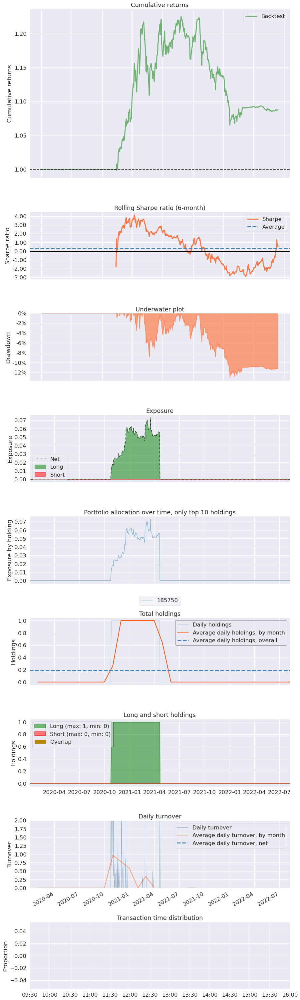

In [33]:
pf.create_simple_tear_sheet(
    returns,
    positions=positions,
    transactions=transactions,
    estimate_intraday=False)